In [1]:
%load_ext autoreload
%autoreload 2

import matplotlib.pyplot as plt
import numpy as np
from scipy.special import expi
from scipy.stats import norm
from scipy import signal
import random

# from wurlitzer import sys_pipes
# For C output, use as:
# with sys_pipes():
#     lib....
import xcoll as xc
from xcoll.scattering_routines.everest import lib
from xcoll.scattering_routines.pyeverest import random as k2ran

In [2]:
# lib.set_random_seed(0)
# lib.get_random_seed()
lib.set_random_seed(1669281221)
k2ran.set_random_seed(1669281221)

In [3]:
def test_random(r, bins, func):
    result = plt.hist(r, bins=bins, density=True,color="blue")
    plt.close()
    x = (result[1][:-1]+result[1][1:])/2
    y_meas = result[0]
    y_real = [ func(xx) for xx in x ]
    S = ((y_real-y_meas)**2).sum()

    print(S)

    _ = plt.figure()
    plt.plot(x,y_meas,'r.')
    plt.plot(x,y_real,'b-')
    plt.show()
    return S

# Rutherford random number generator

In [4]:
def PDF(t, z, emr):
    c = 0.8561e3
    A = (z**2)
    B = c*(emr**2)
    return (A/(t**2))*(np.exp(-B*t))

def CDF(t, z, emr):
    c = 0.8561e3
    A = (z**2)
    B = c*(emr**2)
    t0 = 0.0009982
    return - A*B*expi(-B*t) - t*PDF(t,z,emr) + A*B*expi(-B*t0) + t0*PDF(t0,z,emr)

## 1000000 samples

In [5]:
lib.set_random_seed(1669281221)
k2ran.set_random_seed(1669281221)

mat = xc.materials.Copper
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

lib.set_rutherford_parameters(z,emr,t1)
cgen = k2ran.initialise_random_ruth(zatom=z, emr=emr, hcut=t1)

n = 1000000
lib.set_rutherford_iterations(20)
bins = 1000

loops = 20
S_everest = []
S_K2 = []

f = lambda x: PDF(x,z,emr)/CDF(t1,z,emr)

CPU times: user 5.77 s, sys: 14.7 ms, total: 5.79 s
Wall time: 5.79 s
CPU times: user 2.33 s, sys: 23.4 ms, total: 2.35 s
Wall time: 2.34 s
11025.501733734169


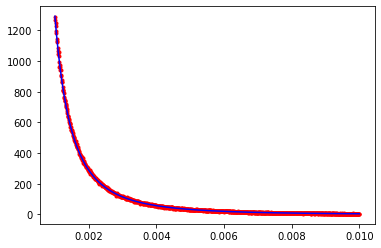

18077.215713188132


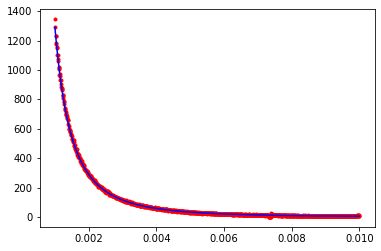

CPU times: user 5.87 s, sys: 44 ms, total: 5.92 s
Wall time: 5.81 s
CPU times: user 2.38 s, sys: 28.1 ms, total: 2.41 s
Wall time: 2.41 s
11009.906365195959


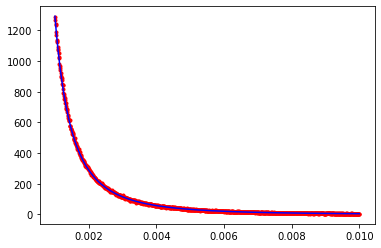

18162.360276285126


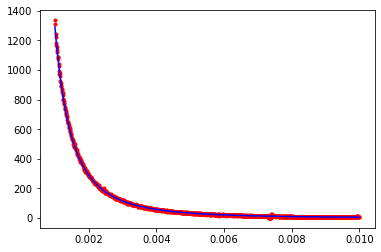

CPU times: user 5.81 s, sys: 36.2 ms, total: 5.85 s
Wall time: 5.75 s
CPU times: user 2.48 s, sys: 36.8 ms, total: 2.51 s
Wall time: 2.51 s
12997.976166445305


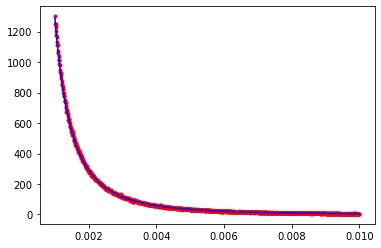

15357.460058406788


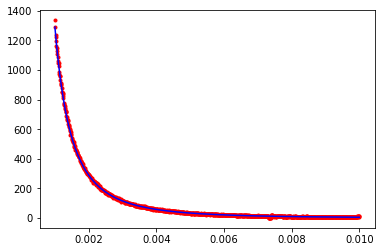

CPU times: user 5.8 s, sys: 33.8 ms, total: 5.83 s
Wall time: 5.72 s
CPU times: user 2.46 s, sys: 26 ms, total: 2.49 s
Wall time: 2.49 s
13621.605907572624


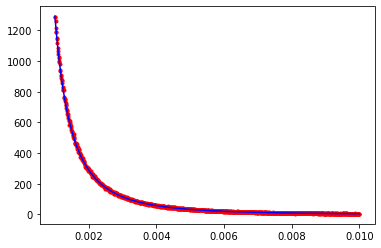

14146.364957984957


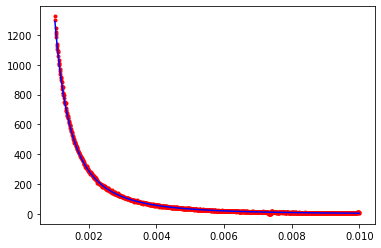

CPU times: user 5.95 s, sys: 40.5 ms, total: 5.99 s
Wall time: 5.89 s
CPU times: user 2.44 s, sys: 30.9 ms, total: 2.47 s
Wall time: 2.46 s
12068.137802919966


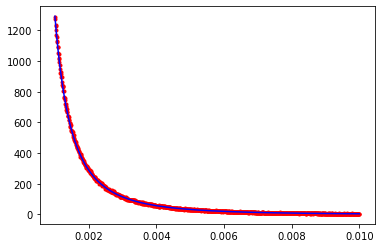

17919.027731074566


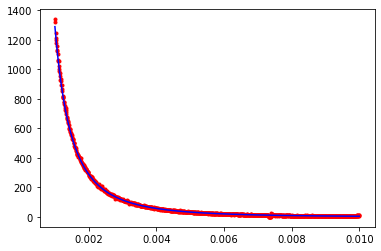

CPU times: user 5.93 s, sys: 39.9 ms, total: 5.97 s
Wall time: 5.89 s
CPU times: user 2.51 s, sys: 59.4 ms, total: 2.57 s
Wall time: 2.55 s
10639.442244637903


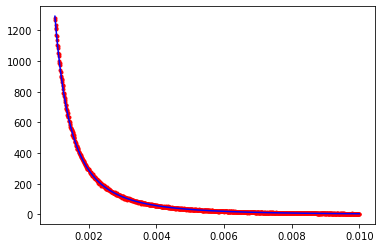

17857.01092831134


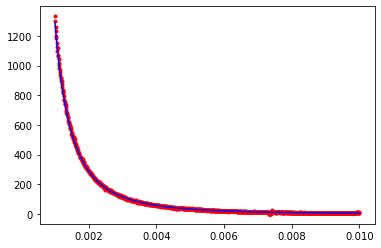

CPU times: user 5.96 s, sys: 41.9 ms, total: 6 s
Wall time: 5.93 s
CPU times: user 2.39 s, sys: 17.2 ms, total: 2.41 s
Wall time: 2.41 s
12321.467358483847


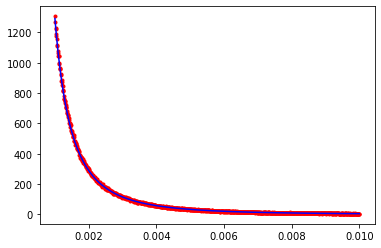

14641.42793723136


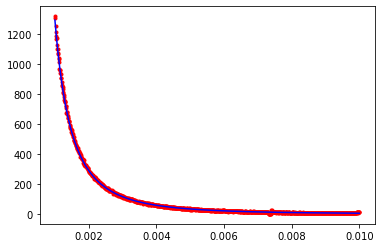

CPU times: user 6.13 s, sys: 57.3 ms, total: 6.19 s
Wall time: 6.11 s
CPU times: user 2.51 s, sys: 31.5 ms, total: 2.54 s
Wall time: 2.54 s
11257.773871484245


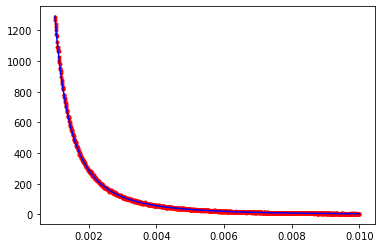

16691.889659884127


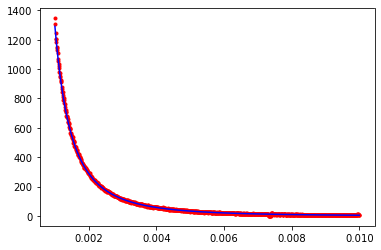

CPU times: user 5.79 s, sys: 32 ms, total: 5.83 s
Wall time: 5.72 s
CPU times: user 2.43 s, sys: 36.3 ms, total: 2.47 s
Wall time: 2.46 s
10118.015380776726


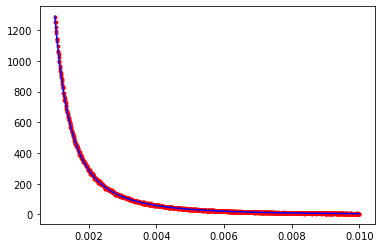

16930.411534866806


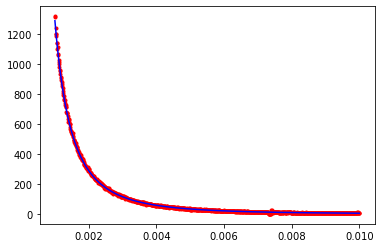

CPU times: user 5.93 s, sys: 43.4 ms, total: 5.98 s
Wall time: 5.86 s
CPU times: user 2.44 s, sys: 35.7 ms, total: 2.47 s
Wall time: 2.46 s
11649.83285338256


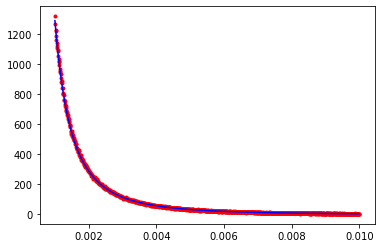

15642.653454984547


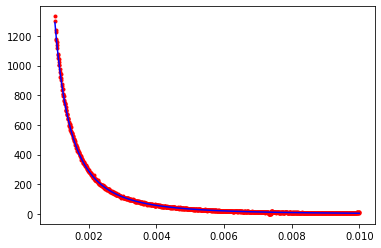

CPU times: user 6 s, sys: 46.3 ms, total: 6.04 s
Wall time: 5.96 s
CPU times: user 2.39 s, sys: 24.2 ms, total: 2.42 s
Wall time: 2.41 s
13436.065609365864


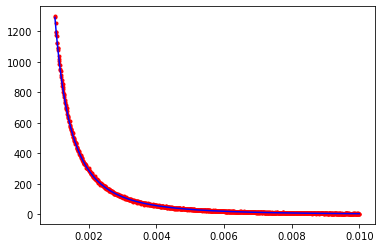

14839.187798936533


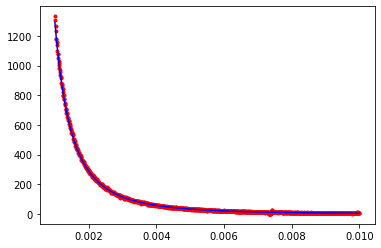

CPU times: user 5.8 s, sys: 40.2 ms, total: 5.84 s
Wall time: 5.74 s
CPU times: user 2.33 s, sys: 22.4 ms, total: 2.36 s
Wall time: 2.35 s
12415.013015485285


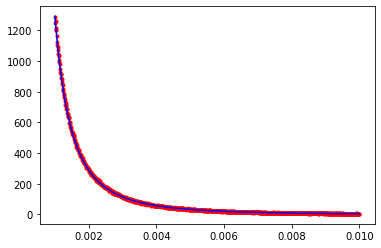

14037.703609679647


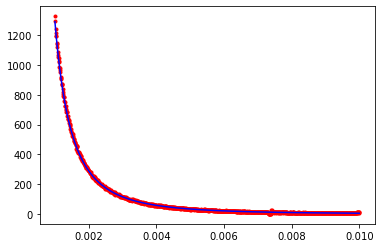

CPU times: user 5.91 s, sys: 41.4 ms, total: 5.95 s
Wall time: 5.84 s
CPU times: user 2.45 s, sys: 25 ms, total: 2.47 s
Wall time: 2.48 s
13300.487077015465


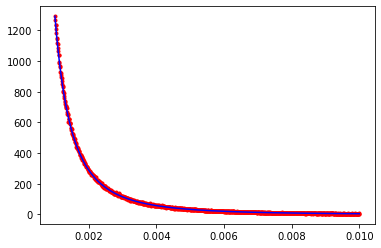

14218.419961939673


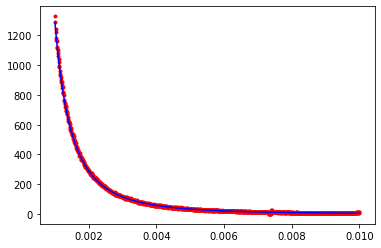

CPU times: user 5.95 s, sys: 42.6 ms, total: 5.99 s
Wall time: 5.89 s
CPU times: user 2.47 s, sys: 28.2 ms, total: 2.5 s
Wall time: 2.51 s
10039.955880477975


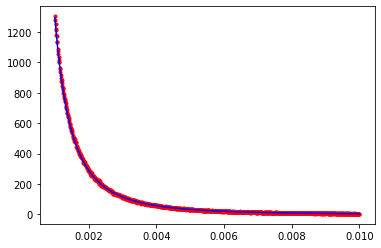

20455.046185282656


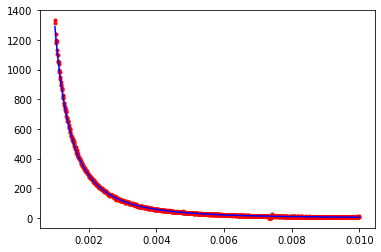

CPU times: user 5.96 s, sys: 48.1 ms, total: 6.01 s
Wall time: 5.92 s
CPU times: user 2.42 s, sys: 34.4 ms, total: 2.46 s
Wall time: 2.45 s
14933.956284985858


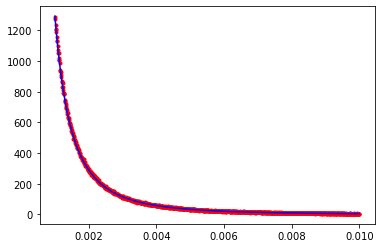

19583.95432937124


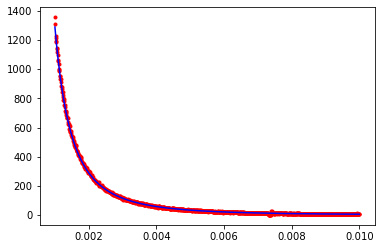

CPU times: user 6.06 s, sys: 50.3 ms, total: 6.11 s
Wall time: 6.01 s
CPU times: user 2.43 s, sys: 36.4 ms, total: 2.47 s
Wall time: 2.46 s
12501.163813217909


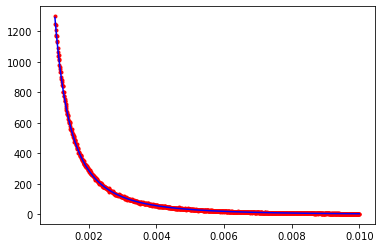

19029.10832092601


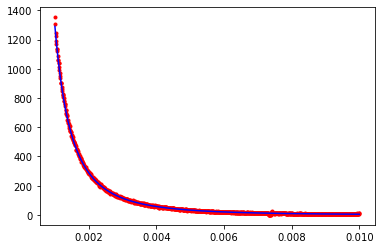

CPU times: user 5.95 s, sys: 35.7 ms, total: 5.98 s
Wall time: 5.91 s
CPU times: user 2.39 s, sys: 19.7 ms, total: 2.41 s
Wall time: 2.41 s
13233.021117448452


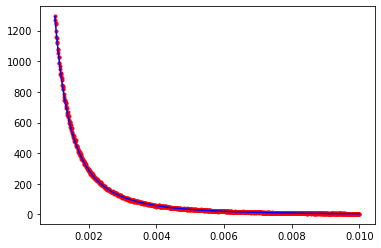

19593.500711759323


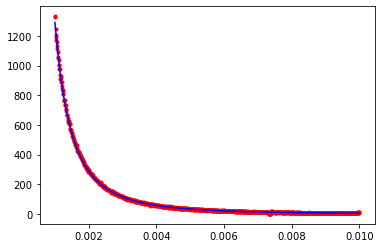

CPU times: user 5.93 s, sys: 40.8 ms, total: 5.97 s
Wall time: 5.86 s
CPU times: user 2.45 s, sys: 31.6 ms, total: 2.48 s
Wall time: 2.48 s
12998.948321855394


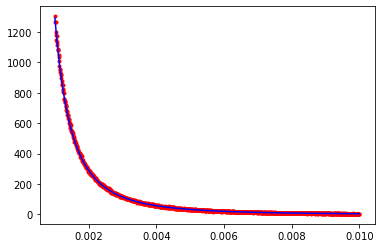

19345.30617063155


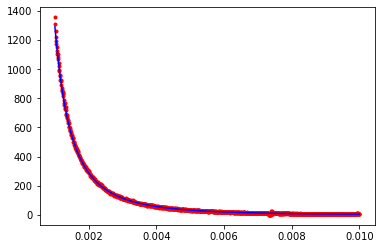

CPU times: user 5.94 s, sys: 37.2 ms, total: 5.98 s
Wall time: 5.87 s
CPU times: user 2.44 s, sys: 34.9 ms, total: 2.48 s
Wall time: 2.47 s
12514.975600317965


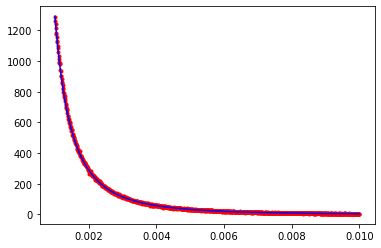

15442.778898483011


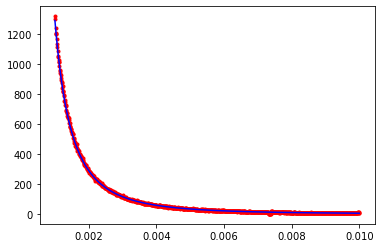

CPU times: user 5.94 s, sys: 38.6 ms, total: 5.98 s
Wall time: 5.88 s
CPU times: user 2.46 s, sys: 24.9 ms, total: 2.48 s
Wall time: 2.49 s
13167.885359683789


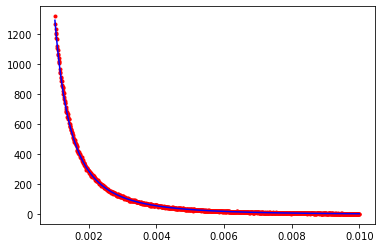

18228.39523301323


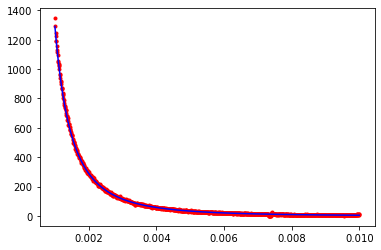

In [6]:
for _ in range(loops):
    %time r_everest = [ lib.get_random_ruth() for _ in range(n) ]
    %time r_k2      = [ k2ran.get_random_ruth(cgen) for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [7]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

110.73642846066674
130.4222418669915
[0.78096831 0.77858435 0.91997954 0.98127724 0.82065933 0.77188935
 0.91735936 0.82124646 0.77306126 0.86298776 0.95154864 0.94042801
 0.96718177 0.7005928  0.87324728 0.81052423 0.8218139  0.81972146
 0.9002275  0.84993126]
0.8564104686932342


In [12]:
lib.set_random_seed(1669281221)
k2ran.set_random_seed(1669281221)

mat = xc.materials.Berylium
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

lib.set_rutherford_parameters(z,emr,t1)
cgen = k2ran.initialise_random_ruth(zatom=z, emr=emr, hcut=t1)

n = 1000000
lib.set_rutherford_iterations(20)
bins = 1000

loops = 20
S_everest = []
S_K2 = []

f = lambda x: PDF(x,z,emr)/CDF(t1,z,emr)

CPU times: user 5.53 s, sys: 22.9 ms, total: 5.55 s
Wall time: 5.56 s
CPU times: user 2.41 s, sys: 19.5 ms, total: 2.43 s
Wall time: 2.42 s
2432.6600823354015


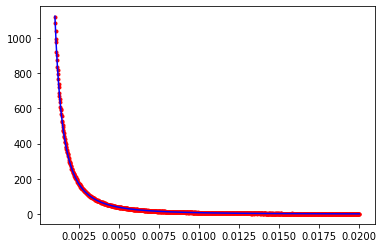

4399.146948352193


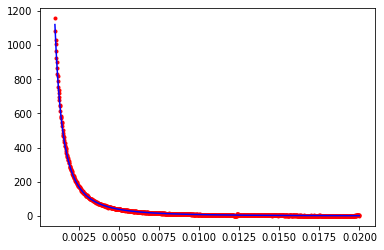

CPU times: user 5.62 s, sys: 40.8 ms, total: 5.66 s
Wall time: 5.57 s
CPU times: user 2.38 s, sys: 24.8 ms, total: 2.4 s
Wall time: 2.4 s
2574.557269228166


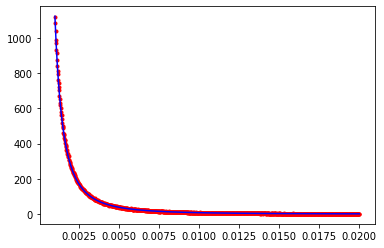

4903.51687546539


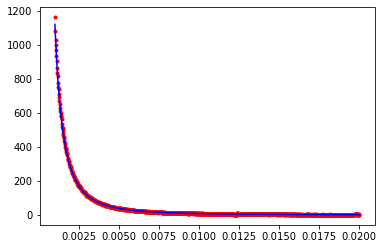

CPU times: user 5.63 s, sys: 38.1 ms, total: 5.67 s
Wall time: 5.61 s
CPU times: user 2.47 s, sys: 29.4 ms, total: 2.5 s
Wall time: 2.5 s
2683.4569332961883


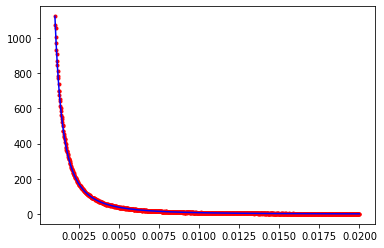

3939.101876583609


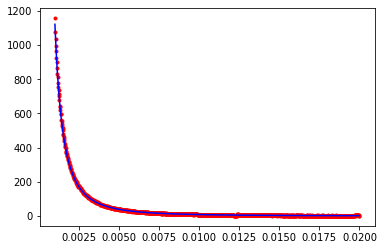

CPU times: user 5.7 s, sys: 48.3 ms, total: 5.75 s
Wall time: 5.67 s
CPU times: user 2.45 s, sys: 64 ms, total: 2.51 s
Wall time: 2.47 s
3175.805668783736


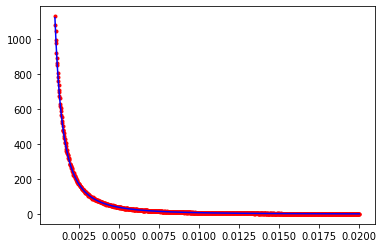

4412.787307992524


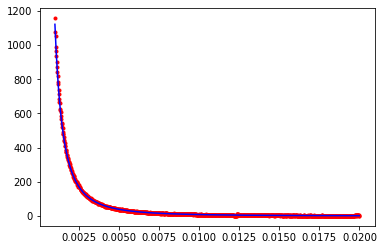

CPU times: user 5.72 s, sys: 50.9 ms, total: 5.77 s
Wall time: 5.68 s
CPU times: user 2.4 s, sys: 62.8 ms, total: 2.47 s
Wall time: 2.43 s
2731.8352832359633


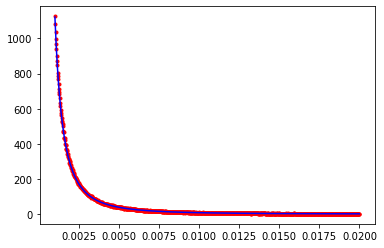

5819.9289400759835


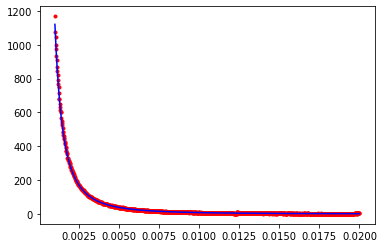

CPU times: user 5.64 s, sys: 40.8 ms, total: 5.69 s
Wall time: 5.59 s
CPU times: user 2.46 s, sys: 28.3 ms, total: 2.49 s
Wall time: 2.49 s
2413.0828259468417


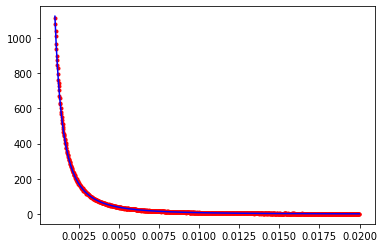

4467.256837898976


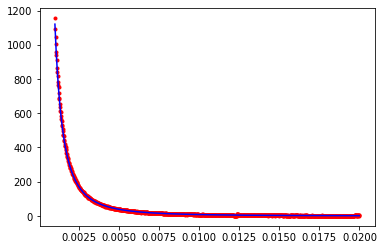

CPU times: user 5.74 s, sys: 46.4 ms, total: 5.79 s
Wall time: 5.7 s
CPU times: user 2.49 s, sys: 53.3 ms, total: 2.55 s
Wall time: 2.53 s
2994.4382103402368


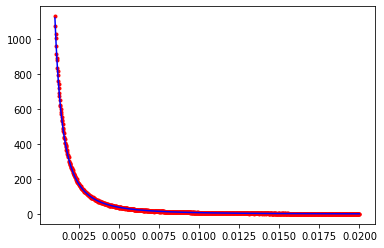

3439.7698968684936


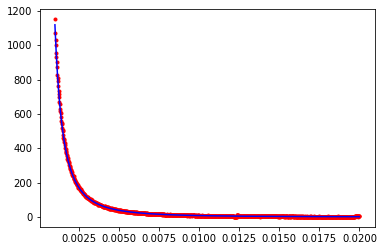

CPU times: user 5.63 s, sys: 42.1 ms, total: 5.68 s
Wall time: 5.59 s
CPU times: user 2.5 s, sys: 42.5 ms, total: 2.54 s
Wall time: 2.53 s
2719.62709801307


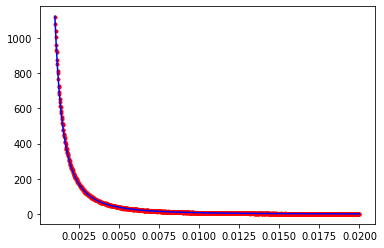

4683.786078811651


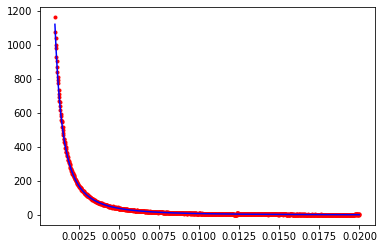

CPU times: user 5.68 s, sys: 41.5 ms, total: 5.72 s
Wall time: 5.68 s
CPU times: user 2.48 s, sys: 25.6 ms, total: 2.51 s
Wall time: 2.51 s
2717.0174126940433


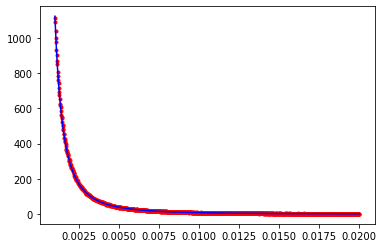

3734.6171926993884


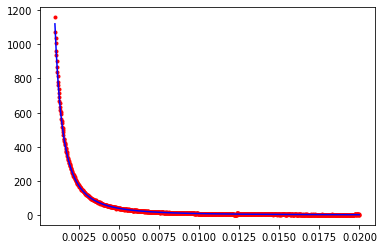

CPU times: user 5.67 s, sys: 41.2 ms, total: 5.71 s
Wall time: 5.61 s
CPU times: user 2.43 s, sys: 25.3 ms, total: 2.45 s
Wall time: 2.45 s
2288.9461223265203


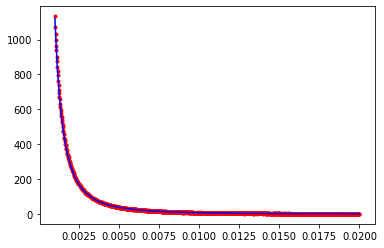

4138.257941320924


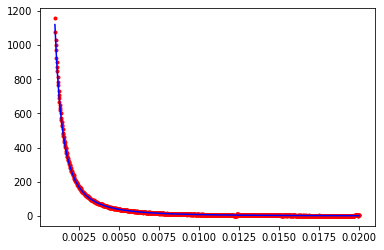

CPU times: user 5.68 s, sys: 41.4 ms, total: 5.72 s
Wall time: 5.65 s
CPU times: user 2.48 s, sys: 65.1 ms, total: 2.55 s
Wall time: 2.52 s
3036.247770770301


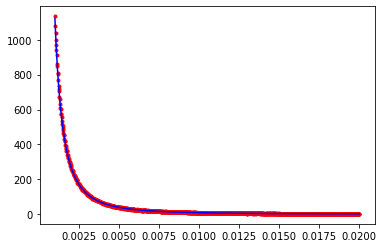

3985.4456036490947


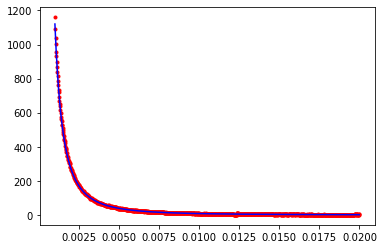

CPU times: user 5.48 s, sys: 28.8 ms, total: 5.51 s
Wall time: 5.42 s
CPU times: user 2.38 s, sys: 21.8 ms, total: 2.4 s
Wall time: 2.39 s
2179.8556601699133


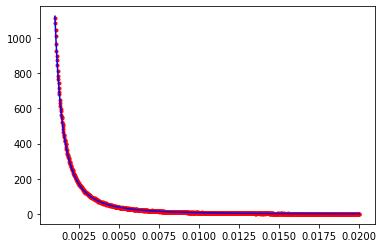

4097.775082518947


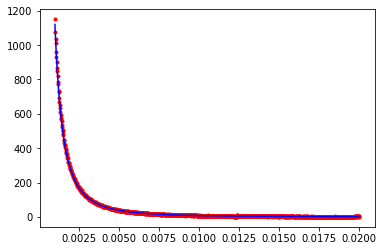

CPU times: user 5.67 s, sys: 45.1 ms, total: 5.72 s
Wall time: 5.64 s
CPU times: user 2.43 s, sys: 34.1 ms, total: 2.46 s
Wall time: 2.45 s
3084.524890873192


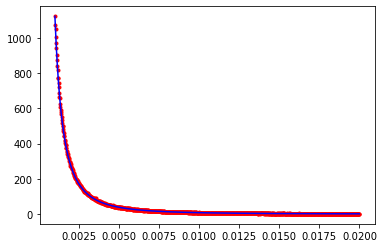

3990.417428384167


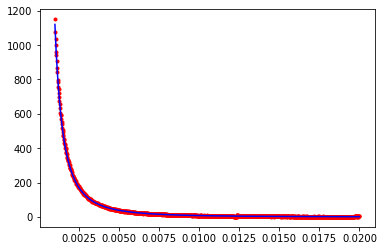

CPU times: user 5.54 s, sys: 38.9 ms, total: 5.58 s
Wall time: 5.48 s
CPU times: user 2.47 s, sys: 30.6 ms, total: 2.5 s
Wall time: 2.49 s
2176.112466633181


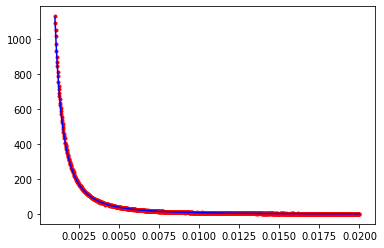

4547.805765766224


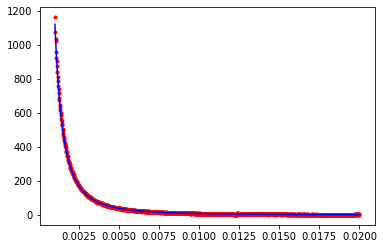

CPU times: user 5.49 s, sys: 32.1 ms, total: 5.52 s
Wall time: 5.42 s
CPU times: user 2.46 s, sys: 26.8 ms, total: 2.49 s
Wall time: 2.49 s
2902.2747285070304


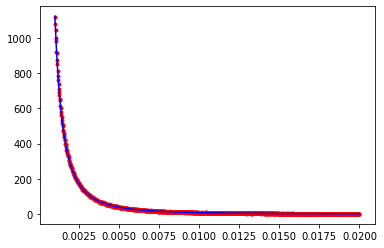

5623.579603739755


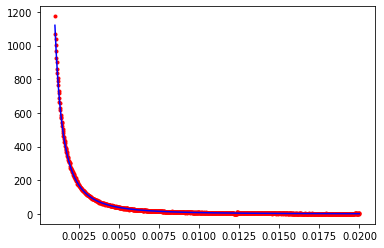

CPU times: user 5.62 s, sys: 40.4 ms, total: 5.66 s
Wall time: 5.56 s
CPU times: user 2.39 s, sys: 25 ms, total: 2.42 s
Wall time: 2.41 s
2862.910368641669


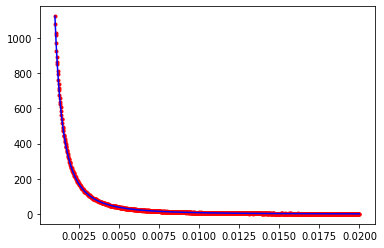

5416.611157684611


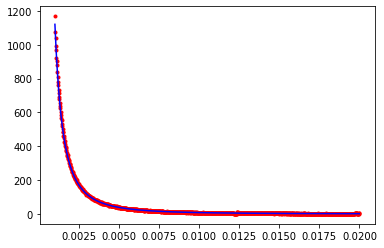

CPU times: user 5.47 s, sys: 35.3 ms, total: 5.51 s
Wall time: 5.41 s
CPU times: user 2.35 s, sys: 20.7 ms, total: 2.37 s
Wall time: 2.37 s
2896.6729932245084


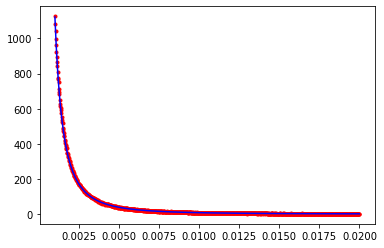

5013.062653666839


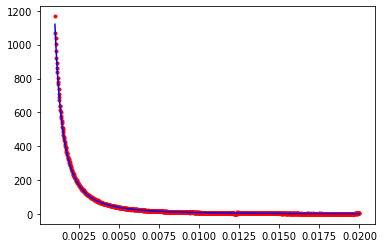

CPU times: user 5.56 s, sys: 34 ms, total: 5.59 s
Wall time: 5.49 s
CPU times: user 2.37 s, sys: 24.5 ms, total: 2.4 s
Wall time: 2.4 s
2798.230540134354


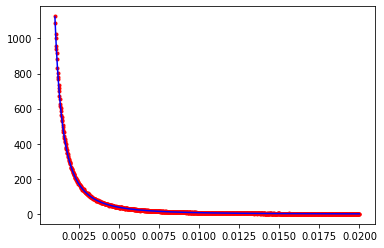

5987.30757650346


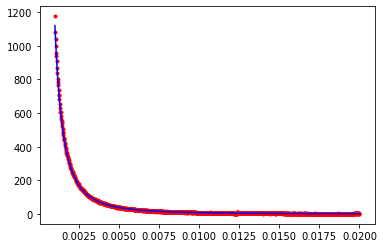

CPU times: user 5.5 s, sys: 31.3 ms, total: 5.53 s
Wall time: 5.43 s
CPU times: user 2.37 s, sys: 20.3 ms, total: 2.39 s
Wall time: 2.38 s
2934.9727237258353


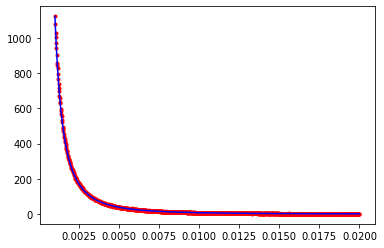

3860.9928485730316


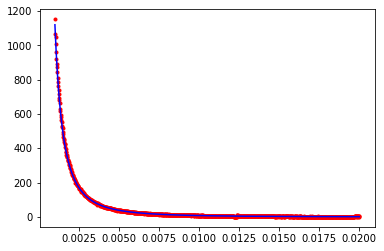

CPU times: user 5.67 s, sys: 50 ms, total: 5.72 s
Wall time: 5.63 s
CPU times: user 2.5 s, sys: 32 ms, total: 2.53 s
Wall time: 2.53 s
3497.953856371402


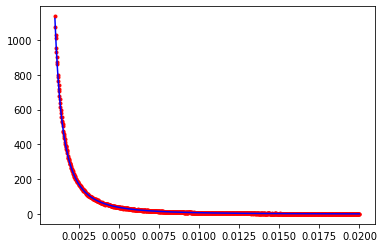

4670.812441559477


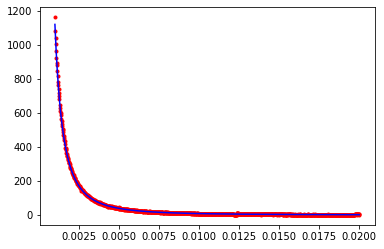

In [13]:
for _ in range(loops):
    %time r_everest = [ lib.get_random_ruth() for _ in range(n) ]
    %time r_k2      = [ k2ran.get_random_ruth(cgen) for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [14]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

52.48865730100721
67.50258515720519
[0.74362928 0.72459852 0.82537005 0.84834101 0.68512279 0.7349633
 0.93302436 0.76200208 0.8529492  0.74371922 0.872831   0.72935642
 0.87919453 0.69173494 0.71839423 0.72700943 0.76014802 0.68363763
 0.87187161 0.86538791]
0.786272280075917


In [15]:
lib.set_random_seed(1669281221)
k2ran.set_random_seed(1669281221)

mat = xc.materials.Lead
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

lib.set_rutherford_parameters(z,emr,t1)
cgen = k2ran.initialise_random_ruth(zatom=z, emr=emr, hcut=t1)

n = 1000000
lib.set_rutherford_iterations(20)
bins = 1000

loops = 20
S_everest = []
S_K2 = []

f = lambda x: PDF(x,z,emr)/CDF(t1,z,emr)

CPU times: user 6.04 s, sys: 19.2 ms, total: 6.06 s
Wall time: 6.06 s
CPU times: user 2.49 s, sys: 34.2 ms, total: 2.53 s
Wall time: 2.53 s
11094.807837934271


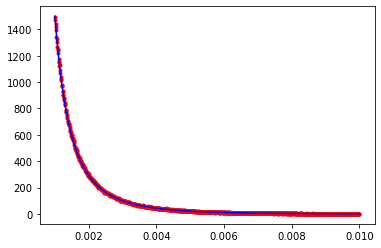

16921.23804475148


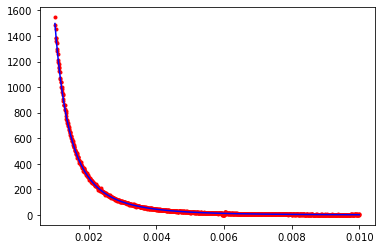

CPU times: user 6.08 s, sys: 34.4 ms, total: 6.11 s
Wall time: 6.02 s
CPU times: user 2.41 s, sys: 39.2 ms, total: 2.44 s
Wall time: 2.43 s
12198.156657769525


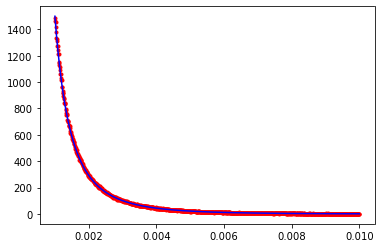

18262.128472395678


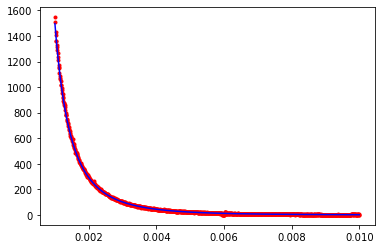

CPU times: user 6.25 s, sys: 46 ms, total: 6.3 s
Wall time: 6.2 s
CPU times: user 2.49 s, sys: 61.4 ms, total: 2.55 s
Wall time: 2.53 s
13624.189830508687


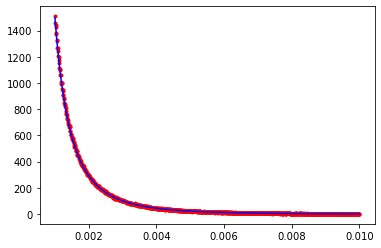

14681.415447170097


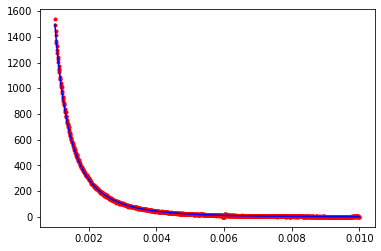

CPU times: user 6.22 s, sys: 44.1 ms, total: 6.26 s
Wall time: 6.17 s
CPU times: user 2.45 s, sys: 40.9 ms, total: 2.5 s
Wall time: 2.48 s
14187.307557596974


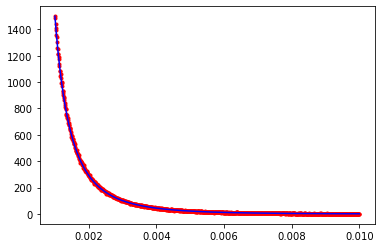

15575.272712226451


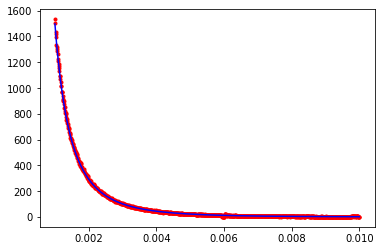

CPU times: user 6.25 s, sys: 47.1 ms, total: 6.29 s
Wall time: 6.2 s
CPU times: user 2.49 s, sys: 41.3 ms, total: 2.53 s
Wall time: 2.52 s
11657.78267321746


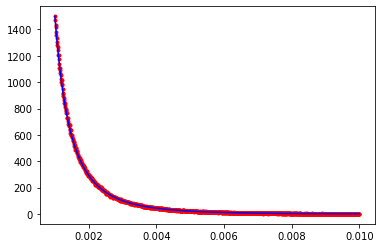

18558.524905072903


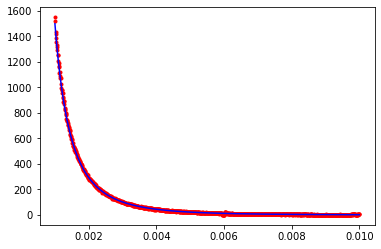

CPU times: user 6.22 s, sys: 47.6 ms, total: 6.27 s
Wall time: 6.17 s
CPU times: user 2.48 s, sys: 27.1 ms, total: 2.5 s
Wall time: 2.51 s
9561.610189726223


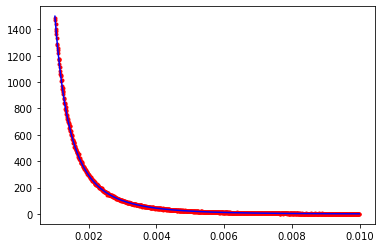

16129.980635996642


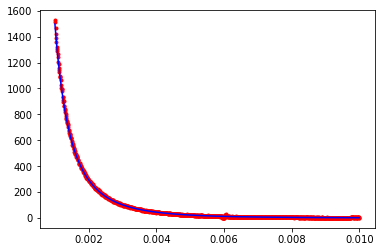

CPU times: user 6.27 s, sys: 44.1 ms, total: 6.32 s
Wall time: 6.24 s
CPU times: user 2.48 s, sys: 40.7 ms, total: 2.52 s
Wall time: 2.52 s
12504.486722852875


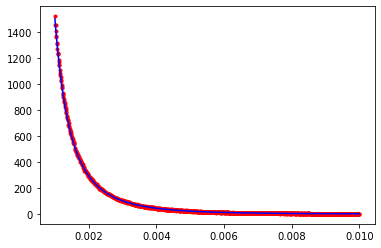

15028.288041413736


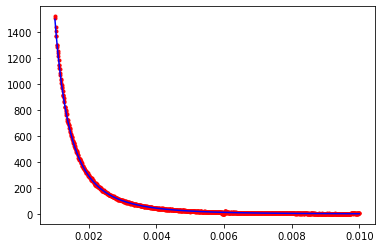

CPU times: user 6.17 s, sys: 42.8 ms, total: 6.21 s
Wall time: 6.11 s
CPU times: user 2.5 s, sys: 27 ms, total: 2.53 s
Wall time: 2.53 s
11327.161853550515


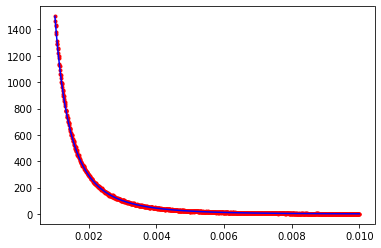

17508.489642207485


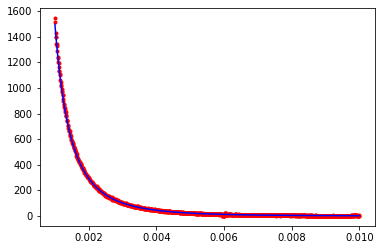

CPU times: user 6.09 s, sys: 34.8 ms, total: 6.12 s
Wall time: 6.05 s
CPU times: user 2.35 s, sys: 22.3 ms, total: 2.38 s
Wall time: 2.37 s
10877.28604924866


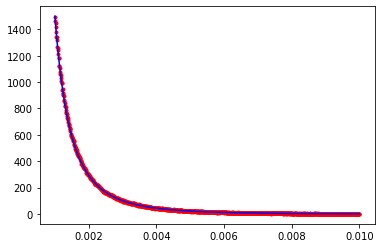

16883.64055984698


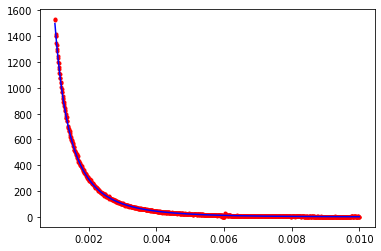

CPU times: user 6.14 s, sys: 33 ms, total: 6.17 s
Wall time: 6.08 s
CPU times: user 2.46 s, sys: 27.6 ms, total: 2.49 s
Wall time: 2.49 s
10365.10406408762


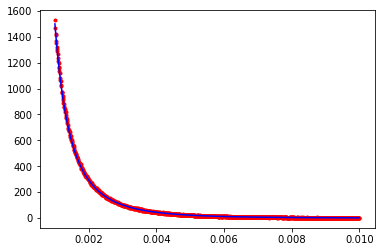

15636.266795341044


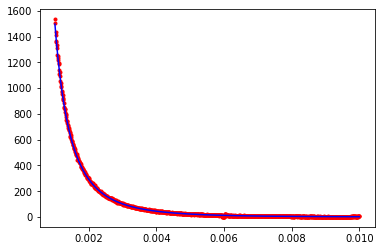

CPU times: user 6.22 s, sys: 41.7 ms, total: 6.26 s
Wall time: 6.18 s
CPU times: user 2.45 s, sys: 72.3 ms, total: 2.52 s
Wall time: 2.48 s
13755.082426900002


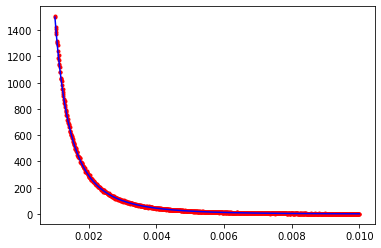

16713.19289306574


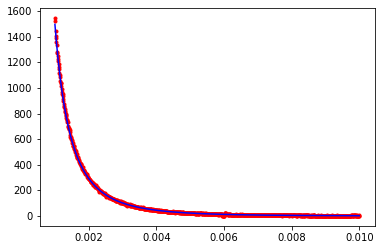

CPU times: user 6.07 s, sys: 37 ms, total: 6.11 s
Wall time: 6 s
CPU times: user 2.35 s, sys: 24.1 ms, total: 2.37 s
Wall time: 2.37 s
10245.37829949718


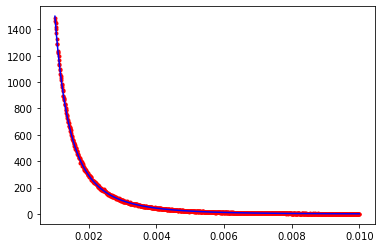

16380.250860775144


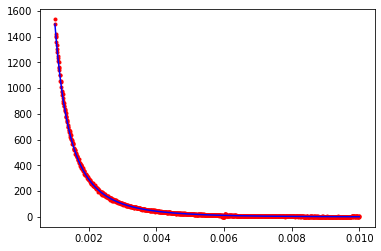

CPU times: user 6 s, sys: 29 ms, total: 6.03 s
Wall time: 5.92 s
CPU times: user 2.33 s, sys: 18.6 ms, total: 2.35 s
Wall time: 2.35 s
13740.150413009427


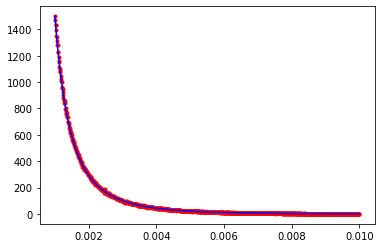

13419.985919736855


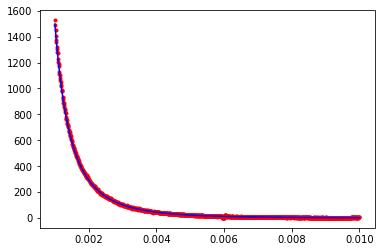

CPU times: user 6.02 s, sys: 30 ms, total: 6.05 s
Wall time: 5.94 s
CPU times: user 2.34 s, sys: 18.5 ms, total: 2.36 s
Wall time: 2.35 s
9778.047983016151


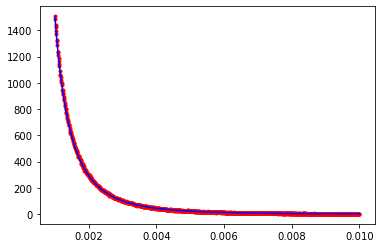

17891.77456168265


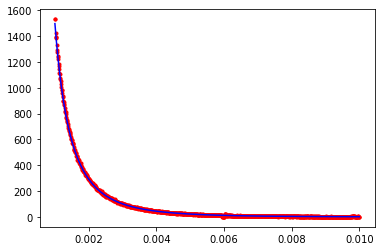

CPU times: user 6.09 s, sys: 39.7 ms, total: 6.13 s
Wall time: 6.03 s
CPU times: user 2.68 s, sys: 42 ms, total: 2.73 s
Wall time: 2.74 s
14055.796169461126


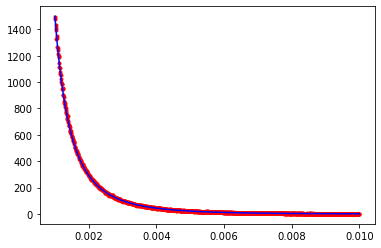

19029.802763989497


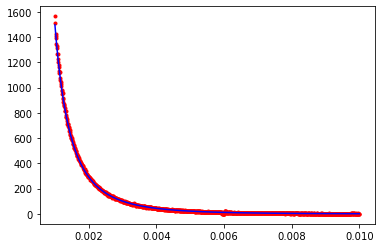

CPU times: user 6.24 s, sys: 42.1 ms, total: 6.28 s
Wall time: 6.19 s
CPU times: user 2.48 s, sys: 32.2 ms, total: 2.52 s
Wall time: 2.52 s
12984.852709627736


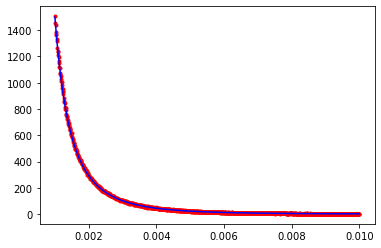

19062.520538312885


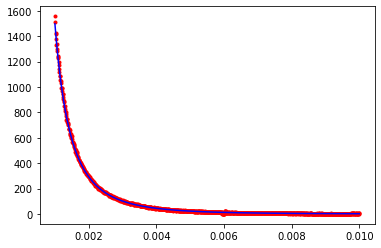

CPU times: user 6.2 s, sys: 39.5 ms, total: 6.24 s
Wall time: 6.21 s
CPU times: user 2.52 s, sys: 28.6 ms, total: 2.55 s
Wall time: 2.55 s
13772.463338320547


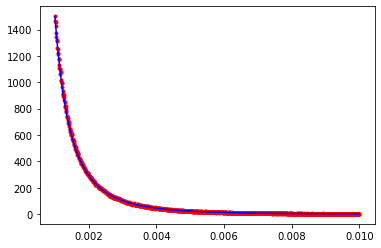

16719.67854976641


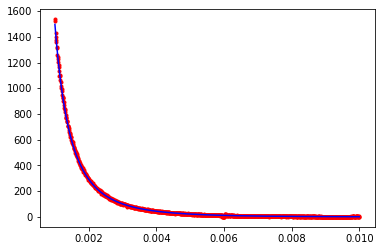

CPU times: user 6.23 s, sys: 37 ms, total: 6.26 s
Wall time: 6.17 s
CPU times: user 2.45 s, sys: 34 ms, total: 2.49 s
Wall time: 2.48 s
12619.680389862915


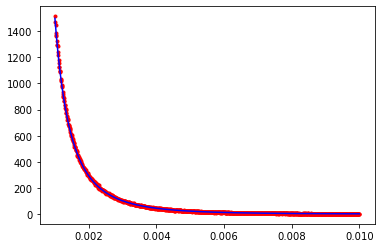

21181.063296702934


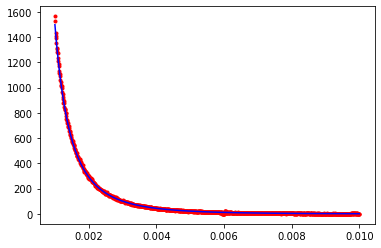

CPU times: user 6.2 s, sys: 41.7 ms, total: 6.25 s
Wall time: 6.18 s
CPU times: user 2.47 s, sys: 32.4 ms, total: 2.5 s
Wall time: 2.49 s
11998.196259267192


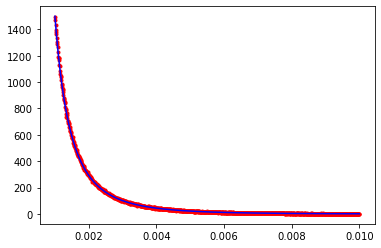

15485.935323445052


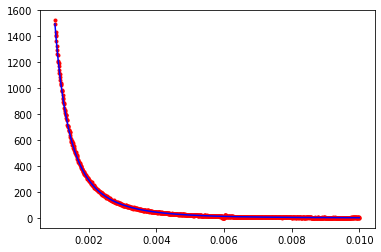

CPU times: user 6.06 s, sys: 29.7 ms, total: 6.09 s
Wall time: 5.98 s
CPU times: user 2.41 s, sys: 36.2 ms, total: 2.44 s
Wall time: 2.43 s
14932.251940149958


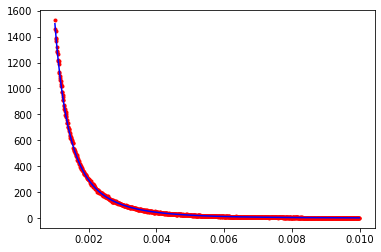

18044.56855255246


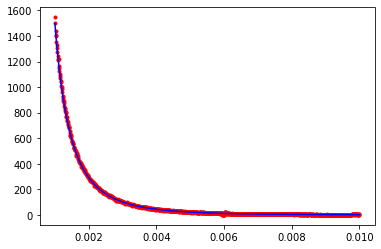

In [16]:
for _ in range(loops):
    %time r_everest = [ lib.get_random_ruth() for _ in range(n) ]
    %time r_k2      = [ k2ran.get_random_ruth(cgen) for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [17]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

110.74289895194298
130.21405809597752
[0.8097367  0.81728101 0.96332178 0.9544038  0.79256748 0.76992531
 0.91217503 0.8043336  0.80265188 0.81417975 0.90719759 0.79086749
 1.01185833 0.73926369 0.85943014 0.82533137 0.90759449 0.77188091
 0.880216   0.90968158]
0.855279709675336


## 5000 samples, 20 iterations

In [18]:
lib.set_random_seed(1669281221)
k2ran.set_random_seed(1669281221)

mat = xc.materials.Copper
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

lib.set_rutherford_parameters(z,emr,t1)
cgen = k2ran.initialise_random_ruth(zatom=z, emr=emr, hcut=t1)

n = 5000
lib.set_rutherford_iterations(20)
bins = 100

loops = 20
S_everest = []
S_K2 = []
f = lambda x: PDF(x,z,emr)/CDF(t1,z,emr)

CPU times: user 35.4 ms, sys: 3.15 ms, total: 38.5 ms
Wall time: 38 ms
CPU times: user 24.2 ms, sys: 8.82 ms, total: 33 ms
Wall time: 28.6 ms
30975.527654890047


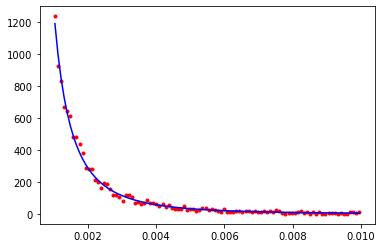

16326.253888455087


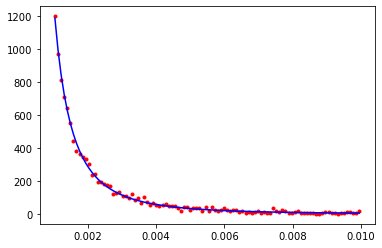

CPU times: user 78.6 ms, sys: 10.7 ms, total: 89.3 ms
Wall time: 30.1 ms
CPU times: user 40.8 ms, sys: 24.8 ms, total: 65.7 ms
Wall time: 21.1 ms
19761.519417502786


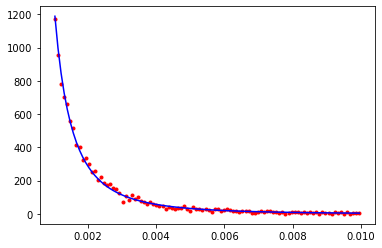

23262.532401250377


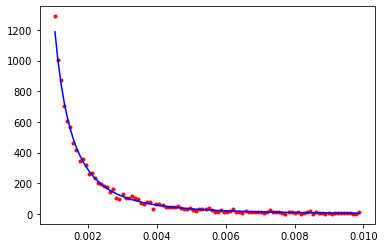

CPU times: user 79.4 ms, sys: 10.2 ms, total: 89.6 ms
Wall time: 30 ms
CPU times: user 34.6 ms, sys: 7 ms, total: 41.6 ms
Wall time: 13.9 ms
31838.57837341277


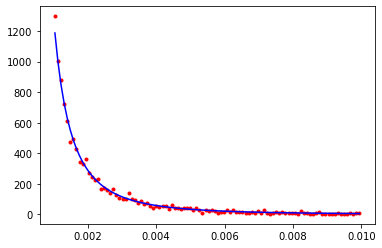

15796.700082084046


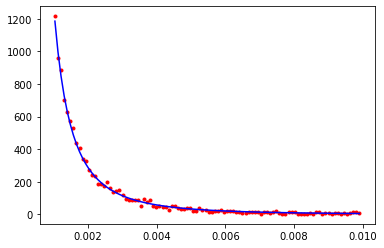

CPU times: user 77 ms, sys: 11.9 ms, total: 88.9 ms
Wall time: 30.3 ms
CPU times: user 33.8 ms, sys: 8.77 ms, total: 42.5 ms
Wall time: 14.5 ms
23946.487098849302


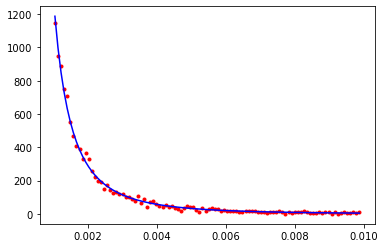

16050.625972424821


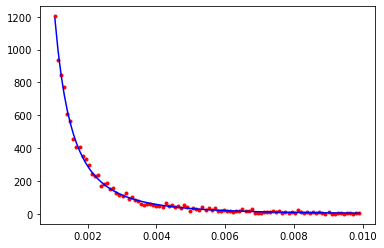

CPU times: user 78 ms, sys: 11.3 ms, total: 89.3 ms
Wall time: 30.3 ms
CPU times: user 37 ms, sys: 13.3 ms, total: 50.3 ms
Wall time: 16.8 ms
41962.56481555434


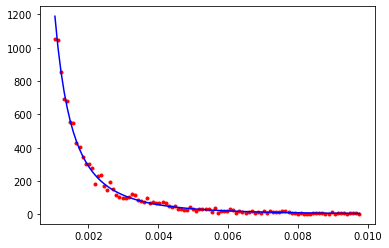

21224.72300801168


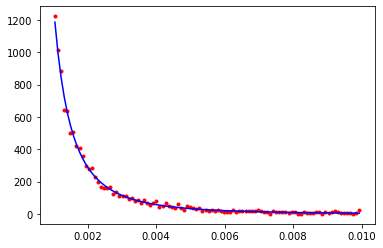

CPU times: user 78.7 ms, sys: 10.8 ms, total: 89.5 ms
Wall time: 30.2 ms
CPU times: user 43.7 ms, sys: 42.7 ms, total: 86.3 ms
Wall time: 27.8 ms
18895.306858960925


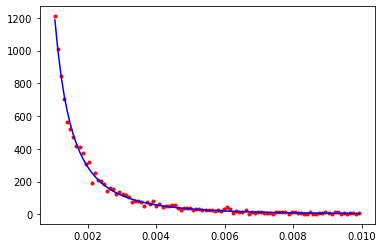

24334.16320841606


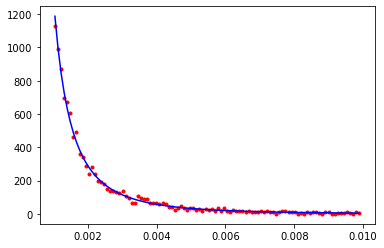

CPU times: user 78.6 ms, sys: 11.6 ms, total: 90.2 ms
Wall time: 30.6 ms
CPU times: user 34.8 ms, sys: 8.44 ms, total: 43.3 ms
Wall time: 14.6 ms
29814.396168289844


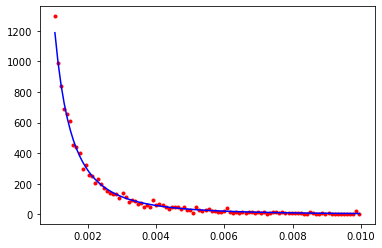

17340.067152407246


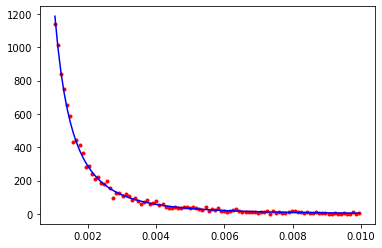

CPU times: user 77.5 ms, sys: 11.8 ms, total: 89.3 ms
Wall time: 30.4 ms
CPU times: user 35.4 ms, sys: 8.5 ms, total: 43.9 ms
Wall time: 14.8 ms
18336.063514777394


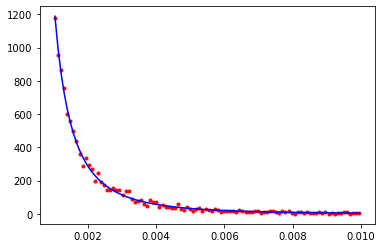

22794.749343411833


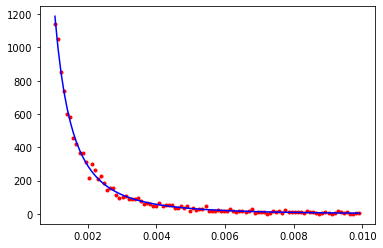

CPU times: user 77.7 ms, sys: 11.8 ms, total: 89.5 ms
Wall time: 30.5 ms
CPU times: user 35.5 ms, sys: 7.94 ms, total: 43.4 ms
Wall time: 14.6 ms
12001.392392149139


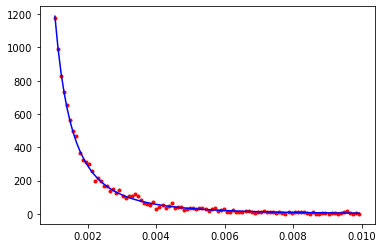

16193.329812112608


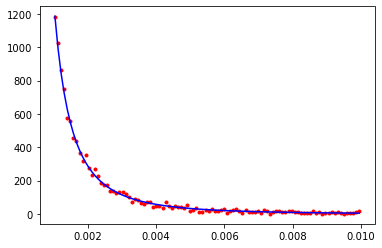

CPU times: user 77.7 ms, sys: 11.6 ms, total: 89.3 ms
Wall time: 30.4 ms
CPU times: user 34.9 ms, sys: 8.05 ms, total: 43 ms
Wall time: 14.6 ms
23265.74367445408


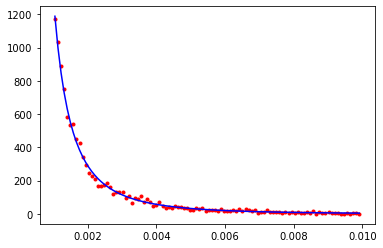

27831.15282156286


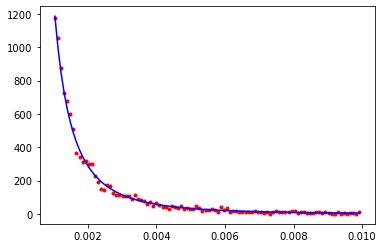

CPU times: user 79.2 ms, sys: 10.5 ms, total: 89.7 ms
Wall time: 30.1 ms
CPU times: user 35.5 ms, sys: 10.6 ms, total: 46.2 ms
Wall time: 15.5 ms
25428.935629793486


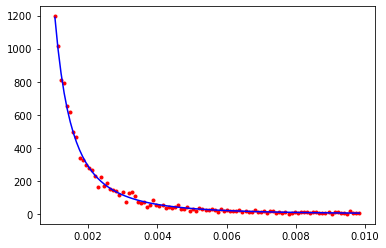

26753.905550980526


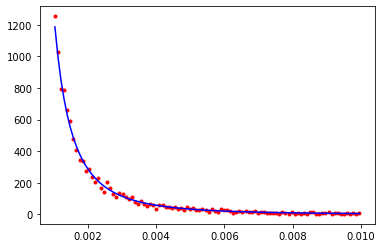

CPU times: user 80 ms, sys: 10.6 ms, total: 90.6 ms
Wall time: 30.5 ms
CPU times: user 35 ms, sys: 7.52 ms, total: 42.5 ms
Wall time: 14.2 ms
29765.812444656654


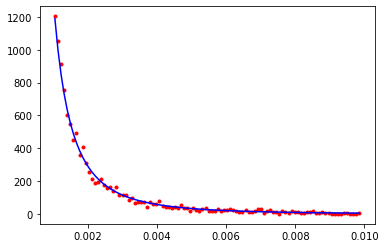

23840.76089012738


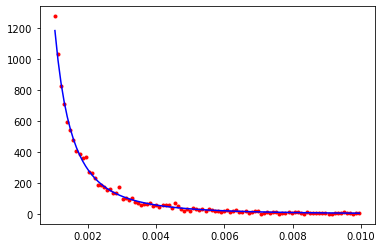

CPU times: user 79.6 ms, sys: 10.1 ms, total: 89.7 ms
Wall time: 30 ms
CPU times: user 35.4 ms, sys: 8.29 ms, total: 43.7 ms
Wall time: 14.5 ms
20702.267814359486


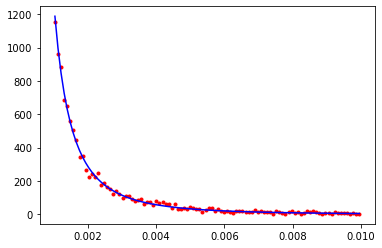

26529.892425471597


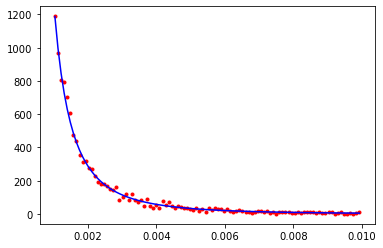

CPU times: user 79.3 ms, sys: 9.99 ms, total: 89.3 ms
Wall time: 29.9 ms
CPU times: user 34.9 ms, sys: 6.5 ms, total: 41.4 ms
Wall time: 13.8 ms
26214.232113333863


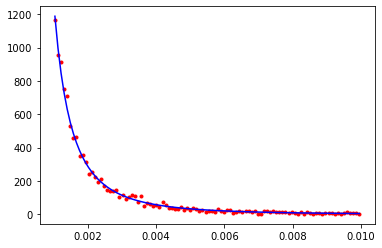

16962.603278815342


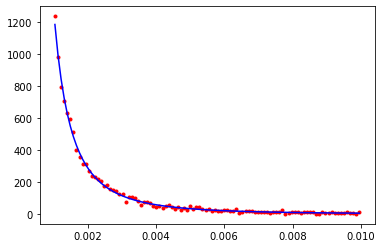

CPU times: user 79.7 ms, sys: 10 ms, total: 89.7 ms
Wall time: 30 ms
CPU times: user 34.9 ms, sys: 6.78 ms, total: 41.7 ms
Wall time: 13.9 ms
24860.60054201775


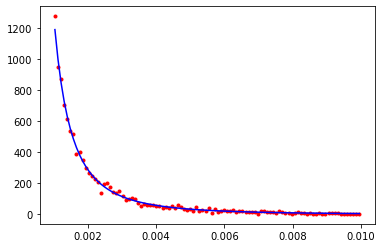

28281.79769832608


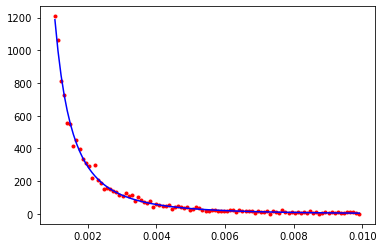

CPU times: user 78.5 ms, sys: 9.75 ms, total: 88.2 ms
Wall time: 29.5 ms
CPU times: user 35 ms, sys: 6.51 ms, total: 41.5 ms
Wall time: 13.9 ms
21800.05916278795


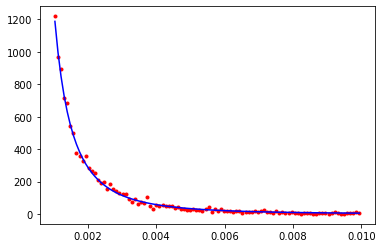

12820.303690006225


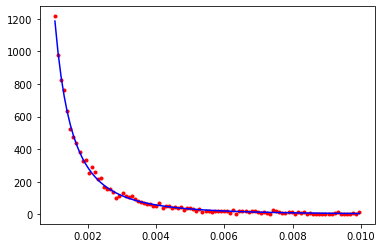

CPU times: user 79.8 ms, sys: 9.88 ms, total: 89.6 ms
Wall time: 29.9 ms
CPU times: user 42.3 ms, sys: 32.5 ms, total: 74.8 ms
Wall time: 23.6 ms
19524.46308056453


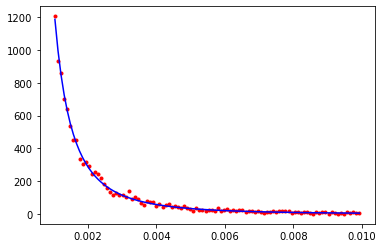

23148.44252267499


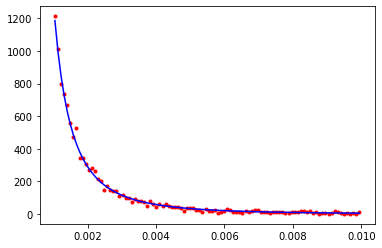

CPU times: user 79.5 ms, sys: 10.1 ms, total: 89.5 ms
Wall time: 30 ms
CPU times: user 35.2 ms, sys: 6.61 ms, total: 41.8 ms
Wall time: 14 ms
13003.648590482004


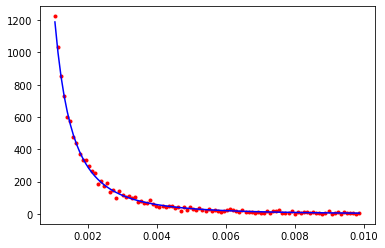

17329.163941793


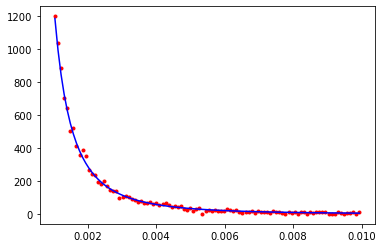

CPU times: user 79.8 ms, sys: 9.98 ms, total: 89.8 ms
Wall time: 30 ms
CPU times: user 35 ms, sys: 7.69 ms, total: 42.7 ms
Wall time: 14.2 ms
24186.757570729045


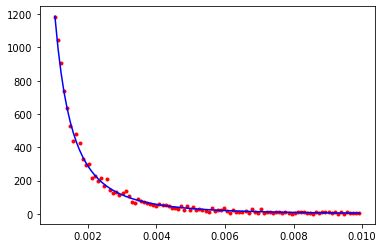

26059.43449973095


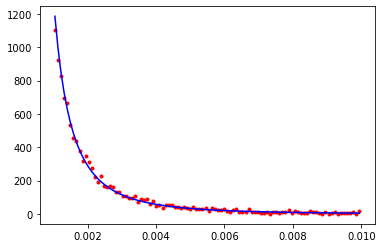

CPU times: user 78.8 ms, sys: 10.6 ms, total: 89.4 ms
Wall time: 30.1 ms
CPU times: user 35.2 ms, sys: 12 ms, total: 47.1 ms
Wall time: 16 ms
20032.354239625787


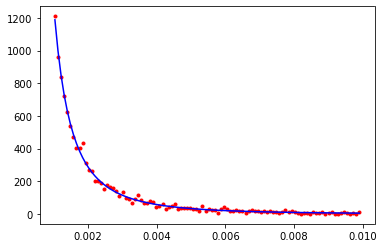

23704.474527562852


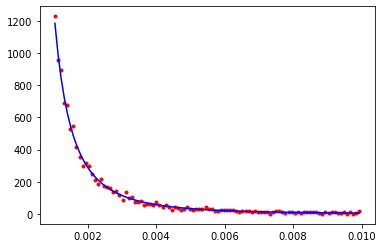

In [19]:
for _ in range(loops):
    %time r_everest = [ lib.get_random_ruth() for _ in range(n) ]
    %time r_k2      = [ k2ran.get_random_ruth(cgen) for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [20]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

154.32380100898098
146.0453827951479
[1.37741905 0.9216832  1.41969041 1.22144782 1.40607989 0.88118839
 1.3112564  0.89688269 0.86089015 0.91430874 0.9749234  1.11737465
 0.88336709 1.24314652 0.93756698 1.30400627 0.91839321 0.86625112
 0.96339931 0.91928639]
1.085816652071524


In [21]:
lib.set_random_seed(1669281221)
k2ran.set_random_seed(1669281221)

mat = xc.materials.Beryliumrylium
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

lib.set_rutherford_parameters(z,emr,t1)
cgen = k2ran.initialise_random_ruth(zatom=z, emr=emr, hcut=t1)

n = 5000
lib.set_rutherford_iterations(20)
bins = 100

loops = 20
S_everest = []
S_K2 = []
f = lambda x: PDF(x,z,emr)/CDF(t1,z,emr)

CPU times: user 29 ms, sys: 615 µs, total: 29.6 ms
Wall time: 29.1 ms
CPU times: user 20.5 ms, sys: 12.7 ms, total: 33.3 ms
Wall time: 23.8 ms
5330.881838678876


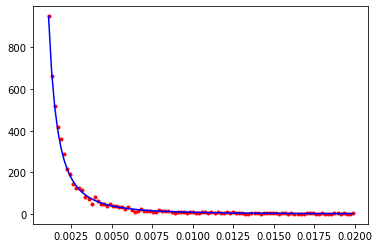

3809.430349078918


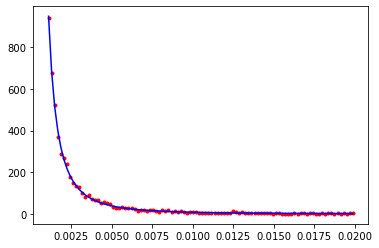

CPU times: user 74.5 ms, sys: 10.2 ms, total: 84.7 ms
Wall time: 28.5 ms
CPU times: user 34.5 ms, sys: 6.84 ms, total: 41.4 ms
Wall time: 13.9 ms
3705.5993373333854


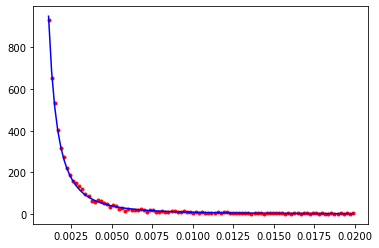

8049.421075785147


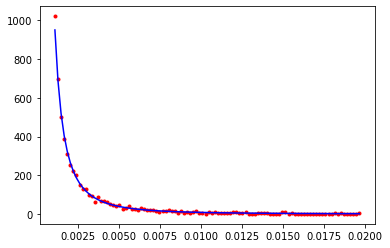

CPU times: user 75.7 ms, sys: 9.38 ms, total: 85.1 ms
Wall time: 28.4 ms
CPU times: user 34.8 ms, sys: 6.67 ms, total: 41.5 ms
Wall time: 13.8 ms
6534.792587092535


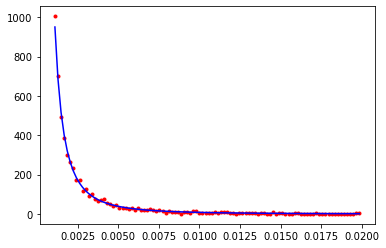

4040.211916427765


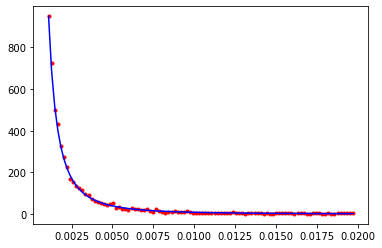

CPU times: user 73.4 ms, sys: 11.6 ms, total: 85 ms
Wall time: 29.3 ms
CPU times: user 36.6 ms, sys: 16.7 ms, total: 53.3 ms
Wall time: 18.3 ms
6073.678051070736


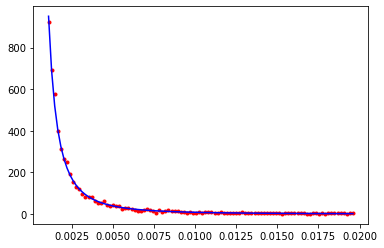

3053.130125369764


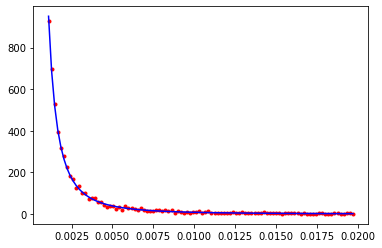

CPU times: user 74.3 ms, sys: 10.5 ms, total: 84.8 ms
Wall time: 28.7 ms
CPU times: user 36.1 ms, sys: 11.6 ms, total: 47.7 ms
Wall time: 16.1 ms
6746.690751930289


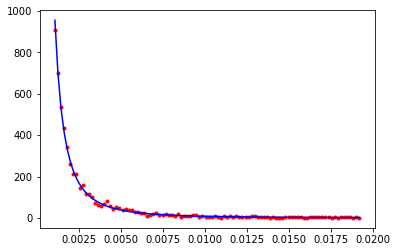

4299.280389212148


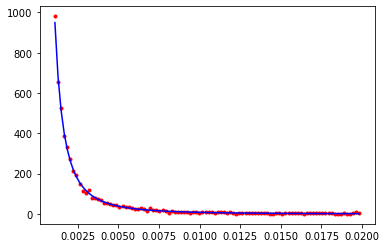

CPU times: user 73.1 ms, sys: 11.2 ms, total: 84.2 ms
Wall time: 28.7 ms
CPU times: user 35 ms, sys: 9.22 ms, total: 44.2 ms
Wall time: 14.9 ms
4181.177961439725


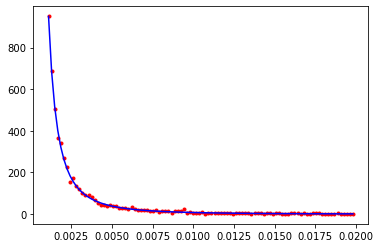

6572.52086294898


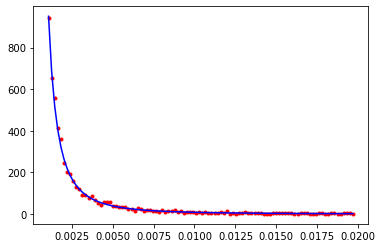

CPU times: user 74.2 ms, sys: 10.5 ms, total: 84.8 ms
Wall time: 28.7 ms
CPU times: user 38.2 ms, sys: 18.3 ms, total: 56.5 ms
Wall time: 18.4 ms
4147.413477729855


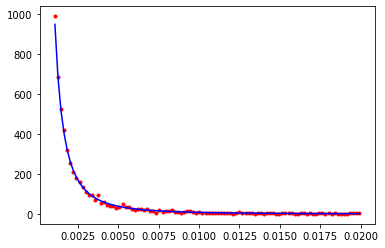

3360.382522453843


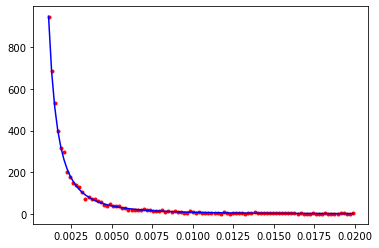

CPU times: user 85.6 ms, sys: 13.3 ms, total: 98.9 ms
Wall time: 33.8 ms
CPU times: user 16.9 ms, sys: 5.79 ms, total: 22.7 ms
Wall time: 15.9 ms
3468.73088059078


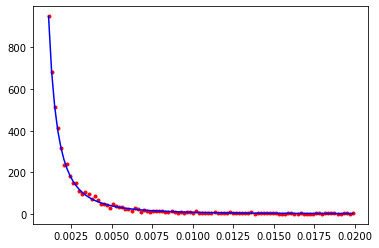

2264.544366001604


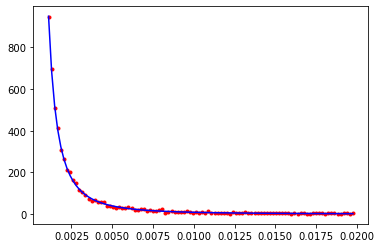

CPU times: user 74.6 ms, sys: 10.6 ms, total: 85.2 ms
Wall time: 28.8 ms
CPU times: user 42.4 ms, sys: 31.4 ms, total: 73.8 ms
Wall time: 24 ms
2512.26557084454


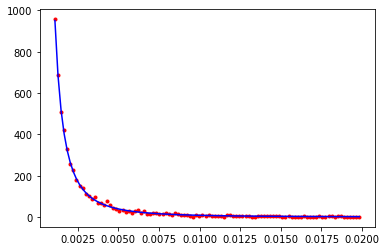

4348.553231115695


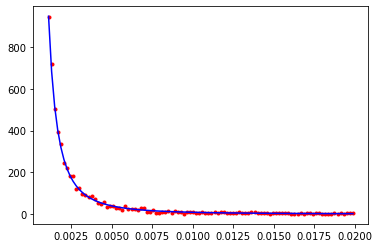

CPU times: user 75.2 ms, sys: 9.8 ms, total: 85 ms
Wall time: 28.5 ms
CPU times: user 35.4 ms, sys: 8.27 ms, total: 43.7 ms
Wall time: 14.6 ms
6183.474417996478


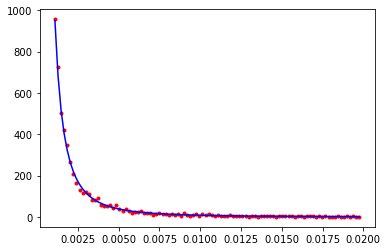

7816.105662493564


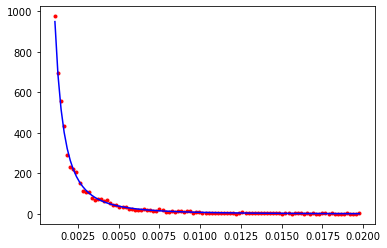

CPU times: user 73.9 ms, sys: 10.7 ms, total: 84.5 ms
Wall time: 28.6 ms
CPU times: user 35.1 ms, sys: 10.8 ms, total: 45.8 ms
Wall time: 15.4 ms
7862.445178643489


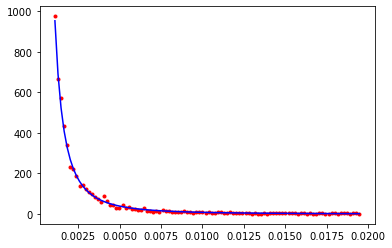

4968.642555534789


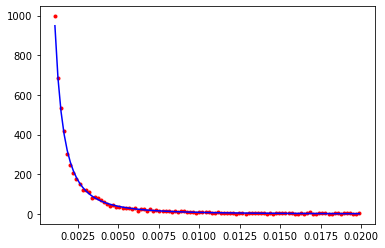

CPU times: user 74 ms, sys: 11 ms, total: 85 ms
Wall time: 28.9 ms
CPU times: user 35.5 ms, sys: 9.61 ms, total: 45.1 ms
Wall time: 15.2 ms
9335.849689908768


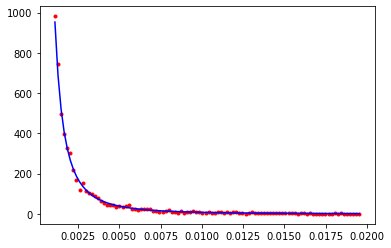

8763.142008667906


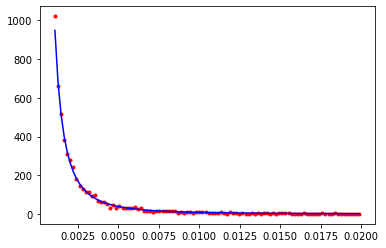

CPU times: user 76.3 ms, sys: 11.9 ms, total: 88.2 ms
Wall time: 30 ms
CPU times: user 17.4 ms, sys: 6.93 ms, total: 24.3 ms
Wall time: 17.8 ms
4194.559983335945


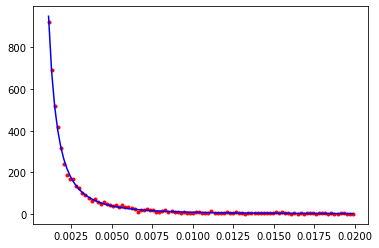

5265.754031214119


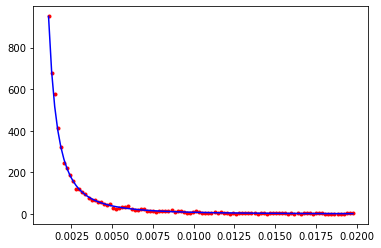

CPU times: user 71.1 ms, sys: 12.2 ms, total: 83.3 ms
Wall time: 28.6 ms
CPU times: user 35.7 ms, sys: 11.5 ms, total: 47.2 ms
Wall time: 15.9 ms
6483.624753456483


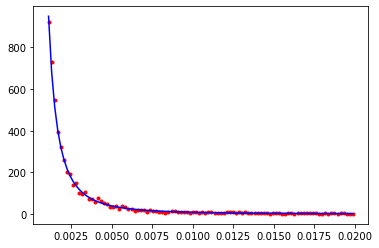

3820.7363042144752


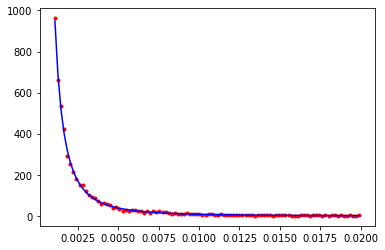

CPU times: user 33.6 ms, sys: 420 µs, total: 34 ms
Wall time: 34 ms
CPU times: user 15.8 ms, sys: 4.06 ms, total: 19.8 ms
Wall time: 17.1 ms
3129.614738452509


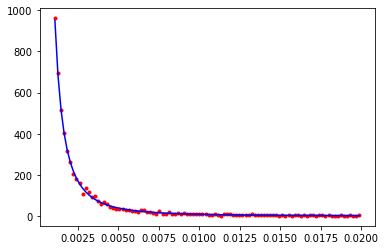

7770.40751905282


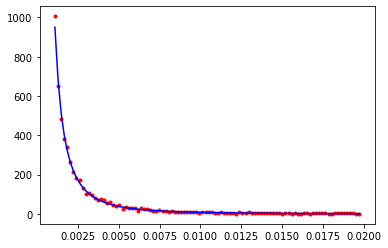

CPU times: user 71.9 ms, sys: 11.7 ms, total: 83.7 ms
Wall time: 28.6 ms
CPU times: user 35.3 ms, sys: 8.4 ms, total: 43.7 ms
Wall time: 14.6 ms
5845.083058715687


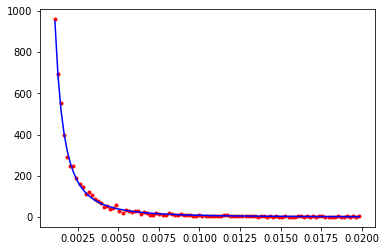

3549.7979181163114


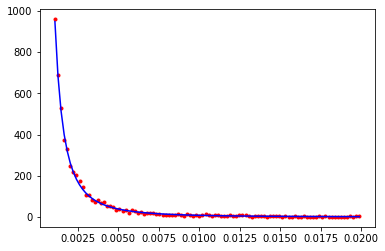

CPU times: user 73 ms, sys: 11.6 ms, total: 84.6 ms
Wall time: 28.9 ms
CPU times: user 34.8 ms, sys: 6.29 ms, total: 41.1 ms
Wall time: 13.8 ms
3909.2267403002547


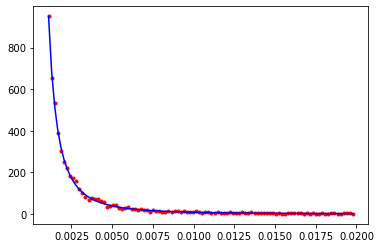

5932.726987248682


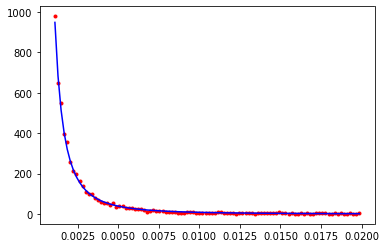

CPU times: user 71.9 ms, sys: 11.9 ms, total: 83.8 ms
Wall time: 28.7 ms
CPU times: user 40.1 ms, sys: 26.6 ms, total: 66.7 ms
Wall time: 21.4 ms
3204.2681880028576


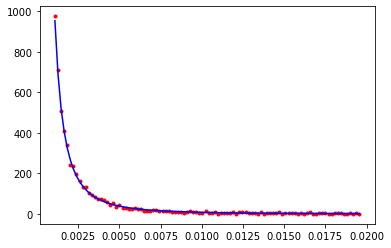

3514.6821553232826


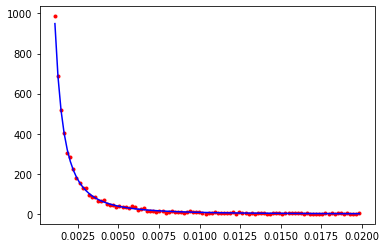

CPU times: user 73.7 ms, sys: 10.8 ms, total: 84.6 ms
Wall time: 28.6 ms
CPU times: user 35.2 ms, sys: 6.5 ms, total: 41.7 ms
Wall time: 13.9 ms
7016.116506995463


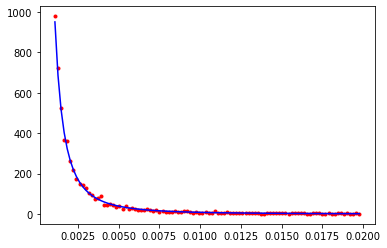

9798.431998292857


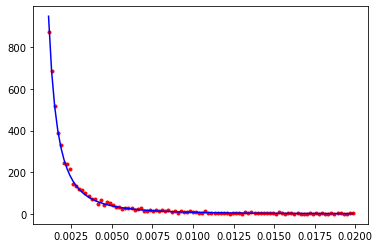

CPU times: user 74.6 ms, sys: 9.79 ms, total: 84.4 ms
Wall time: 28.3 ms
CPU times: user 35.7 ms, sys: 7.36 ms, total: 43 ms
Wall time: 14.4 ms
5672.235767381663


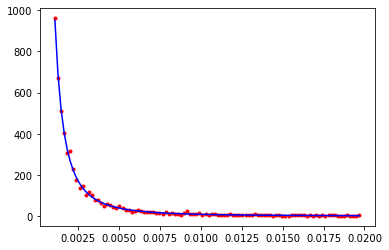

4993.422204725276


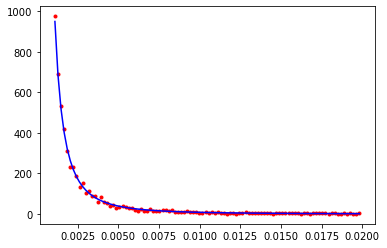

In [22]:
for _ in range(loops):
    %time r_everest = [ lib.get_random_ruth() for _ in range(n) ]
    %time r_k2      = [ k2ran.get_random_ruth(cgen) for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [23]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

72.64218109332218
72.79811954414686
[1.1829585  0.6784954  1.27178539 1.41043549 1.25270127 0.79759668
 1.11094948 1.23764157 0.76008188 0.88944905 1.25794003 1.03215994
 0.89250965 1.30267297 0.6346343  1.28319757 0.81174243 0.95481977
 0.84619432 1.06580559]
1.0587726574806369


In [24]:
lib.set_random_seed(1669281221)
k2ran.set_random_seed(1669281221)

mat = xc.materials.Lead
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

lib.set_rutherford_parameters(z,emr,t1)
cgen = k2ran.initialise_random_ruth(zatom=z, emr=emr, hcut=t1)

n = 5000
lib.set_rutherford_iterations(20)
bins = 100

loops = 20
S_everest = []
S_K2 = []
f = lambda x: PDF(x,z,emr)/CDF(t1,z,emr)

CPU times: user 31 ms, sys: 541 µs, total: 31.5 ms
Wall time: 31 ms
CPU times: user 13.6 ms, sys: 1.46 ms, total: 15.1 ms
Wall time: 14.4 ms
29768.482651922266


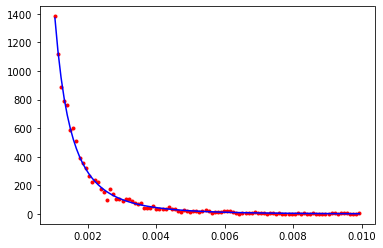

18942.76687605886


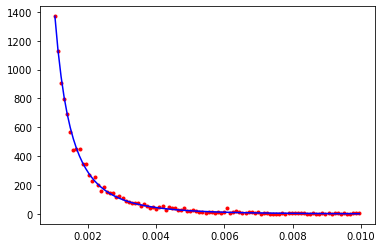

CPU times: user 83.6 ms, sys: 10.3 ms, total: 93.9 ms
Wall time: 31.4 ms
CPU times: user 43.7 ms, sys: 43 ms, total: 86.7 ms
Wall time: 27.6 ms
21834.064177152402


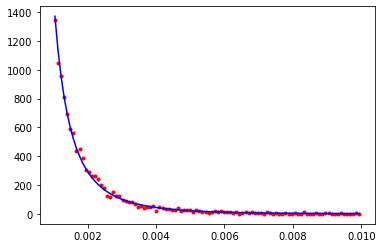

29059.18607822507


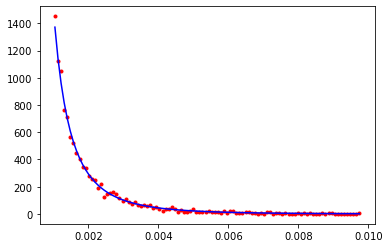

CPU times: user 83.2 ms, sys: 10.4 ms, total: 93.6 ms
Wall time: 31.3 ms
CPU times: user 41.7 ms, sys: 31.6 ms, total: 73.3 ms
Wall time: 23.2 ms
29093.713882094824


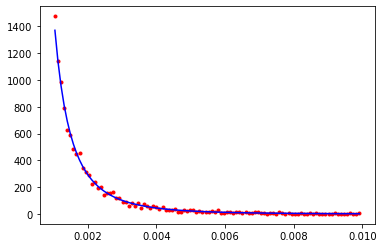

27949.533747491332


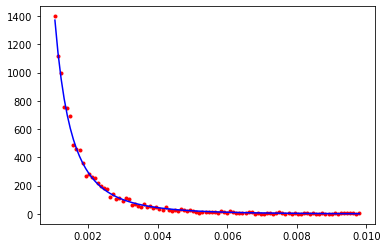

CPU times: user 81.7 ms, sys: 11.3 ms, total: 93 ms
Wall time: 31.3 ms
CPU times: user 34.3 ms, sys: 6.92 ms, total: 41.2 ms
Wall time: 13.7 ms
25406.569759544116


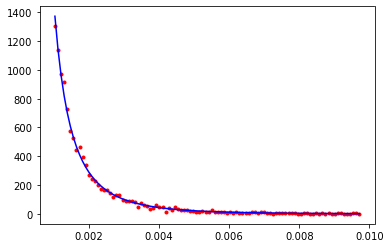

12581.235405347812


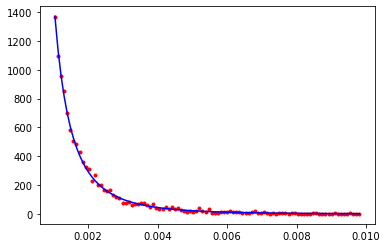

CPU times: user 83.3 ms, sys: 10.3 ms, total: 93.6 ms
Wall time: 31.3 ms
CPU times: user 34.1 ms, sys: 5.79 ms, total: 39.9 ms
Wall time: 13.3 ms
54835.92978093142


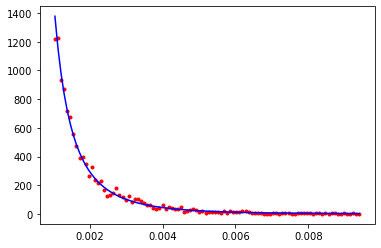

18641.04885358723


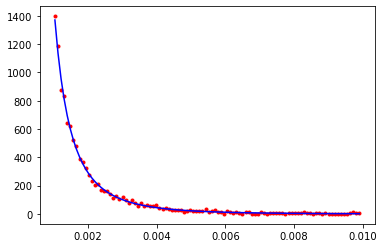

CPU times: user 82.2 ms, sys: 10.6 ms, total: 92.7 ms
Wall time: 31.1 ms
CPU times: user 34.2 ms, sys: 5.89 ms, total: 40.1 ms
Wall time: 13.4 ms
16322.818056003962


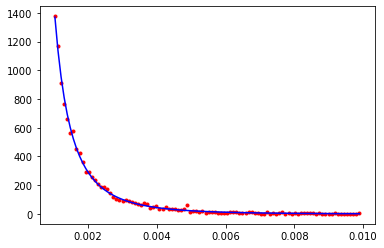

35761.85521772086


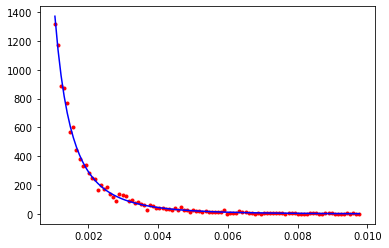

CPU times: user 83.4 ms, sys: 10.3 ms, total: 93.7 ms
Wall time: 31.3 ms
CPU times: user 35.1 ms, sys: 9.57 ms, total: 44.7 ms
Wall time: 14.9 ms
28738.81734331543


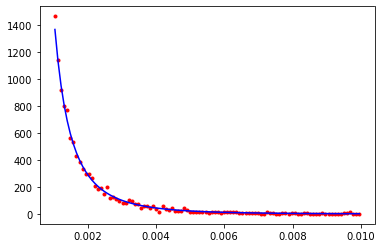

19047.63583076765


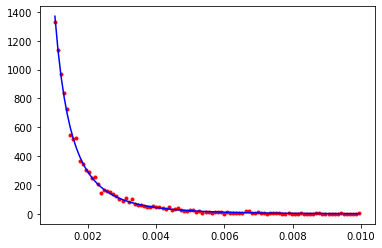

CPU times: user 82.9 ms, sys: 10.4 ms, total: 93.3 ms
Wall time: 31.2 ms
CPU times: user 41.7 ms, sys: 31.9 ms, total: 73.6 ms
Wall time: 23.3 ms
22987.587580519128


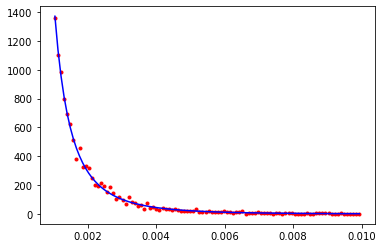

21100.902407674792


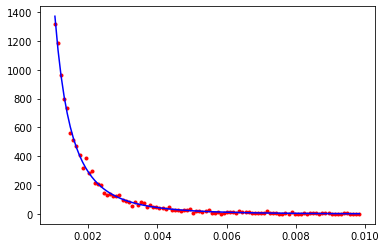

CPU times: user 82.4 ms, sys: 10.7 ms, total: 93.1 ms
Wall time: 31.2 ms
CPU times: user 35.3 ms, sys: 9.16 ms, total: 44.5 ms
Wall time: 14.8 ms
16180.778465308222


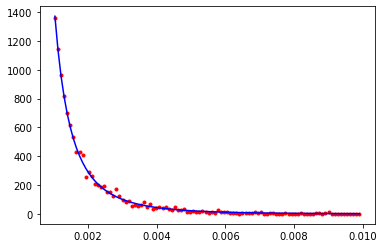

18244.668701735052


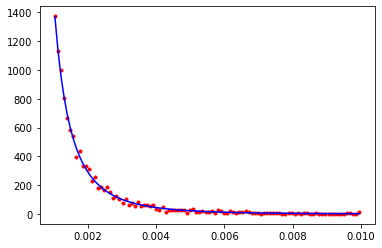

CPU times: user 82.2 ms, sys: 11.1 ms, total: 93.4 ms
Wall time: 31.6 ms
CPU times: user 35.3 ms, sys: 8.72 ms, total: 44 ms
Wall time: 14.7 ms
26994.341732610843


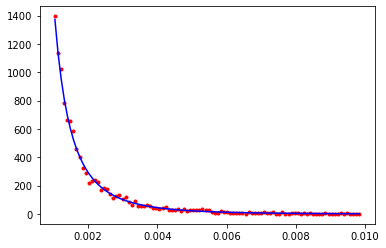

27067.2903726888


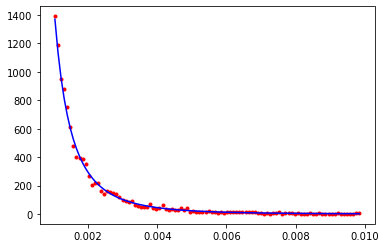

CPU times: user 82 ms, sys: 10.9 ms, total: 92.9 ms
Wall time: 31.1 ms
CPU times: user 34 ms, sys: 7.01 ms, total: 41 ms
Wall time: 13.8 ms
33262.48948756757


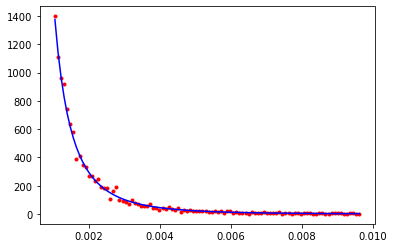

14945.077158618536


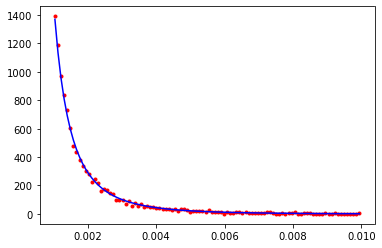

CPU times: user 81.4 ms, sys: 11.9 ms, total: 93.2 ms
Wall time: 31.6 ms
CPU times: user 33.7 ms, sys: 7.35 ms, total: 41 ms
Wall time: 14.1 ms
31190.032392319743


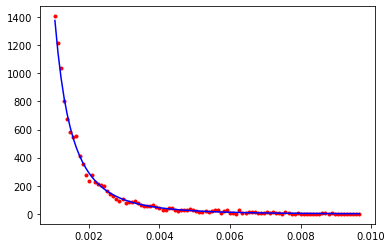

32076.722203812547


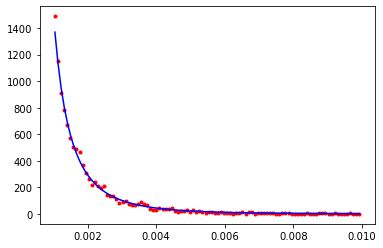

CPU times: user 80.6 ms, sys: 12.7 ms, total: 93.3 ms
Wall time: 31.8 ms
CPU times: user 33.3 ms, sys: 6.84 ms, total: 40.1 ms
Wall time: 13.7 ms
22028.015048612746


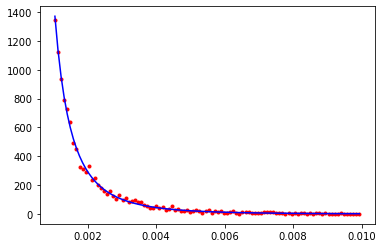

27298.016616461486


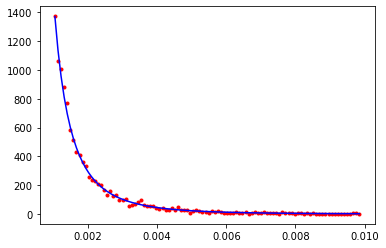

CPU times: user 82.2 ms, sys: 11 ms, total: 93.2 ms
Wall time: 31.4 ms
CPU times: user 34.2 ms, sys: 6.33 ms, total: 40.5 ms
Wall time: 13.6 ms
20588.35804928998


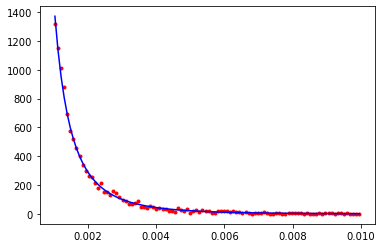

15333.639973815705


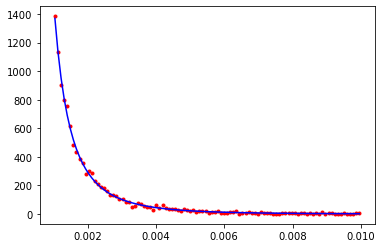

CPU times: user 81.4 ms, sys: 11.5 ms, total: 92.9 ms
Wall time: 31.5 ms
CPU times: user 35.1 ms, sys: 9.68 ms, total: 44.7 ms
Wall time: 15 ms
14728.026872568313


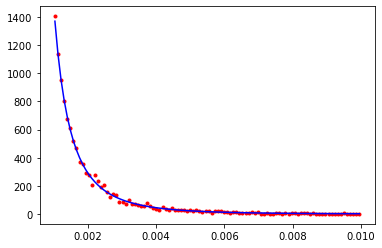

21849.958510791927


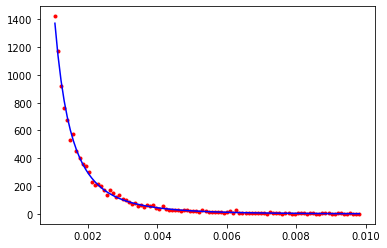

CPU times: user 80.8 ms, sys: 11.8 ms, total: 92.6 ms
Wall time: 31.4 ms
CPU times: user 43.3 ms, sys: 42.8 ms, total: 86 ms
Wall time: 27.8 ms
21446.293244880344


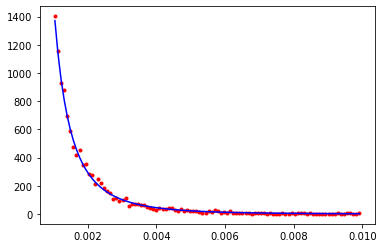

15219.941419949118


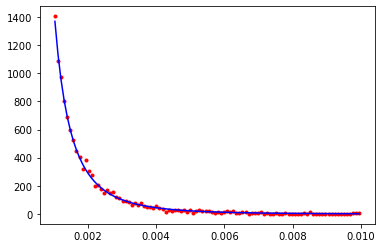

CPU times: user 81.3 ms, sys: 11.4 ms, total: 92.7 ms
Wall time: 31.3 ms
CPU times: user 34 ms, sys: 5.71 ms, total: 39.7 ms
Wall time: 13.4 ms
18003.95375323024


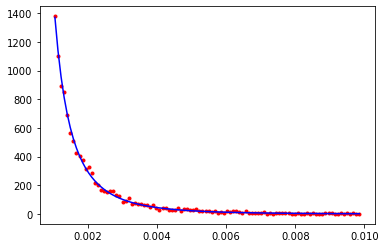

26677.497982442226


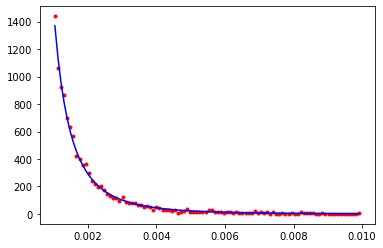

CPU times: user 81.5 ms, sys: 11.1 ms, total: 92.6 ms
Wall time: 31.2 ms
CPU times: user 35.3 ms, sys: 8.91 ms, total: 44.2 ms
Wall time: 14.7 ms
10443.475150483679


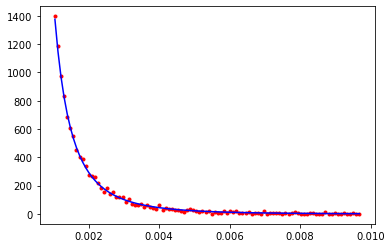

22051.666778752835


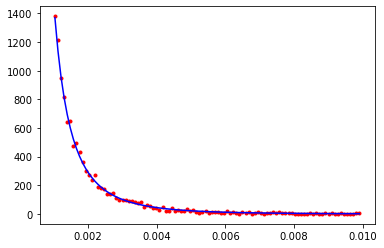

CPU times: user 91.1 ms, sys: 12.9 ms, total: 104 ms
Wall time: 35.1 ms
CPU times: user 40.6 ms, sys: 38.8 ms, total: 79.4 ms
Wall time: 27 ms
21713.656698883304


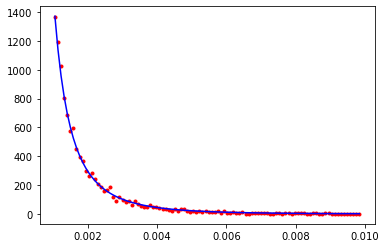

33697.07925694817


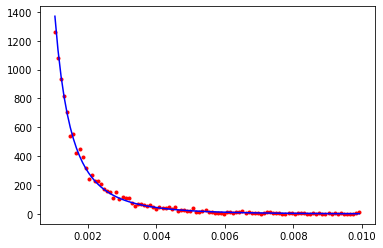

CPU times: user 82.8 ms, sys: 10.4 ms, total: 93.2 ms
Wall time: 31.2 ms
CPU times: user 34.2 ms, sys: 6.51 ms, total: 40.7 ms
Wall time: 13.6 ms
20943.98841280694


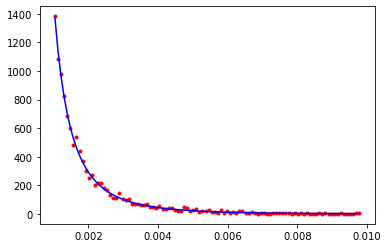

21571.49410833963


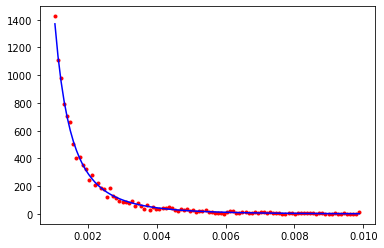

In [25]:
for _ in range(loops):
    %time r_everest = [ lib.get_random_ruth() for _ in range(n) ]
    %time r_k2      = [ k2ran.get_random_ruth(cgen) for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [26]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

155.96656573446205
151.51191661074543
[1.25359324 0.8668133  1.02026338 1.42105659 1.71513154 0.67559675
 1.22832674 1.04374927 0.94174151 0.99865155 1.49186077 0.98608175
 0.89830152 1.15874594 0.82100722 1.18705169 0.82150724 0.68817962
 0.80273159 0.98534787]
1.0830104030746417


## 5000 samples, 10 iterations

In [27]:
lib.set_random_seed(1669281221)
k2ran.set_random_seed(1669281221)

mat = xc.materials.Copper
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

lib.set_rutherford_parameters(z,emr,t1)
cgen = k2ran.initialise_random_ruth(zatom=z, emr=emr, hcut=t1)

n = 5000
lib.set_rutherford_iterations(10)
bins = 100

loops = 20
S_everest = []
S_K2 = []
f = lambda x: PDF(x,z,emr)/CDF(t1,z,emr)

CPU times: user 15.5 ms, sys: 615 µs, total: 16.1 ms
Wall time: 15.5 ms
CPU times: user 14.3 ms, sys: 3.13 ms, total: 17.5 ms
Wall time: 15.4 ms
30975.52986393182


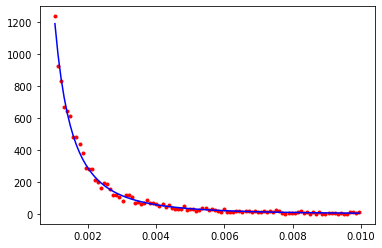

16326.253888455087


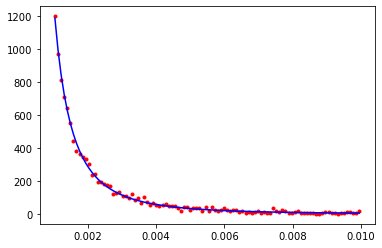

CPU times: user 40.9 ms, sys: 6.07 ms, total: 46.9 ms
Wall time: 15.9 ms
CPU times: user 36.5 ms, sys: 13 ms, total: 49.5 ms
Wall time: 16.4 ms
19761.521779061037


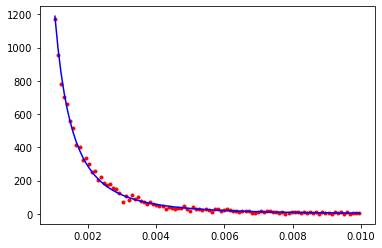

23262.532401250377


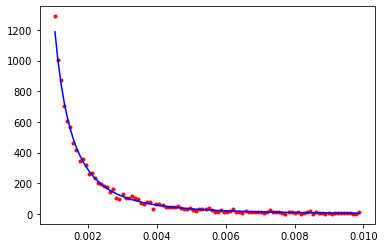

CPU times: user 41.6 ms, sys: 5.51 ms, total: 47.2 ms
Wall time: 15.8 ms
CPU times: user 43.3 ms, sys: 38.4 ms, total: 81.6 ms
Wall time: 25.5 ms
31838.602039256843


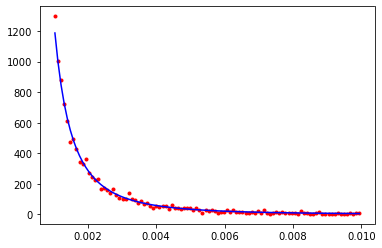

15796.700082084046


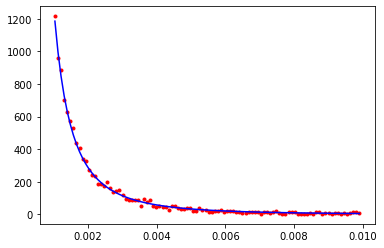

CPU times: user 40.5 ms, sys: 6.15 ms, total: 46.7 ms
Wall time: 15.8 ms
CPU times: user 42 ms, sys: 33.2 ms, total: 75.3 ms
Wall time: 23.9 ms
23946.488953264736


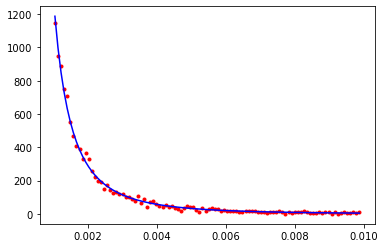

16050.625972424821


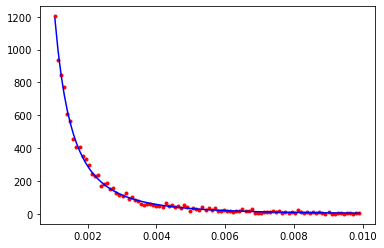

CPU times: user 40.9 ms, sys: 6.32 ms, total: 47.3 ms
Wall time: 16.2 ms
CPU times: user 34.9 ms, sys: 9.06 ms, total: 43.9 ms
Wall time: 14.7 ms
41962.563670355674


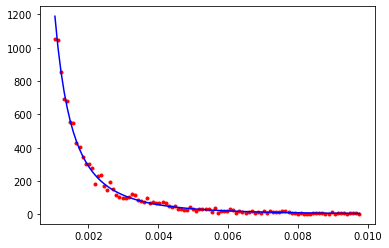

21224.72300801168


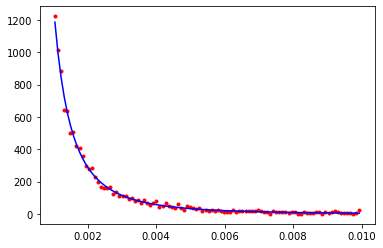

CPU times: user 40.3 ms, sys: 6.5 ms, total: 46.8 ms
Wall time: 16 ms
CPU times: user 34.6 ms, sys: 8.79 ms, total: 43.4 ms
Wall time: 14.7 ms
18895.30872787171


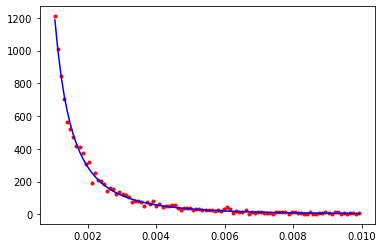

24334.16320841606


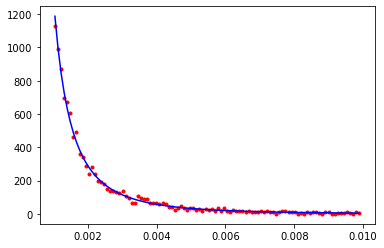

CPU times: user 40.7 ms, sys: 6.09 ms, total: 46.8 ms
Wall time: 15.9 ms
CPU times: user 34.7 ms, sys: 9.14 ms, total: 43.9 ms
Wall time: 14.9 ms
29814.388064335813


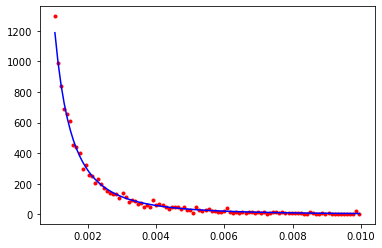

17340.067152407246


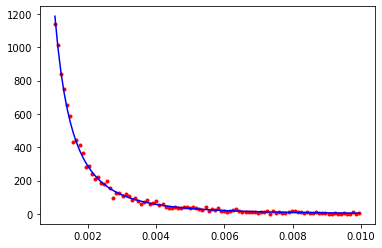

CPU times: user 41.4 ms, sys: 5.6 ms, total: 47 ms
Wall time: 15.7 ms
CPU times: user 36.6 ms, sys: 9.65 ms, total: 46.3 ms
Wall time: 15.3 ms
18336.068613893753


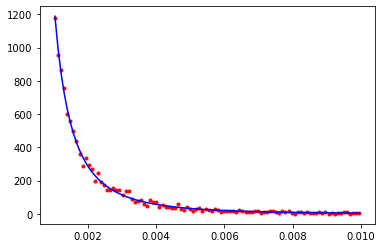

22794.749343411833


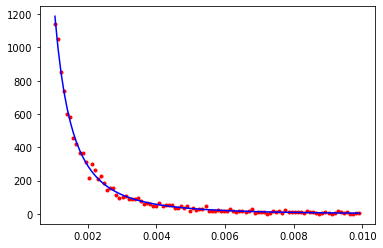

CPU times: user 39.3 ms, sys: 7.13 ms, total: 46.5 ms
Wall time: 16.1 ms
CPU times: user 36.6 ms, sys: 15.3 ms, total: 51.8 ms
Wall time: 17.5 ms
12001.392320137553


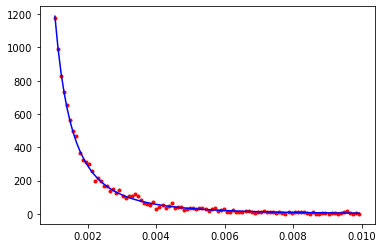

16193.329812112608


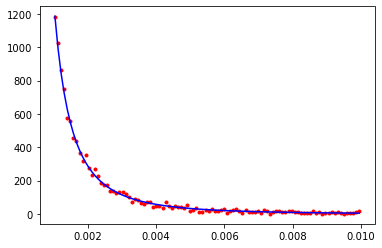

CPU times: user 41.2 ms, sys: 5.42 ms, total: 46.7 ms
Wall time: 15.7 ms
CPU times: user 35.4 ms, sys: 9.1 ms, total: 44.5 ms
Wall time: 14.7 ms
23265.75569113948


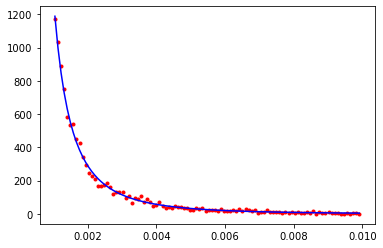

27831.15282156286


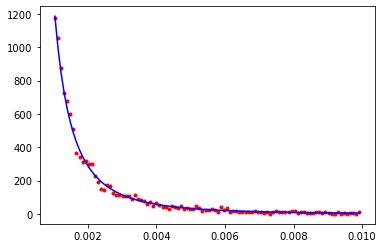

CPU times: user 40.5 ms, sys: 6.51 ms, total: 47 ms
Wall time: 16 ms
CPU times: user 34.4 ms, sys: 7.29 ms, total: 41.7 ms
Wall time: 14.1 ms
25428.94203568725


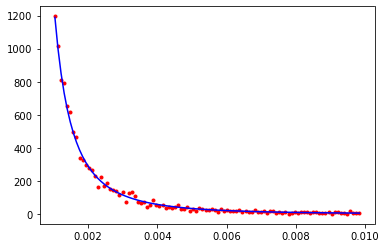

26753.905550980526


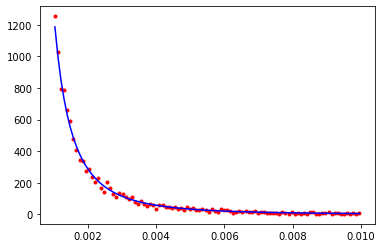

CPU times: user 40.5 ms, sys: 5.46 ms, total: 45.9 ms
Wall time: 15.9 ms
CPU times: user 34.2 ms, sys: 6.99 ms, total: 41.2 ms
Wall time: 13.8 ms
29765.84047266045


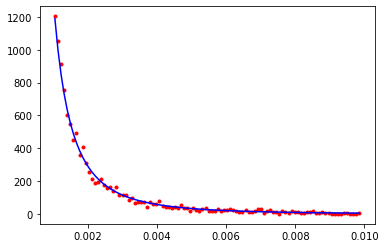

23840.76089012738


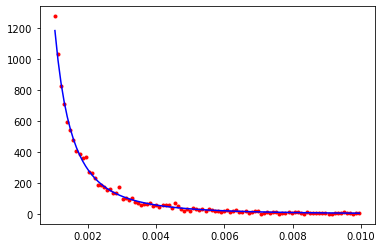

CPU times: user 40.1 ms, sys: 6.39 ms, total: 46.5 ms
Wall time: 15.9 ms
CPU times: user 36.2 ms, sys: 11.8 ms, total: 48 ms
Wall time: 15.8 ms
20702.273517298025


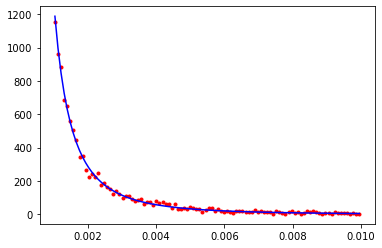

26529.892425471597


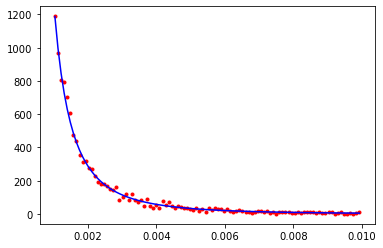

CPU times: user 40.3 ms, sys: 6.29 ms, total: 46.5 ms
Wall time: 15.9 ms
CPU times: user 33.3 ms, sys: 6.01 ms, total: 39.3 ms
Wall time: 13.4 ms
26214.236414579067


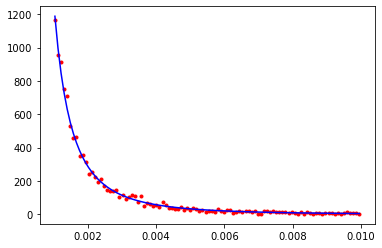

16962.603278815342


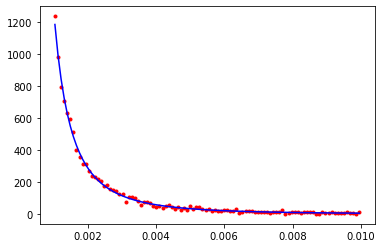

CPU times: user 40.8 ms, sys: 6.5 ms, total: 47.3 ms
Wall time: 16.1 ms
CPU times: user 34 ms, sys: 7.22 ms, total: 41.2 ms
Wall time: 14.2 ms
24860.59494934297


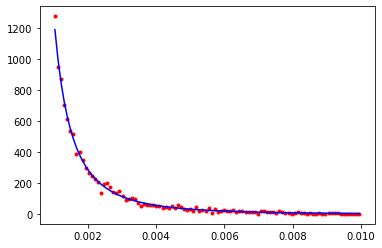

28281.79769832608


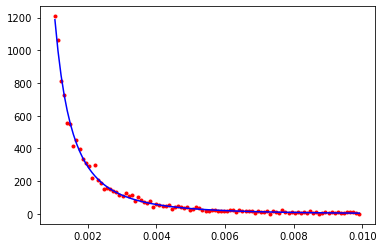

CPU times: user 41.2 ms, sys: 6.2 ms, total: 47.4 ms
Wall time: 16 ms
CPU times: user 34.9 ms, sys: 9.59 ms, total: 44.5 ms
Wall time: 15.1 ms
21800.0599572707


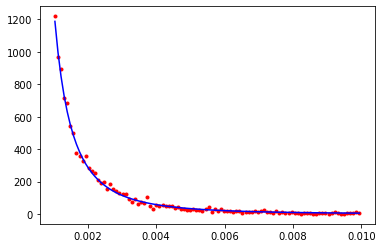

12820.303690006225


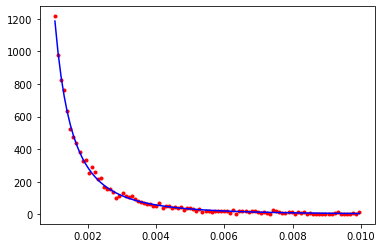

CPU times: user 41 ms, sys: 6.05 ms, total: 47 ms
Wall time: 15.8 ms
CPU times: user 35 ms, sys: 7.73 ms, total: 42.7 ms
Wall time: 14.4 ms
19533.387846279118


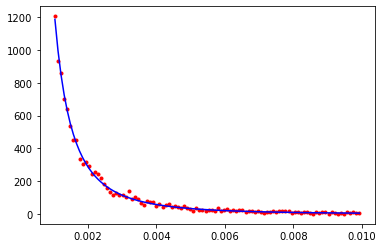

23148.44252267499


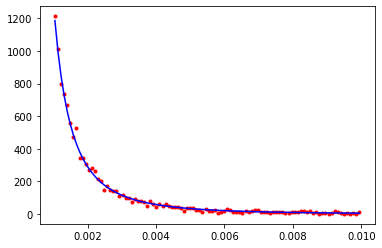

CPU times: user 40.4 ms, sys: 6.53 ms, total: 47 ms
Wall time: 16 ms
CPU times: user 34.6 ms, sys: 6.07 ms, total: 40.7 ms
Wall time: 13.7 ms
13043.850819205225


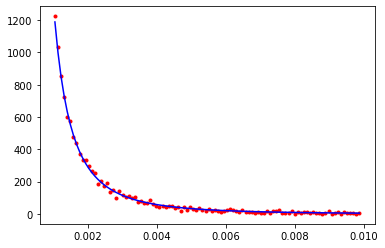

17329.163941793


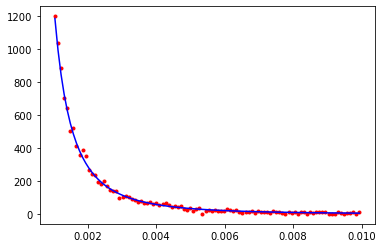

CPU times: user 40.8 ms, sys: 6.37 ms, total: 47.2 ms
Wall time: 16 ms
CPU times: user 40.8 ms, sys: 26.6 ms, total: 67.4 ms
Wall time: 21.6 ms
24186.728111507997


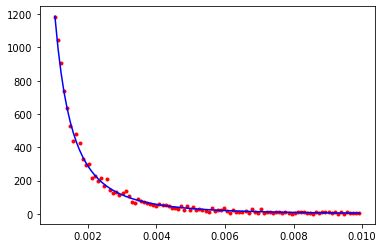

26059.43449973095


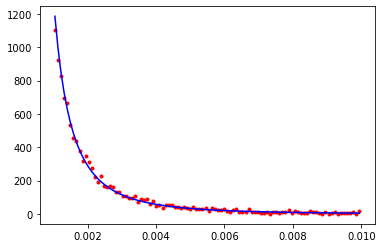

CPU times: user 40.5 ms, sys: 6.46 ms, total: 46.9 ms
Wall time: 16 ms
CPU times: user 34.9 ms, sys: 9.25 ms, total: 44.1 ms
Wall time: 14.8 ms
20032.35298422398


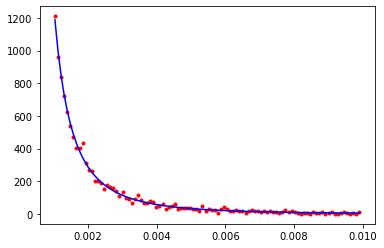

23704.474527562852


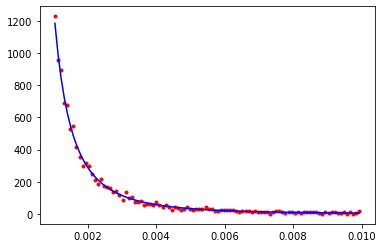

In [28]:
for _ in range(loops):
    %time r_everest = [ lib.get_random_ruth() for _ in range(n) ]
    %time r_k2      = [ k2ran.get_random_ruth(cgen) for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [29]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

154.3317671173539
146.0453827951479
[1.37741909 0.92168325 1.41969093 1.22144787 1.40607987 0.88118843
 1.31125622 0.89688281 0.86089014 0.91430898 0.97492353 1.11737518
 0.88336721 1.24314662 0.93756687 1.30400629 0.91860308 0.86758914
 0.96339873 0.91928636]
1.0858790015951922


In [30]:
lib.set_random_seed(1669281221)
k2ran.set_random_seed(1669281221)

mat = xc.materials.Berylium
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

lib.set_rutherford_parameters(z,emr,t1)
cgen = k2ran.initialise_random_ruth(zatom=z, emr=emr, hcut=t1)

n = 5000
lib.set_rutherford_iterations(10)
bins = 100

loops = 20
S_everest = []
S_K2 = []
f = lambda x: PDF(x,z,emr)/CDF(t1,z,emr)

CPU times: user 17.2 ms, sys: 780 µs, total: 18 ms
Wall time: 17.4 ms
CPU times: user 17.2 ms, sys: 6.88 ms, total: 24.1 ms
Wall time: 19.2 ms
5330.881825930372


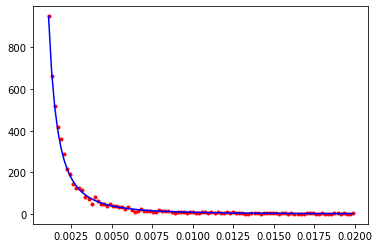

3809.430349078918


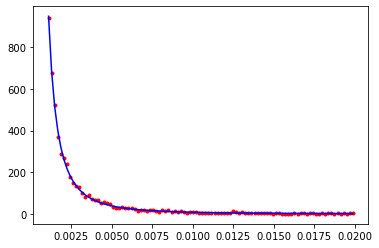

CPU times: user 39 ms, sys: 5.46 ms, total: 44.4 ms
Wall time: 15 ms
CPU times: user 34.8 ms, sys: 7.49 ms, total: 42.3 ms
Wall time: 14.1 ms
3705.5926056578865


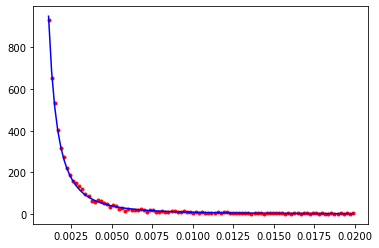

8049.421075785147


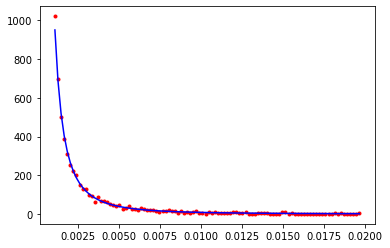

CPU times: user 37.8 ms, sys: 6.07 ms, total: 43.8 ms
Wall time: 15 ms
CPU times: user 35.3 ms, sys: 8.43 ms, total: 43.7 ms
Wall time: 14.5 ms
6534.797787727478


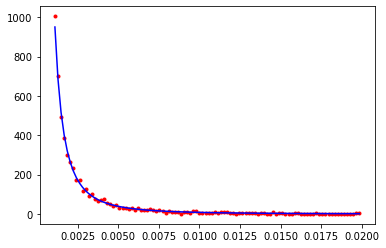

4040.211916427765


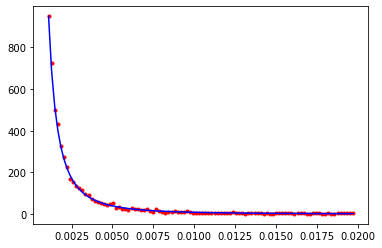

CPU times: user 39 ms, sys: 5.35 ms, total: 44.3 ms
Wall time: 14.9 ms
CPU times: user 34.6 ms, sys: 8.59 ms, total: 43.2 ms
Wall time: 14.6 ms
6073.676462283608


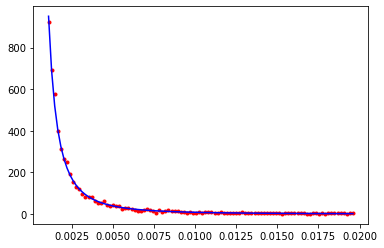

3053.130125369764


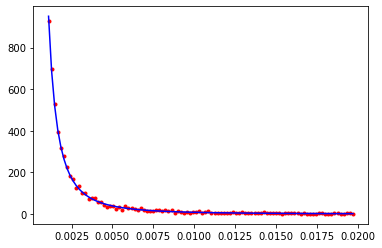

CPU times: user 39.1 ms, sys: 5.32 ms, total: 44.4 ms
Wall time: 14.9 ms
CPU times: user 35.2 ms, sys: 9.9 ms, total: 45.1 ms
Wall time: 15.1 ms
6746.689232136242


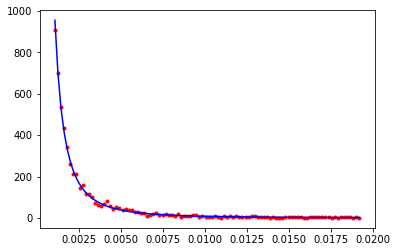

4299.280389212148


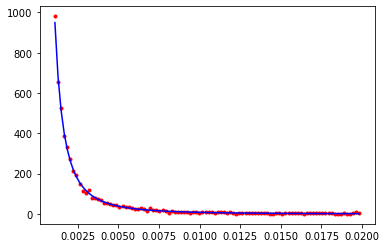

CPU times: user 39 ms, sys: 5.67 ms, total: 44.7 ms
Wall time: 15.1 ms
CPU times: user 36.7 ms, sys: 12.2 ms, total: 48.9 ms
Wall time: 16.1 ms
4181.179377016633


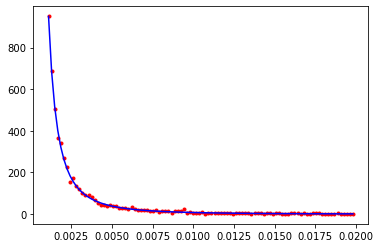

6572.52086294898


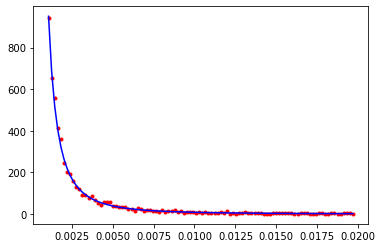

CPU times: user 38.7 ms, sys: 5.63 ms, total: 44.4 ms
Wall time: 15 ms
CPU times: user 35 ms, sys: 9.22 ms, total: 44.2 ms
Wall time: 14.8 ms
4147.407591993057


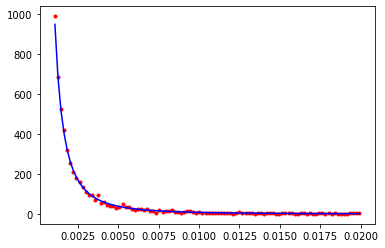

3360.382522453843


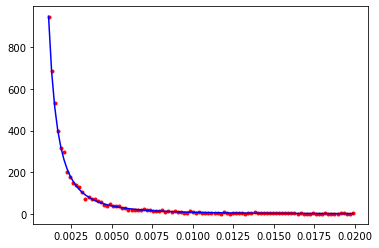

CPU times: user 39.2 ms, sys: 5.26 ms, total: 44.5 ms
Wall time: 14.9 ms
CPU times: user 35 ms, sys: 9.11 ms, total: 44.1 ms
Wall time: 14.8 ms
3468.7310815499404


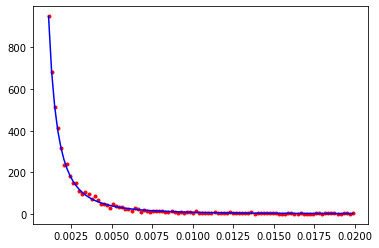

2264.544366001604


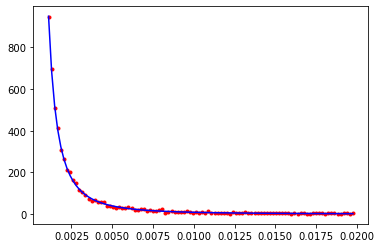

CPU times: user 37.9 ms, sys: 6.13 ms, total: 44.1 ms
Wall time: 15 ms
CPU times: user 37.9 ms, sys: 20 ms, total: 57.9 ms
Wall time: 18.8 ms
2512.270208150595


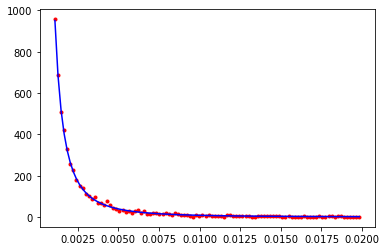

4348.553231115695


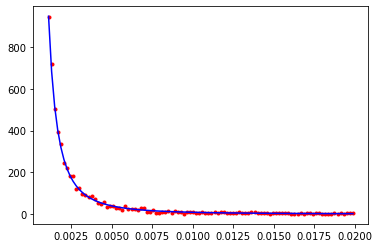

CPU times: user 38.7 ms, sys: 6.13 ms, total: 44.8 ms
Wall time: 15.3 ms
CPU times: user 35.2 ms, sys: 7.4 ms, total: 42.5 ms
Wall time: 14.2 ms
6183.46907170317


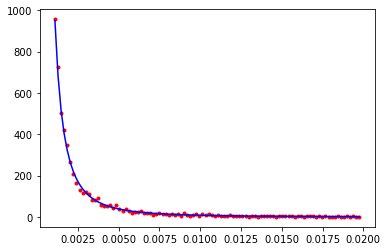

7816.105662493564


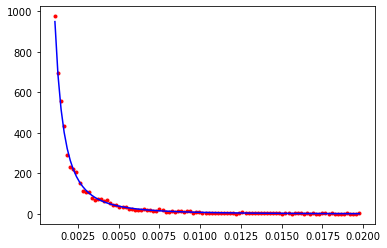

CPU times: user 38.2 ms, sys: 6.34 ms, total: 44.5 ms
Wall time: 15.2 ms
CPU times: user 34.6 ms, sys: 6.44 ms, total: 41 ms
Wall time: 13.8 ms
7862.440331591628


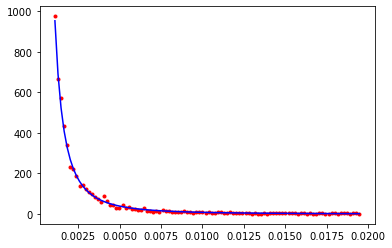

4968.642555534789


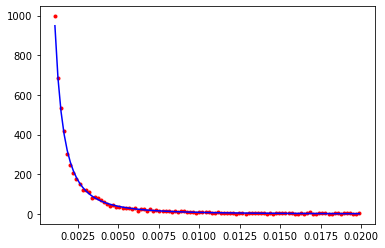

CPU times: user 39.1 ms, sys: 5.4 ms, total: 44.5 ms
Wall time: 15 ms
CPU times: user 41.3 ms, sys: 29.7 ms, total: 71 ms
Wall time: 22.7 ms
9335.856222459495


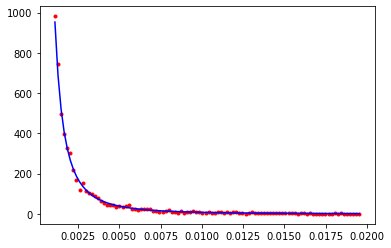

8763.142008667906


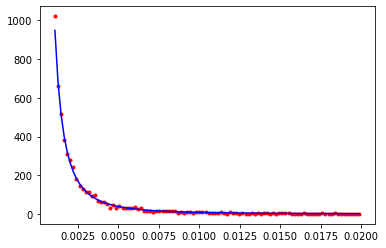

CPU times: user 37.8 ms, sys: 6.54 ms, total: 44.3 ms
Wall time: 15.2 ms
CPU times: user 43.9 ms, sys: 37.5 ms, total: 81.4 ms
Wall time: 25.7 ms
4194.550907039725


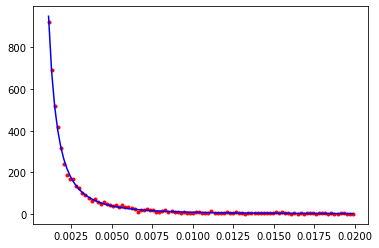

5265.754031214119


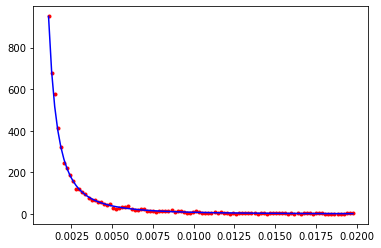

CPU times: user 39.8 ms, sys: 6.25 ms, total: 46.1 ms
Wall time: 15.6 ms
CPU times: user 34.3 ms, sys: 7.01 ms, total: 41.3 ms
Wall time: 13.9 ms
6483.623729252958


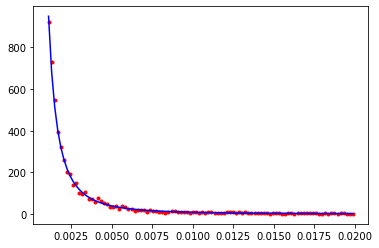

3820.7363042144752


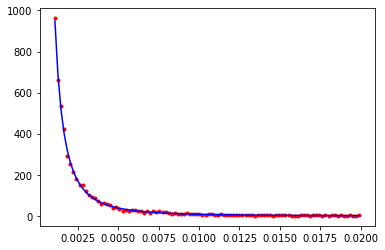

CPU times: user 38.8 ms, sys: 5.3 ms, total: 44.1 ms
Wall time: 14.8 ms
CPU times: user 34.3 ms, sys: 6.92 ms, total: 41.2 ms
Wall time: 13.9 ms
3129.6133139990043


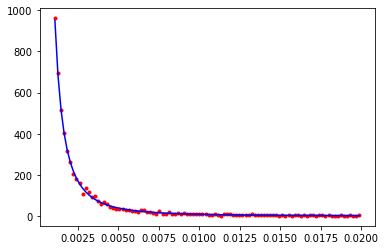

7770.40751905282


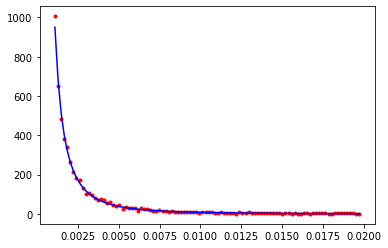

CPU times: user 39 ms, sys: 5.39 ms, total: 44.4 ms
Wall time: 14.9 ms
CPU times: user 34.5 ms, sys: 7.26 ms, total: 41.8 ms
Wall time: 14.1 ms
5845.082175948306


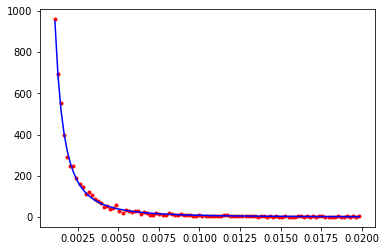

3549.7979181163114


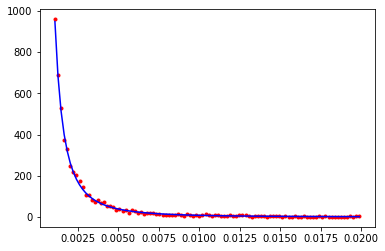

CPU times: user 39.1 ms, sys: 5.41 ms, total: 44.5 ms
Wall time: 15 ms
CPU times: user 34.5 ms, sys: 6.27 ms, total: 40.8 ms
Wall time: 13.7 ms
3909.221303266697


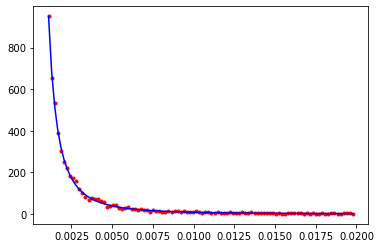

5932.726987248682


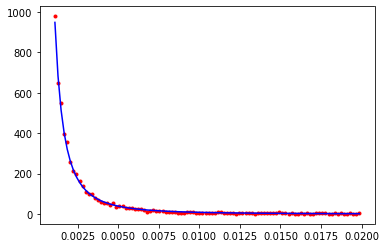

CPU times: user 38.3 ms, sys: 6.12 ms, total: 44.4 ms
Wall time: 15.1 ms
CPU times: user 35.8 ms, sys: 7.82 ms, total: 43.7 ms
Wall time: 14.6 ms
3204.2700041520657


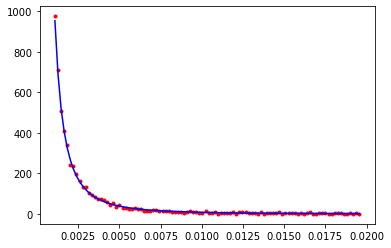

3514.6821553232826


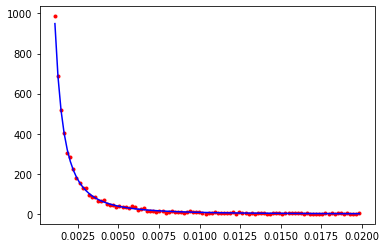

CPU times: user 38.5 ms, sys: 5.92 ms, total: 44.4 ms
Wall time: 15 ms
CPU times: user 34.2 ms, sys: 8.21 ms, total: 42.4 ms
Wall time: 14.3 ms
7016.124473286608


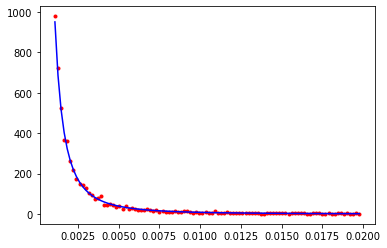

9798.431998292857


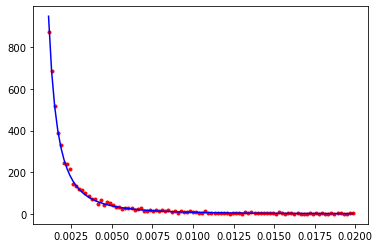

CPU times: user 39 ms, sys: 5.23 ms, total: 44.2 ms
Wall time: 14.8 ms
CPU times: user 44.9 ms, sys: 44.8 ms, total: 89.7 ms
Wall time: 28.1 ms
5672.235780878364


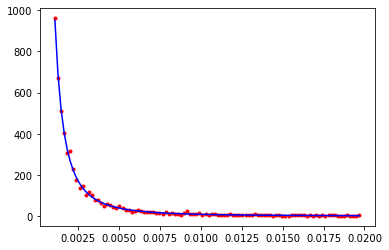

4993.422204725276


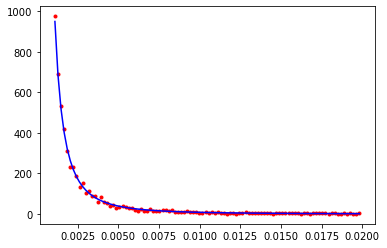

In [31]:
for _ in range(loops):
    %time r_everest = [ lib.get_random_ruth() for _ in range(n) ]
    %time r_k2      = [ k2ran.get_random_ruth(cgen) for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [32]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

72.6421755889868
72.79811954414686
[1.1829585  0.67849478 1.2717859  1.4104353  1.25270113 0.79759682
 1.11094869 1.2376416  0.76008258 0.88944866 1.25793964 1.0321603
 0.89250868 1.30267287 0.63463416 1.28319747 0.81174187 0.95482004
 0.8461948  1.06580559]
1.0587725694288548


In [33]:
lib.set_random_seed(1669281221)
k2ran.set_random_seed(1669281221)

mat = xc.materials.Lead
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

lib.set_rutherford_parameters(z,emr,t1)
cgen = k2ran.initialise_random_ruth(zatom=z, emr=emr, hcut=t1)

n = 5000
lib.set_rutherford_iterations(10)
bins = 100

loops = 20
S_everest = []
S_K2 = []
f = lambda x: PDF(x,z,emr)/CDF(t1,z,emr)

CPU times: user 18.6 ms, sys: 717 µs, total: 19.3 ms
Wall time: 18.7 ms
CPU times: user 14.3 ms, sys: 2.28 ms, total: 16.5 ms
Wall time: 15.1 ms
29768.480672518148


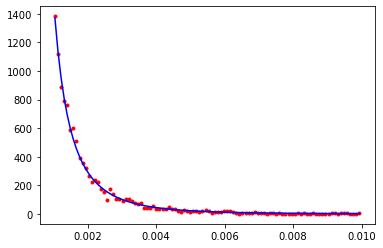

18942.76687605886


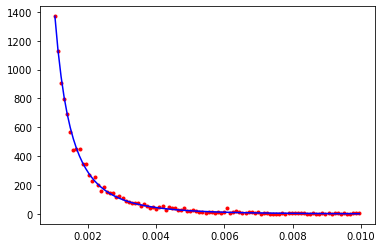

CPU times: user 43.7 ms, sys: 6.1 ms, total: 49.8 ms
Wall time: 16.8 ms
CPU times: user 46.6 ms, sys: 46 ms, total: 92.6 ms
Wall time: 28.9 ms
21834.07296374382


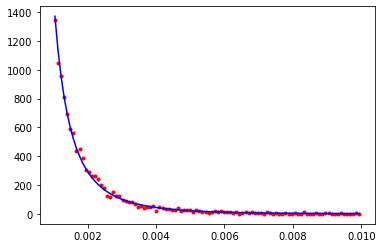

29059.18607822507


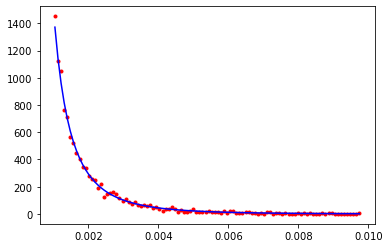

CPU times: user 42.5 ms, sys: 7.02 ms, total: 49.5 ms
Wall time: 16.9 ms
CPU times: user 34.7 ms, sys: 10.3 ms, total: 45 ms
Wall time: 15.2 ms
29093.73925329267


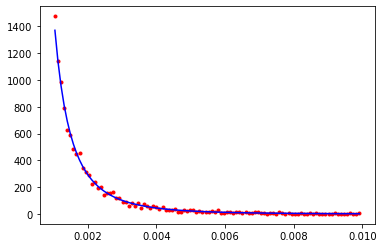

27949.533747491332


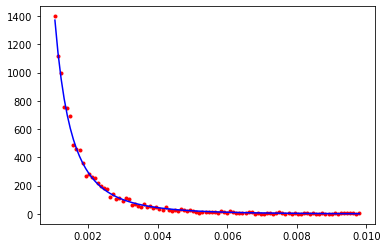

CPU times: user 41.9 ms, sys: 7.14 ms, total: 49.1 ms
Wall time: 16.9 ms
CPU times: user 36 ms, sys: 14 ms, total: 50 ms
Wall time: 16.8 ms
25406.569729432184


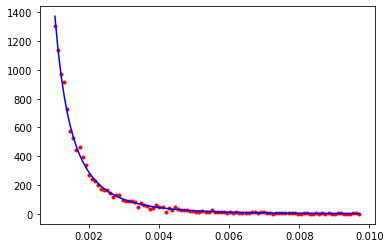

12581.235405347812


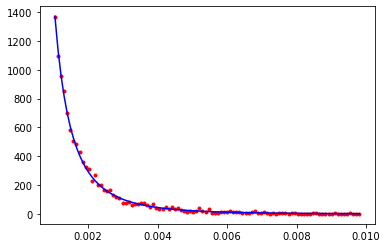

CPU times: user 42.5 ms, sys: 6.05 ms, total: 48.5 ms
Wall time: 16.4 ms
CPU times: user 33.8 ms, sys: 7.93 ms, total: 41.7 ms
Wall time: 14.2 ms
54835.990176865394


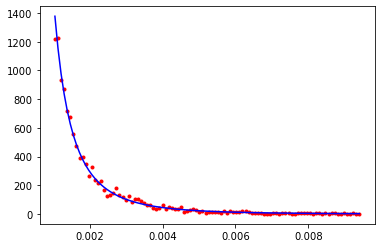

18641.04885358723


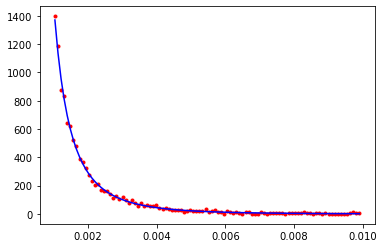

CPU times: user 41.9 ms, sys: 6.7 ms, total: 48.6 ms
Wall time: 16.5 ms
CPU times: user 36 ms, sys: 11.9 ms, total: 47.9 ms
Wall time: 15.8 ms
16322.813209358805


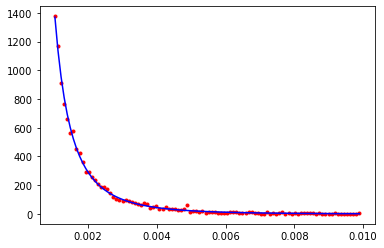

35761.85521772086


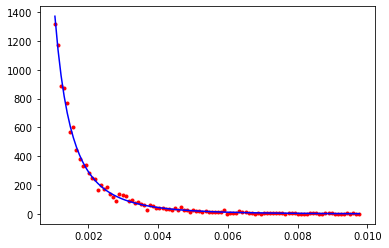

CPU times: user 41.8 ms, sys: 6.63 ms, total: 48.5 ms
Wall time: 16.5 ms
CPU times: user 36.4 ms, sys: 13 ms, total: 49.4 ms
Wall time: 16.3 ms
28738.798795870753


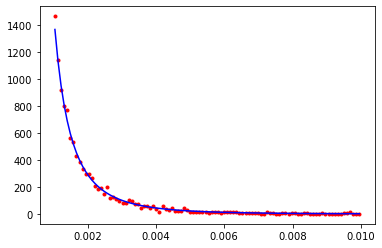

19047.63583076765


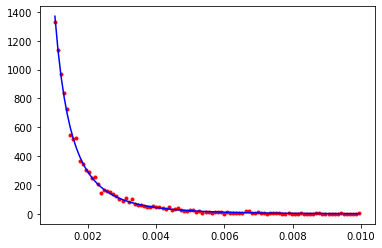

CPU times: user 41.7 ms, sys: 7.23 ms, total: 48.9 ms
Wall time: 16.8 ms
CPU times: user 33.9 ms, sys: 8.29 ms, total: 42.2 ms
Wall time: 14.6 ms
22987.59091574002


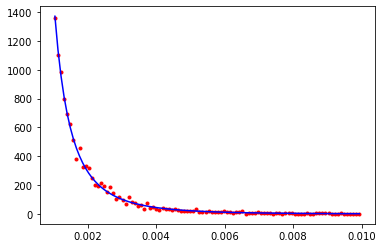

21100.902407674792


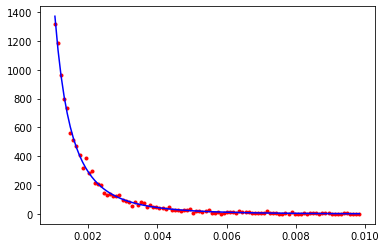

CPU times: user 43.1 ms, sys: 5.64 ms, total: 48.7 ms
Wall time: 16.3 ms
CPU times: user 35.2 ms, sys: 8.56 ms, total: 43.8 ms
Wall time: 14.6 ms
16180.77808290812


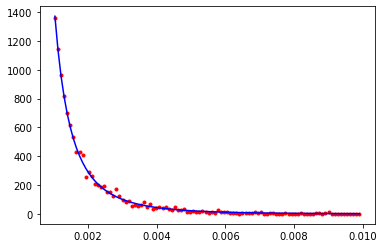

18244.668701735052


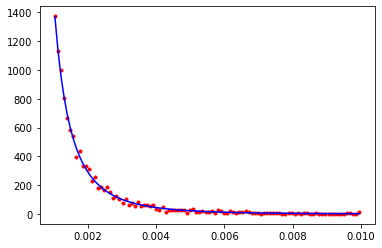

CPU times: user 43.3 ms, sys: 5.62 ms, total: 48.9 ms
Wall time: 16.4 ms
CPU times: user 45 ms, sys: 42.3 ms, total: 87.2 ms
Wall time: 27.3 ms
26994.346511865548


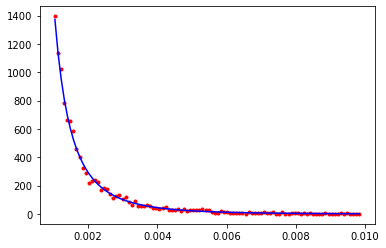

27067.2903726888


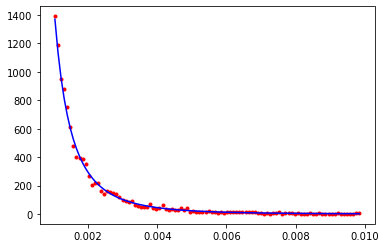

CPU times: user 43.3 ms, sys: 5.72 ms, total: 49 ms
Wall time: 16.4 ms
CPU times: user 45.6 ms, sys: 44.8 ms, total: 90.3 ms
Wall time: 28.3 ms
33262.49229662372


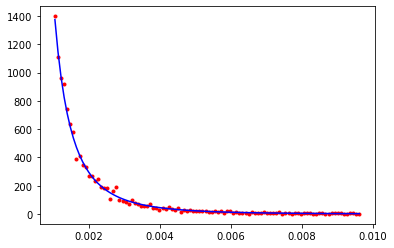

14945.077158618536


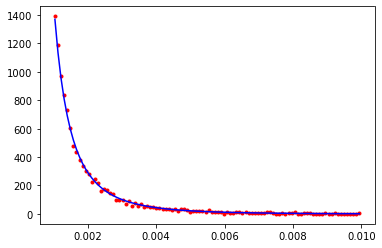

CPU times: user 43.1 ms, sys: 5.64 ms, total: 48.8 ms
Wall time: 16.3 ms
CPU times: user 34.5 ms, sys: 7.15 ms, total: 41.7 ms
Wall time: 13.9 ms
31190.068740513478


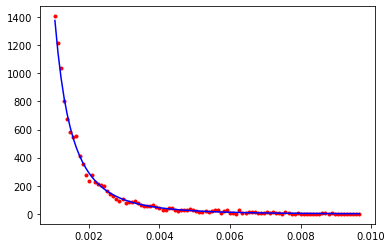

32076.722203812547


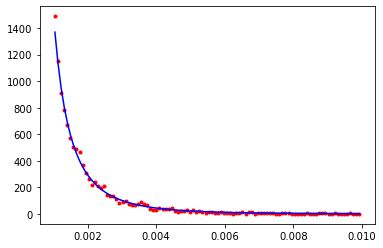

CPU times: user 46.1 ms, sys: 7.84 ms, total: 53.9 ms
Wall time: 18.5 ms
CPU times: user 34.7 ms, sys: 7.76 ms, total: 42.5 ms
Wall time: 14.4 ms
22028.0390607176


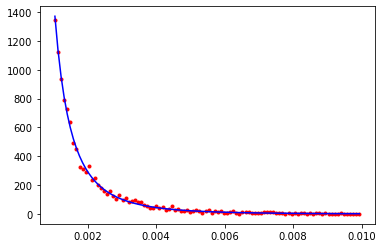

27298.016616461486


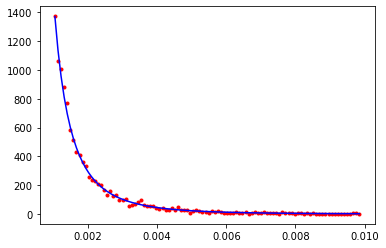

CPU times: user 42.6 ms, sys: 6.44 ms, total: 49 ms
Wall time: 16.7 ms
CPU times: user 34.4 ms, sys: 8.37 ms, total: 42.8 ms
Wall time: 14.3 ms
20588.360766261827


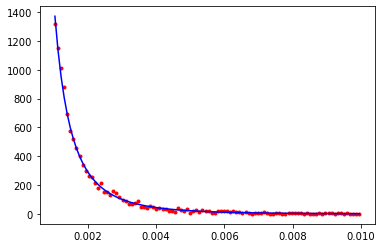

15333.639973815705


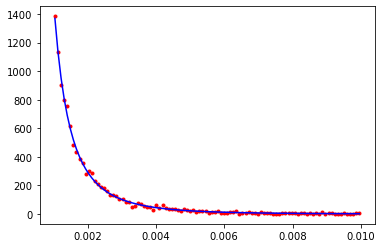

CPU times: user 43.5 ms, sys: 6.6 ms, total: 50.1 ms
Wall time: 17 ms
CPU times: user 37.2 ms, sys: 10.4 ms, total: 47.6 ms
Wall time: 15.9 ms
14728.026125911078


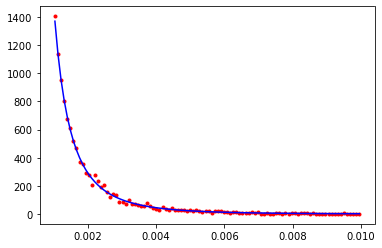

21849.958510791927


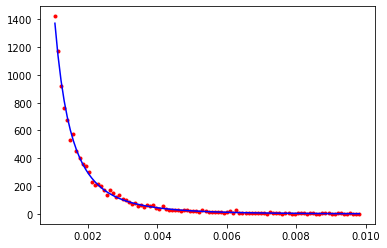

CPU times: user 43.1 ms, sys: 5.68 ms, total: 48.8 ms
Wall time: 16.3 ms
CPU times: user 36 ms, sys: 9.83 ms, total: 45.8 ms
Wall time: 15.2 ms
21446.324121592163


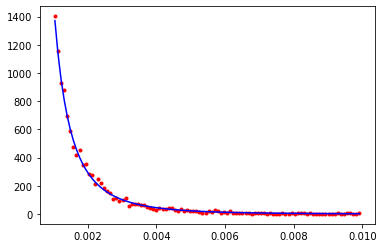

15219.941419949118


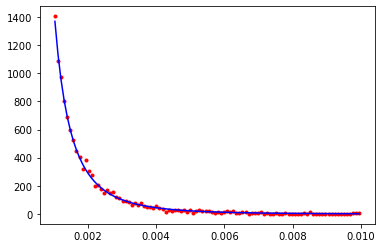

CPU times: user 43.2 ms, sys: 5.76 ms, total: 48.9 ms
Wall time: 16.4 ms
CPU times: user 28.8 ms, sys: 8.87 ms, total: 37.7 ms
Wall time: 15.9 ms
18003.954625649872


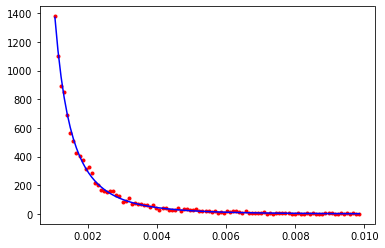

26677.497982442226


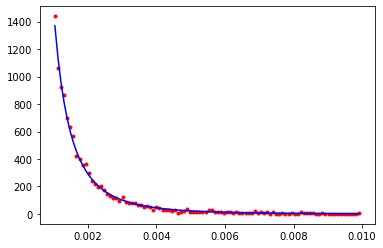

CPU times: user 42.8 ms, sys: 5.56 ms, total: 48.4 ms
Wall time: 16.2 ms
CPU times: user 45.1 ms, sys: 45.2 ms, total: 90.2 ms
Wall time: 28.2 ms
10443.51294418681


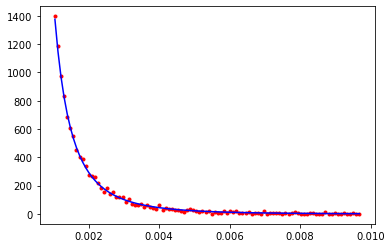

22051.666778752835


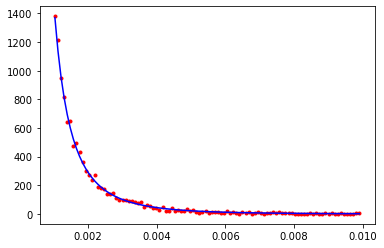

CPU times: user 43.1 ms, sys: 5.78 ms, total: 48.9 ms
Wall time: 16.4 ms
CPU times: user 35.1 ms, sys: 11.2 ms, total: 46.3 ms
Wall time: 15.7 ms
21713.655734095013


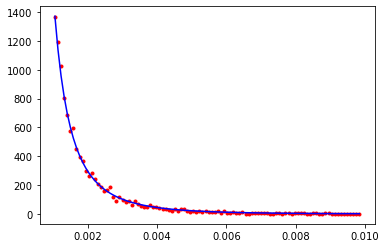

33697.07925694817


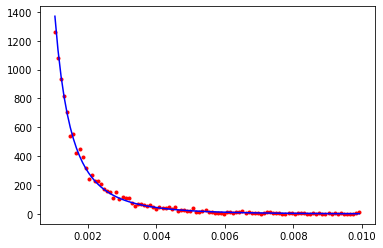

CPU times: user 43 ms, sys: 5.57 ms, total: 48.6 ms
Wall time: 16.3 ms
CPU times: user 34.5 ms, sys: 6.28 ms, total: 40.8 ms
Wall time: 13.6 ms
20943.990678151695


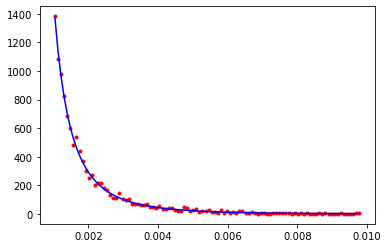

21571.49410833963


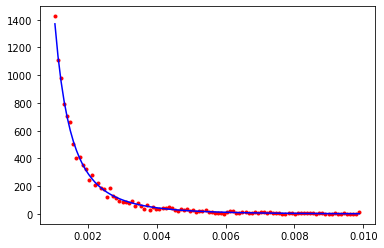

In [34]:
for _ in range(loops):
    %time r_everest = [ lib.get_random_ruth() for _ in range(n) ]
    %time r_k2      = [ k2ran.get_random_ruth(cgen) for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [35]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

155.96659985479243
151.51191661074543
[1.2535932  0.86681348 1.02026382 1.42105659 1.71513249 0.67559665
 1.22832634 1.04374934 0.9417415  0.99865164 1.49186083 0.98608233
 0.89830201 1.15874602 0.8210072  1.18705254 0.82150726 0.68818087
 0.80273157 0.98534792]
1.0830106279802933


## 5000 samples, 5 iterations

In [36]:
lib.set_random_seed(1669281221)
k2ran.set_random_seed(1669281221)

mat = xc.materials.Copper
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

lib.set_rutherford_parameters(z,emr,t1)
cgen = k2ran.initialise_random_ruth(zatom=z, emr=emr, hcut=t1)

n = 5000
lib.set_rutherford_iterations(5)
bins = 100

loops = 20
S_everest = []
S_K2 = []
f = lambda x: PDF(x,z,emr)/CDF(t1,z,emr)

CPU times: user 8.24 ms, sys: 557 µs, total: 8.8 ms
Wall time: 8.27 ms
CPU times: user 14.1 ms, sys: 2.74 ms, total: 16.9 ms
Wall time: 15 ms
51296.815718420235


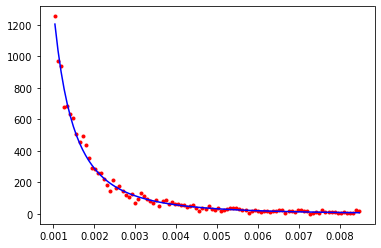

16326.253888455087


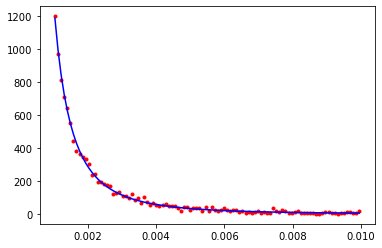

CPU times: user 22 ms, sys: 3.05 ms, total: 25.1 ms
Wall time: 8.4 ms
CPU times: user 34.4 ms, sys: 6.22 ms, total: 40.7 ms
Wall time: 13.6 ms
33909.04222194936


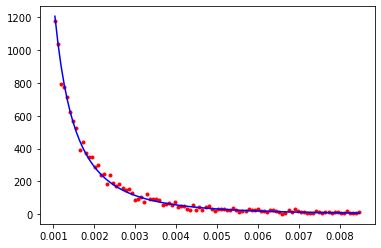

23262.532401250377


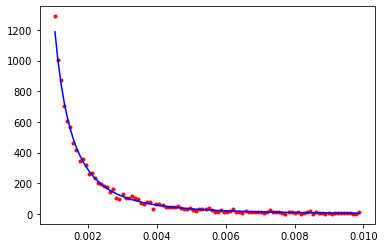

CPU times: user 22.4 ms, sys: 3.39 ms, total: 25.8 ms
Wall time: 8.71 ms
CPU times: user 34.9 ms, sys: 10.2 ms, total: 45.1 ms
Wall time: 15.2 ms
44174.923832349166


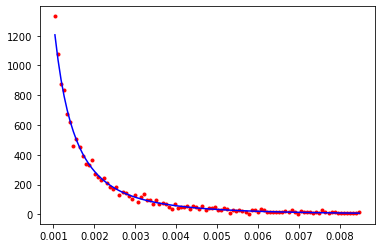

15796.700082084046


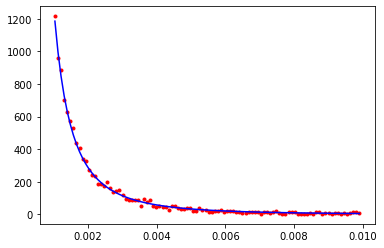

CPU times: user 20.9 ms, sys: 4.13 ms, total: 25 ms
Wall time: 8.65 ms
CPU times: user 34 ms, sys: 6.28 ms, total: 40.3 ms
Wall time: 13.5 ms
30201.894552153655


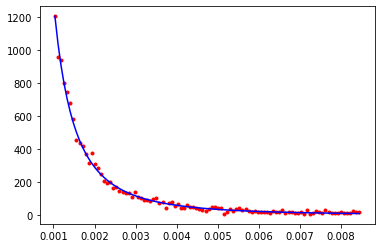

16050.625972424821


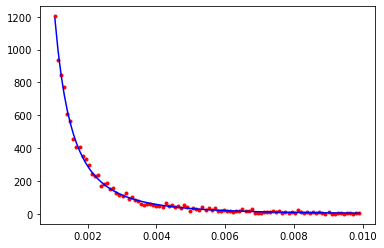

CPU times: user 21.9 ms, sys: 3.44 ms, total: 25.3 ms
Wall time: 8.59 ms
CPU times: user 34.5 ms, sys: 6.98 ms, total: 41.5 ms
Wall time: 13.9 ms
53121.932728405765


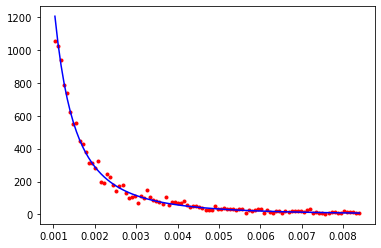

21224.72300801168


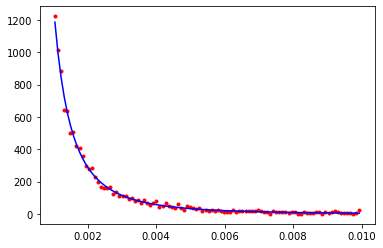

CPU times: user 22.2 ms, sys: 3.54 ms, total: 25.8 ms
Wall time: 8.73 ms
CPU times: user 34 ms, sys: 7.03 ms, total: 41 ms
Wall time: 13.7 ms
31091.80189542188


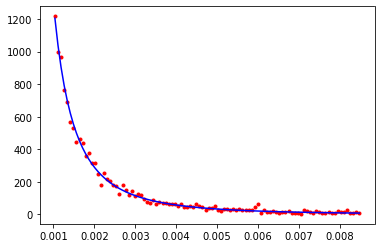

24334.16320841606


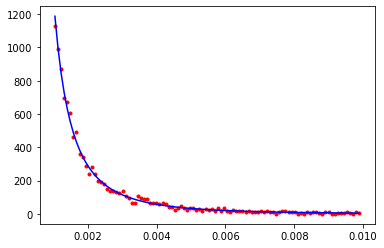

CPU times: user 20.9 ms, sys: 4.19 ms, total: 25.1 ms
Wall time: 8.73 ms
CPU times: user 36.5 ms, sys: 18.7 ms, total: 55.2 ms
Wall time: 18.4 ms
39457.57239748426


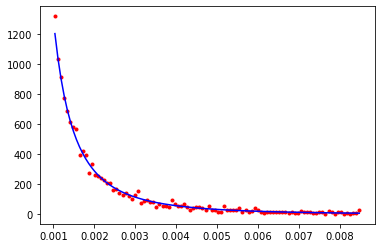

17340.067152407246


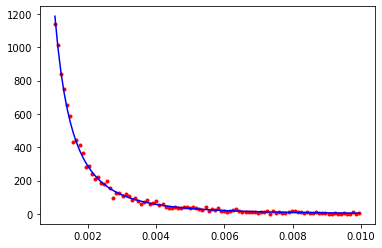

CPU times: user 22.6 ms, sys: 3.38 ms, total: 26 ms
Wall time: 8.74 ms
CPU times: user 44.2 ms, sys: 36.7 ms, total: 81 ms
Wall time: 25.6 ms
38817.699987408494


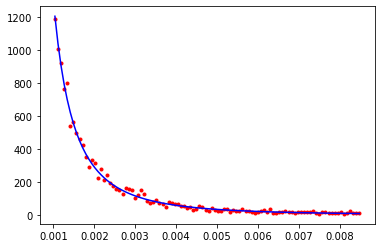

22794.749343411833


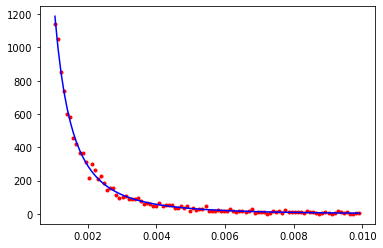

CPU times: user 22.2 ms, sys: 3.23 ms, total: 25.4 ms
Wall time: 8.55 ms
CPU times: user 35.1 ms, sys: 8.55 ms, total: 43.6 ms
Wall time: 14.4 ms
24777.080188647513


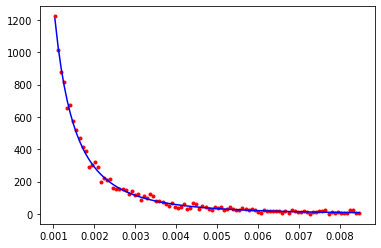

16193.329812112608


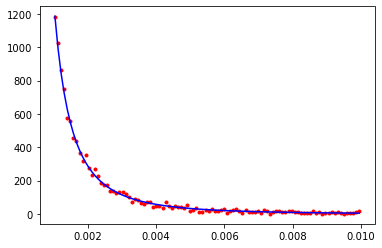

CPU times: user 21.8 ms, sys: 3.36 ms, total: 25.2 ms
Wall time: 8.53 ms
CPU times: user 35.2 ms, sys: 9.34 ms, total: 44.6 ms
Wall time: 14.8 ms
28618.112246165456


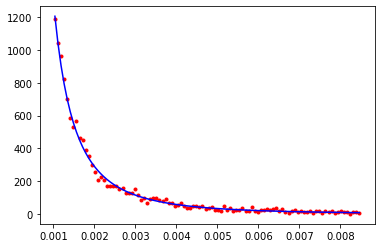

27831.15282156286


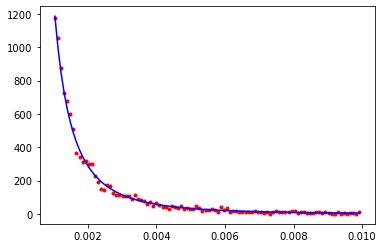

CPU times: user 22.3 ms, sys: 3.27 ms, total: 25.6 ms
Wall time: 8.6 ms
CPU times: user 34.3 ms, sys: 6.53 ms, total: 40.9 ms
Wall time: 13.6 ms
50213.70792954454


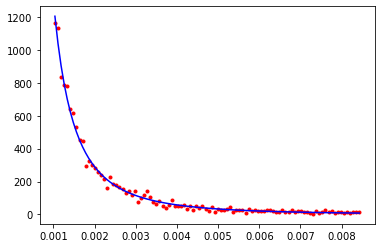

26753.905550980526


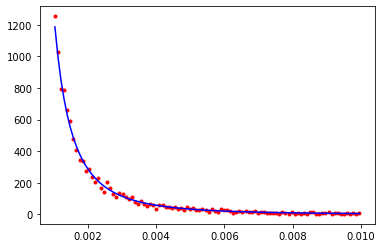

CPU times: user 22.4 ms, sys: 3.17 ms, total: 25.6 ms
Wall time: 8.6 ms
CPU times: user 34.2 ms, sys: 6.71 ms, total: 41 ms
Wall time: 13.8 ms
38903.00648334486


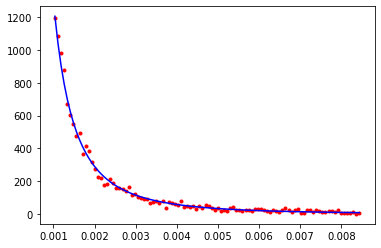

23840.76089012738


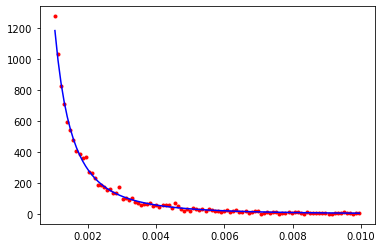

CPU times: user 22.3 ms, sys: 3.3 ms, total: 25.6 ms
Wall time: 8.62 ms
CPU times: user 40.1 ms, sys: 26.2 ms, total: 66.3 ms
Wall time: 21.9 ms
25104.33338569265


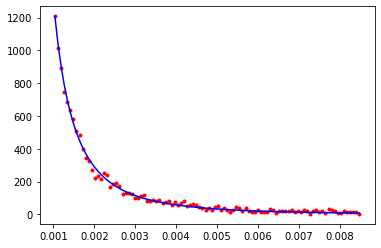

26529.892425471597


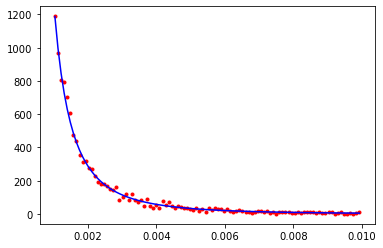

CPU times: user 22.2 ms, sys: 3.17 ms, total: 25.4 ms
Wall time: 8.5 ms
CPU times: user 41.6 ms, sys: 31.3 ms, total: 73 ms
Wall time: 23.1 ms
45354.86655702312


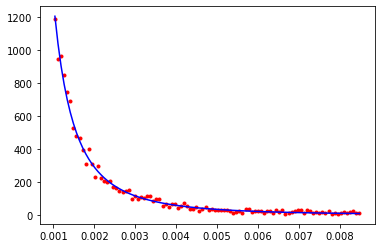

16962.603278815342


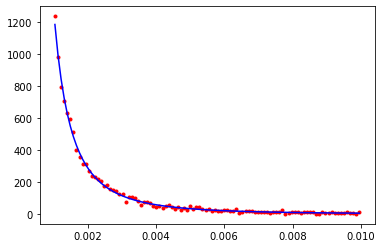

CPU times: user 22 ms, sys: 3.21 ms, total: 25.2 ms
Wall time: 8.5 ms
CPU times: user 34.8 ms, sys: 8.85 ms, total: 43.7 ms
Wall time: 14.5 ms
38175.4608204718


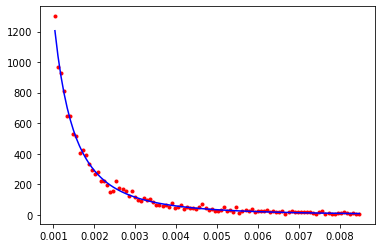

28281.79769832608


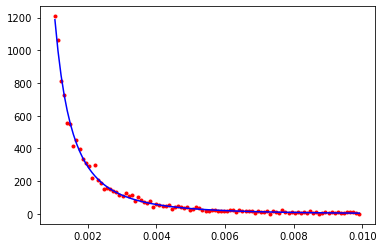

CPU times: user 22.4 ms, sys: 3.12 ms, total: 25.5 ms
Wall time: 8.54 ms
CPU times: user 46.5 ms, sys: 45.2 ms, total: 91.7 ms
Wall time: 28.6 ms
27238.38996947073


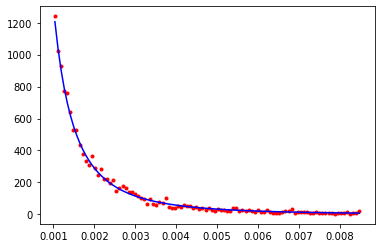

12820.303690006225


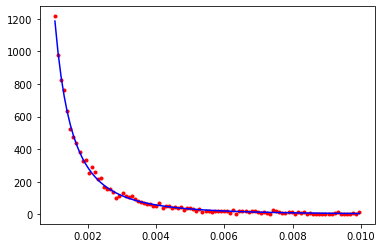

CPU times: user 21.8 ms, sys: 3.8 ms, total: 25.6 ms
Wall time: 8.74 ms
CPU times: user 33.4 ms, sys: 6.18 ms, total: 39.6 ms
Wall time: 13.4 ms
28300.58679949206


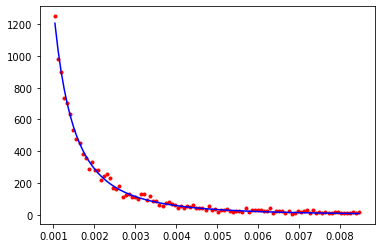

23148.44252267499


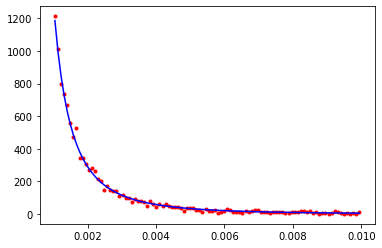

CPU times: user 22.3 ms, sys: 3.18 ms, total: 25.5 ms
Wall time: 8.55 ms
CPU times: user 45.1 ms, sys: 44.8 ms, total: 89.9 ms
Wall time: 28 ms
31022.085222785132


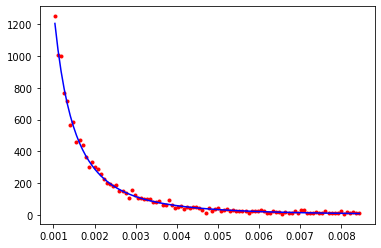

17329.163941793


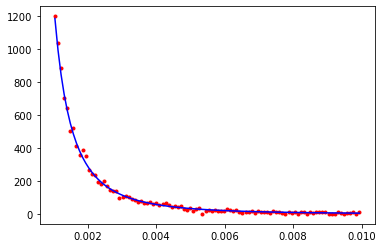

CPU times: user 21.9 ms, sys: 3.5 ms, total: 25.4 ms
Wall time: 8.64 ms
CPU times: user 33.7 ms, sys: 6.9 ms, total: 40.6 ms
Wall time: 13.7 ms
23254.553859628602


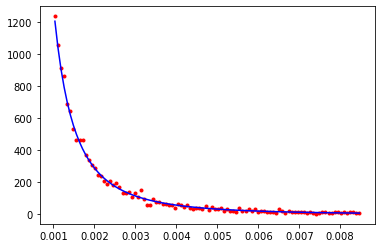

26059.43449973095


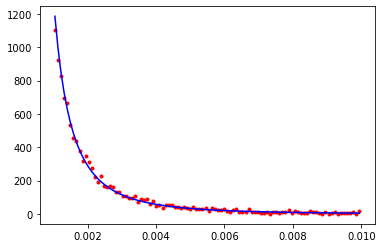

CPU times: user 22.6 ms, sys: 3.91 ms, total: 26.5 ms
Wall time: 9.05 ms
CPU times: user 34 ms, sys: 6.91 ms, total: 40.9 ms
Wall time: 13.7 ms
29176.604327453133


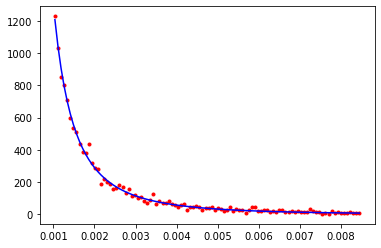

23704.474527562852


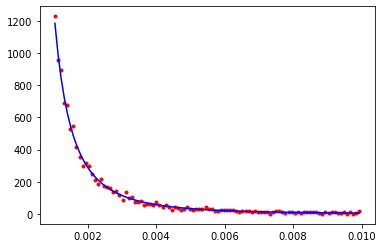

In [37]:
for _ in range(loops):
    %time r_everest = [ lib.get_random_ruth() for _ in range(n) ]
    %time r_k2      = [ k2ran.get_random_ruth(cgen) for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [38]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

188.70750794858594
146.0453827951479
[1.77256402 1.2073391  1.67226353 1.3717378  1.58203438 1.13035468
 1.50848082 1.30496087 1.23696378 1.01403955 1.36999049 1.27741357
 0.97276201 1.63518048 1.16181944 1.45761074 1.10569878 1.33797096
 0.94465127 1.10943588]
1.3291774197649409


In [39]:
lib.set_random_seed(1669281221)
k2ran.set_random_seed(1669281221)

mat = xc.materials.Berylium
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

lib.set_rutherford_parameters(z,emr,t1)
cgen = k2ran.initialise_random_ruth(zatom=z, emr=emr, hcut=t1)

n = 5000
lib.set_rutherford_iterations(5)
bins = 100

loops = 20
S_everest = []
S_K2 = []
f = lambda x: PDF(x,z,emr)/CDF(t1,z,emr)

CPU times: user 9.82 ms, sys: 792 µs, total: 10.6 ms
Wall time: 9.85 ms
CPU times: user 22.6 ms, sys: 14.4 ms, total: 37 ms
Wall time: 25.4 ms
14444.800191440407


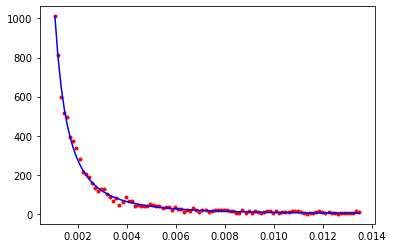

3809.430349078918


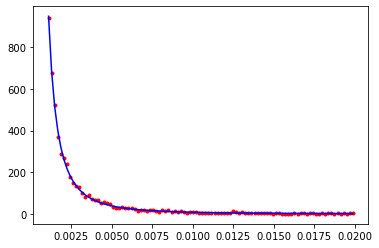

CPU times: user 20.7 ms, sys: 3.19 ms, total: 23.9 ms
Wall time: 8.07 ms
CPU times: user 34.3 ms, sys: 7.37 ms, total: 41.6 ms
Wall time: 14.1 ms
10766.84301978348


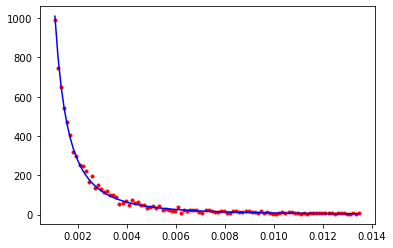

8049.421075785147


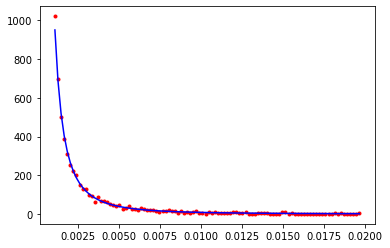

CPU times: user 20.6 ms, sys: 3.76 ms, total: 24.3 ms
Wall time: 8.34 ms
CPU times: user 34.2 ms, sys: 7.27 ms, total: 41.4 ms
Wall time: 14 ms
14196.15895239967


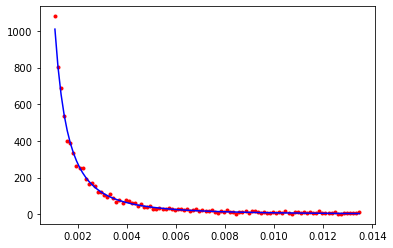

4040.211916427765


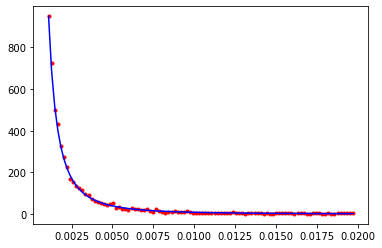

CPU times: user 19.8 ms, sys: 4.38 ms, total: 24.2 ms
Wall time: 8.49 ms
CPU times: user 38.1 ms, sys: 18.3 ms, total: 56.4 ms
Wall time: 18.5 ms
18657.17793135939


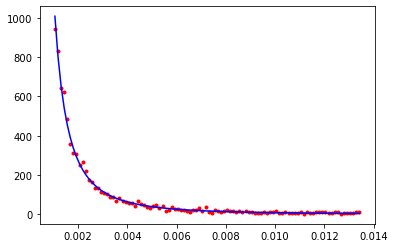

3053.130125369764


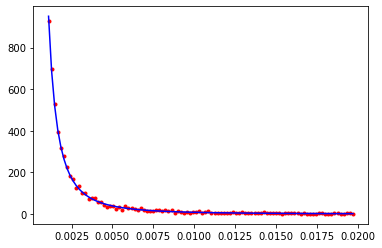

CPU times: user 22.2 ms, sys: 5.05 ms, total: 27.2 ms
Wall time: 9.58 ms
CPU times: user 35.4 ms, sys: 7.51 ms, total: 42.9 ms
Wall time: 15 ms
25637.77923573579


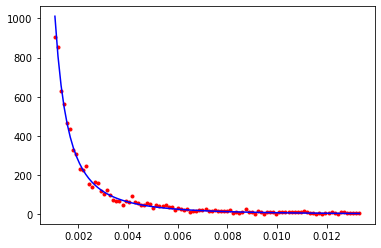

4299.280389212148


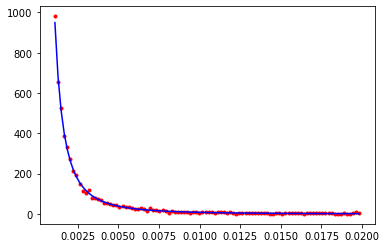

CPU times: user 20.4 ms, sys: 3.32 ms, total: 23.7 ms
Wall time: 8.11 ms
CPU times: user 34.3 ms, sys: 7.51 ms, total: 41.8 ms
Wall time: 14.1 ms
11221.87796110817


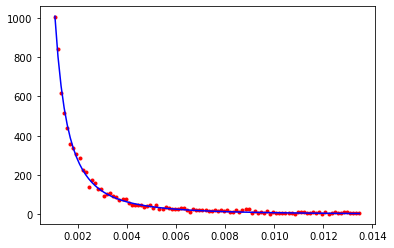

6572.52086294898


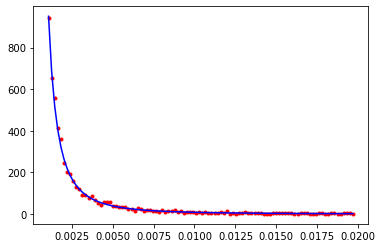

CPU times: user 20.2 ms, sys: 3.85 ms, total: 24.1 ms
Wall time: 8.32 ms
CPU times: user 34 ms, sys: 5.74 ms, total: 39.8 ms
Wall time: 13.3 ms
11738.261846146912


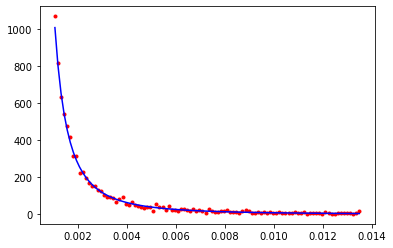

3360.382522453843


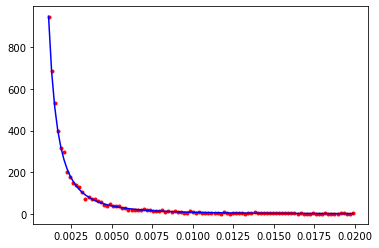

CPU times: user 20.9 ms, sys: 3.29 ms, total: 24.2 ms
Wall time: 8.18 ms
CPU times: user 38.1 ms, sys: 21 ms, total: 59.1 ms
Wall time: 19.2 ms
7661.722319066356


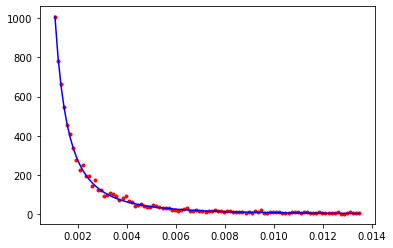

2264.544366001604


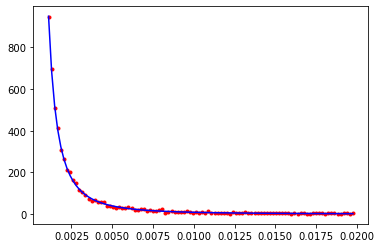

CPU times: user 21.1 ms, sys: 3.08 ms, total: 24.1 ms
Wall time: 8.1 ms
CPU times: user 35.9 ms, sys: 10 ms, total: 46 ms
Wall time: 15.2 ms
7714.161817366228


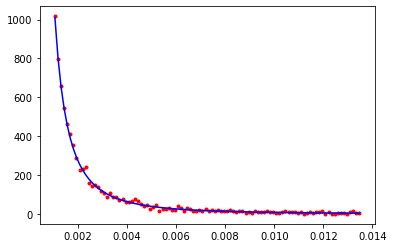

4348.553231115695


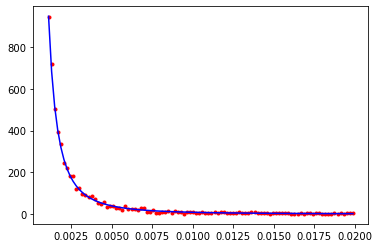

CPU times: user 20.9 ms, sys: 3.14 ms, total: 24 ms
Wall time: 8.1 ms
CPU times: user 33.8 ms, sys: 7.18 ms, total: 41 ms
Wall time: 13.8 ms
13980.605702761592


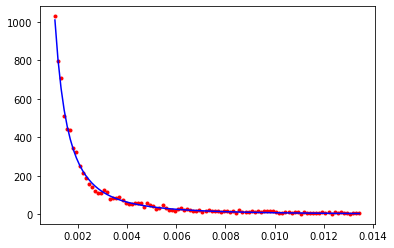

7816.105662493564


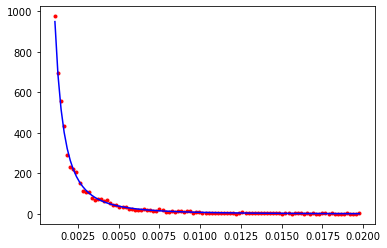

CPU times: user 19.7 ms, sys: 3.82 ms, total: 23.5 ms
Wall time: 8.15 ms
CPU times: user 34.5 ms, sys: 7.51 ms, total: 42 ms
Wall time: 14 ms
17558.59726794741


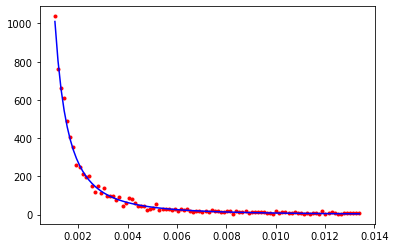

4968.642555534789


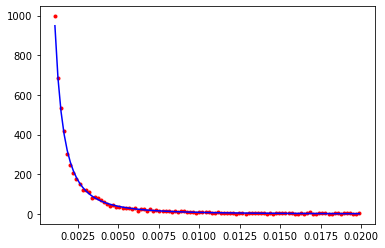

CPU times: user 21 ms, sys: 3.16 ms, total: 24.1 ms
Wall time: 8.14 ms
CPU times: user 34.2 ms, sys: 8.13 ms, total: 42.4 ms
Wall time: 14.4 ms
19047.12278341749


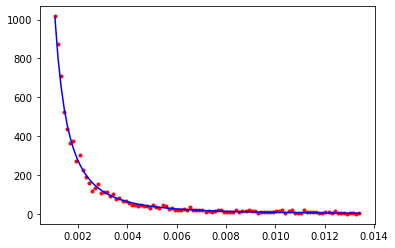

8763.142008667906


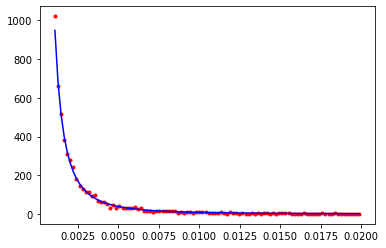

CPU times: user 20.5 ms, sys: 3.99 ms, total: 24.5 ms
Wall time: 8.43 ms
CPU times: user 40.9 ms, sys: 30.2 ms, total: 71.1 ms
Wall time: 22.7 ms
10063.109741819922


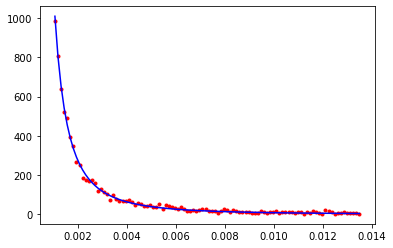

5265.754031214119


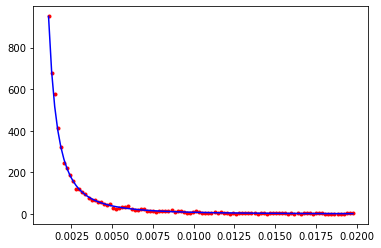

CPU times: user 20.3 ms, sys: 3.64 ms, total: 23.9 ms
Wall time: 8.19 ms
CPU times: user 37.4 ms, sys: 16.6 ms, total: 53.9 ms
Wall time: 17.7 ms
11545.971103126889


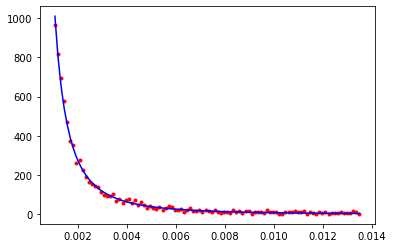

3820.7363042144752


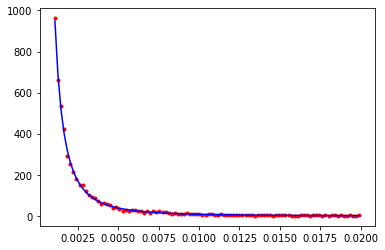

CPU times: user 20.8 ms, sys: 3.11 ms, total: 23.9 ms
Wall time: 8.05 ms
CPU times: user 34 ms, sys: 7.92 ms, total: 41.9 ms
Wall time: 14.2 ms
7689.712088622769


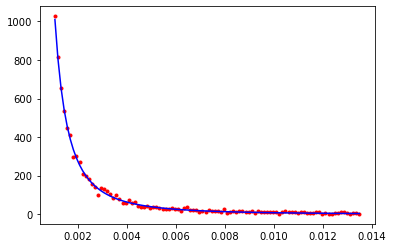

7770.40751905282


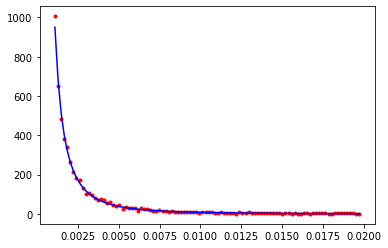

CPU times: user 20.9 ms, sys: 3.22 ms, total: 24.1 ms
Wall time: 8.14 ms
CPU times: user 39.6 ms, sys: 24.6 ms, total: 64.2 ms
Wall time: 20.8 ms
11795.797188329268


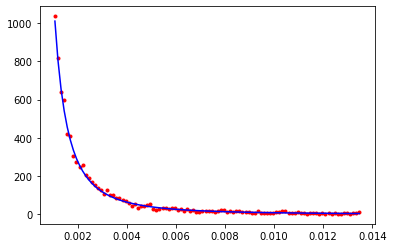

3549.7979181163114


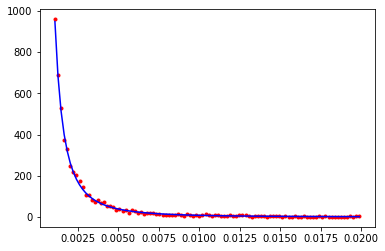

CPU times: user 20.2 ms, sys: 3.52 ms, total: 23.7 ms
Wall time: 8.12 ms
CPU times: user 34.5 ms, sys: 8.7 ms, total: 43.2 ms
Wall time: 14.7 ms
12202.581979137818


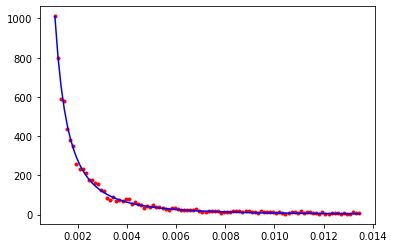

5932.726987248682


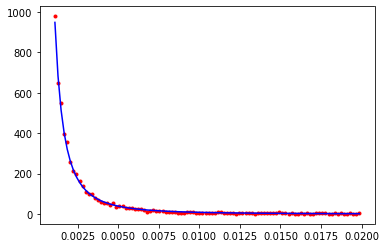

CPU times: user 20.5 ms, sys: 3.91 ms, total: 24.4 ms
Wall time: 8.42 ms
CPU times: user 34.5 ms, sys: 7.29 ms, total: 41.8 ms
Wall time: 14.1 ms
7588.644385136038


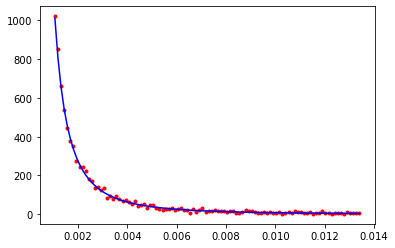

3514.6821553232826


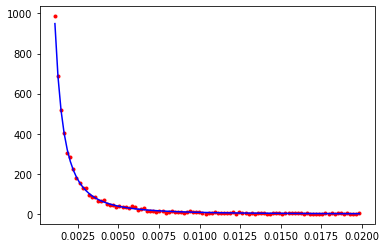

CPU times: user 20.6 ms, sys: 3.35 ms, total: 23.9 ms
Wall time: 8.14 ms
CPU times: user 34.2 ms, sys: 7.61 ms, total: 41.8 ms
Wall time: 14.2 ms
11902.866840601835


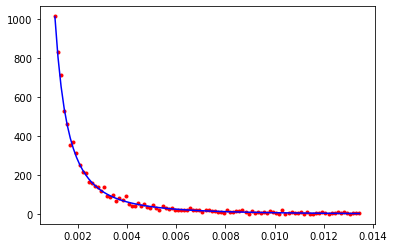

9798.431998292857


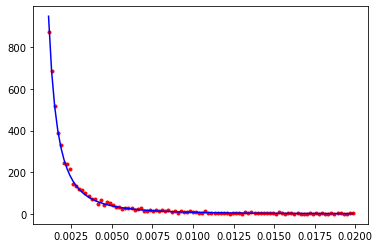

CPU times: user 20.7 ms, sys: 3.48 ms, total: 24.2 ms
Wall time: 8.24 ms
CPU times: user 34.5 ms, sys: 7.07 ms, total: 41.6 ms
Wall time: 14.2 ms
10922.383657164251


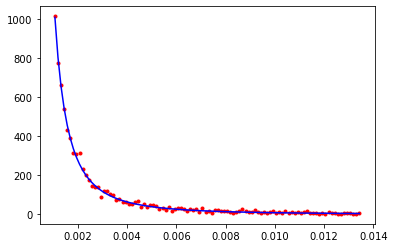

4993.422204725276


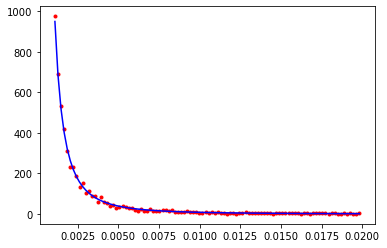

In [40]:
for _ in range(loops):
    %time r_everest = [ lib.get_random_ruth() for _ in range(n) ]
    %time r_k2      = [ k2ran.get_random_ruth(cgen) for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [41]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

113.21134572393169
72.79811954414686
[1.94726811 1.15654322 1.87449098 2.47201055 2.4419812  1.3066726
 1.86899241 1.83938562 1.3319011  1.33741991 1.87986227 1.47429627
 1.38240667 1.73836793 0.99479396 1.82289575 1.43416357 1.46939674
 1.10216723 1.4789707 ]
1.6648548538474415


In [42]:
lib.set_random_seed(1669281221)
k2ran.set_random_seed(1669281221)

mat = xc.materials.Lead
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

lib.set_rutherford_parameters(z,emr,t1)
cgen = k2ran.initialise_random_ruth(zatom=z, emr=emr, hcut=t1)

n = 5000
lib.set_rutherford_iterations(5)
bins = 100

loops = 20
S_everest = []
S_K2 = []
f = lambda x: PDF(x,z,emr)/CDF(t1,z,emr)

CPU times: user 10.5 ms, sys: 819 µs, total: 11.3 ms
Wall time: 10.6 ms
CPU times: user 22.7 ms, sys: 13.4 ms, total: 36.2 ms
Wall time: 25.9 ms
69446.89177815162


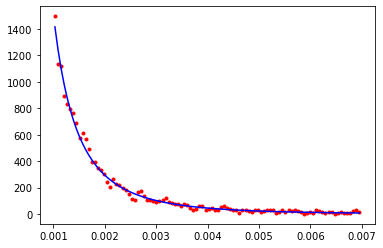

18942.76687605886


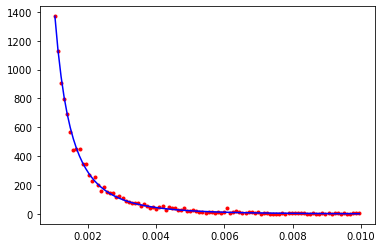

CPU times: user 22.3 ms, sys: 3.78 ms, total: 26.1 ms
Wall time: 8.91 ms
CPU times: user 35.3 ms, sys: 10.6 ms, total: 45.9 ms
Wall time: 15.4 ms
61594.3988785426


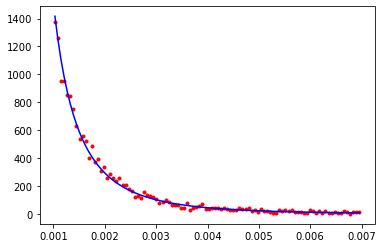

29059.18607822507


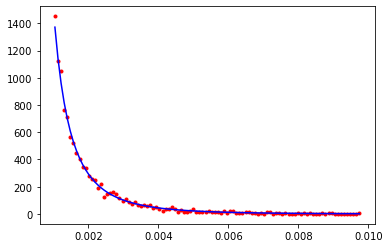

CPU times: user 22.7 ms, sys: 3.79 ms, total: 26.5 ms
Wall time: 9.04 ms
CPU times: user 34 ms, sys: 5.74 ms, total: 39.8 ms
Wall time: 13.5 ms
64995.28771319562


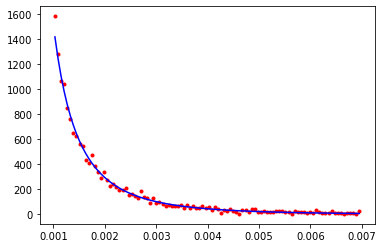

27949.533747491332


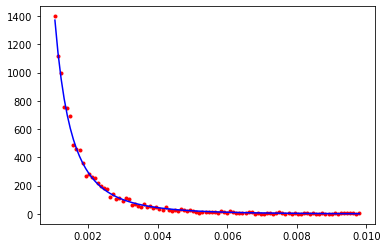

CPU times: user 22.5 ms, sys: 4.05 ms, total: 26.6 ms
Wall time: 9.11 ms
CPU times: user 33.9 ms, sys: 8.09 ms, total: 42 ms
Wall time: 14.3 ms
56325.12809849233


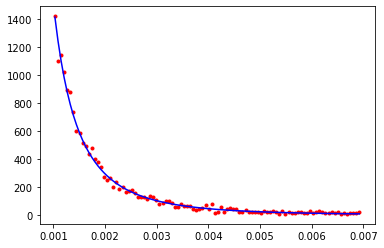

12581.235405347812


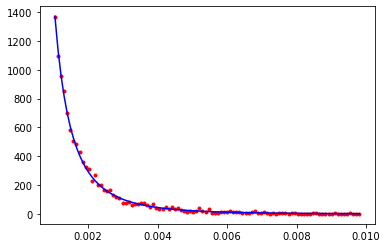

CPU times: user 22.1 ms, sys: 4.36 ms, total: 26.4 ms
Wall time: 9.19 ms
CPU times: user 33.6 ms, sys: 5.35 ms, total: 38.9 ms
Wall time: 13.1 ms
87006.93115524048


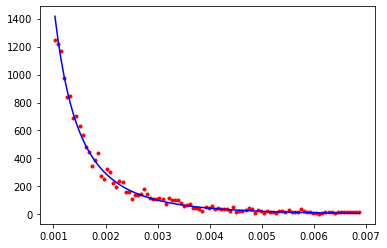

18641.04885358723


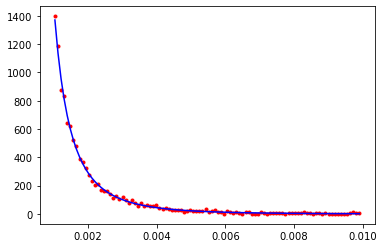

CPU times: user 22.6 ms, sys: 3.46 ms, total: 26 ms
Wall time: 8.82 ms
CPU times: user 38.5 ms, sys: 17.8 ms, total: 56.3 ms
Wall time: 18.5 ms
71646.46823416141


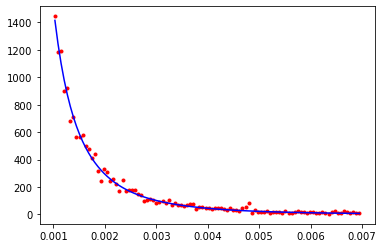

35761.85521772086


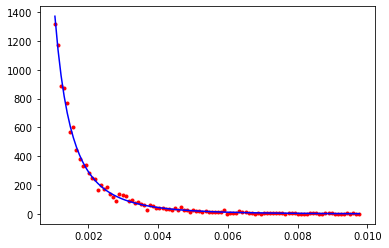

CPU times: user 23.1 ms, sys: 3.65 ms, total: 26.8 ms
Wall time: 9.06 ms
CPU times: user 34.6 ms, sys: 7.82 ms, total: 42.4 ms
Wall time: 14.5 ms
88967.30735927809


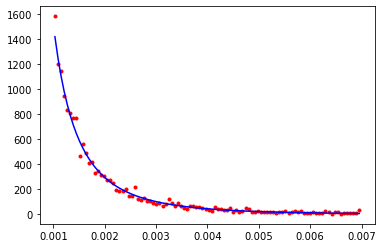

19047.63583076765


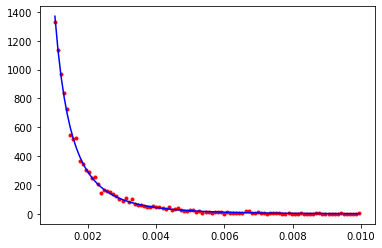

CPU times: user 22.7 ms, sys: 3.81 ms, total: 26.5 ms
Wall time: 9.08 ms
CPU times: user 36.3 ms, sys: 14.1 ms, total: 50.4 ms
Wall time: 16.7 ms
53335.76016712722


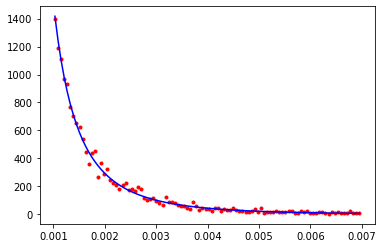

21100.902407674792


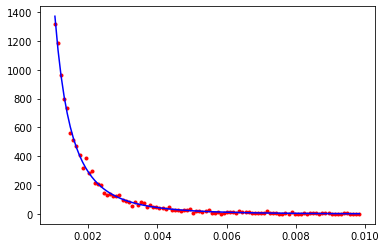

CPU times: user 22.1 ms, sys: 4.13 ms, total: 26.2 ms
Wall time: 9.06 ms
CPU times: user 37.6 ms, sys: 17.6 ms, total: 55.1 ms
Wall time: 18.1 ms
48978.565531921566


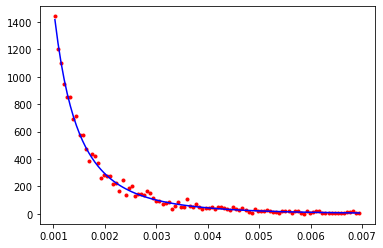

18244.668701735052


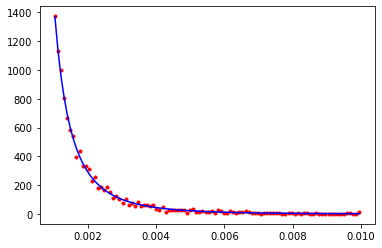

CPU times: user 12.5 ms, sys: 1.71 ms, total: 14.2 ms
Wall time: 11.4 ms
CPU times: user 43 ms, sys: 13.3 ms, total: 56.3 ms
Wall time: 19 ms
51462.69200831508


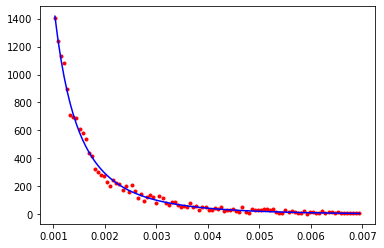

27067.2903726888


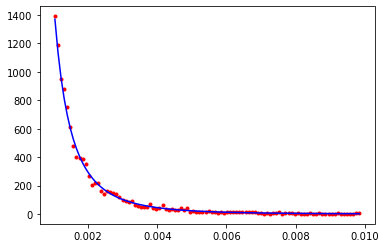

CPU times: user 22.8 ms, sys: 3.42 ms, total: 26.2 ms
Wall time: 8.83 ms
CPU times: user 35.7 ms, sys: 9.58 ms, total: 45.3 ms
Wall time: 15 ms
69886.92996180801


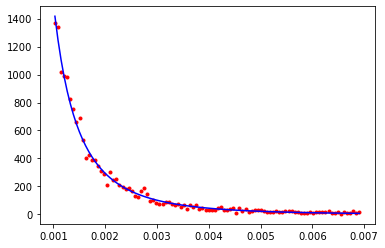

14945.077158618536


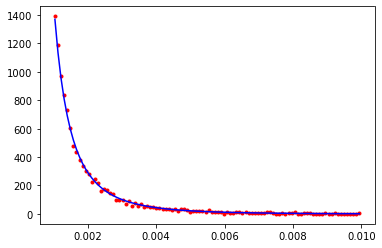

CPU times: user 22.1 ms, sys: 4.21 ms, total: 26.3 ms
Wall time: 9.08 ms
CPU times: user 34.3 ms, sys: 7.06 ms, total: 41.3 ms
Wall time: 13.8 ms
58460.38000433793


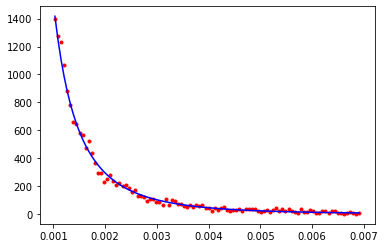

32076.722203812547


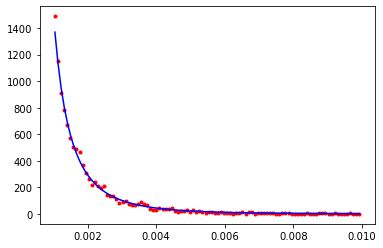

CPU times: user 23.1 ms, sys: 3.37 ms, total: 26.5 ms
Wall time: 8.91 ms
CPU times: user 36.1 ms, sys: 10.4 ms, total: 46.5 ms
Wall time: 15.5 ms
49833.52239278652


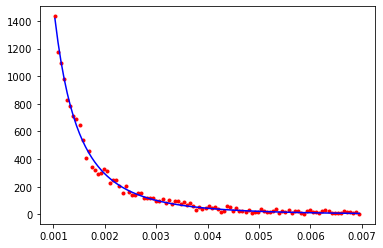

27298.016616461486


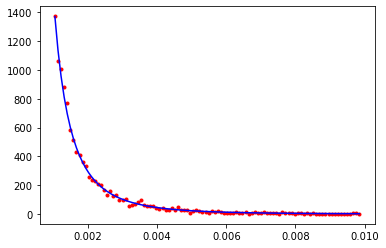

CPU times: user 23 ms, sys: 3.48 ms, total: 26.5 ms
Wall time: 8.94 ms
CPU times: user 34.1 ms, sys: 5.41 ms, total: 39.5 ms
Wall time: 13.3 ms
56443.5189463934


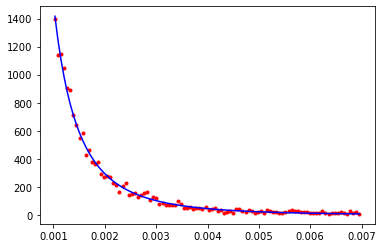

15333.639973815705


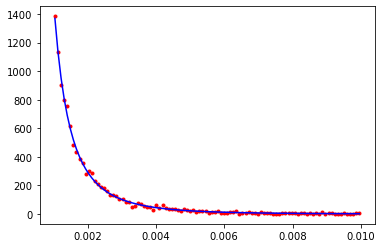

CPU times: user 23 ms, sys: 3.29 ms, total: 26.3 ms
Wall time: 8.85 ms
CPU times: user 37.2 ms, sys: 15.5 ms, total: 52.6 ms
Wall time: 17.3 ms
55409.33958418035


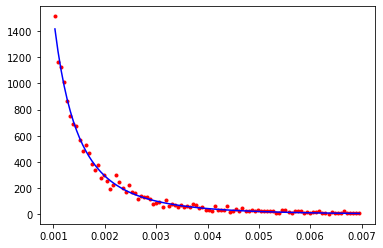

21849.958510791927


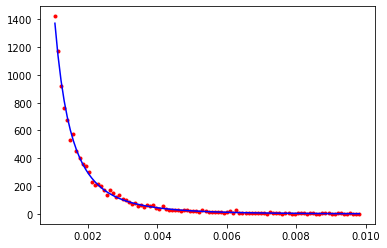

CPU times: user 22.9 ms, sys: 3.33 ms, total: 26.2 ms
Wall time: 8.85 ms
CPU times: user 34.6 ms, sys: 8.53 ms, total: 43.1 ms
Wall time: 14.4 ms
48552.37973776588


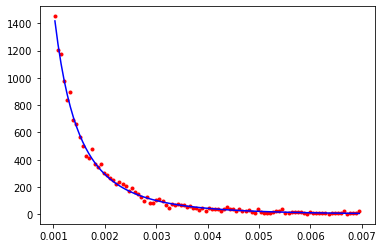

15219.941419949118


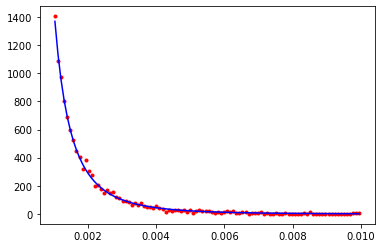

CPU times: user 23.3 ms, sys: 3.51 ms, total: 26.8 ms
Wall time: 9 ms
CPU times: user 38.4 ms, sys: 19.9 ms, total: 58.2 ms
Wall time: 18.9 ms
47999.37820703229


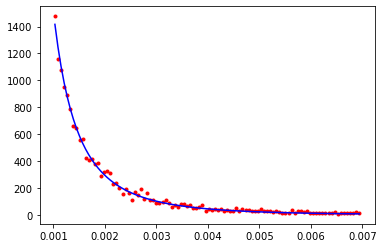

26677.497982442226


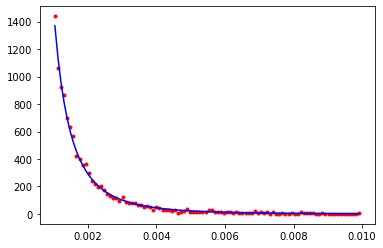

CPU times: user 23.1 ms, sys: 3.36 ms, total: 26.5 ms
Wall time: 8.9 ms
CPU times: user 38 ms, sys: 17.1 ms, total: 55.2 ms
Wall time: 18 ms
43861.544412617484


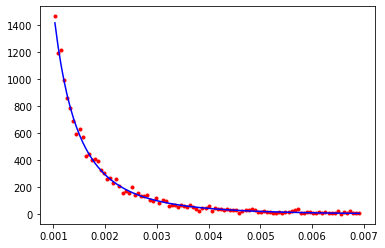

22051.666778752835


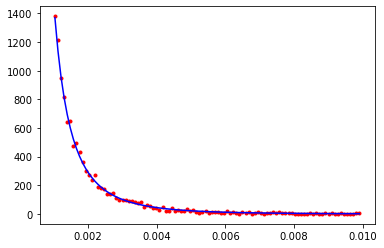

CPU times: user 22.8 ms, sys: 3.53 ms, total: 26.4 ms
Wall time: 8.93 ms
CPU times: user 37.7 ms, sys: 17.2 ms, total: 54.8 ms
Wall time: 17.9 ms
39167.91896115043


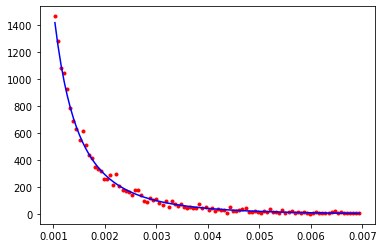

33697.07925694817


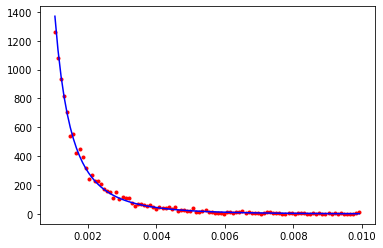

CPU times: user 22.6 ms, sys: 3.78 ms, total: 26.4 ms
Wall time: 8.99 ms
CPU times: user 39.7 ms, sys: 23.7 ms, total: 63.4 ms
Wall time: 20.5 ms
54332.48092969466


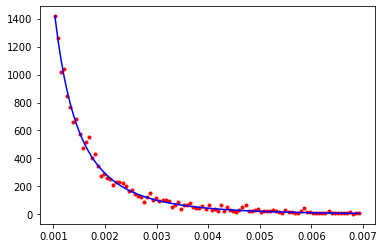

21571.49410833963


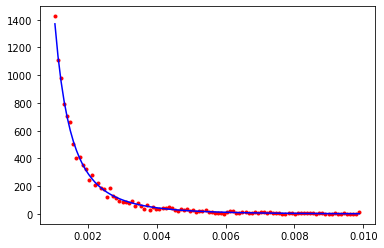

In [43]:
for _ in range(loops):
    %time r_everest = [ lib.get_random_ruth() for _ in range(n) ]
    %time r_k2      = [ k2ran.get_random_ruth(cgen) for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [44]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

242.66301985079977
151.51191661074543
[1.91471747 1.45589109 1.52494314 2.11587228 2.16043773 1.41542667
 2.16119863 1.58985944 1.63845697 1.3788717  2.16246407 1.35000639
 1.35112412 1.91859987 1.59245137 1.78607121 1.34135971 1.41033164
 1.07812501 1.58704651]
1.6769607450993895


## 100 samples, loop over iterations

In [45]:
lib.set_random_seed(1669281221)
k2ran.set_random_seed(1669281221)

mat = xc.materials.Copper
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

lib.set_rutherford_parameters(z,emr,t1)
cgen = k2ran.initialise_random_ruth(zatom=z, emr=emr, hcut=t1)

n = 100
n_iter = [5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
bins = 15

loops = 20
S_everest = { nn: [] for nn in n_iter }
S_K2 = []
f = lambda x: PDF(x,z,emr)/CDF(t1,z,emr)

CPU times: user 337 µs, sys: 223 µs, total: 560 µs
Wall time: 341 µs
26815.979636902663


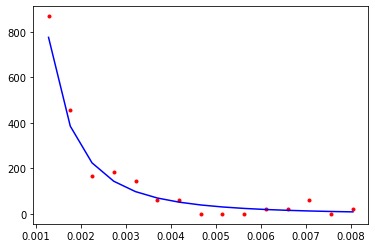

CPU times: user 1.28 ms, sys: 542 µs, total: 1.82 ms
Wall time: 615 µs
15828.41558404003


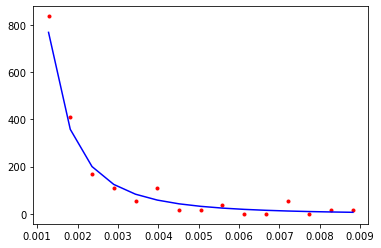

CPU times: user 1.39 ms, sys: 506 µs, total: 1.9 ms
Wall time: 644 µs
40140.46792164231


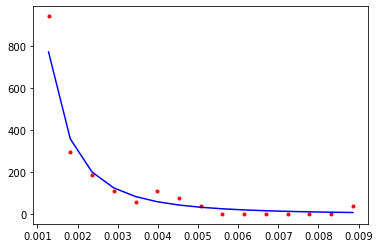

CPU times: user 1.96 ms, sys: 1.14 ms, total: 3.1 ms
Wall time: 1.15 ms
26110.916429235356


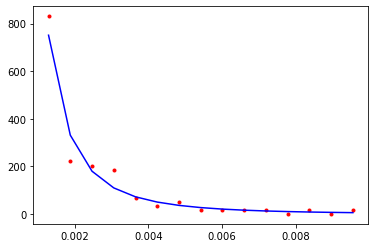

CPU times: user 2.18 ms, sys: 934 µs, total: 3.11 ms
Wall time: 1.12 ms
27541.48366197724


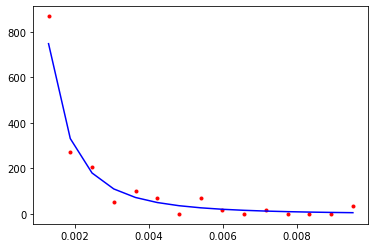

CPU times: user 2.63 ms, sys: 1.02 ms, total: 3.65 ms
Wall time: 1.3 ms
138857.1495982669


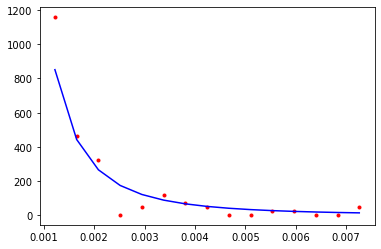

CPU times: user 2.82 ms, sys: 726 µs, total: 3.55 ms
Wall time: 1.21 ms
53204.719754454345


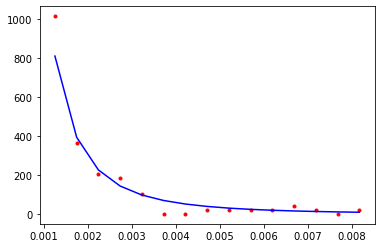

CPU times: user 3.4 ms, sys: 1.21 ms, total: 4.61 ms
Wall time: 1.64 ms
61356.09711010649


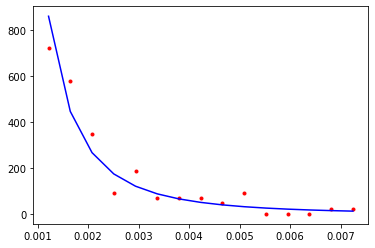

CPU times: user 3.86 ms, sys: 855 µs, total: 4.72 ms
Wall time: 1.59 ms
26978.759078795792


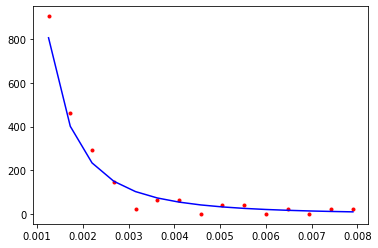

CPU times: user 4.19 ms, sys: 1.31 ms, total: 5.49 ms
Wall time: 1.95 ms
15842.873776582435


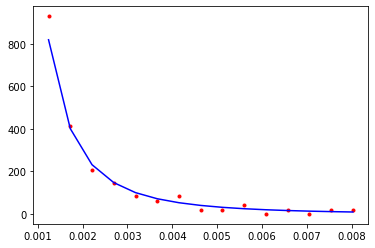

CPU times: user 4.87 ms, sys: 1.45 ms, total: 6.32 ms
Wall time: 2.19 ms
17788.286969642824


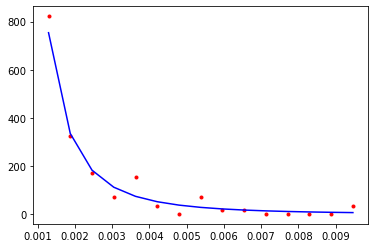

CPU times: user 4.91 ms, sys: 1.07 ms, total: 5.98 ms
Wall time: 2.02 ms
49140.56862722043


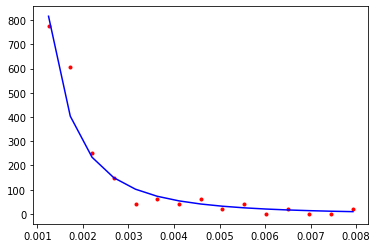

CPU times: user 5.22 ms, sys: 1.05 ms, total: 6.26 ms
Wall time: 2.13 ms
62305.75019054274


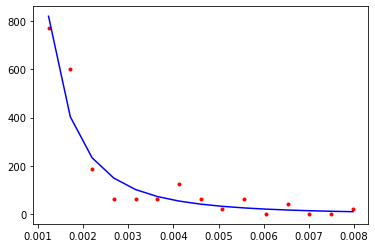

CPU times: user 5.59 ms, sys: 1.13 ms, total: 6.73 ms
Wall time: 2.27 ms
35185.97189984234


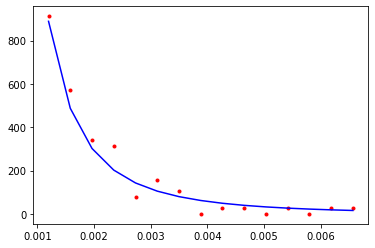

CPU times: user 6.23 ms, sys: 1.35 ms, total: 7.58 ms
Wall time: 2.58 ms
55099.209727638096


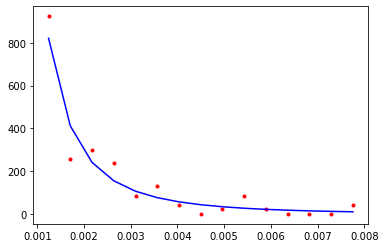

CPU times: user 6.23 ms, sys: 1.57 ms, total: 7.8 ms
Wall time: 2.75 ms
6560.004639126052


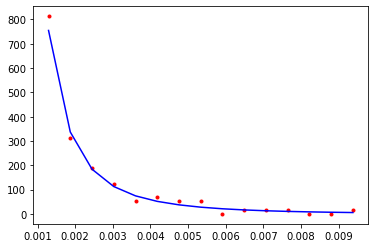

CPU times: user 6.83 ms, sys: 1.28 ms, total: 8.1 ms
Wall time: 2.71 ms
53054.75490829417


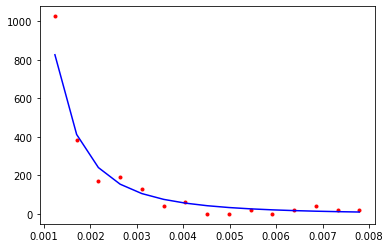

CPU times: user 6.74 ms, sys: 1.76 ms, total: 8.5 ms
Wall time: 2.97 ms
8327.29989677775


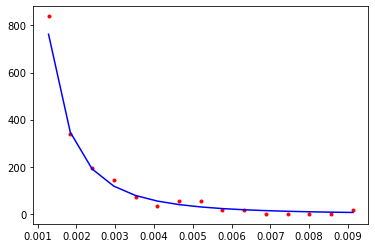

CPU times: user 7.26 ms, sys: 1.28 ms, total: 8.54 ms
Wall time: 2.88 ms
32514.20606109421


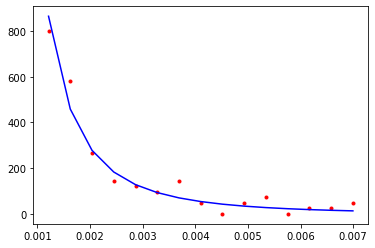

CPU times: user 7.87 ms, sys: 1.62 ms, total: 9.5 ms
Wall time: 3.24 ms
14890.406574421928


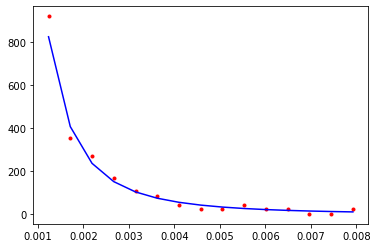

CPU times: user 1.82 ms, sys: 1.55 ms, total: 3.37 ms
Wall time: 1.12 ms
25643.82892589971


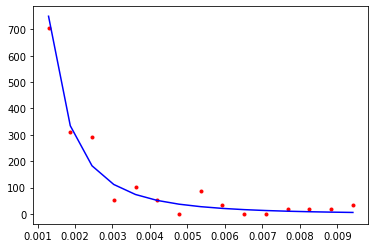

CPU times: user 797 µs, sys: 538 µs, total: 1.34 ms
Wall time: 480 µs
30151.42214292631


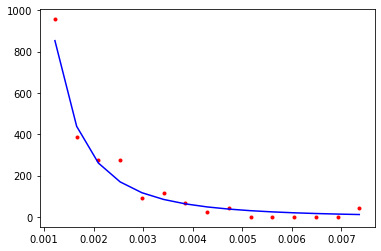

CPU times: user 1.33 ms, sys: 763 µs, total: 2.09 ms
Wall time: 723 µs
17739.019534453426


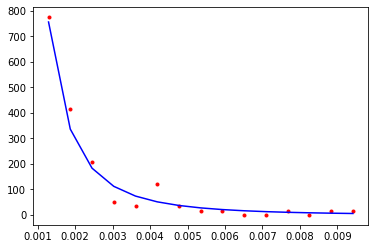

CPU times: user 1.63 ms, sys: 704 µs, total: 2.33 ms
Wall time: 808 µs
47137.95292784008


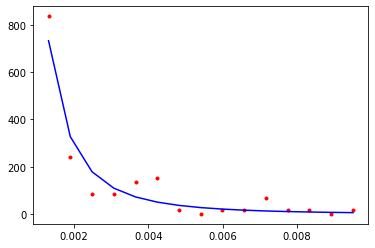

CPU times: user 1.84 ms, sys: 566 µs, total: 2.41 ms
Wall time: 803 µs
40526.163764090736


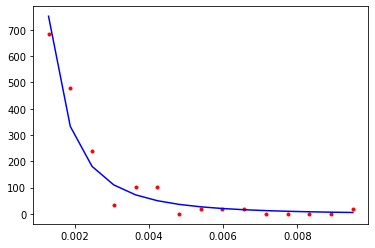

CPU times: user 2.22 ms, sys: 690 µs, total: 2.91 ms
Wall time: 1.01 ms
21979.93352829866


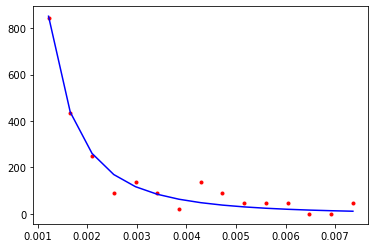

CPU times: user 2.69 ms, sys: 702 µs, total: 3.39 ms
Wall time: 1.14 ms
23487.392097191252


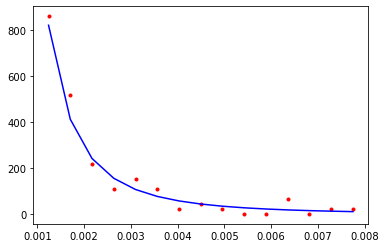

CPU times: user 3.13 ms, sys: 898 µs, total: 4.03 ms
Wall time: 1.38 ms
18229.373019026374


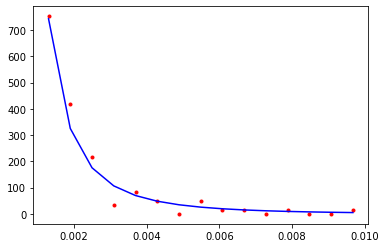

CPU times: user 3.84 ms, sys: 956 µs, total: 4.8 ms
Wall time: 1.63 ms
26784.978205257386


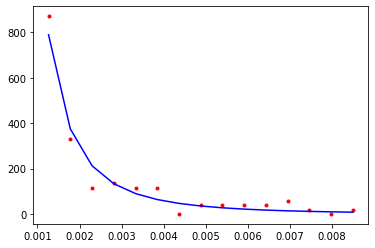

CPU times: user 3.66 ms, sys: 1.29 ms, total: 4.95 ms
Wall time: 1.78 ms
6416.0234940959845


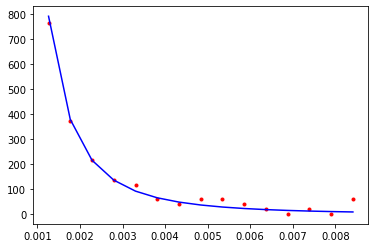

CPU times: user 4.13 ms, sys: 906 µs, total: 5.04 ms
Wall time: 1.71 ms
24502.085496717915


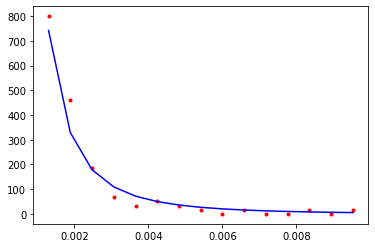

CPU times: user 4.5 ms, sys: 956 µs, total: 5.46 ms
Wall time: 1.85 ms
11526.84124758788


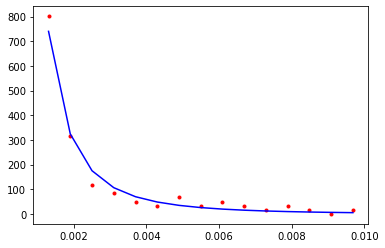

CPU times: user 4.83 ms, sys: 1.25 ms, total: 6.09 ms
Wall time: 2.12 ms
34573.130918551826


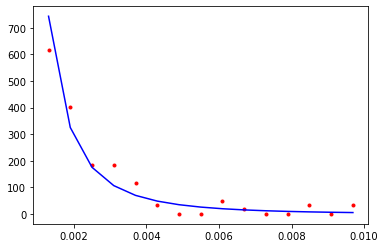

CPU times: user 5.33 ms, sys: 1.08 ms, total: 6.4 ms
Wall time: 2.15 ms
17018.368568767346


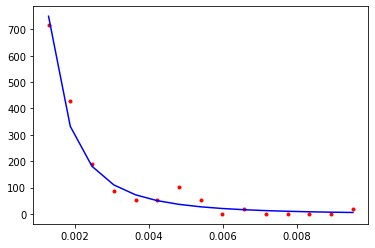

CPU times: user 5.61 ms, sys: 1.15 ms, total: 6.76 ms
Wall time: 2.28 ms
8856.78897275394


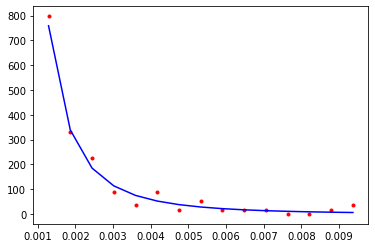

CPU times: user 6.15 ms, sys: 1.2 ms, total: 7.36 ms
Wall time: 2.49 ms
58657.615739044195


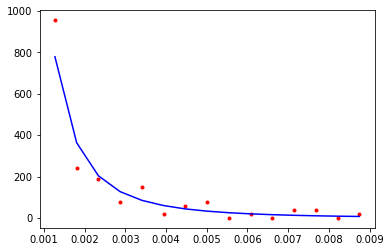

CPU times: user 6.32 ms, sys: 1.37 ms, total: 7.69 ms
Wall time: 2.62 ms
9716.164498950304


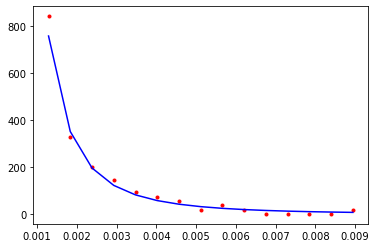

CPU times: user 6.59 ms, sys: 1.18 ms, total: 7.77 ms
Wall time: 2.6 ms
48725.81511209654


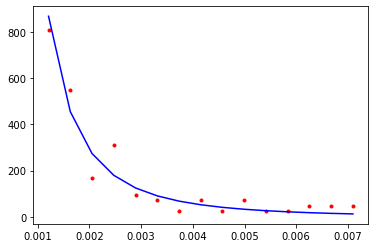

CPU times: user 7.31 ms, sys: 1.46 ms, total: 8.77 ms
Wall time: 2.98 ms
35188.104241352674


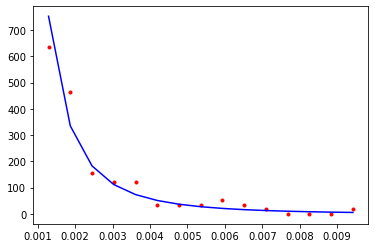

CPU times: user 7.53 ms, sys: 1.41 ms, total: 8.94 ms
Wall time: 2.99 ms
30143.63805089555


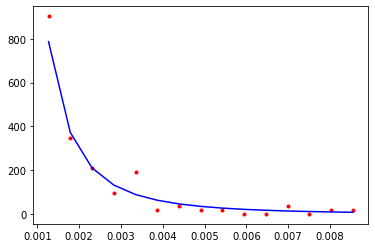

CPU times: user 7.81 ms, sys: 1.31 ms, total: 9.13 ms
Wall time: 3.06 ms
10175.183132863394


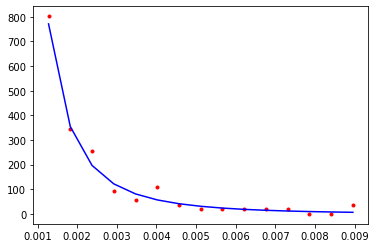

CPU times: user 1.4 ms, sys: 1.32 ms, total: 2.72 ms
Wall time: 892 µs
31282.125344171473


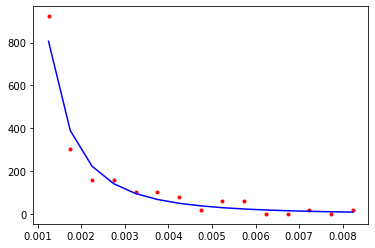

CPU times: user 811 µs, sys: 524 µs, total: 1.34 ms
Wall time: 462 µs
48889.96876910423


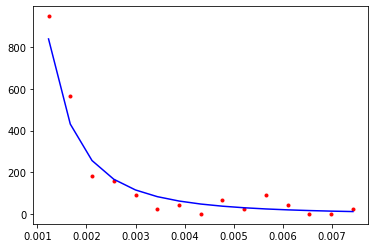

CPU times: user 1.28 ms, sys: 518 µs, total: 1.8 ms
Wall time: 605 µs
37374.31954142804


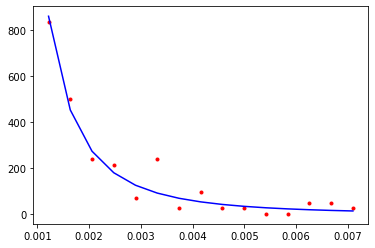

CPU times: user 1.72 ms, sys: 697 µs, total: 2.42 ms
Wall time: 859 µs
33587.73091699832


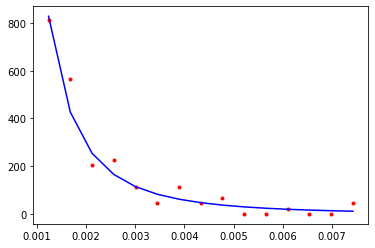

CPU times: user 2.04 ms, sys: 697 µs, total: 2.73 ms
Wall time: 943 µs
51564.05827404723


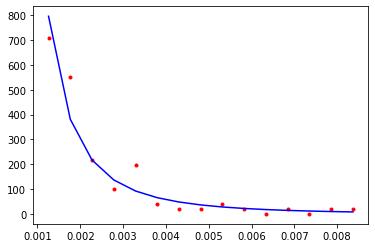

CPU times: user 2.27 ms, sys: 764 µs, total: 3.03 ms
Wall time: 1.05 ms
44487.92831890654


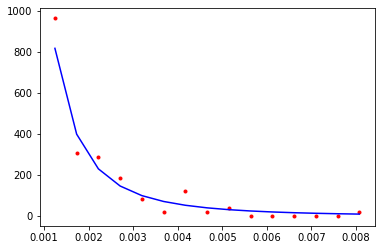

CPU times: user 2.62 ms, sys: 780 µs, total: 3.4 ms
Wall time: 1.15 ms
121106.7858581004


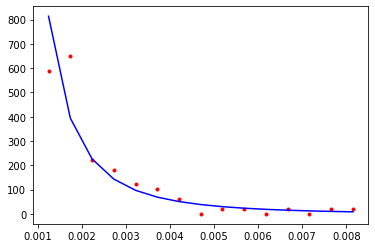

CPU times: user 3.16 ms, sys: 1.15 ms, total: 4.31 ms
Wall time: 1.52 ms
36373.7405195569


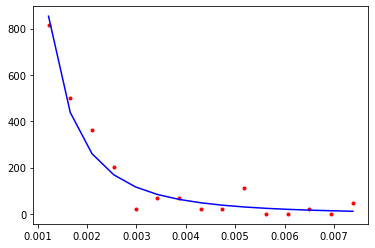

CPU times: user 3.41 ms, sys: 820 µs, total: 4.23 ms
Wall time: 1.43 ms
42713.637674733174


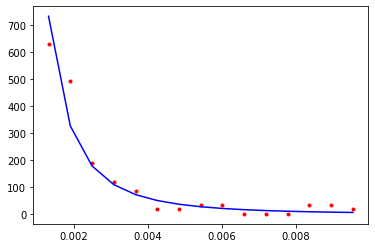

CPU times: user 3.64 ms, sys: 1.08 ms, total: 4.71 ms
Wall time: 1.64 ms
27960.807239208614


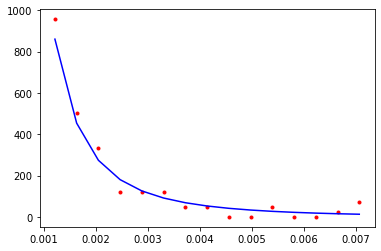

CPU times: user 4.32 ms, sys: 1.43 ms, total: 5.76 ms
Wall time: 2.03 ms
47548.503006629595


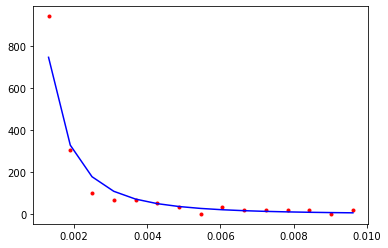

CPU times: user 5.15 ms, sys: 1.18 ms, total: 6.33 ms
Wall time: 2.16 ms
24922.653186193023


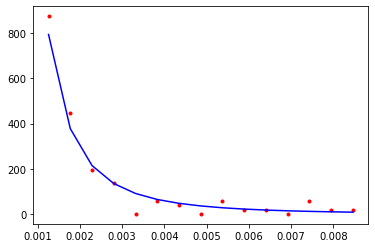

CPU times: user 4.58 ms, sys: 1.44 ms, total: 6.02 ms
Wall time: 2.13 ms
37453.05506806569


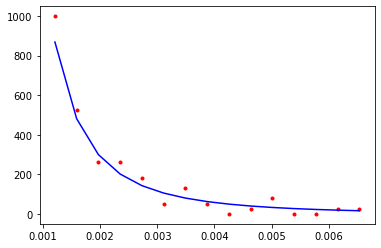

CPU times: user 5.06 ms, sys: 1.38 ms, total: 6.44 ms
Wall time: 2.23 ms
24391.785796339776


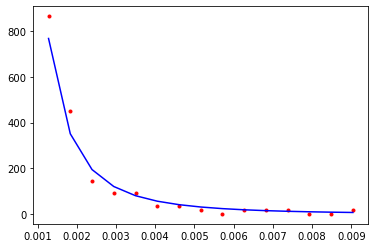

CPU times: user 5.98 ms, sys: 1.83 ms, total: 7.81 ms
Wall time: 2.83 ms
42804.52031119609


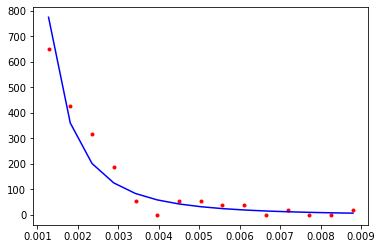

CPU times: user 5.63 ms, sys: 1.59 ms, total: 7.22 ms
Wall time: 2.54 ms
36955.34638560296


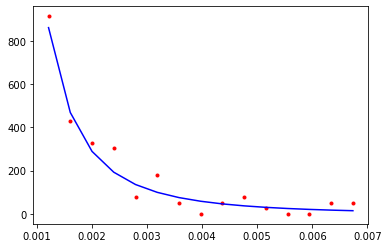

CPU times: user 6.35 ms, sys: 1.29 ms, total: 7.64 ms
Wall time: 2.58 ms
15186.714786954231


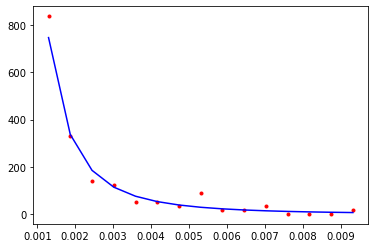

CPU times: user 6.5 ms, sys: 1.65 ms, total: 8.15 ms
Wall time: 2.84 ms
40142.89681820408


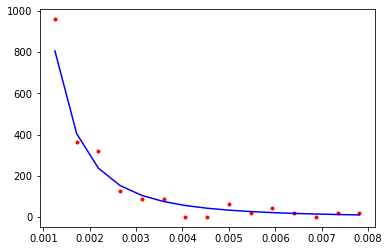

CPU times: user 6.98 ms, sys: 1.2 ms, total: 8.18 ms
Wall time: 2.75 ms
10644.4348246768


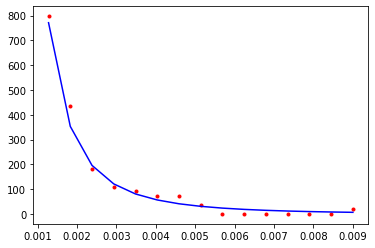

CPU times: user 7.04 ms, sys: 1.73 ms, total: 8.77 ms
Wall time: 3.04 ms
19422.28032449576


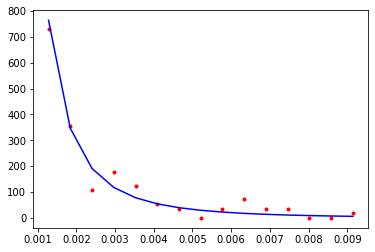

CPU times: user 8.2 ms, sys: 1.71 ms, total: 9.91 ms
Wall time: 3.42 ms
73325.43109150602


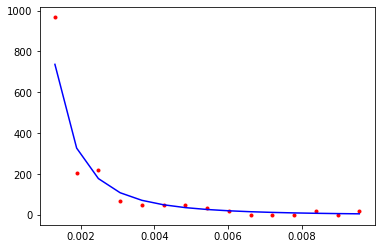

CPU times: user 1.36 ms, sys: 1.29 ms, total: 2.66 ms
Wall time: 850 µs
12140.301381051255


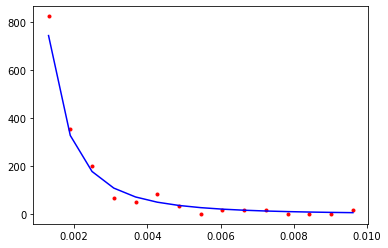

CPU times: user 861 µs, sys: 454 µs, total: 1.31 ms
Wall time: 449 µs
18480.30948987965


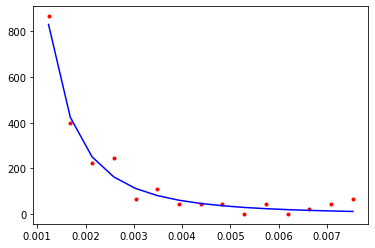

CPU times: user 1.44 ms, sys: 648 µs, total: 2.09 ms
Wall time: 722 µs
9201.22448091367


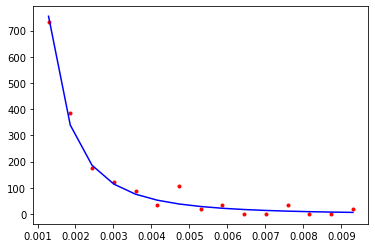

CPU times: user 1.7 ms, sys: 581 µs, total: 2.28 ms
Wall time: 762 µs
35298.47686674816


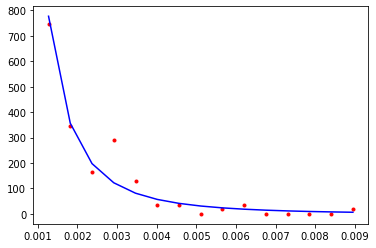

CPU times: user 2.08 ms, sys: 699 µs, total: 2.78 ms
Wall time: 947 µs
17740.98694603408


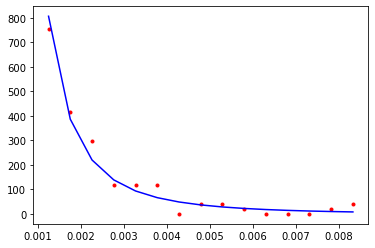

CPU times: user 2.32 ms, sys: 800 µs, total: 3.12 ms
Wall time: 1.07 ms
40172.6849821917


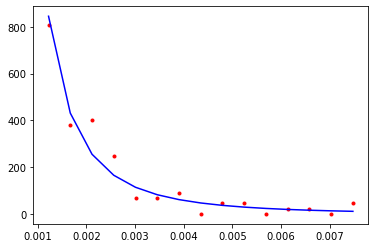

CPU times: user 2.51 ms, sys: 817 µs, total: 3.32 ms
Wall time: 1.18 ms
71548.50782126388


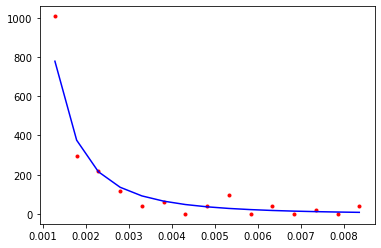

CPU times: user 2.9 ms, sys: 997 µs, total: 3.9 ms
Wall time: 1.37 ms
16245.833021048538


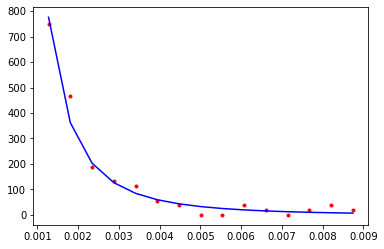

CPU times: user 3.25 ms, sys: 891 µs, total: 4.14 ms
Wall time: 1.42 ms
10925.675147247375


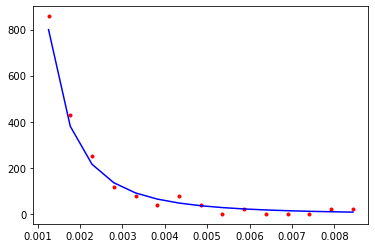

CPU times: user 4.05 ms, sys: 1.04 ms, total: 5.1 ms
Wall time: 1.74 ms
28645.616052203262


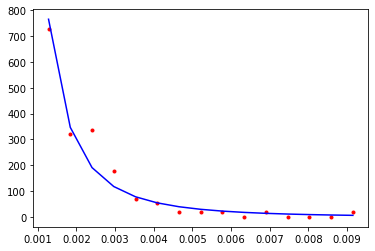

CPU times: user 4.25 ms, sys: 1.05 ms, total: 5.3 ms
Wall time: 1.8 ms
74729.66668690032


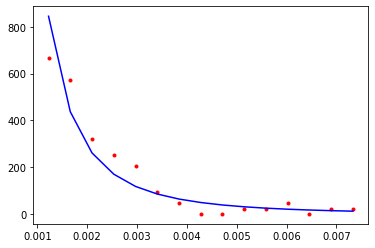

CPU times: user 4.53 ms, sys: 1.04 ms, total: 5.57 ms
Wall time: 1.91 ms
11633.899422491188


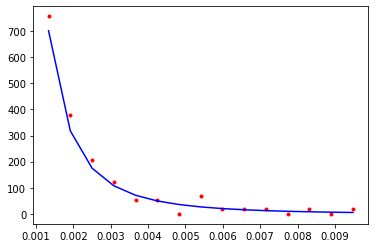

CPU times: user 4.69 ms, sys: 1.36 ms, total: 6.05 ms
Wall time: 2.13 ms
91910.28335742516


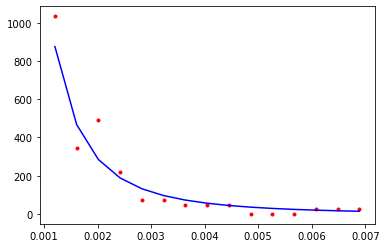

CPU times: user 5.02 ms, sys: 1.51 ms, total: 6.52 ms
Wall time: 2.28 ms
68732.96269742284


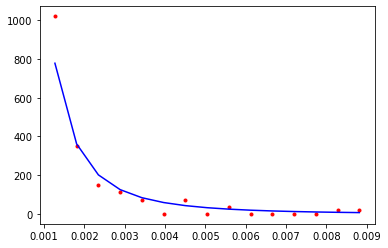

CPU times: user 5.16 ms, sys: 1.5 ms, total: 6.66 ms
Wall time: 2.35 ms
69120.32276831109


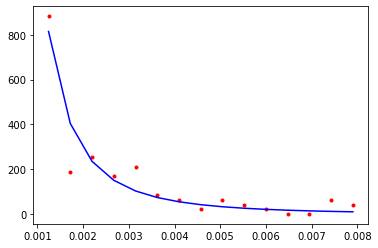

CPU times: user 5.75 ms, sys: 1.32 ms, total: 7.07 ms
Wall time: 2.42 ms
23130.37917753665


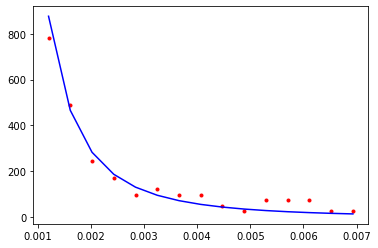

CPU times: user 6.39 ms, sys: 1.58 ms, total: 7.96 ms
Wall time: 2.76 ms
14808.469241374945


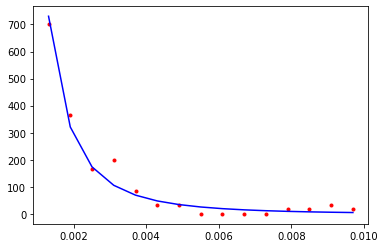

CPU times: user 6.85 ms, sys: 1.65 ms, total: 8.51 ms
Wall time: 2.91 ms
30131.00657096678


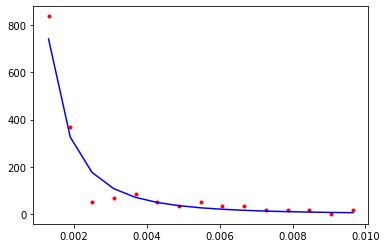

CPU times: user 7.01 ms, sys: 1.39 ms, total: 8.4 ms
Wall time: 2.85 ms
9546.585273777988


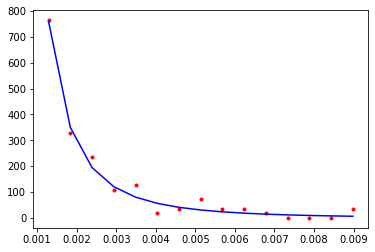

CPU times: user 7.34 ms, sys: 1.57 ms, total: 8.91 ms
Wall time: 3.01 ms
30894.15474021134


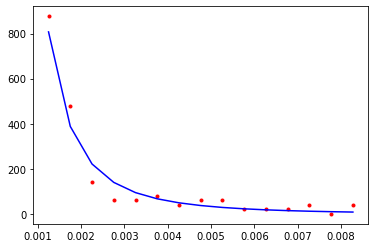

CPU times: user 7.91 ms, sys: 1.39 ms, total: 9.3 ms
Wall time: 3.12 ms
54507.802379650355


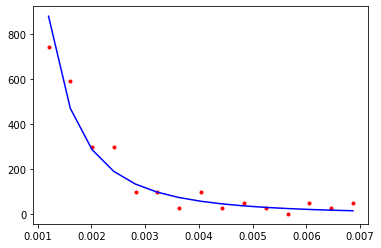

CPU times: user 1.33 ms, sys: 1.23 ms, total: 2.56 ms
Wall time: 856 µs
38938.68748600606


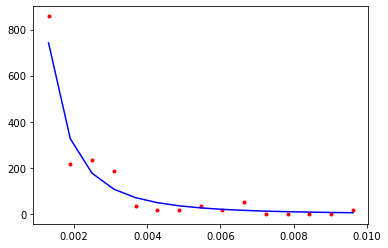

CPU times: user 1.15 ms, sys: 570 µs, total: 1.72 ms
Wall time: 593 µs
23525.919816495545


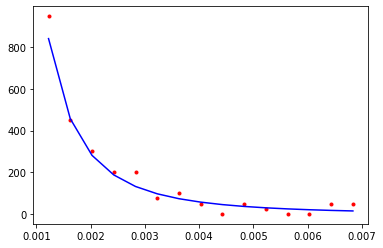

CPU times: user 1.43 ms, sys: 574 µs, total: 2.01 ms
Wall time: 701 µs
43125.86725462017


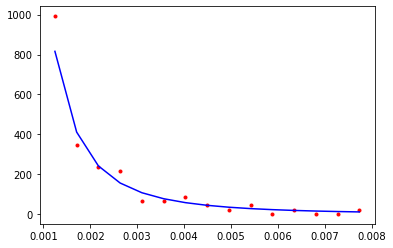

CPU times: user 1.7 ms, sys: 713 µs, total: 2.42 ms
Wall time: 832 µs
26446.670493174384


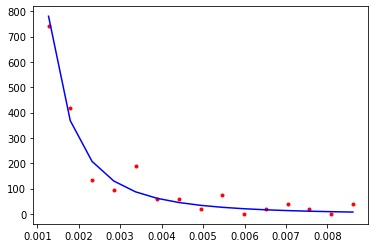

CPU times: user 2.02 ms, sys: 627 µs, total: 2.65 ms
Wall time: 888 µs
24940.284550624714


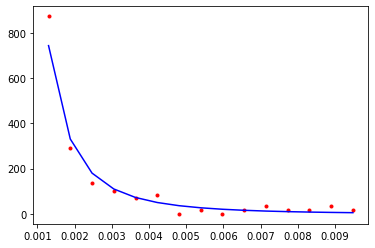

CPU times: user 2.26 ms, sys: 669 µs, total: 2.93 ms
Wall time: 994 µs
65018.08867876102


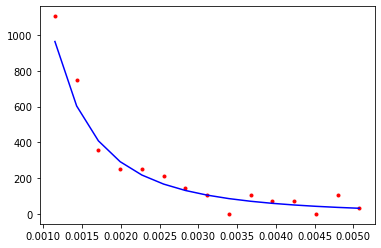

CPU times: user 2.28 ms, sys: 1.15 ms, total: 3.43 ms
Wall time: 1.27 ms
14159.259884186173


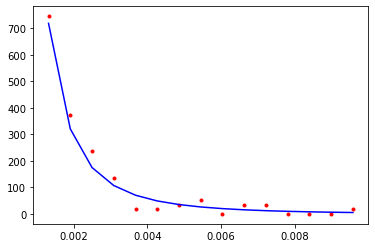

CPU times: user 3.27 ms, sys: 1.04 ms, total: 4.32 ms
Wall time: 1.51 ms
27507.70928913083


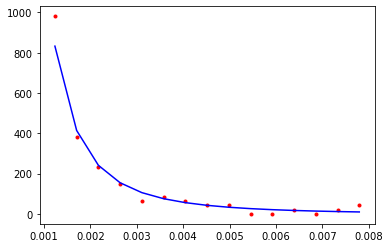

CPU times: user 3.46 ms, sys: 882 µs, total: 4.34 ms
Wall time: 1.47 ms
21459.162456862803


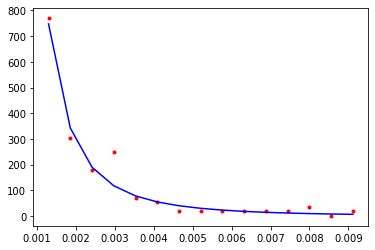

CPU times: user 3.69 ms, sys: 970 µs, total: 4.66 ms
Wall time: 1.61 ms
28353.969056379072


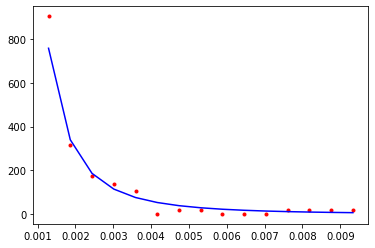

CPU times: user 4.2 ms, sys: 1.1 ms, total: 5.3 ms
Wall time: 1.83 ms
59096.63555153822


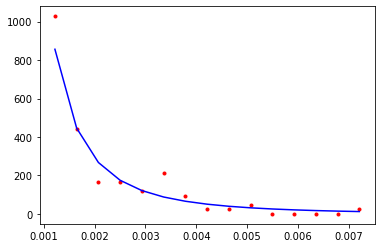

CPU times: user 4.56 ms, sys: 1.26 ms, total: 5.82 ms
Wall time: 2.04 ms
18471.59802554968


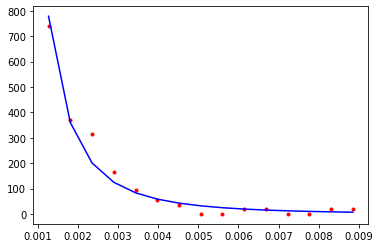

CPU times: user 4.85 ms, sys: 1.08 ms, total: 5.93 ms
Wall time: 2.02 ms
14615.476288440046


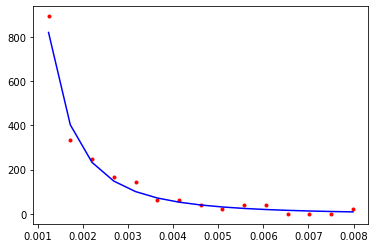

CPU times: user 5 ms, sys: 1.65 ms, total: 6.65 ms
Wall time: 2.4 ms
22787.555848131688


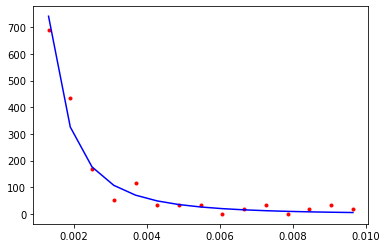

CPU times: user 5.86 ms, sys: 1.24 ms, total: 7.09 ms
Wall time: 2.41 ms
15752.528666026137


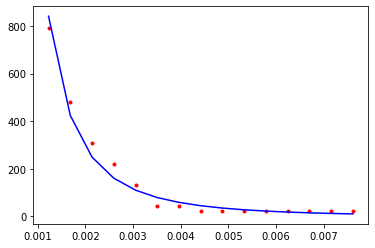

CPU times: user 5.08 ms, sys: 1.02 ms, total: 6.1 ms
Wall time: 2.47 ms
16855.08096770879


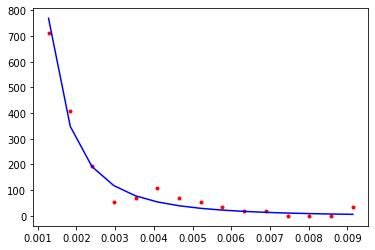

CPU times: user 6.45 ms, sys: 1.33 ms, total: 7.79 ms
Wall time: 2.64 ms
23051.03354206189


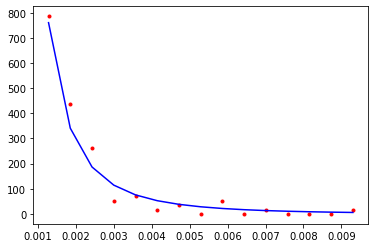

CPU times: user 6.6 ms, sys: 1.68 ms, total: 8.27 ms
Wall time: 2.91 ms
21583.299888284717


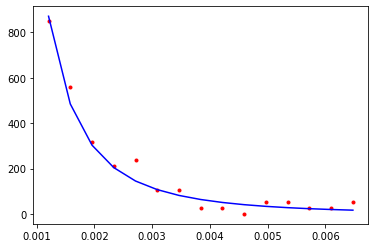

CPU times: user 7.04 ms, sys: 1.35 ms, total: 8.4 ms
Wall time: 2.83 ms
27066.991237260943


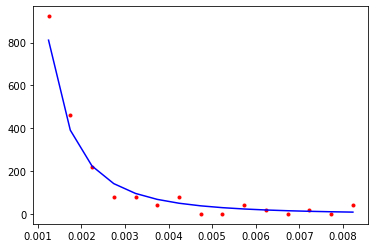

CPU times: user 7.32 ms, sys: 2.05 ms, total: 9.37 ms
Wall time: 3.32 ms
28360.711952697173


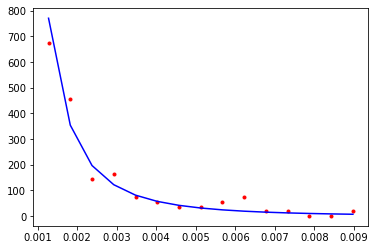

CPU times: user 7.88 ms, sys: 1.45 ms, total: 9.33 ms
Wall time: 3.13 ms
3727.9527732930765


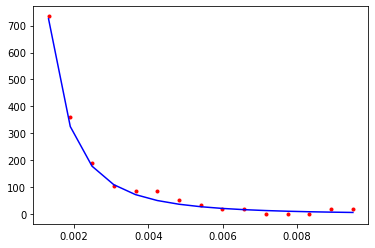

CPU times: user 1.23 ms, sys: 1.2 ms, total: 2.43 ms
Wall time: 804 µs
29771.84260003772


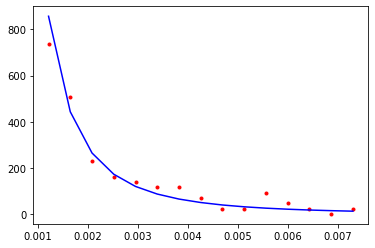

CPU times: user 1.06 ms, sys: 606 µs, total: 1.66 ms
Wall time: 588 µs
74572.09631569531


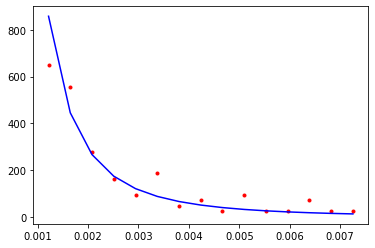

CPU times: user 1.2 ms, sys: 541 µs, total: 1.74 ms
Wall time: 596 µs
17310.96946296522


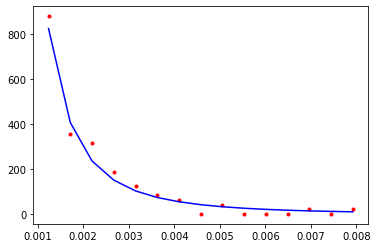

CPU times: user 1.73 ms, sys: 688 µs, total: 2.42 ms
Wall time: 839 µs
24777.042308660577


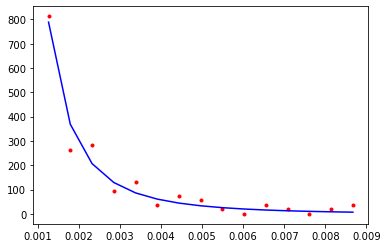

CPU times: user 2.01 ms, sys: 633 µs, total: 2.64 ms
Wall time: 887 µs
9693.534056436909


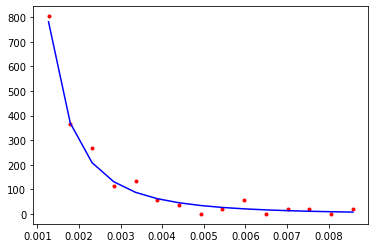

CPU times: user 2.3 ms, sys: 721 µs, total: 3.02 ms
Wall time: 1.03 ms
11443.725145881446


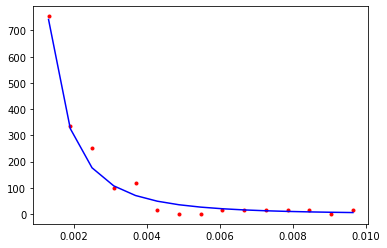

CPU times: user 2.92 ms, sys: 847 µs, total: 3.77 ms
Wall time: 1.29 ms
35660.061966264184


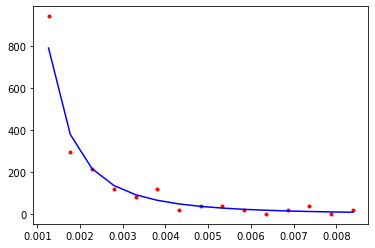

CPU times: user 3.18 ms, sys: 883 µs, total: 4.06 ms
Wall time: 1.4 ms
11371.11850414226


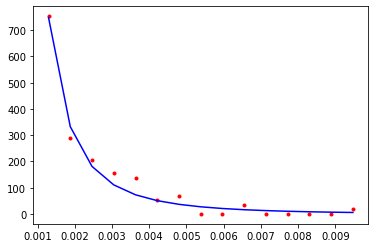

CPU times: user 3.64 ms, sys: 945 µs, total: 4.58 ms
Wall time: 1.57 ms
25349.739270474063


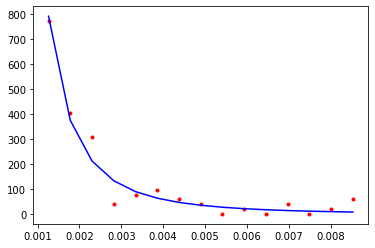

CPU times: user 3.72 ms, sys: 846 µs, total: 4.57 ms
Wall time: 1.55 ms
33207.947733918634


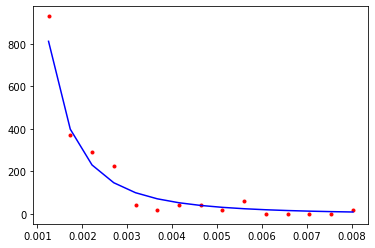

CPU times: user 4.01 ms, sys: 1.01 ms, total: 5.02 ms
Wall time: 1.72 ms
16832.252645175842


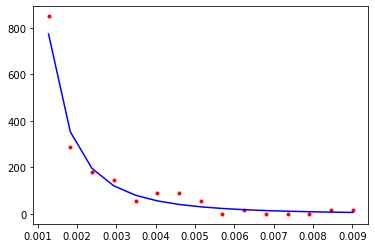

CPU times: user 4.52 ms, sys: 978 µs, total: 5.5 ms
Wall time: 1.86 ms
20762.616467056483


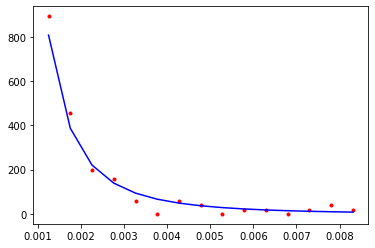

CPU times: user 4.84 ms, sys: 985 µs, total: 5.82 ms
Wall time: 1.97 ms
27754.13423087838


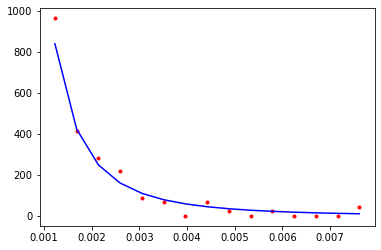

CPU times: user 5.29 ms, sys: 1.15 ms, total: 6.44 ms
Wall time: 2.2 ms
18305.72377262654


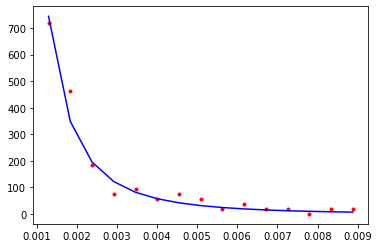

CPU times: user 5.81 ms, sys: 1.2 ms, total: 7.01 ms
Wall time: 2.36 ms
53839.58690469243


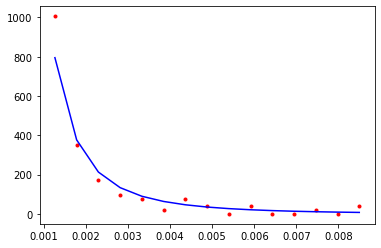

CPU times: user 6.05 ms, sys: 1.17 ms, total: 7.22 ms
Wall time: 2.42 ms
19671.68221334456


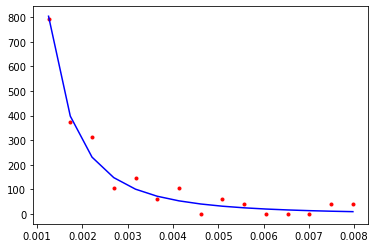

CPU times: user 6.19 ms, sys: 1.32 ms, total: 7.51 ms
Wall time: 2.56 ms
77558.28786145448


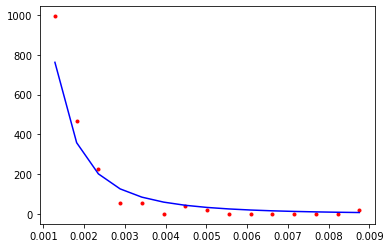

CPU times: user 6.74 ms, sys: 1.24 ms, total: 7.98 ms
Wall time: 2.68 ms
24677.80164295984


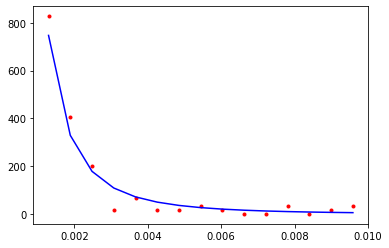

CPU times: user 7.44 ms, sys: 1.44 ms, total: 8.88 ms
Wall time: 2.99 ms
16825.398101764524


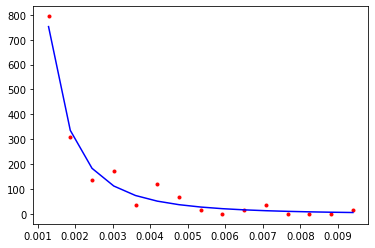

CPU times: user 7.67 ms, sys: 1.39 ms, total: 9.06 ms
Wall time: 3.05 ms
32102.34944661769


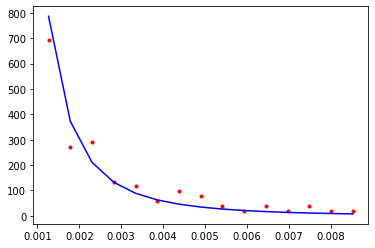

CPU times: user 8.32 ms, sys: 1.42 ms, total: 9.74 ms
Wall time: 3.26 ms
38322.8578754907


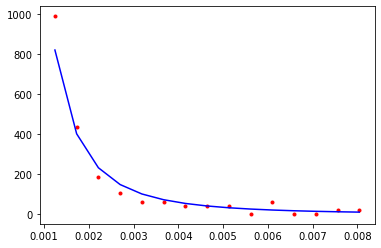

CPU times: user 1.21 ms, sys: 1.09 ms, total: 2.3 ms
Wall time: 744 µs
18649.760250166106


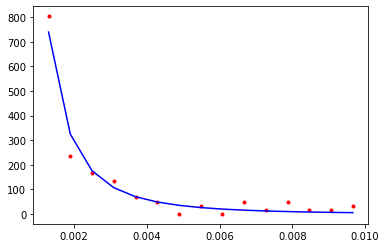

CPU times: user 919 µs, sys: 537 µs, total: 1.46 ms
Wall time: 494 µs
14490.722897747859


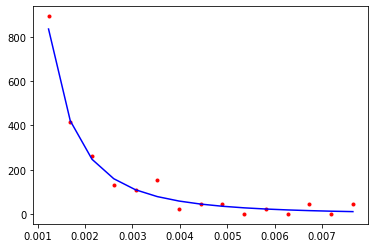

CPU times: user 1.46 ms, sys: 627 µs, total: 2.08 ms
Wall time: 730 µs
161472.4070423545


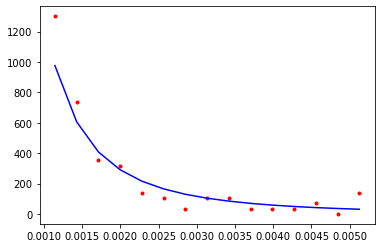

CPU times: user 1.88 ms, sys: 757 µs, total: 2.64 ms
Wall time: 912 µs
31817.779271359566


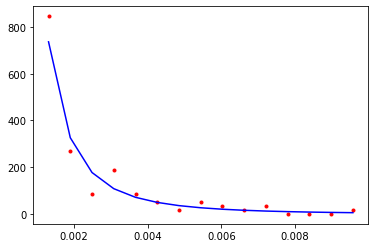

CPU times: user 2.05 ms, sys: 755 µs, total: 2.8 ms
Wall time: 968 µs
41333.92708140353


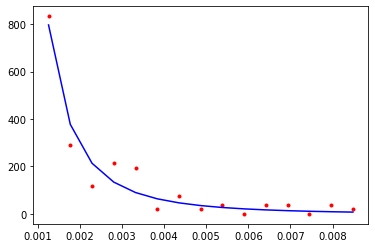

CPU times: user 2.27 ms, sys: 752 µs, total: 3.02 ms
Wall time: 1.04 ms
17697.847215258465


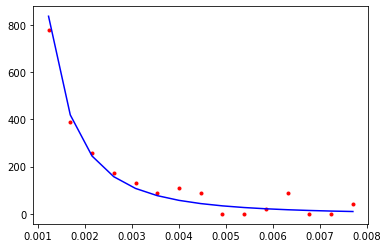

CPU times: user 2.66 ms, sys: 750 µs, total: 3.41 ms
Wall time: 1.16 ms
19987.993386490045


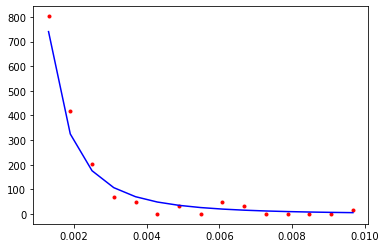

CPU times: user 3.02 ms, sys: 862 µs, total: 3.88 ms
Wall time: 1.32 ms
78207.6085037723


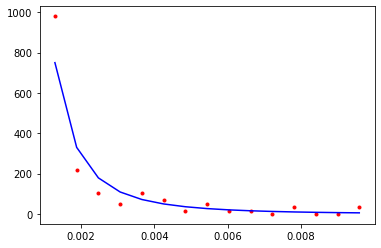

CPU times: user 4.06 ms, sys: 1.16 ms, total: 5.22 ms
Wall time: 1.76 ms
14333.142761285879


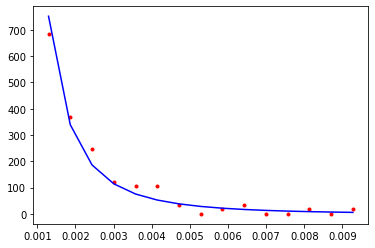

CPU times: user 3.73 ms, sys: 928 µs, total: 4.66 ms
Wall time: 1.59 ms
14470.846297455268


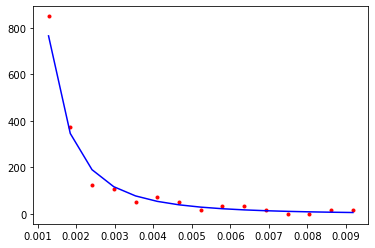

CPU times: user 4.11 ms, sys: 878 µs, total: 4.99 ms
Wall time: 1.69 ms
62536.81208624145


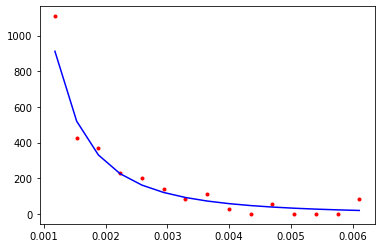

CPU times: user 4.52 ms, sys: 1.15 ms, total: 5.67 ms
Wall time: 1.95 ms
81727.63339064928


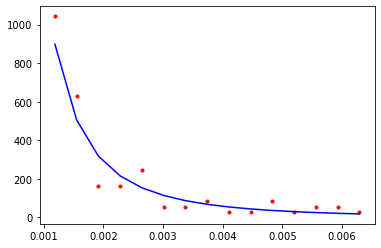

CPU times: user 5.05 ms, sys: 1.1 ms, total: 6.15 ms
Wall time: 2.09 ms
10649.004973578827


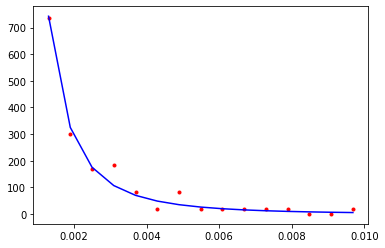

CPU times: user 5.49 ms, sys: 1.21 ms, total: 6.7 ms
Wall time: 2.27 ms
45167.91561196108


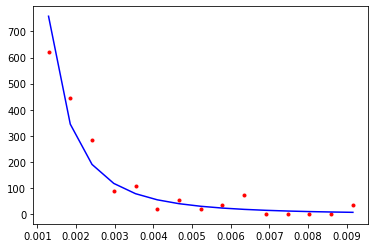

CPU times: user 5.53 ms, sys: 1.2 ms, total: 6.73 ms
Wall time: 2.29 ms
26605.926164235996


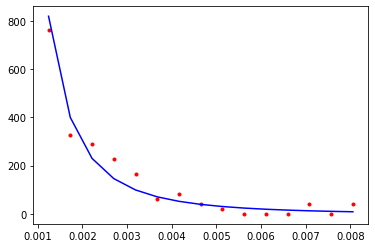

CPU times: user 5.97 ms, sys: 1.2 ms, total: 7.17 ms
Wall time: 2.43 ms
11979.35371390416


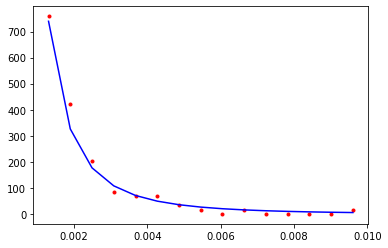

CPU times: user 6.32 ms, sys: 1.22 ms, total: 7.55 ms
Wall time: 2.53 ms
38255.98902713449


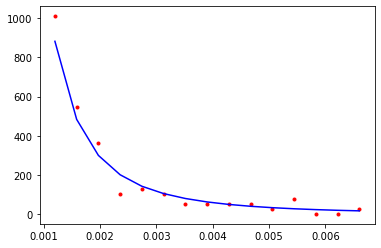

CPU times: user 6.77 ms, sys: 1.23 ms, total: 8 ms
Wall time: 2.69 ms
16972.80928535959


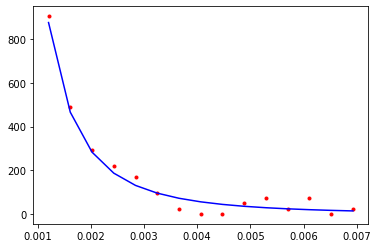

CPU times: user 7.25 ms, sys: 1.37 ms, total: 8.62 ms
Wall time: 2.91 ms
22928.251866919432


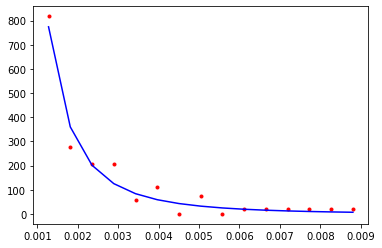

CPU times: user 7.48 ms, sys: 1.3 ms, total: 8.79 ms
Wall time: 2.95 ms
154626.0312207664


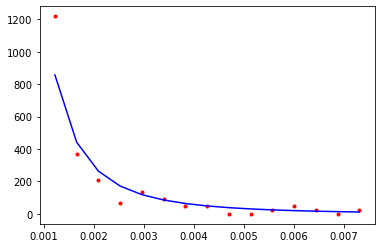

CPU times: user 7.76 ms, sys: 1.31 ms, total: 9.07 ms
Wall time: 3.09 ms
15477.368598008075


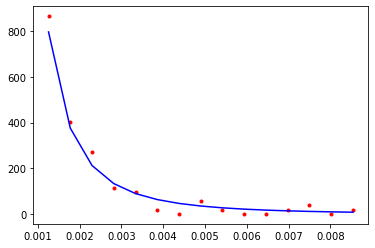

CPU times: user 1.34 ms, sys: 1.27 ms, total: 2.6 ms
Wall time: 853 µs
12856.844196460635


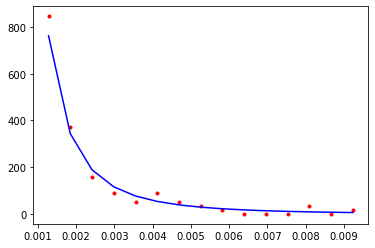

CPU times: user 1.1 ms, sys: 585 µs, total: 1.69 ms
Wall time: 587 µs
33169.40548903078


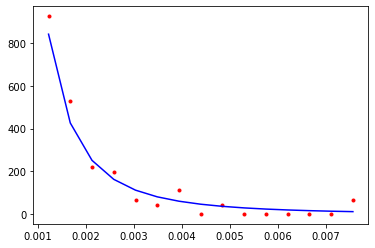

CPU times: user 1.22 ms, sys: 512 µs, total: 1.73 ms
Wall time: 583 µs
16824.34796127404


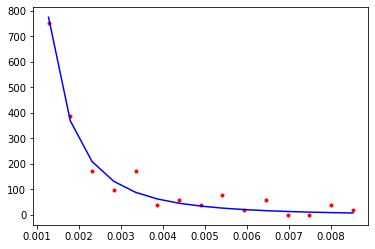

CPU times: user 1.66 ms, sys: 537 µs, total: 2.2 ms
Wall time: 733 µs
24369.199596658575


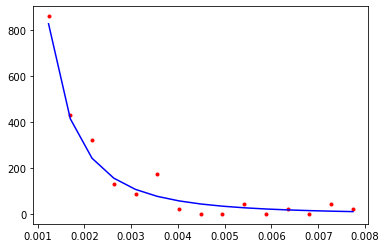

CPU times: user 1.95 ms, sys: 592 µs, total: 2.54 ms
Wall time: 880 µs
28882.798359272558


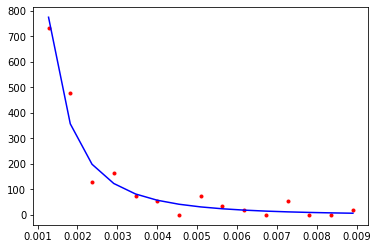

CPU times: user 2.24 ms, sys: 772 µs, total: 3.02 ms
Wall time: 1.03 ms
16881.320233815815


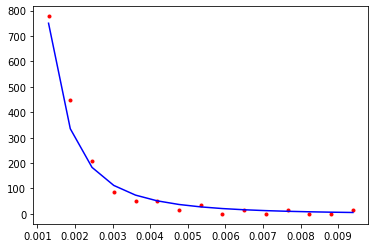

CPU times: user 2.65 ms, sys: 761 µs, total: 3.41 ms
Wall time: 1.17 ms
33391.454825195724


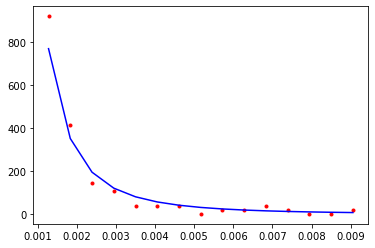

CPU times: user 3.06 ms, sys: 799 µs, total: 3.85 ms
Wall time: 1.31 ms
26380.097048577572


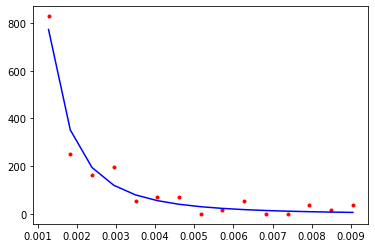

CPU times: user 3.58 ms, sys: 959 µs, total: 4.54 ms
Wall time: 1.56 ms
56426.96960758418


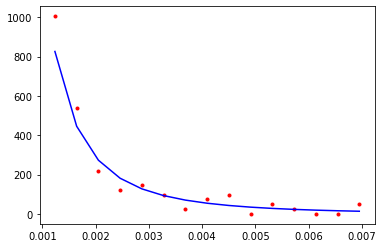

CPU times: user 3.99 ms, sys: 1.01 ms, total: 4.99 ms
Wall time: 1.71 ms
9580.258012114666


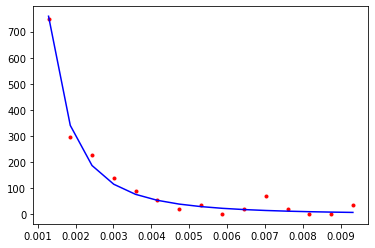

CPU times: user 4.34 ms, sys: 946 µs, total: 5.29 ms
Wall time: 1.78 ms
55084.16238533562


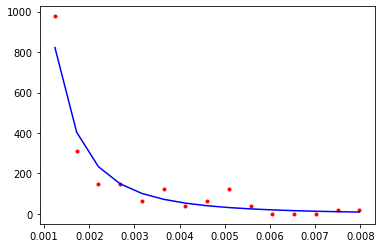

CPU times: user 4.73 ms, sys: 1.14 ms, total: 5.86 ms
Wall time: 2.02 ms
36857.5500432727


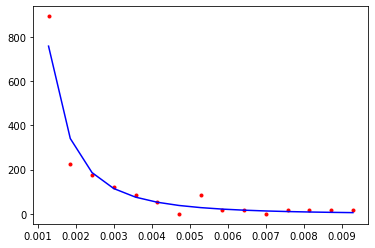

CPU times: user 4.95 ms, sys: 1.06 ms, total: 6.01 ms
Wall time: 2.03 ms
8855.887610335034


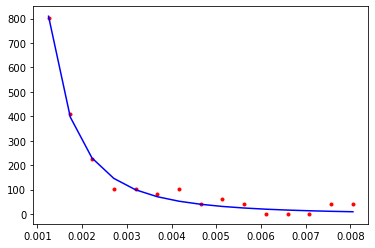

CPU times: user 5.29 ms, sys: 1.07 ms, total: 6.35 ms
Wall time: 2.13 ms
11217.76097074458


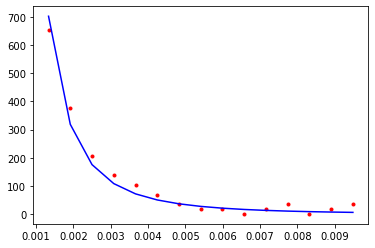

CPU times: user 6.36 ms, sys: 1.29 ms, total: 7.65 ms
Wall time: 2.6 ms
44052.89214421182


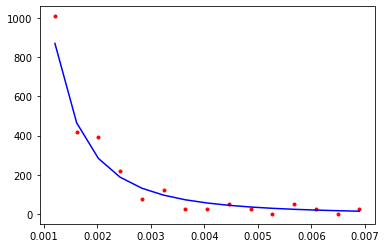

CPU times: user 6.2 ms, sys: 1.25 ms, total: 7.45 ms
Wall time: 2.52 ms
10267.021249339718


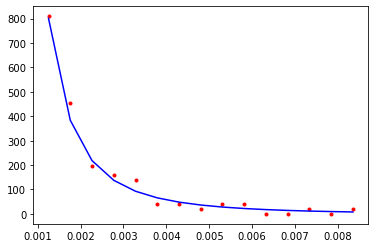

CPU times: user 6.38 ms, sys: 1.24 ms, total: 7.62 ms
Wall time: 2.55 ms
10765.51225760361


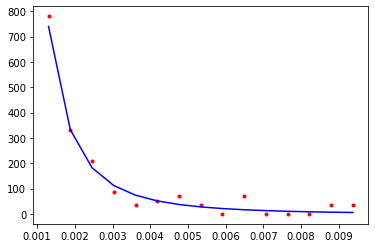

CPU times: user 6.69 ms, sys: 1.28 ms, total: 7.97 ms
Wall time: 2.68 ms
39043.21759575814


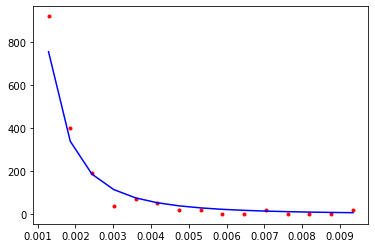

CPU times: user 7.43 ms, sys: 1.37 ms, total: 8.8 ms
Wall time: 2.96 ms
16229.851404741823


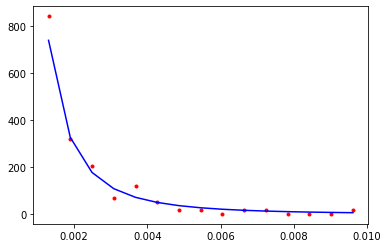

CPU times: user 7.54 ms, sys: 1.32 ms, total: 8.86 ms
Wall time: 2.96 ms
43466.022479685395


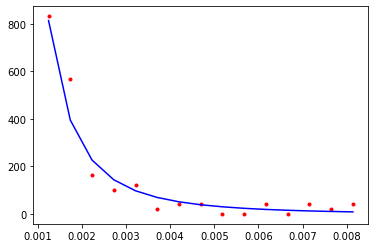

CPU times: user 8.03 ms, sys: 1.43 ms, total: 9.47 ms
Wall time: 3.18 ms
19472.53397178575


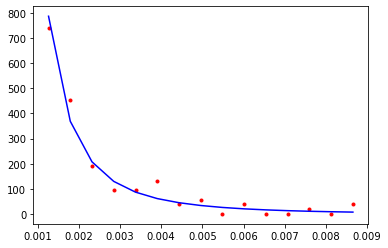

CPU times: user 1.14 ms, sys: 1.12 ms, total: 2.27 ms
Wall time: 740 µs
27140.156103688198


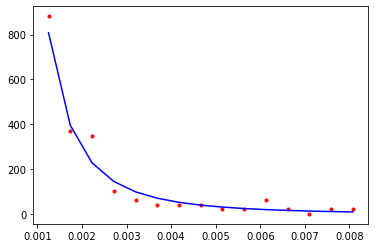

CPU times: user 876 µs, sys: 430 µs, total: 1.31 ms
Wall time: 452 µs
64668.15282386615


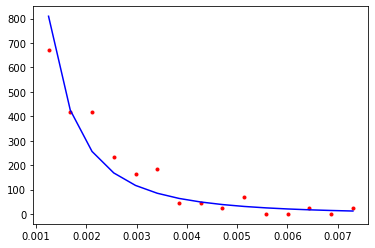

CPU times: user 1.15 ms, sys: 543 µs, total: 1.69 ms
Wall time: 591 µs
10621.845248176958


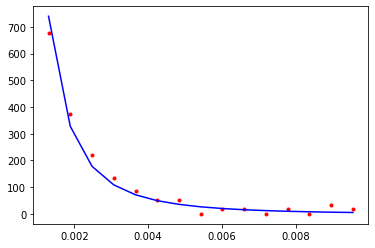

CPU times: user 1.66 ms, sys: 582 µs, total: 2.24 ms
Wall time: 763 µs
16054.074648312444


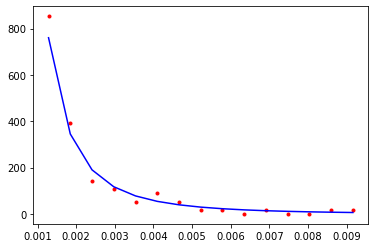

CPU times: user 1.93 ms, sys: 667 µs, total: 2.59 ms
Wall time: 894 µs
136727.20982940827


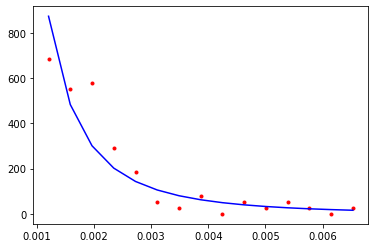

CPU times: user 2.52 ms, sys: 739 µs, total: 3.26 ms
Wall time: 1.12 ms
37694.439100211406


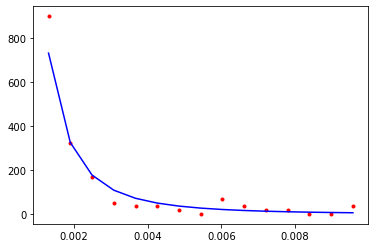

CPU times: user 2.81 ms, sys: 786 µs, total: 3.59 ms
Wall time: 1.25 ms
22430.616245869


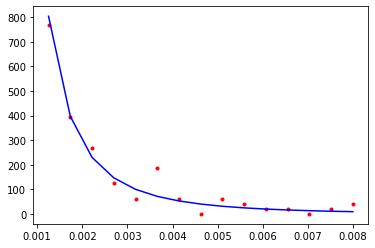

CPU times: user 2.83 ms, sys: 695 µs, total: 3.53 ms
Wall time: 1.19 ms
54456.289606441176


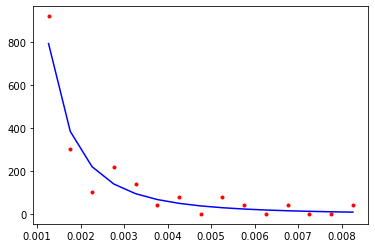

CPU times: user 3.43 ms, sys: 873 µs, total: 4.31 ms
Wall time: 1.46 ms
16893.41520416066


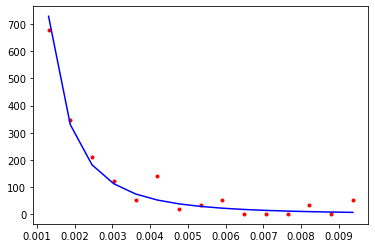

CPU times: user 3.75 ms, sys: 895 µs, total: 4.64 ms
Wall time: 1.57 ms
11209.797618972034


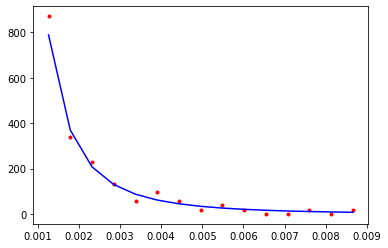

CPU times: user 3.87 ms, sys: 833 µs, total: 4.7 ms
Wall time: 1.6 ms
49304.1843625418


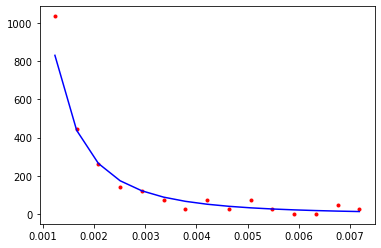

CPU times: user 4.64 ms, sys: 1.05 ms, total: 5.69 ms
Wall time: 1.94 ms
19121.983783387946


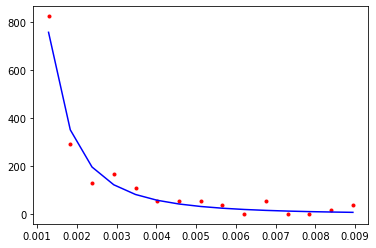

CPU times: user 4.93 ms, sys: 1.03 ms, total: 5.95 ms
Wall time: 2.01 ms
20514.145968853794


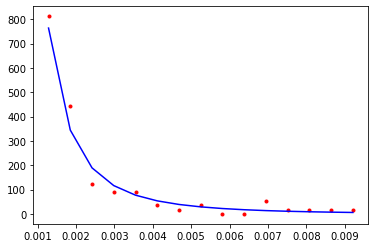

CPU times: user 5.21 ms, sys: 1.11 ms, total: 6.33 ms
Wall time: 2.14 ms
9562.298607924424


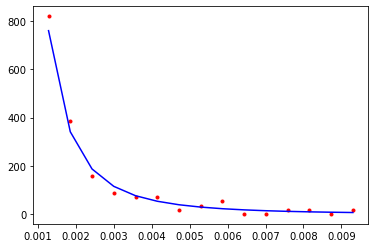

CPU times: user 5.85 ms, sys: 1.2 ms, total: 7.06 ms
Wall time: 2.38 ms
18762.65596897368


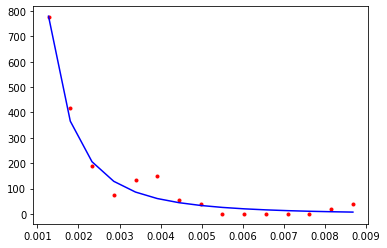

CPU times: user 5.7 ms, sys: 1.43 ms, total: 7.13 ms
Wall time: 2.48 ms
6705.822660285981


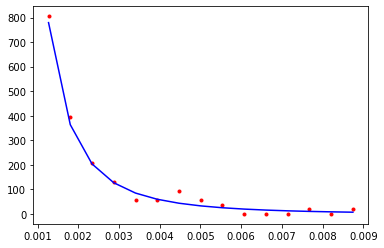

CPU times: user 6.29 ms, sys: 1.23 ms, total: 7.52 ms
Wall time: 2.54 ms
139936.67805262562


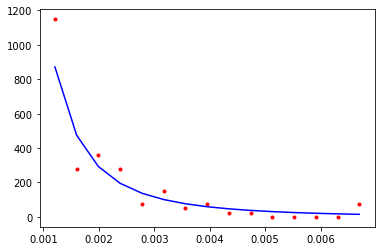

CPU times: user 6.7 ms, sys: 1.35 ms, total: 8.05 ms
Wall time: 2.73 ms
12750.42054010801


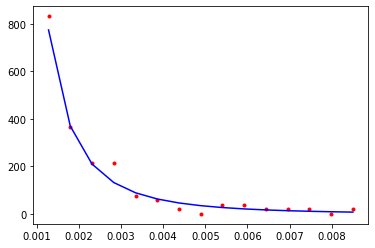

CPU times: user 7.39 ms, sys: 1.46 ms, total: 8.85 ms
Wall time: 2.98 ms
92738.54961450328


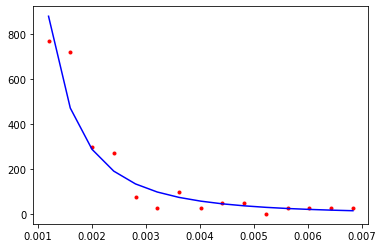

CPU times: user 7.76 ms, sys: 1.42 ms, total: 9.18 ms
Wall time: 3.08 ms
57887.296729090966


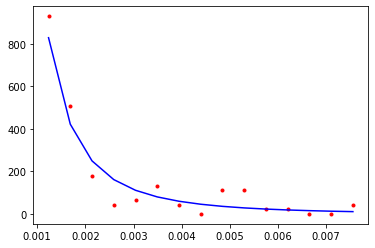

CPU times: user 7.77 ms, sys: 1.41 ms, total: 9.18 ms
Wall time: 3.09 ms
58120.76770480812


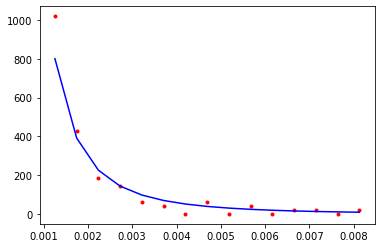

CPU times: user 1.36 ms, sys: 1.27 ms, total: 2.64 ms
Wall time: 883 µs
39988.25086139708


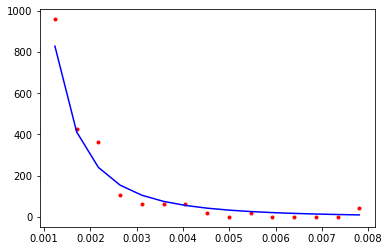

CPU times: user 929 µs, sys: 509 µs, total: 1.44 ms
Wall time: 490 µs
70964.76254181386


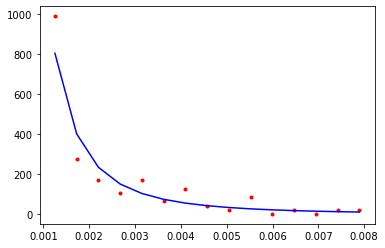

CPU times: user 1.49 ms, sys: 643 µs, total: 2.14 ms
Wall time: 735 µs
26746.952535397624


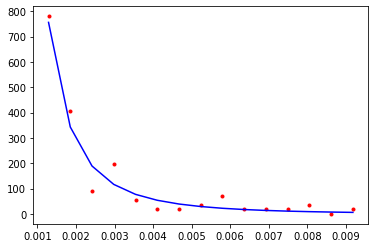

CPU times: user 1.63 ms, sys: 580 µs, total: 2.21 ms
Wall time: 749 µs
38709.53820222572


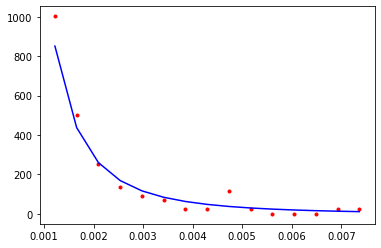

CPU times: user 1.95 ms, sys: 583 µs, total: 2.53 ms
Wall time: 878 µs
33525.23142811617


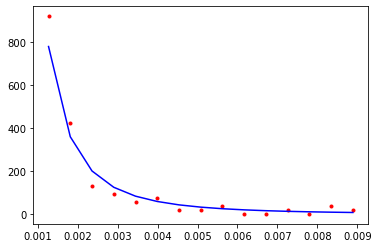

CPU times: user 2.34 ms, sys: 797 µs, total: 3.14 ms
Wall time: 1.08 ms
9398.265790508769


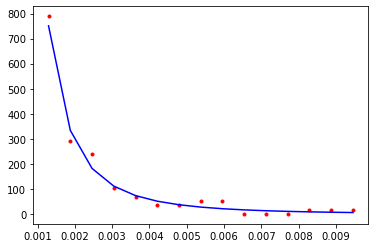

CPU times: user 2.67 ms, sys: 756 µs, total: 3.42 ms
Wall time: 1.17 ms
29201.17426522214


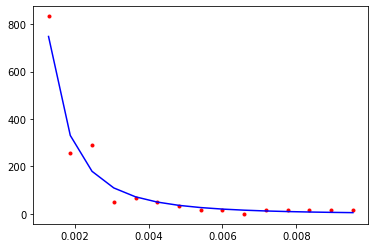

CPU times: user 3.29 ms, sys: 856 µs, total: 4.15 ms
Wall time: 1.41 ms
71929.03867942019


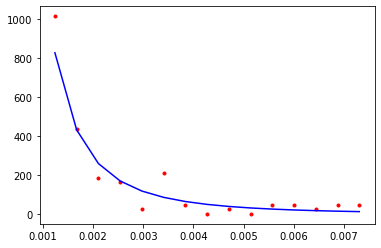

CPU times: user 3.42 ms, sys: 883 µs, total: 4.31 ms
Wall time: 1.48 ms
46823.307087831185


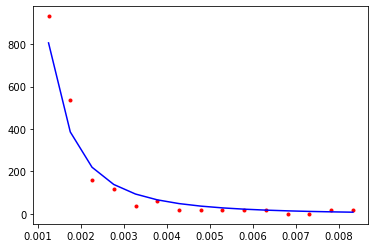

CPU times: user 3.91 ms, sys: 1.04 ms, total: 4.94 ms
Wall time: 1.71 ms
45004.41168925405


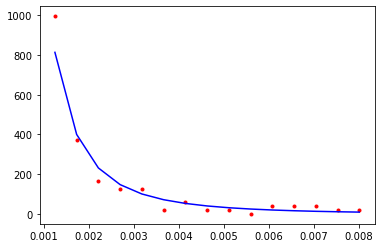

CPU times: user 4.18 ms, sys: 1.02 ms, total: 5.2 ms
Wall time: 1.78 ms
18361.277880553123


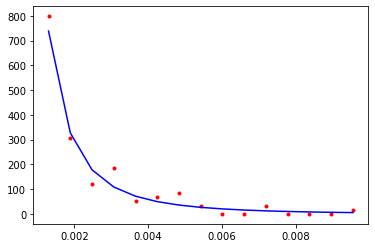

CPU times: user 4.68 ms, sys: 1.07 ms, total: 5.75 ms
Wall time: 1.96 ms
49709.81625939704


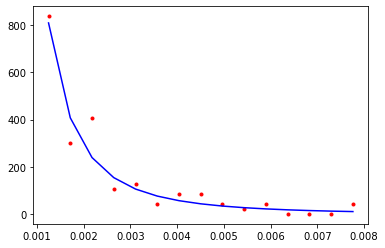

CPU times: user 4.82 ms, sys: 1.06 ms, total: 5.88 ms
Wall time: 2.01 ms
4979.708583699183


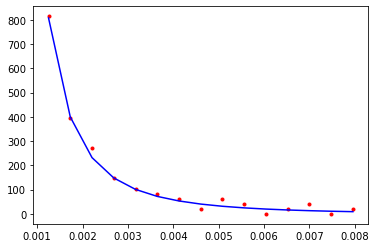

CPU times: user 5.2 ms, sys: 1.16 ms, total: 6.35 ms
Wall time: 2.16 ms
36504.1303709432


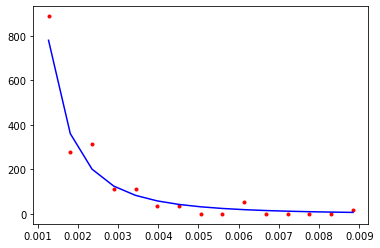

CPU times: user 5.48 ms, sys: 1.23 ms, total: 6.71 ms
Wall time: 2.3 ms
31305.997740564293


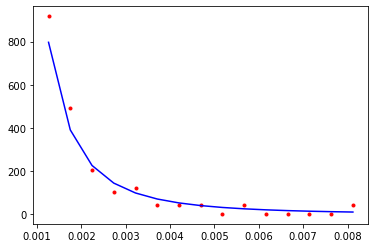

CPU times: user 6.16 ms, sys: 1.26 ms, total: 7.42 ms
Wall time: 2.52 ms
28240.886547208378


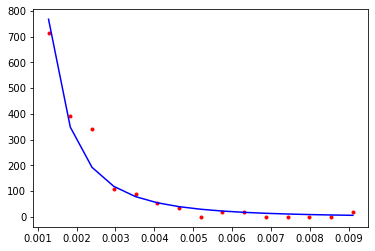

CPU times: user 6.33 ms, sys: 1.22 ms, total: 7.55 ms
Wall time: 2.55 ms
70670.51783468659


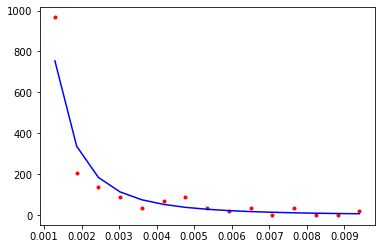

CPU times: user 6.66 ms, sys: 1.23 ms, total: 7.88 ms
Wall time: 2.67 ms
31340.63979476024


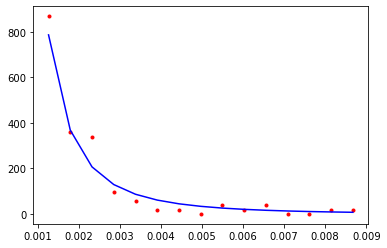

CPU times: user 7.16 ms, sys: 1.27 ms, total: 8.42 ms
Wall time: 2.84 ms
8984.669322874592


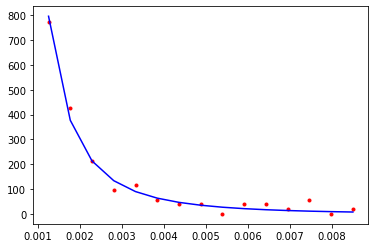

CPU times: user 7.53 ms, sys: 1.31 ms, total: 8.83 ms
Wall time: 2.96 ms
15683.106242651334


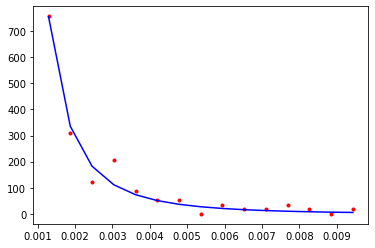

CPU times: user 7.83 ms, sys: 1.33 ms, total: 9.16 ms
Wall time: 3.07 ms
52579.05999886301


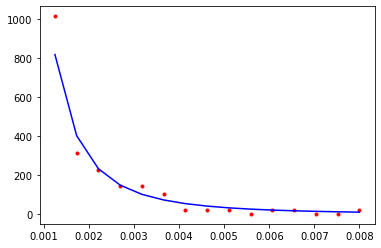

CPU times: user 1.49 ms, sys: 1.44 ms, total: 2.93 ms
Wall time: 945 µs
21334.786708161442


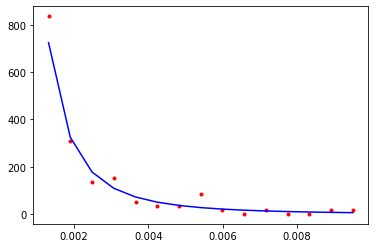

CPU times: user 1.09 ms, sys: 612 µs, total: 1.7 ms
Wall time: 591 µs
40445.94578665143


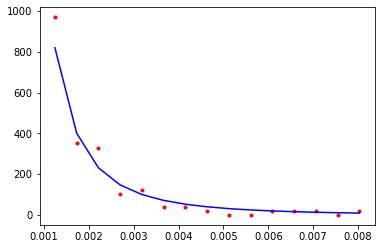

CPU times: user 1.44 ms, sys: 582 µs, total: 2.02 ms
Wall time: 704 µs
19247.379596113096


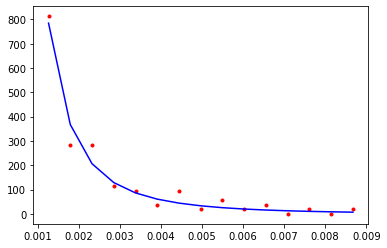

CPU times: user 1.7 ms, sys: 597 µs, total: 2.3 ms
Wall time: 770 µs
24624.313299057398


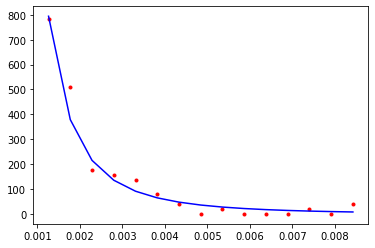

CPU times: user 1.95 ms, sys: 659 µs, total: 2.61 ms
Wall time: 879 µs
15303.686894082628


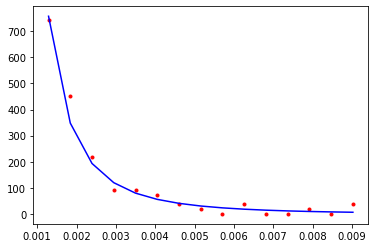

CPU times: user 2.45 ms, sys: 862 µs, total: 3.31 ms
Wall time: 1.15 ms
11553.7883880489


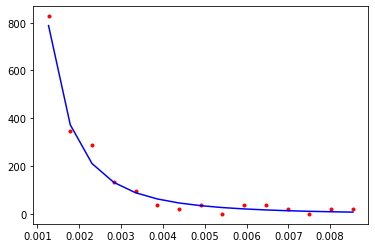

CPU times: user 2.69 ms, sys: 762 µs, total: 3.45 ms
Wall time: 1.18 ms
14102.046209457367


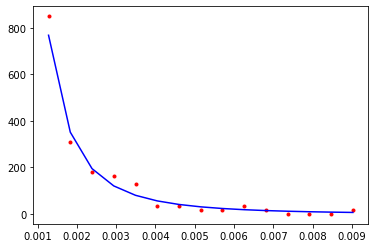

CPU times: user 3.09 ms, sys: 796 µs, total: 3.89 ms
Wall time: 1.33 ms
20359.42062487916


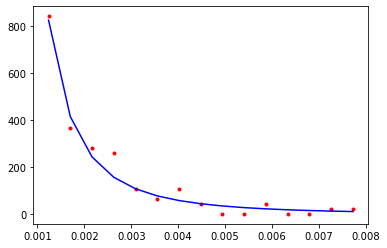

CPU times: user 3.59 ms, sys: 894 µs, total: 4.48 ms
Wall time: 1.53 ms
16838.00452749912


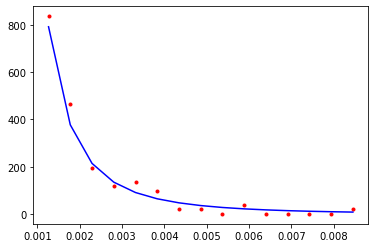

CPU times: user 3.9 ms, sys: 1.03 ms, total: 4.93 ms
Wall time: 1.69 ms
26410.455304522922


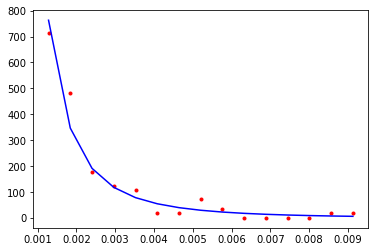

CPU times: user 4.12 ms, sys: 908 µs, total: 5.03 ms
Wall time: 1.7 ms
37247.109941578776


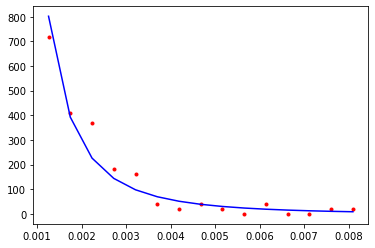

CPU times: user 4.56 ms, sys: 970 µs, total: 5.53 ms
Wall time: 1.86 ms
17385.31009315065


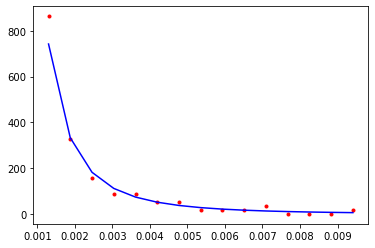

CPU times: user 4.87 ms, sys: 1.04 ms, total: 5.91 ms
Wall time: 1.99 ms
9507.590238280745


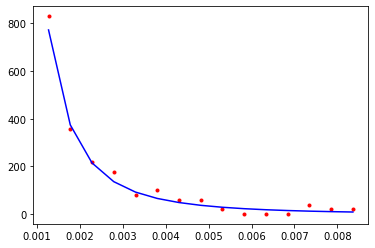

CPU times: user 5.24 ms, sys: 1.08 ms, total: 6.32 ms
Wall time: 2.13 ms
34736.81828427944


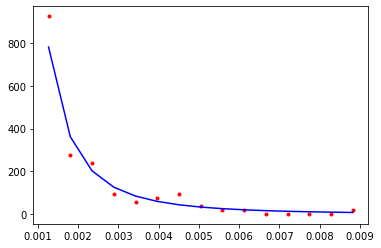

CPU times: user 6.06 ms, sys: 1.45 ms, total: 7.52 ms
Wall time: 2.53 ms
34847.049373850394


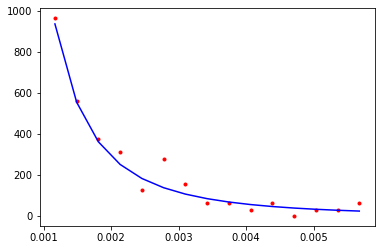

CPU times: user 6.17 ms, sys: 1.23 ms, total: 7.4 ms
Wall time: 2.49 ms
27299.62015017315


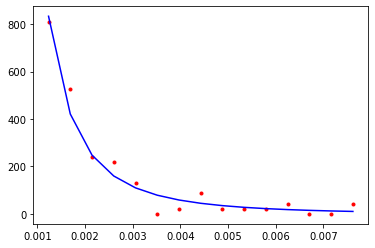

CPU times: user 6.35 ms, sys: 1.18 ms, total: 7.53 ms
Wall time: 2.54 ms
60578.237518846654


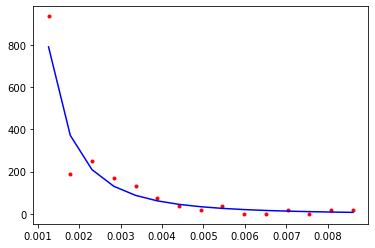

CPU times: user 6.67 ms, sys: 1.22 ms, total: 7.89 ms
Wall time: 2.65 ms
20930.38094806217


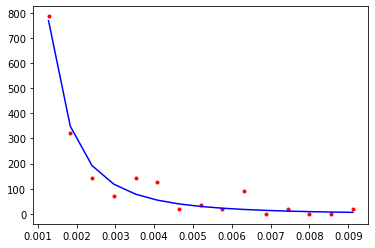

CPU times: user 7.42 ms, sys: 1.34 ms, total: 8.76 ms
Wall time: 2.94 ms
50176.033111455305


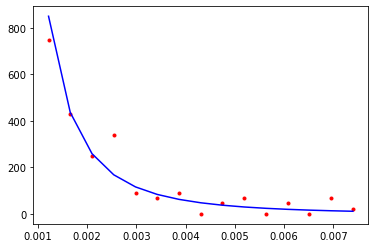

CPU times: user 7.09 ms, sys: 1.5 ms, total: 8.59 ms
Wall time: 2.94 ms
30843.224261022184


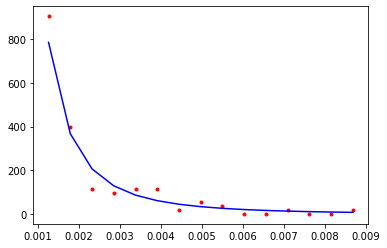

CPU times: user 7.79 ms, sys: 1.36 ms, total: 9.15 ms
Wall time: 3.08 ms
16704.369064180755


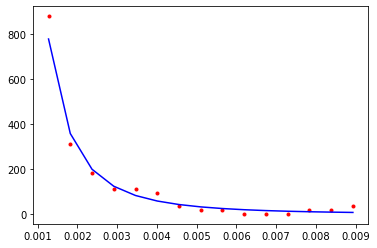

CPU times: user 1.39 ms, sys: 1.45 ms, total: 2.84 ms
Wall time: 940 µs
17689.203311118836


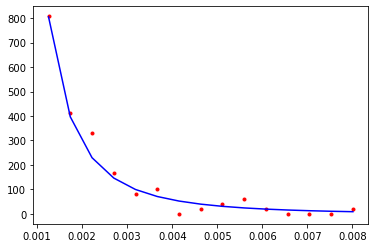

CPU times: user 819 µs, sys: 489 µs, total: 1.31 ms
Wall time: 452 µs
23077.547688647803


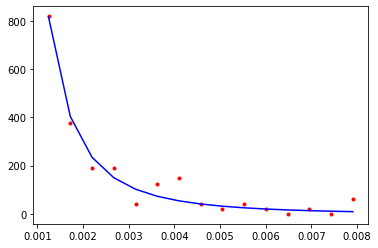

CPU times: user 1.87 ms, sys: 767 µs, total: 2.64 ms
Wall time: 890 µs
11369.260138875485


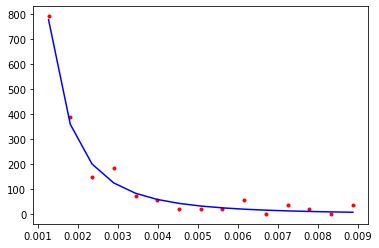

CPU times: user 1.65 ms, sys: 615 µs, total: 2.27 ms
Wall time: 781 µs
12851.304474715504


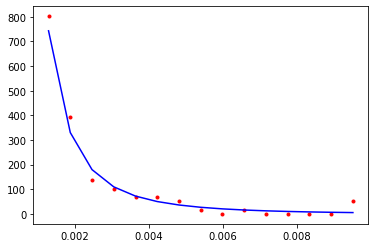

CPU times: user 2.01 ms, sys: 695 µs, total: 2.7 ms
Wall time: 935 µs
46994.53069640709


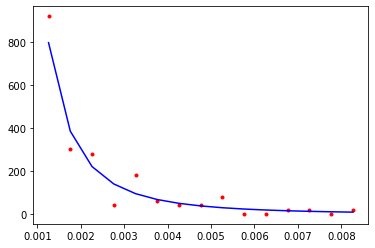

CPU times: user 2.42 ms, sys: 868 µs, total: 3.29 ms
Wall time: 1.15 ms
28625.489320515124


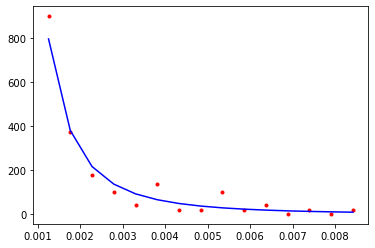

CPU times: user 2.66 ms, sys: 732 µs, total: 3.4 ms
Wall time: 1.15 ms
24964.46144787415


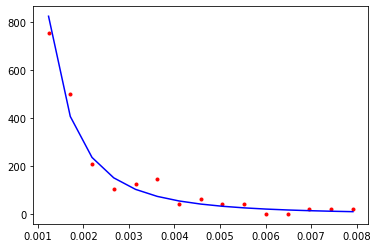

CPU times: user 3.25 ms, sys: 907 µs, total: 4.15 ms
Wall time: 1.42 ms
48884.16666981501


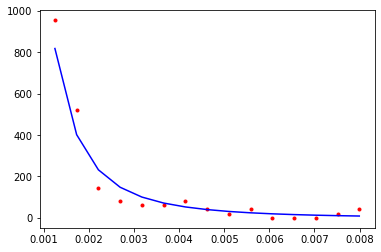

CPU times: user 3.35 ms, sys: 887 µs, total: 4.24 ms
Wall time: 1.45 ms
8327.900780094564


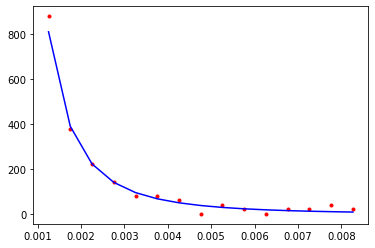

CPU times: user 3.62 ms, sys: 1.01 ms, total: 4.63 ms
Wall time: 1.6 ms
60592.98136024779


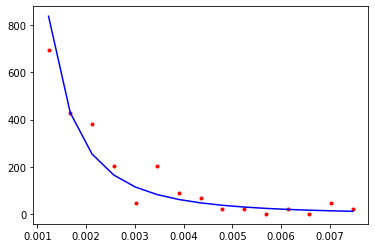

CPU times: user 3.8 ms, sys: 1.06 ms, total: 4.86 ms
Wall time: 1.71 ms
31457.52587313075


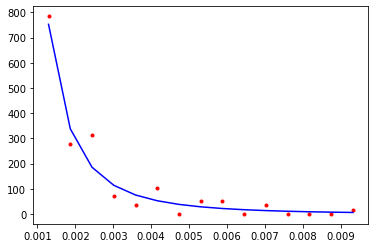

CPU times: user 4.53 ms, sys: 975 µs, total: 5.5 ms
Wall time: 1.86 ms
49062.295448308


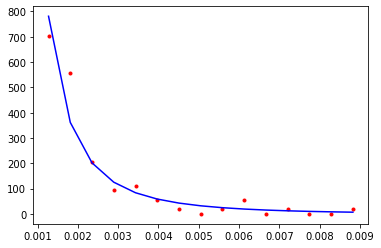

CPU times: user 4.68 ms, sys: 1.03 ms, total: 5.71 ms
Wall time: 2.03 ms
20408.840355756645


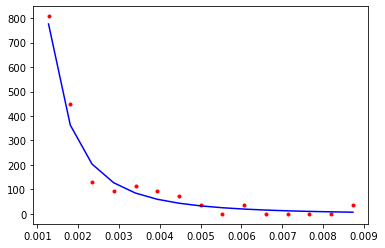

CPU times: user 5.26 ms, sys: 1.11 ms, total: 6.37 ms
Wall time: 2.15 ms
47251.48954163494


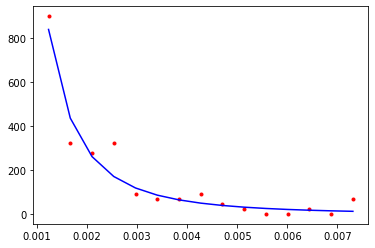

CPU times: user 5.44 ms, sys: 997 µs, total: 6.44 ms
Wall time: 2.18 ms
34807.55018576754


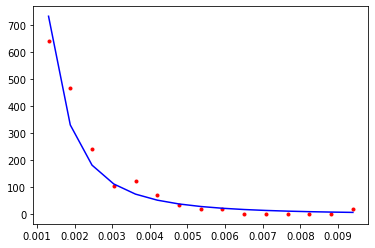

CPU times: user 6.08 ms, sys: 1.29 ms, total: 7.36 ms
Wall time: 2.51 ms
52685.03252366801


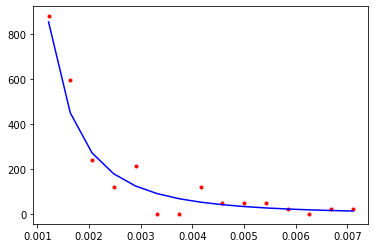

CPU times: user 6.49 ms, sys: 1.32 ms, total: 7.81 ms
Wall time: 2.65 ms
20795.54497755771


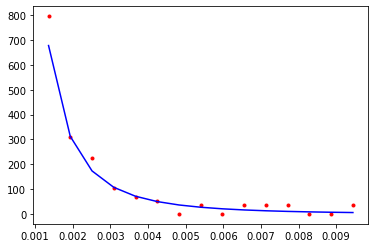

CPU times: user 7.03 ms, sys: 1.38 ms, total: 8.4 ms
Wall time: 2.83 ms
13411.848649995864


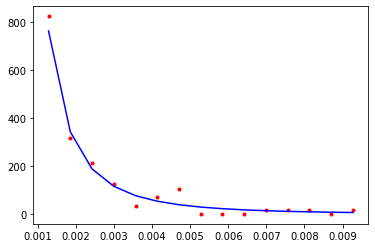

CPU times: user 7.34 ms, sys: 1.36 ms, total: 8.7 ms
Wall time: 2.93 ms
17162.629649116843


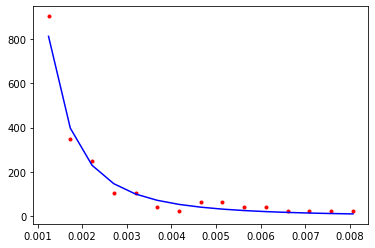

CPU times: user 7.5 ms, sys: 1.39 ms, total: 8.89 ms
Wall time: 2.99 ms
20472.339484164942


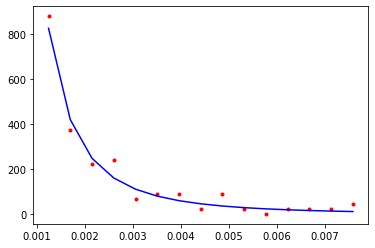

CPU times: user 7.82 ms, sys: 1.35 ms, total: 9.17 ms
Wall time: 3.08 ms
38570.63648634347


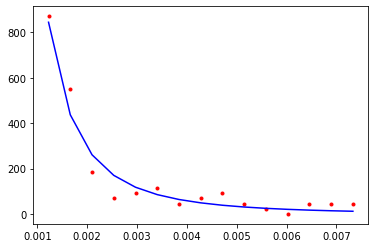

CPU times: user 1.06 ms, sys: 1.02 ms, total: 2.08 ms
Wall time: 667 µs
17977.96826040432


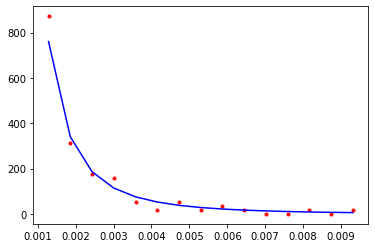

CPU times: user 966 µs, sys: 503 µs, total: 1.47 ms
Wall time: 501 µs
25002.991029054734


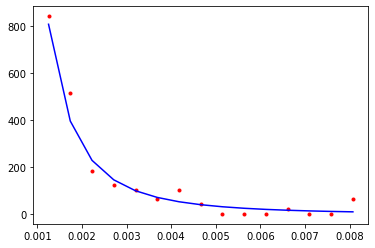

CPU times: user 1.41 ms, sys: 644 µs, total: 2.06 ms
Wall time: 726 µs
40640.1818352247


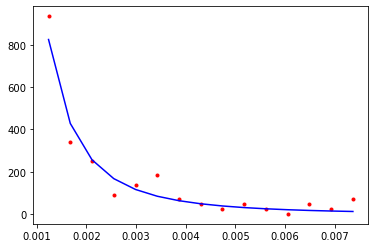

CPU times: user 1.57 ms, sys: 556 µs, total: 2.13 ms
Wall time: 738 µs
45668.9174191822


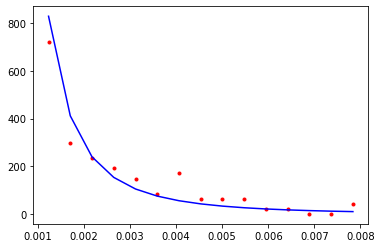

CPU times: user 1.81 ms, sys: 543 µs, total: 2.35 ms
Wall time: 786 µs
51689.73520052744


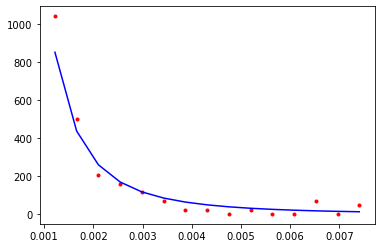

CPU times: user 2.5 ms, sys: 802 µs, total: 3.3 ms
Wall time: 1.14 ms
20859.78204940692


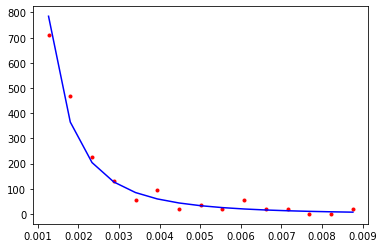

CPU times: user 2.6 ms, sys: 830 µs, total: 3.43 ms
Wall time: 1.18 ms
18794.696946701966


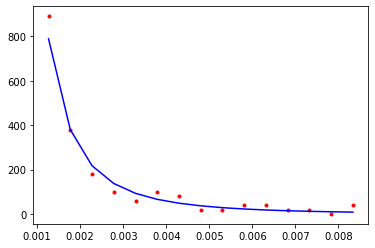

CPU times: user 2.69 ms, sys: 993 µs, total: 3.68 ms
Wall time: 1.32 ms
46156.47616152765


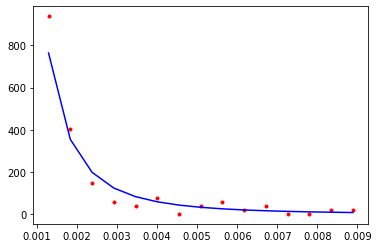

CPU times: user 3.32 ms, sys: 895 µs, total: 4.22 ms
Wall time: 1.48 ms
18163.277832620657


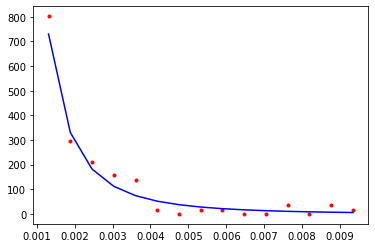

CPU times: user 3.81 ms, sys: 892 µs, total: 4.7 ms
Wall time: 1.6 ms
30730.584109142954


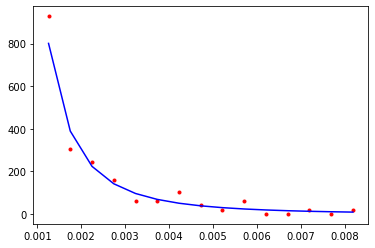

CPU times: user 4.21 ms, sys: 998 µs, total: 5.21 ms
Wall time: 1.77 ms
46597.53090538236


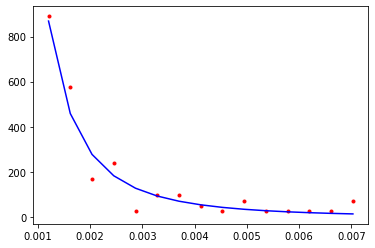

CPU times: user 4.73 ms, sys: 1.05 ms, total: 5.78 ms
Wall time: 1.96 ms
47522.15897030311


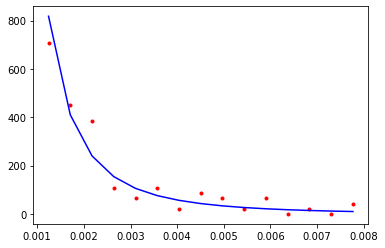

CPU times: user 4.99 ms, sys: 1.17 ms, total: 6.16 ms
Wall time: 2.11 ms
42397.49130118764


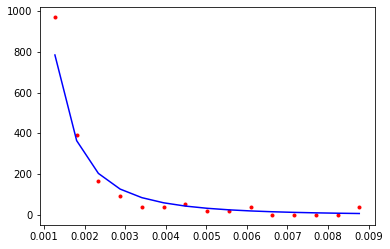

CPU times: user 5.38 ms, sys: 1.15 ms, total: 6.53 ms
Wall time: 2.22 ms
24538.950179789135


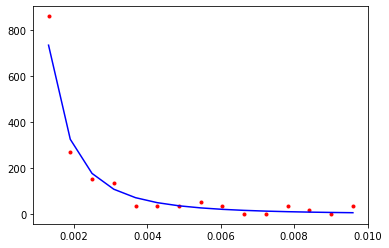

CPU times: user 5.58 ms, sys: 1.16 ms, total: 6.74 ms
Wall time: 2.28 ms
62549.084518782234


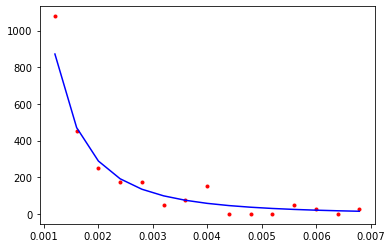

CPU times: user 5.97 ms, sys: 1.21 ms, total: 7.18 ms
Wall time: 2.43 ms
20451.45523266733


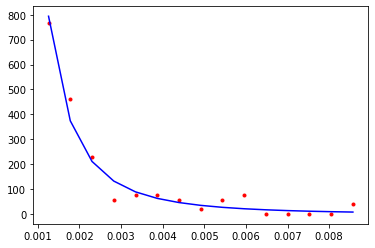

CPU times: user 6.29 ms, sys: 1.43 ms, total: 7.72 ms
Wall time: 2.63 ms
18741.044800673


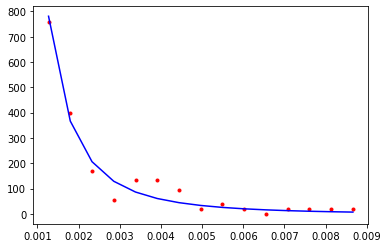

CPU times: user 6.75 ms, sys: 1.22 ms, total: 7.97 ms
Wall time: 2.68 ms
34152.567402624416


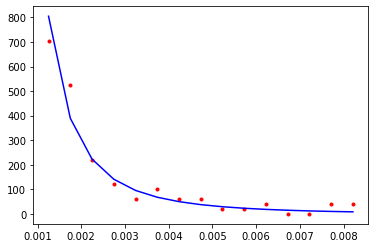

CPU times: user 7.17 ms, sys: 1.3 ms, total: 8.47 ms
Wall time: 2.85 ms
39485.46938245386


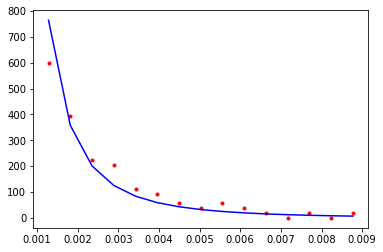

CPU times: user 7.72 ms, sys: 1.43 ms, total: 9.15 ms
Wall time: 3.08 ms
22600.209149836926


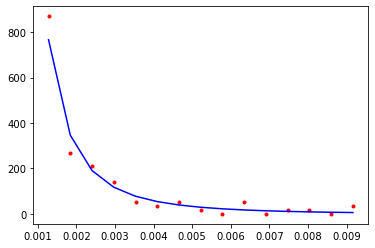

CPU times: user 7.87 ms, sys: 1.37 ms, total: 9.24 ms
Wall time: 3.1 ms
97151.8192635665


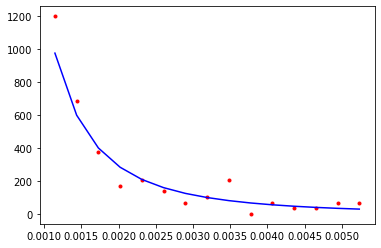

CPU times: user 1.26 ms, sys: 1.21 ms, total: 2.47 ms
Wall time: 816 µs
25463.314686610942


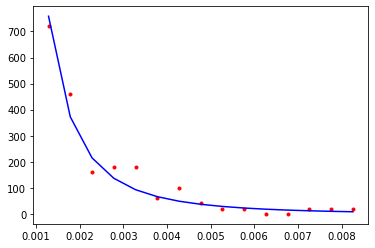

CPU times: user 889 µs, sys: 497 µs, total: 1.39 ms
Wall time: 472 µs
30394.092952792587


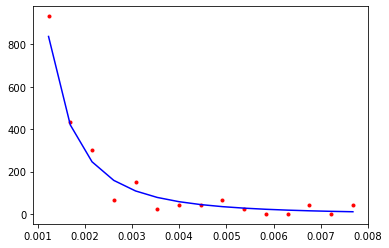

CPU times: user 1.32 ms, sys: 649 µs, total: 1.97 ms
Wall time: 672 µs
22749.931434399572


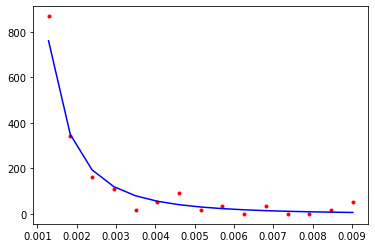

CPU times: user 1.77 ms, sys: 791 µs, total: 2.56 ms
Wall time: 912 µs
23251.604896991048


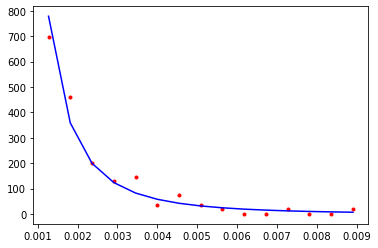

CPU times: user 2.01 ms, sys: 624 µs, total: 2.64 ms
Wall time: 897 µs
18992.159350394948


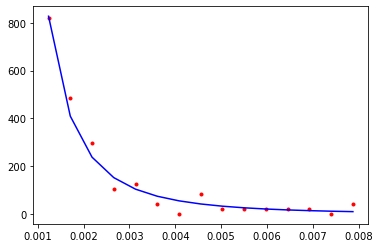

CPU times: user 2.3 ms, sys: 726 µs, total: 3.03 ms
Wall time: 1.04 ms
67926.0120222143


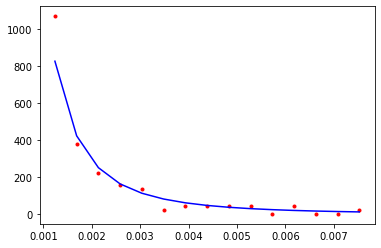

CPU times: user 2.69 ms, sys: 789 µs, total: 3.48 ms
Wall time: 1.19 ms
34177.471645705904


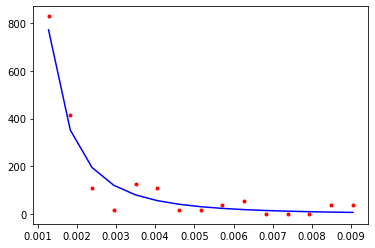

CPU times: user 3.06 ms, sys: 1.16 ms, total: 4.22 ms
Wall time: 1.51 ms
21724.404259587387


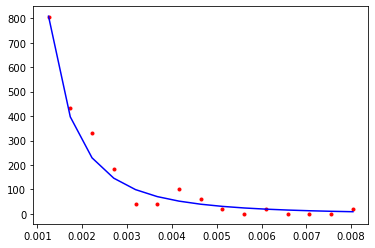

CPU times: user 3.55 ms, sys: 921 µs, total: 4.47 ms
Wall time: 1.52 ms
14273.217555570105


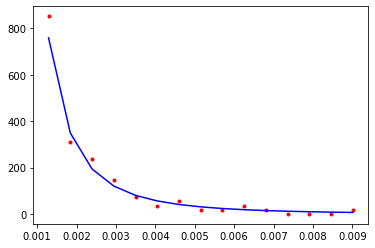

CPU times: user 3.74 ms, sys: 1.13 ms, total: 4.88 ms
Wall time: 1.72 ms
39761.76425602747


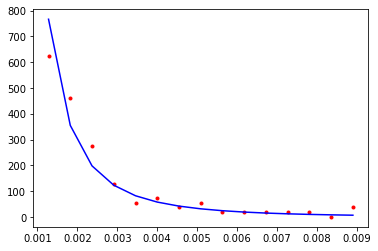

CPU times: user 3.96 ms, sys: 1.36 ms, total: 5.32 ms
Wall time: 1.88 ms
40749.925117775114


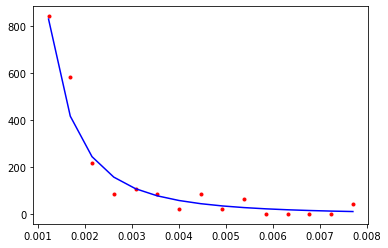

CPU times: user 4.55 ms, sys: 939 µs, total: 5.49 ms
Wall time: 1.85 ms
17290.70066126979


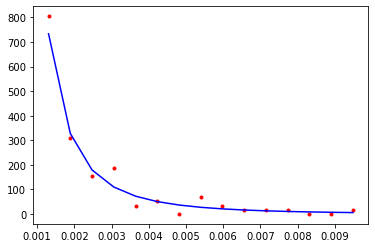

CPU times: user 4.87 ms, sys: 1.08 ms, total: 5.95 ms
Wall time: 2.01 ms
16115.68748798017


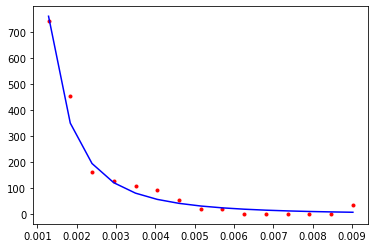

CPU times: user 5.14 ms, sys: 1.11 ms, total: 6.25 ms
Wall time: 2.12 ms
27546.788422644844


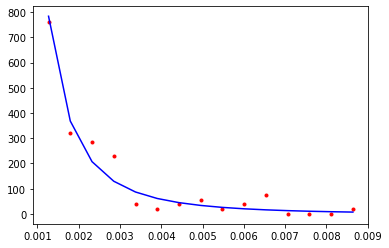

CPU times: user 5.78 ms, sys: 1.22 ms, total: 7 ms
Wall time: 2.36 ms
97967.49674667396


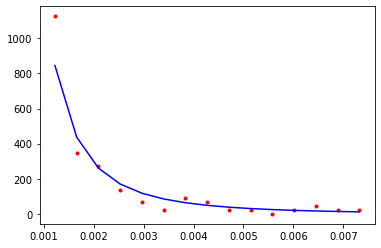

CPU times: user 5.87 ms, sys: 1.21 ms, total: 7.08 ms
Wall time: 2.4 ms
21284.015546977556


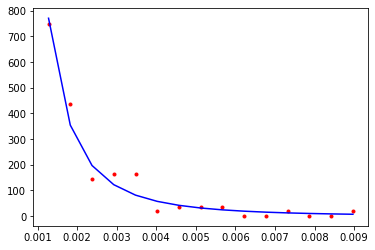

CPU times: user 6.38 ms, sys: 1.24 ms, total: 7.62 ms
Wall time: 2.56 ms
32994.287184224224


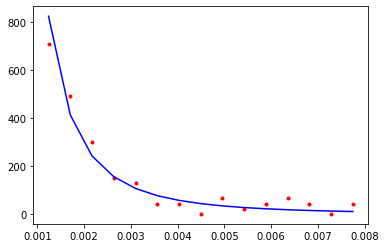

CPU times: user 6.78 ms, sys: 1.33 ms, total: 8.11 ms
Wall time: 2.78 ms
12801.59541348397


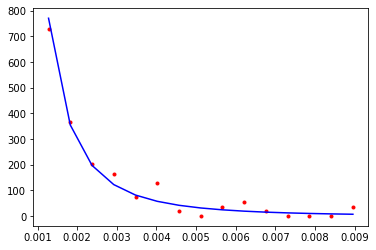

CPU times: user 7.14 ms, sys: 1.29 ms, total: 8.43 ms
Wall time: 2.83 ms
18601.873638762507


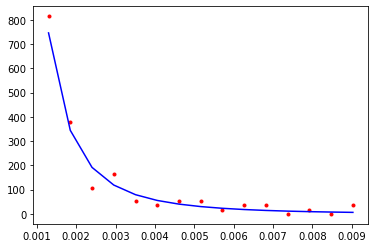

CPU times: user 7.38 ms, sys: 1.37 ms, total: 8.75 ms
Wall time: 2.94 ms
31020.453090513387


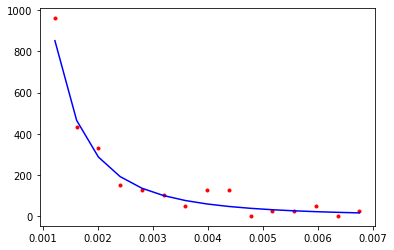

CPU times: user 7.96 ms, sys: 1.52 ms, total: 9.48 ms
Wall time: 3.21 ms
15571.811094230114


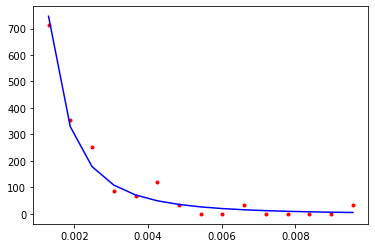

CPU times: user 1.09 ms, sys: 1.02 ms, total: 2.1 ms
Wall time: 679 µs
43532.45059544187


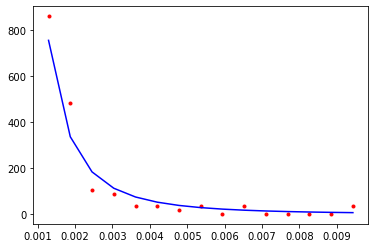

CPU times: user 1.06 ms, sys: 588 µs, total: 1.65 ms
Wall time: 591 µs
26337.764244663613


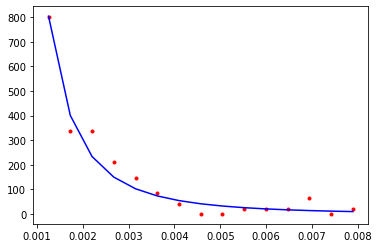

CPU times: user 1.27 ms, sys: 586 µs, total: 1.86 ms
Wall time: 628 µs
13656.874542605834


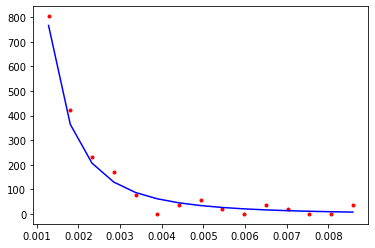

CPU times: user 1.62 ms, sys: 566 µs, total: 2.19 ms
Wall time: 740 µs
87714.70223571737


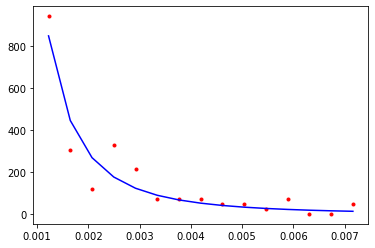

CPU times: user 1.86 ms, sys: 648 µs, total: 2.51 ms
Wall time: 876 µs
9102.224750593667


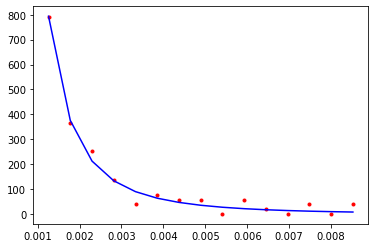

CPU times: user 2.5 ms, sys: 819 µs, total: 3.32 ms
Wall time: 1.14 ms
59785.60607826947


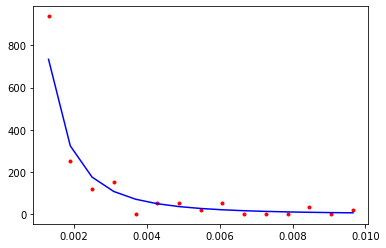

CPU times: user 2.79 ms, sys: 930 µs, total: 3.72 ms
Wall time: 1.29 ms
36764.74602432951


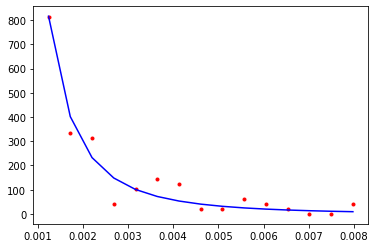

CPU times: user 3.04 ms, sys: 775 µs, total: 3.82 ms
Wall time: 1.29 ms
20420.973715190376


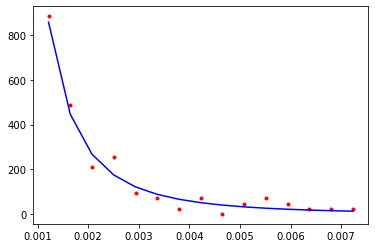

CPU times: user 3.39 ms, sys: 836 µs, total: 4.23 ms
Wall time: 1.43 ms
68170.27173399097


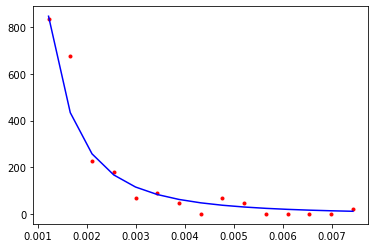

CPU times: user 3.73 ms, sys: 863 µs, total: 4.6 ms
Wall time: 1.55 ms
23409.061083357


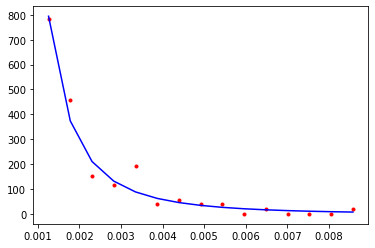

CPU times: user 4.07 ms, sys: 950 µs, total: 5.02 ms
Wall time: 1.71 ms
19295.172038035962


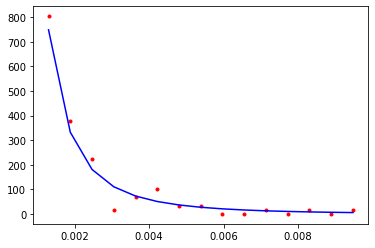

CPU times: user 4.45 ms, sys: 919 µs, total: 5.37 ms
Wall time: 1.81 ms
12145.853593087895


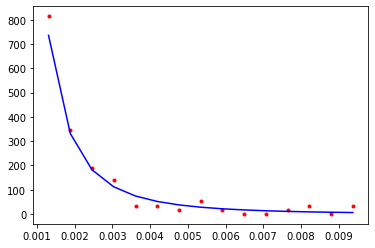

CPU times: user 4.83 ms, sys: 1.11 ms, total: 5.94 ms
Wall time: 2.03 ms
28467.417360306903


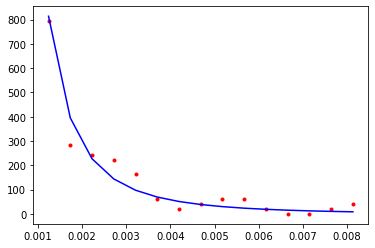

CPU times: user 5.16 ms, sys: 1.07 ms, total: 6.23 ms
Wall time: 2.11 ms
42709.2685671887


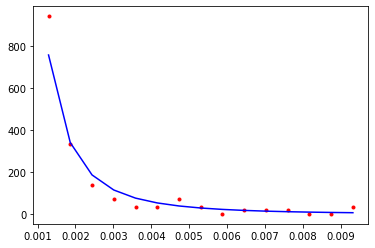

CPU times: user 5.89 ms, sys: 1.28 ms, total: 7.18 ms
Wall time: 2.44 ms
21637.325494672474


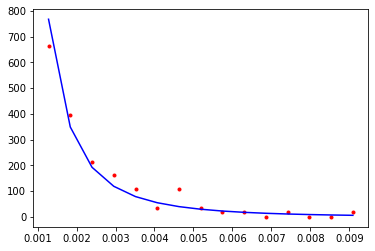

CPU times: user 5.99 ms, sys: 1.2 ms, total: 7.18 ms
Wall time: 2.42 ms
40646.114254697815


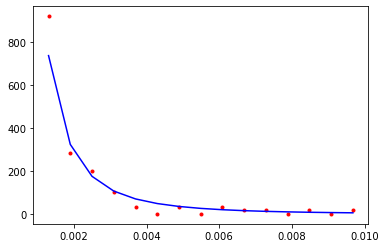

CPU times: user 6.59 ms, sys: 1.35 ms, total: 7.93 ms
Wall time: 2.69 ms
35567.13744981595


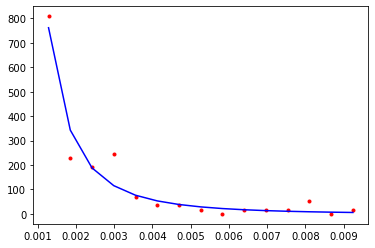

CPU times: user 7 ms, sys: 1.38 ms, total: 8.38 ms
Wall time: 2.82 ms
61179.20749515683


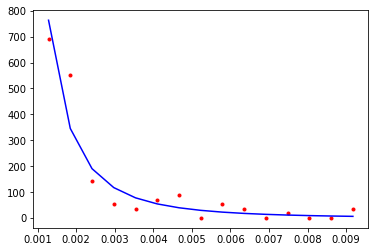

CPU times: user 7.03 ms, sys: 1.3 ms, total: 8.32 ms
Wall time: 2.84 ms
10686.305083193996


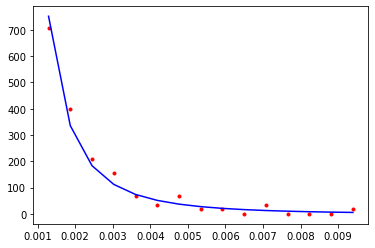

CPU times: user 7.37 ms, sys: 1.29 ms, total: 8.66 ms
Wall time: 2.91 ms
23072.7872530937


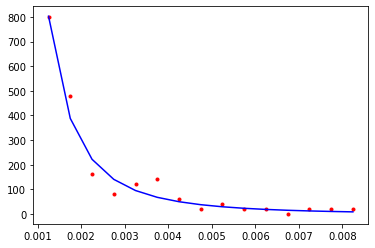

CPU times: user 8.15 ms, sys: 1.46 ms, total: 9.61 ms
Wall time: 3.21 ms
107909.12044108055


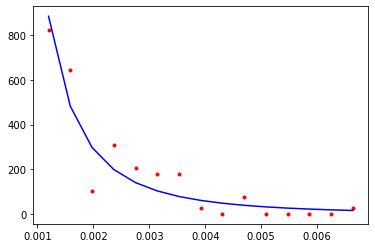

CPU times: user 1.23 ms, sys: 1.14 ms, total: 2.36 ms
Wall time: 780 µs
23803.284772870313


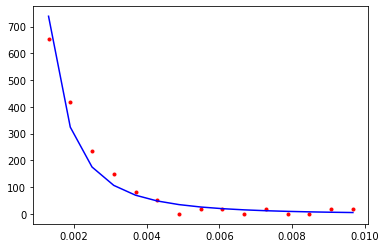

CPU times: user 881 µs, sys: 450 µs, total: 1.33 ms
Wall time: 453 µs
43034.94525245119


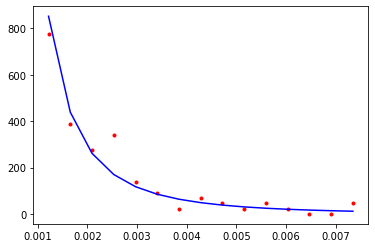

CPU times: user 1.48 ms, sys: 653 µs, total: 2.14 ms
Wall time: 744 µs
9873.764013565456


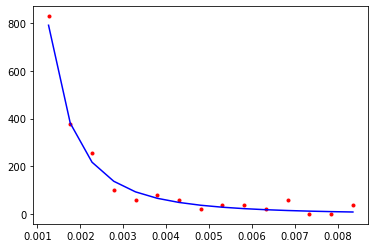

CPU times: user 1.82 ms, sys: 709 µs, total: 2.53 ms
Wall time: 891 µs
42561.803663090206


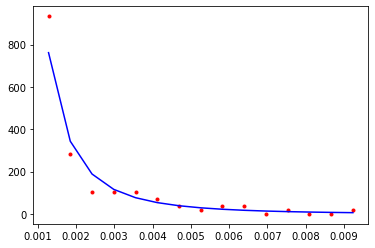

CPU times: user 1.95 ms, sys: 617 µs, total: 2.57 ms
Wall time: 885 µs
18903.649187966414


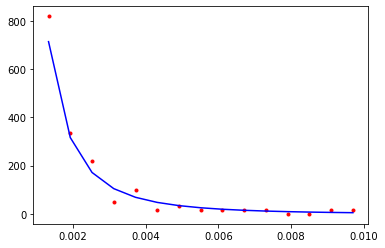

CPU times: user 2.42 ms, sys: 797 µs, total: 3.22 ms
Wall time: 1.09 ms
27530.038305870472


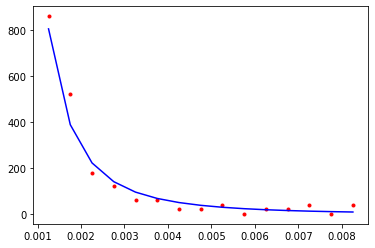

CPU times: user 2.67 ms, sys: 770 µs, total: 3.44 ms
Wall time: 1.17 ms
22899.761785875475


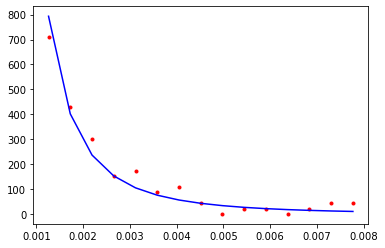

CPU times: user 2.83 ms, sys: 720 µs, total: 3.55 ms
Wall time: 1.2 ms
36136.25008534796


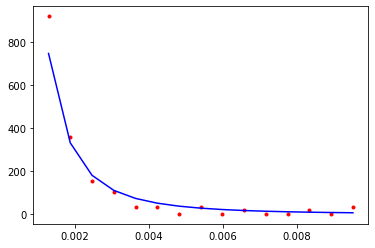

CPU times: user 3.35 ms, sys: 836 µs, total: 4.18 ms
Wall time: 1.43 ms
28480.384312196755


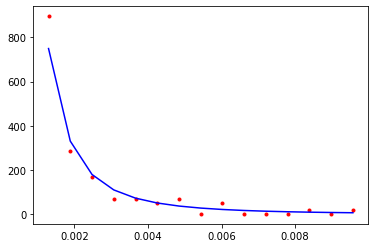

CPU times: user 3.9 ms, sys: 938 µs, total: 4.84 ms
Wall time: 1.64 ms
36335.40068290001


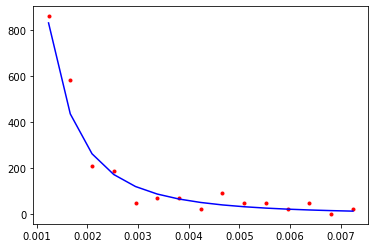

CPU times: user 4.35 ms, sys: 1.06 ms, total: 5.41 ms
Wall time: 1.85 ms
16366.392434851296


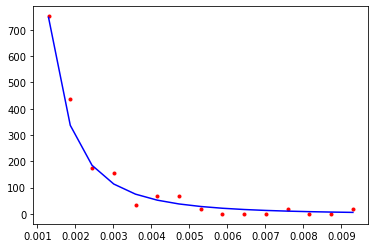

CPU times: user 4.53 ms, sys: 1 ms, total: 5.54 ms
Wall time: 1.87 ms
16862.435383479948


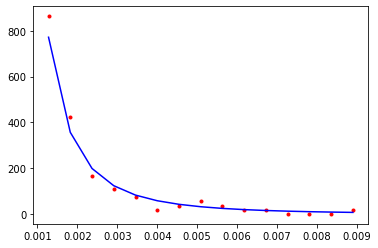

CPU times: user 4.67 ms, sys: 1.12 ms, total: 5.79 ms
Wall time: 2 ms
66802.12663995146


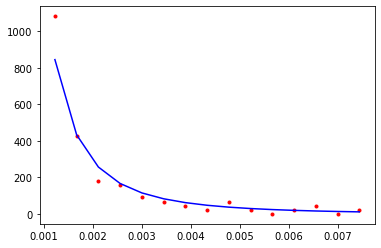

CPU times: user 5.42 ms, sys: 1.13 ms, total: 6.55 ms
Wall time: 2.21 ms
81587.78711776456


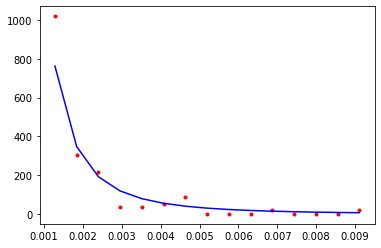

CPU times: user 5.53 ms, sys: 1.16 ms, total: 6.69 ms
Wall time: 2.27 ms
19043.426958098276


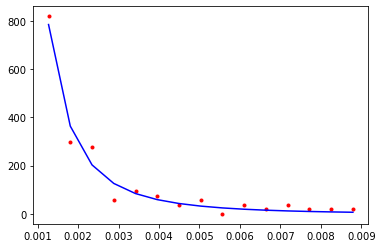

CPU times: user 6.12 ms, sys: 1.2 ms, total: 7.32 ms
Wall time: 2.51 ms
33672.08172796835


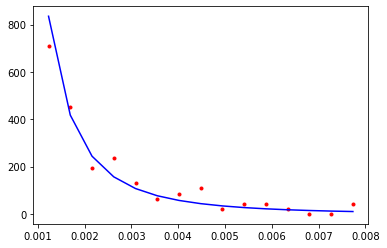

CPU times: user 6.49 ms, sys: 1.33 ms, total: 7.82 ms
Wall time: 2.66 ms
37235.18949643917


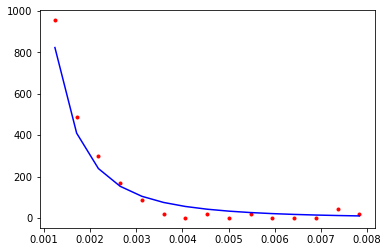

CPU times: user 6.62 ms, sys: 1.31 ms, total: 7.92 ms
Wall time: 2.7 ms
104821.51408523903


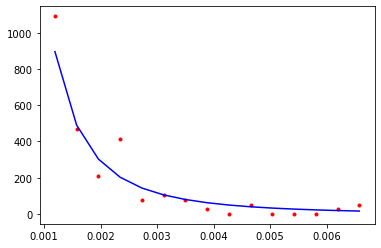

CPU times: user 7.36 ms, sys: 1.42 ms, total: 8.79 ms
Wall time: 2.96 ms
50424.91734891185


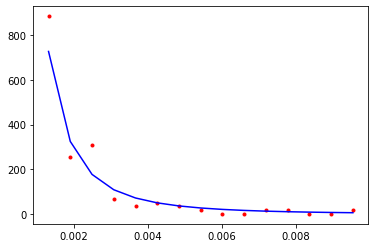

CPU times: user 7.43 ms, sys: 1.31 ms, total: 8.74 ms
Wall time: 2.95 ms
48680.12366953739


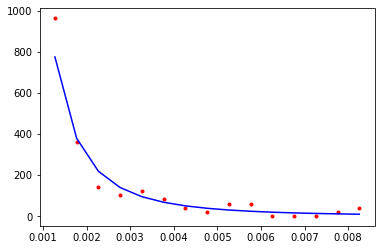

CPU times: user 7.83 ms, sys: 1.32 ms, total: 9.15 ms
Wall time: 3.06 ms
15199.274363713153


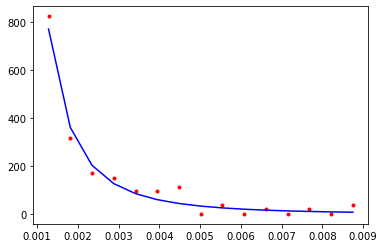

CPU times: user 1.49 ms, sys: 1.35 ms, total: 2.84 ms
Wall time: 953 µs
19789.92092124069


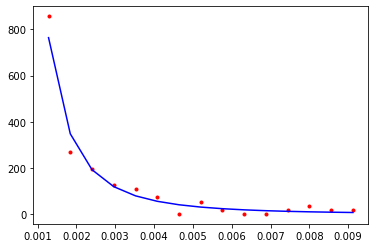

CPU times: user 856 µs, sys: 453 µs, total: 1.31 ms
Wall time: 454 µs
21020.12757599287


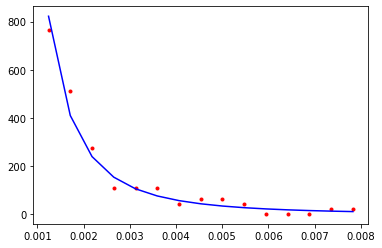

CPU times: user 1.32 ms, sys: 552 µs, total: 1.88 ms
Wall time: 629 µs
8410.937530210978


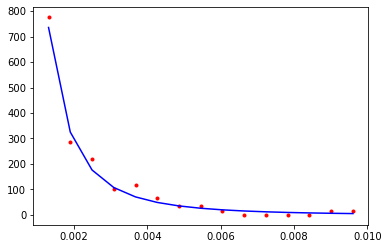

CPU times: user 1.71 ms, sys: 767 µs, total: 2.48 ms
Wall time: 871 µs
211505.81933810803


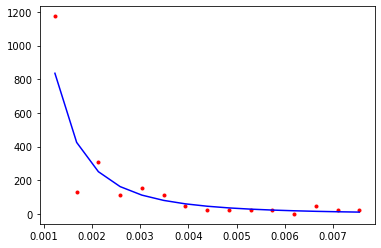

CPU times: user 1.98 ms, sys: 578 µs, total: 2.55 ms
Wall time: 860 µs
43083.19163119866


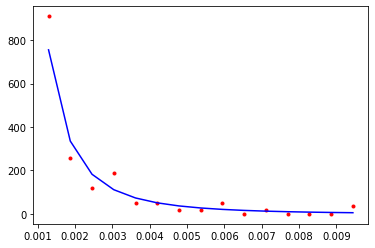

CPU times: user 2.27 ms, sys: 685 µs, total: 2.95 ms
Wall time: 1.01 ms
44145.89599727163


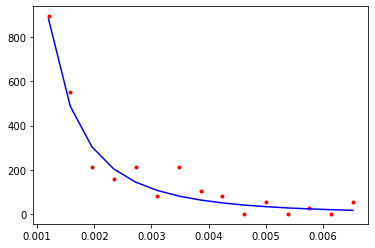

CPU times: user 2.66 ms, sys: 895 µs, total: 3.55 ms
Wall time: 1.21 ms
15823.927663106468


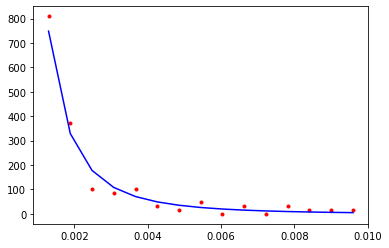

CPU times: user 3.24 ms, sys: 906 µs, total: 4.15 ms
Wall time: 1.43 ms
61465.20740350286


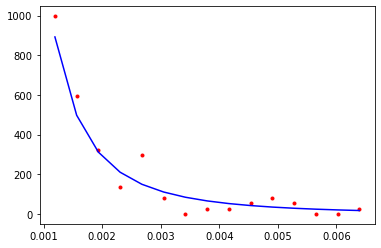

CPU times: user 3.41 ms, sys: 932 µs, total: 4.34 ms
Wall time: 1.49 ms
12135.982100560992


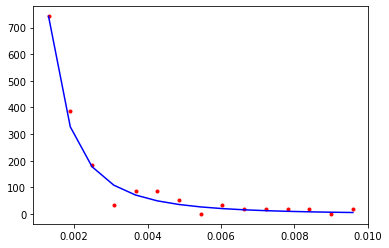

CPU times: user 3.95 ms, sys: 1.01 ms, total: 4.96 ms
Wall time: 1.69 ms
68724.48509612188


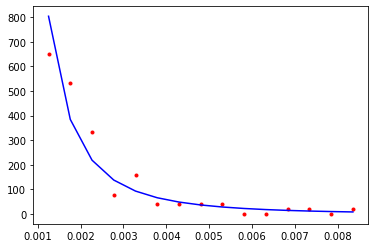

CPU times: user 4.31 ms, sys: 978 µs, total: 5.29 ms
Wall time: 1.8 ms
10861.521501072692


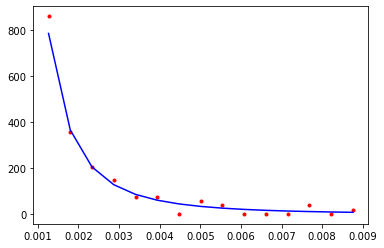

CPU times: user 4.29 ms, sys: 1.09 ms, total: 5.38 ms
Wall time: 1.87 ms
19676.410355629767


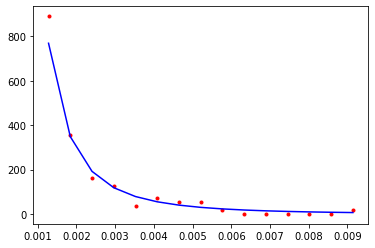

CPU times: user 4.85 ms, sys: 1.04 ms, total: 5.9 ms
Wall time: 2 ms
39086.511810625285


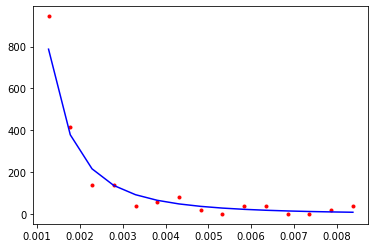

CPU times: user 5.26 ms, sys: 1.18 ms, total: 6.44 ms
Wall time: 2.21 ms
45651.110965778666


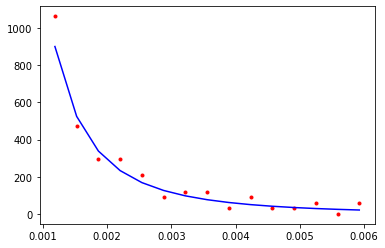

CPU times: user 5.89 ms, sys: 1.22 ms, total: 7.1 ms
Wall time: 2.39 ms
14568.190623414217


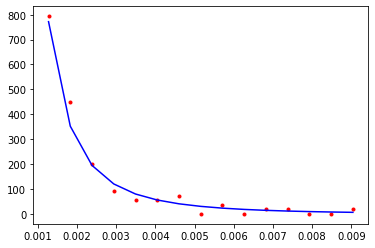

CPU times: user 5.99 ms, sys: 1.18 ms, total: 7.17 ms
Wall time: 2.42 ms
70536.61162215409


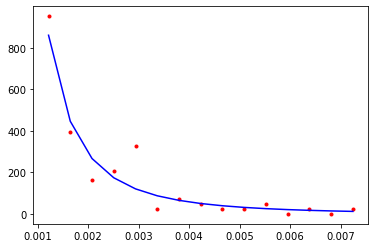

CPU times: user 6.36 ms, sys: 1.25 ms, total: 7.6 ms
Wall time: 2.55 ms
4561.419376545613


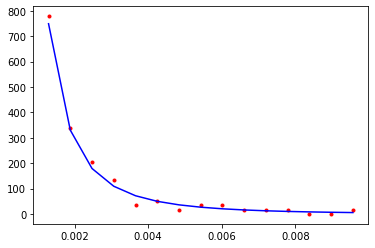

CPU times: user 6.76 ms, sys: 1.25 ms, total: 8.01 ms
Wall time: 2.69 ms
19156.23071235676


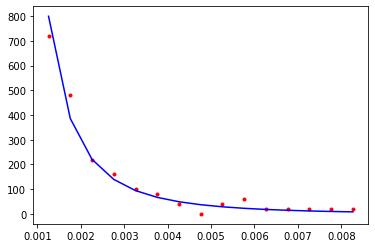

CPU times: user 7.16 ms, sys: 1.49 ms, total: 8.65 ms
Wall time: 2.93 ms
63326.144552722326


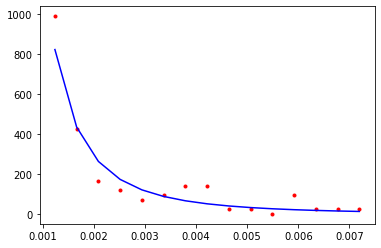

CPU times: user 7.75 ms, sys: 1.47 ms, total: 9.22 ms
Wall time: 3.11 ms
20470.043866552674


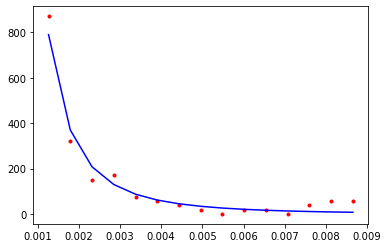

CPU times: user 8.1 ms, sys: 1.48 ms, total: 9.58 ms
Wall time: 3.22 ms
19709.387523910937


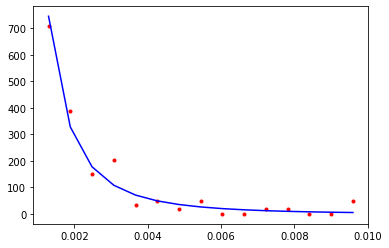

CPU times: user 1.22 ms, sys: 1.1 ms, total: 2.32 ms
Wall time: 752 µs
24910.11681636295


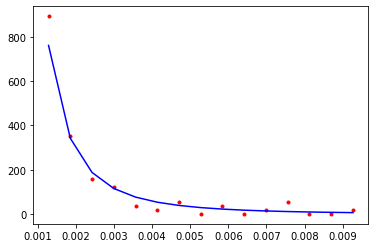

CPU times: user 919 µs, sys: 463 µs, total: 1.38 ms
Wall time: 471 µs
33016.28757142577


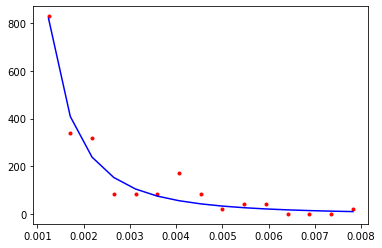

CPU times: user 1.3 ms, sys: 508 µs, total: 1.8 ms
Wall time: 604 µs
6664.46798606774


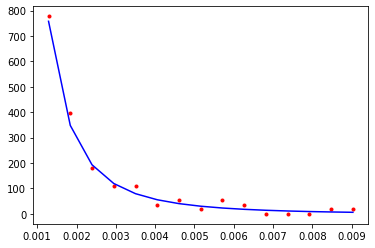

CPU times: user 1.65 ms, sys: 549 µs, total: 2.19 ms
Wall time: 738 µs
14367.43768145606


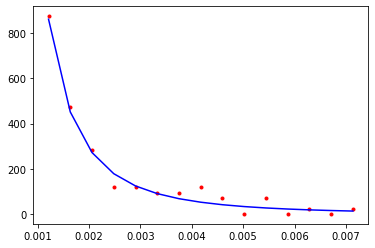

CPU times: user 2.21 ms, sys: 774 µs, total: 2.98 ms
Wall time: 1.03 ms
28509.098673160173


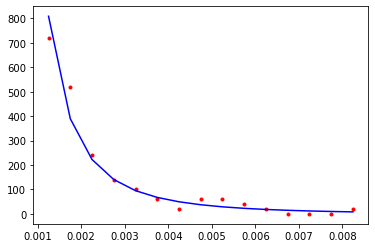

CPU times: user 2.3 ms, sys: 726 µs, total: 3.03 ms
Wall time: 1.03 ms
113398.72288550269


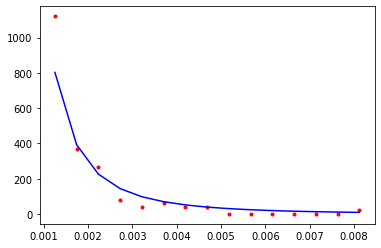

CPU times: user 2.69 ms, sys: 816 µs, total: 3.51 ms
Wall time: 1.2 ms
10712.907398276206


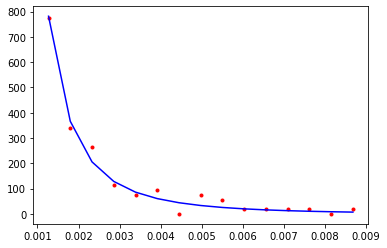

CPU times: user 2.99 ms, sys: 767 µs, total: 3.75 ms
Wall time: 1.28 ms
17247.15921470092


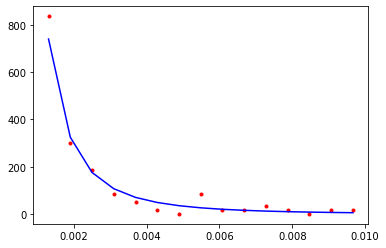

CPU times: user 3.38 ms, sys: 920 µs, total: 4.3 ms
Wall time: 1.46 ms
23831.17078878635


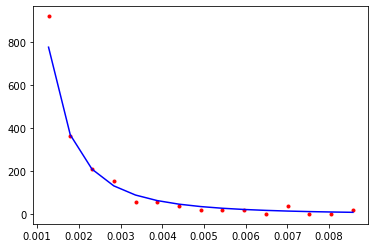

CPU times: user 3.88 ms, sys: 983 µs, total: 4.86 ms
Wall time: 1.67 ms
59498.70520638184


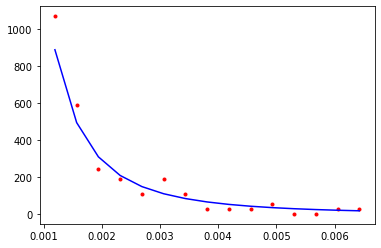

CPU times: user 4.23 ms, sys: 1.05 ms, total: 5.28 ms
Wall time: 1.82 ms
10733.559393077501


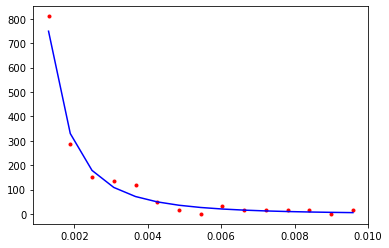

CPU times: user 4.38 ms, sys: 1.07 ms, total: 5.45 ms
Wall time: 1.86 ms
16684.211876150763


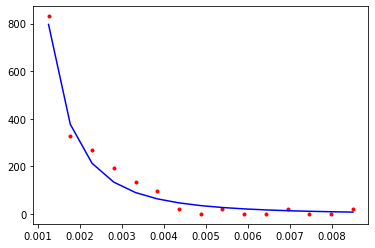

CPU times: user 4.77 ms, sys: 1.06 ms, total: 5.83 ms
Wall time: 1.99 ms
49679.48265696671


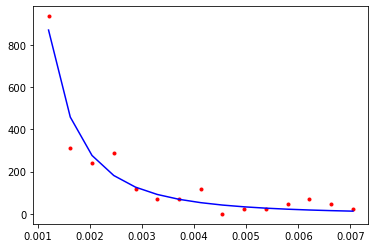

CPU times: user 5.26 ms, sys: 1.2 ms, total: 6.46 ms
Wall time: 2.21 ms
7465.450620416607


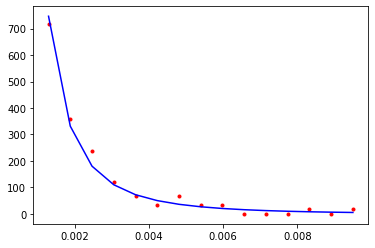

CPU times: user 5.48 ms, sys: 1.22 ms, total: 6.7 ms
Wall time: 2.29 ms
16079.481324431643


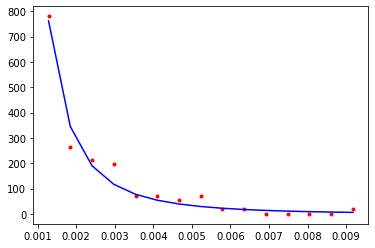

CPU times: user 5.9 ms, sys: 1.24 ms, total: 7.14 ms
Wall time: 2.42 ms
36982.25580786278


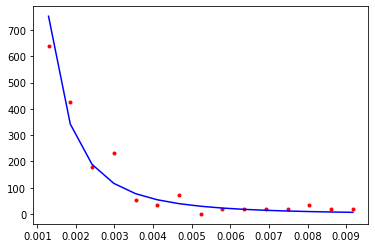

CPU times: user 6.3 ms, sys: 1.3 ms, total: 7.6 ms
Wall time: 2.58 ms
43363.178562401816


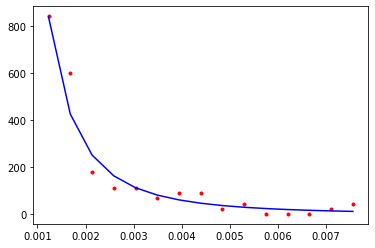

CPU times: user 6.94 ms, sys: 1.4 ms, total: 8.34 ms
Wall time: 2.83 ms
28913.220311428304


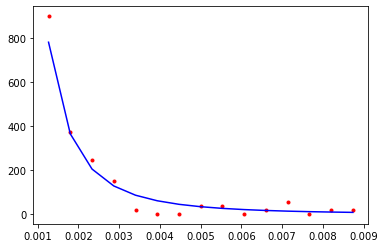

CPU times: user 7.31 ms, sys: 1.47 ms, total: 8.78 ms
Wall time: 2.98 ms
7826.091625433235


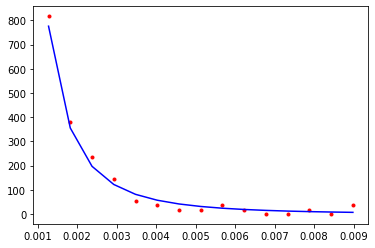

CPU times: user 7.43 ms, sys: 1.31 ms, total: 8.74 ms
Wall time: 2.94 ms
13053.417108772583


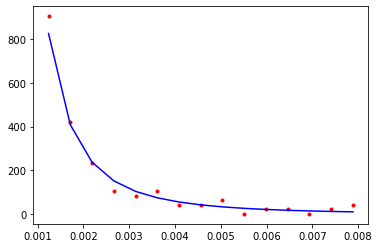

CPU times: user 7.75 ms, sys: 1.36 ms, total: 9.11 ms
Wall time: 3.1 ms
35192.44455485568


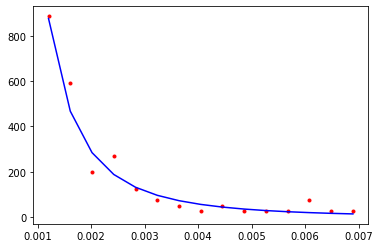

CPU times: user 1.02 ms, sys: 1.03 ms, total: 2.05 ms
Wall time: 668 µs
38532.828296567


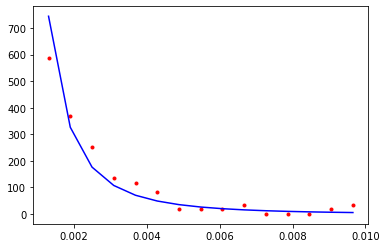

CPU times: user 1.14 ms, sys: 667 µs, total: 1.81 ms
Wall time: 637 µs
59587.8776660669


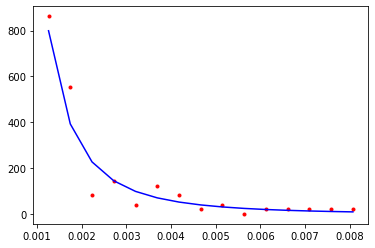

CPU times: user 1.27 ms, sys: 583 µs, total: 1.85 ms
Wall time: 636 µs
38696.36628614584


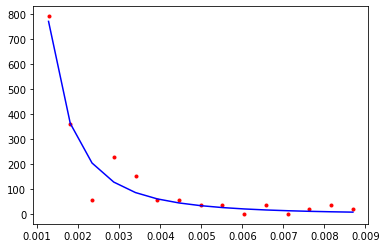

CPU times: user 1.69 ms, sys: 667 µs, total: 2.35 ms
Wall time: 789 µs
13996.036460675994


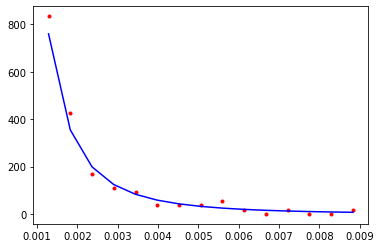

CPU times: user 1.95 ms, sys: 658 µs, total: 2.61 ms
Wall time: 886 µs
12526.25844997759


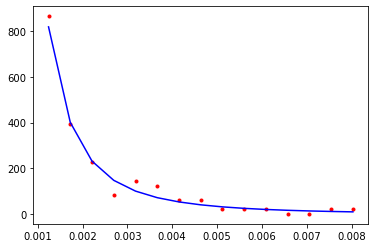

CPU times: user 2.49 ms, sys: 820 µs, total: 3.31 ms
Wall time: 1.14 ms
29507.33110859768


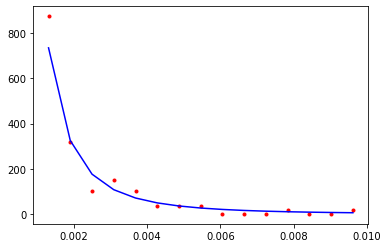

CPU times: user 3.08 ms, sys: 834 µs, total: 3.91 ms
Wall time: 1.34 ms
46062.33971170911


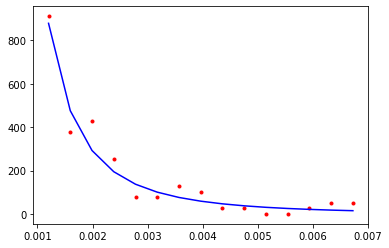

CPU times: user 3.24 ms, sys: 844 µs, total: 4.08 ms
Wall time: 1.41 ms
7270.117828701387


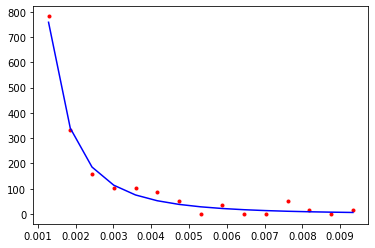

CPU times: user 3.39 ms, sys: 925 µs, total: 4.31 ms
Wall time: 1.47 ms
11068.465401873516


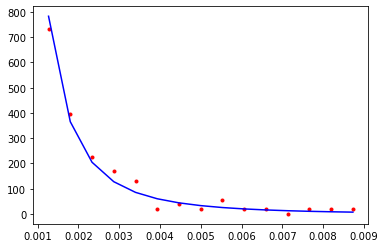

CPU times: user 3.74 ms, sys: 983 µs, total: 4.72 ms
Wall time: 1.61 ms
46670.703249073835


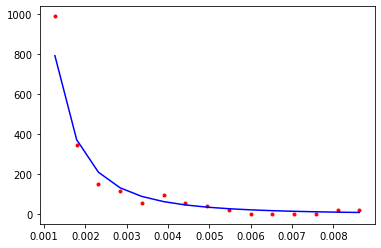

CPU times: user 4.38 ms, sys: 986 µs, total: 5.37 ms
Wall time: 1.82 ms
12131.412199680915


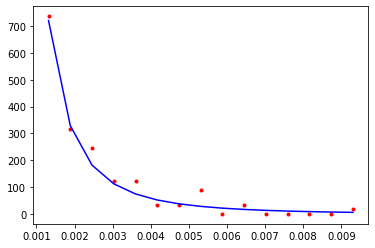

CPU times: user 4.42 ms, sys: 967 µs, total: 5.39 ms
Wall time: 1.84 ms
14618.856081300124


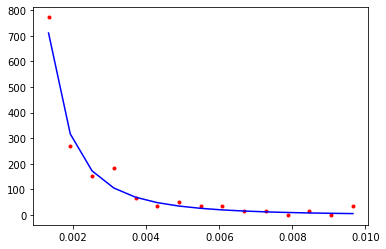

CPU times: user 4.87 ms, sys: 1.37 ms, total: 6.24 ms
Wall time: 2.19 ms
37199.96315539677


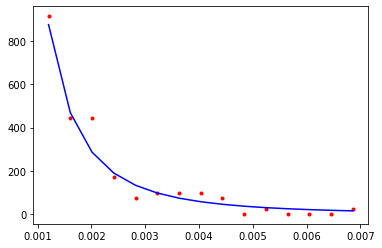

CPU times: user 5.43 ms, sys: 1.23 ms, total: 6.66 ms
Wall time: 2.26 ms
90560.59354125957


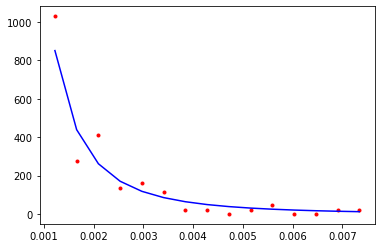

CPU times: user 5.57 ms, sys: 1.17 ms, total: 6.74 ms
Wall time: 2.32 ms
12101.938130596986


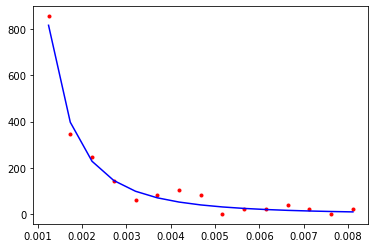

CPU times: user 5.63 ms, sys: 1.58 ms, total: 7.21 ms
Wall time: 2.52 ms
57963.655597589786


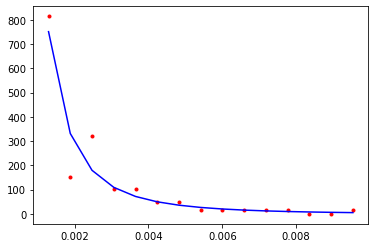

CPU times: user 6.32 ms, sys: 1.59 ms, total: 7.91 ms
Wall time: 2.75 ms
12346.861427997623


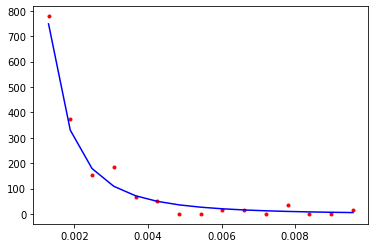

CPU times: user 7.66 ms, sys: 1.77 ms, total: 9.43 ms
Wall time: 3.26 ms
22494.413940491457


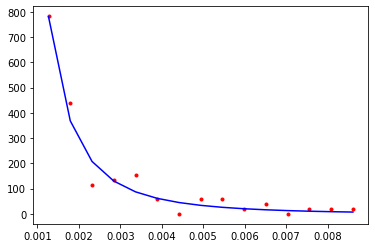

CPU times: user 7.01 ms, sys: 1.46 ms, total: 8.47 ms
Wall time: 2.87 ms
24391.45639779731


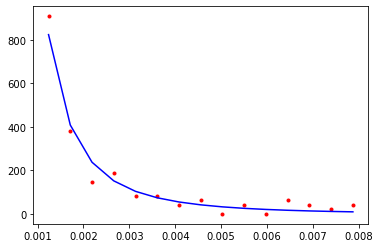

CPU times: user 7.12 ms, sys: 1.57 ms, total: 8.69 ms
Wall time: 3 ms
27830.08509495577


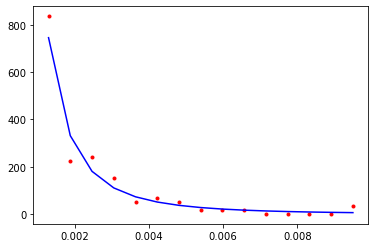

CPU times: user 7.9 ms, sys: 1.44 ms, total: 9.34 ms
Wall time: 3.15 ms
21300.15604202567


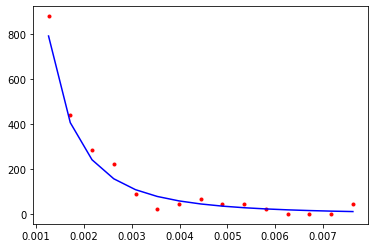

CPU times: user 1.25 ms, sys: 1.24 ms, total: 2.49 ms
Wall time: 850 µs
21208.671618887944


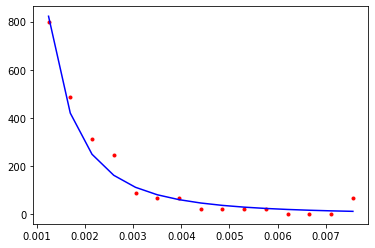

CPU times: user 1.11 ms, sys: 618 µs, total: 1.73 ms
Wall time: 607 µs
108560.26248738544


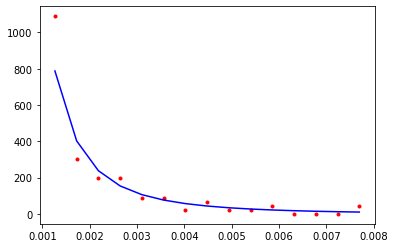

CPU times: user 1.23 ms, sys: 601 µs, total: 1.83 ms
Wall time: 636 µs
24497.387425694073


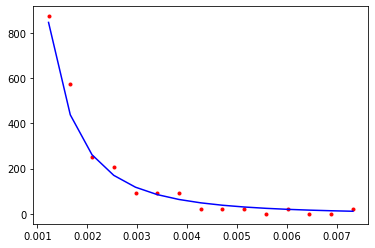

CPU times: user 1.59 ms, sys: 590 µs, total: 2.18 ms
Wall time: 748 µs
47536.38628508491


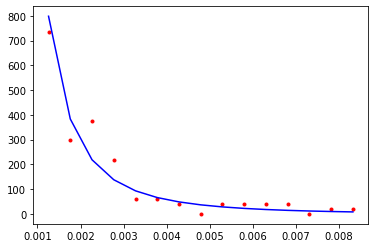

CPU times: user 1.92 ms, sys: 638 µs, total: 2.56 ms
Wall time: 881 µs
21742.788766439906


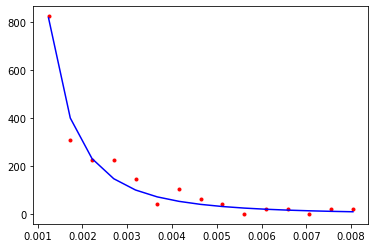

CPU times: user 2.53 ms, sys: 800 µs, total: 3.33 ms
Wall time: 1.15 ms
11066.11037444964


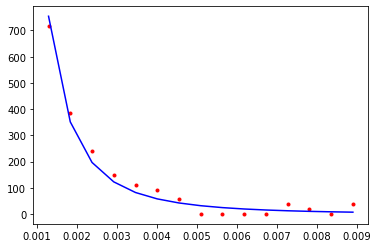

CPU times: user 2.87 ms, sys: 832 µs, total: 3.71 ms
Wall time: 1.27 ms
14972.960057187527


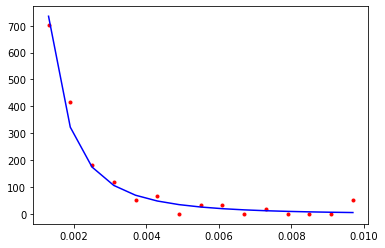

CPU times: user 3.09 ms, sys: 865 µs, total: 3.95 ms
Wall time: 1.35 ms
29665.08186903914


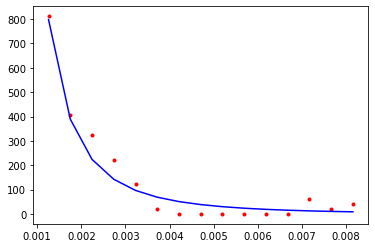

CPU times: user 3.38 ms, sys: 1.09 ms, total: 4.47 ms
Wall time: 1.54 ms
22371.051979408843


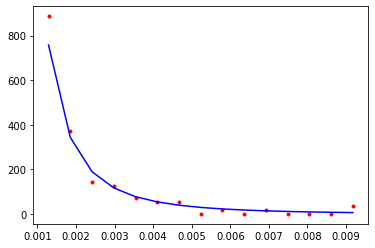

CPU times: user 3.8 ms, sys: 976 µs, total: 4.78 ms
Wall time: 1.64 ms
56766.40547185147


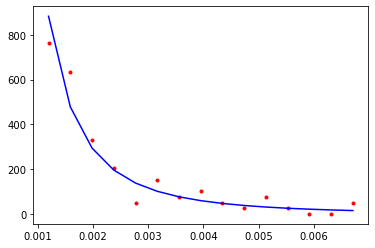

CPU times: user 4.31 ms, sys: 1.23 ms, total: 5.54 ms
Wall time: 1.93 ms
13175.614307165926


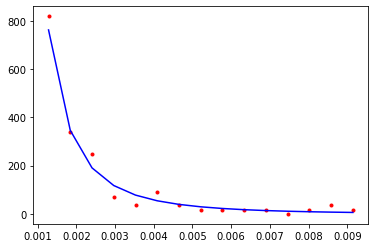

CPU times: user 4.59 ms, sys: 1.15 ms, total: 5.74 ms
Wall time: 1.97 ms
21375.53375673791


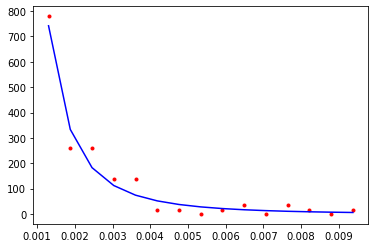

CPU times: user 4.88 ms, sys: 1 ms, total: 5.88 ms
Wall time: 1.99 ms
40895.728715459736


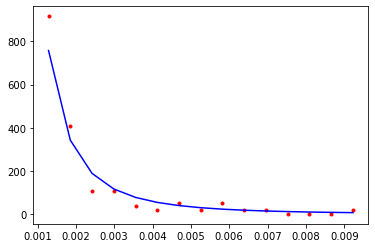

CPU times: user 5.18 ms, sys: 1.28 ms, total: 6.46 ms
Wall time: 2.2 ms
27750.36454149283


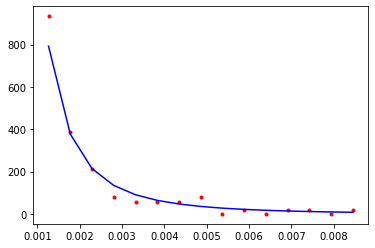

CPU times: user 5.84 ms, sys: 1.23 ms, total: 7.07 ms
Wall time: 2.39 ms
10200.198242875449


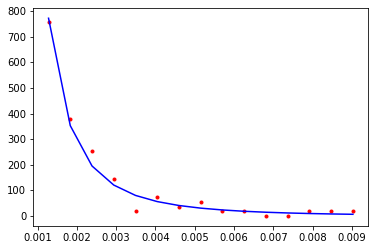

CPU times: user 6.03 ms, sys: 1.22 ms, total: 7.25 ms
Wall time: 2.44 ms
20339.869691600426


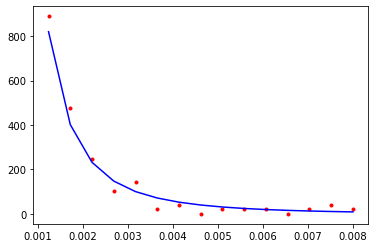

CPU times: user 6.35 ms, sys: 1.24 ms, total: 7.59 ms
Wall time: 2.55 ms
39593.31880135711


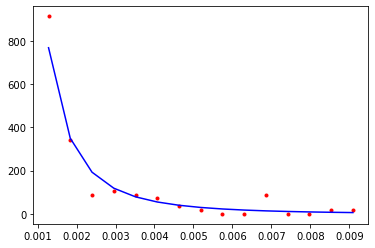

CPU times: user 6.71 ms, sys: 1.26 ms, total: 7.97 ms
Wall time: 2.69 ms
44388.111583036014


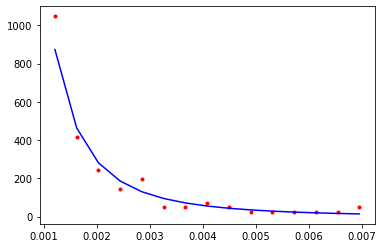

CPU times: user 7.26 ms, sys: 1.39 ms, total: 8.65 ms
Wall time: 2.91 ms
22480.68828627363


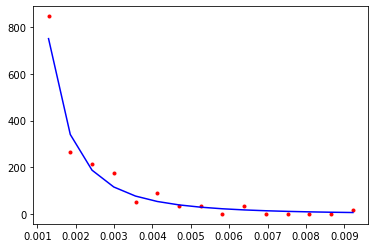

CPU times: user 7.65 ms, sys: 1.43 ms, total: 9.08 ms
Wall time: 3.06 ms
23027.15047628616


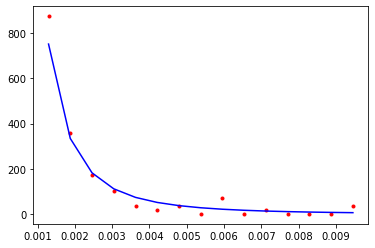

CPU times: user 7.85 ms, sys: 1.38 ms, total: 9.23 ms
Wall time: 3.1 ms
39438.72976395167


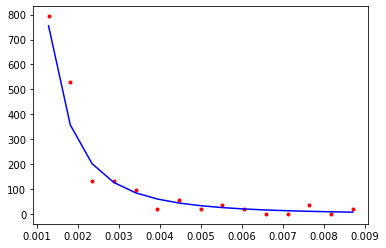

CPU times: user 1.21 ms, sys: 1.13 ms, total: 2.33 ms
Wall time: 773 µs
22668.180264052608


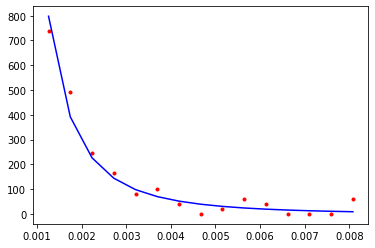

In [46]:
for _ in range(loops):
    for nn_iter in n_iter:
        lib.set_rutherford_iterations(nn_iter)
        %time r_everest = [ lib.get_random_ruth() for _ in range(n) ]
        S_everest[nn_iter] = np.array([ *S_everest[nn_iter], test_random(r_everest, bins, f) ])
    %time r_k2 = [ k2ran.get_random_ruth(cgen) for _ in range(n) ]
    S_K2 = np.array([ *S_K2, test_random(r_k2, bins, f) ])

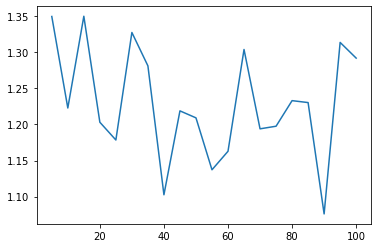

In [47]:
plt.plot(n_iter, [ np.sqrt((S_everest[nn_iter] / S_K2).mean()) for nn_iter in n_iter ])

In [48]:
lib.set_random_seed(1669281221)
k2ran.set_random_seed(1669281221)

mat = xc.materials.Berylium
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

lib.set_rutherford_parameters(z,emr,t1)
cgen = k2ran.initialise_random_ruth(zatom=z, emr=emr, hcut=t1)

n = 100
n_iter = [5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
bins = 15

loops = 20
S_everest = { nn: [] for nn in n_iter }
S_K2 = []
f = lambda x: PDF(x,z,emr)/CDF(t1,z,emr)

CPU times: user 594 µs, sys: 227 µs, total: 821 µs
Wall time: 230 µs
13051.81682261667


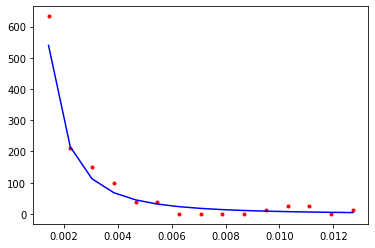

CPU times: user 1.4 ms, sys: 620 µs, total: 2.02 ms
Wall time: 704 µs
22406.34670543476


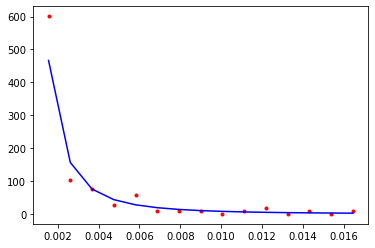

CPU times: user 1.73 ms, sys: 762 µs, total: 2.49 ms
Wall time: 873 µs
9575.160826115947


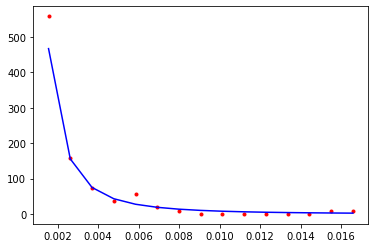

CPU times: user 2.07 ms, sys: 769 µs, total: 2.84 ms
Wall time: 986 µs
3273.660538437259


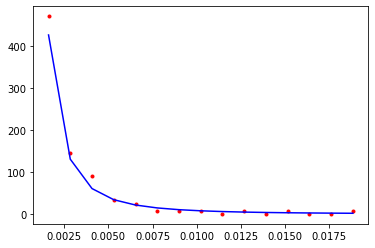

CPU times: user 2.12 ms, sys: 609 µs, total: 2.73 ms
Wall time: 913 µs
11390.082211943518


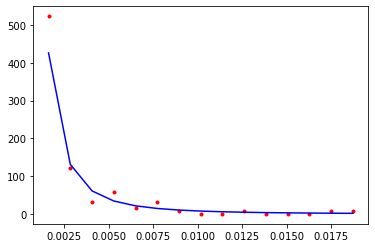

CPU times: user 2.75 ms, sys: 794 µs, total: 3.55 ms
Wall time: 1.22 ms
64655.93617610699


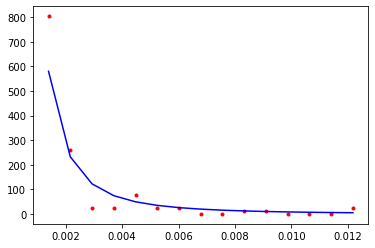

CPU times: user 2.81 ms, sys: 777 µs, total: 3.58 ms
Wall time: 1.22 ms
33031.91796572001


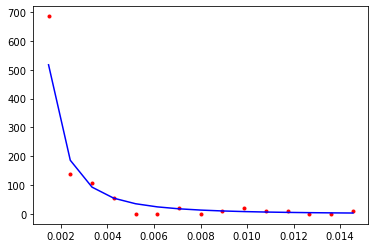

CPU times: user 3.22 ms, sys: 785 µs, total: 4 ms
Wall time: 1.36 ms
37002.55234094082


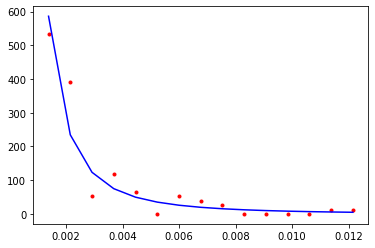

CPU times: user 3.58 ms, sys: 901 µs, total: 4.48 ms
Wall time: 1.52 ms
31652.406483822935


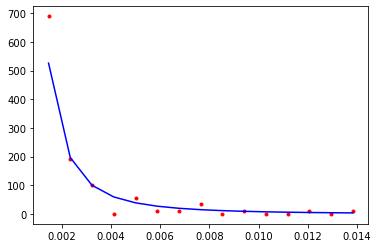

CPU times: user 3.94 ms, sys: 854 µs, total: 4.79 ms
Wall time: 1.62 ms
10499.841661074384


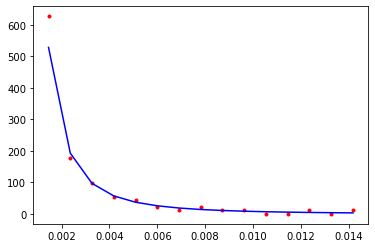

CPU times: user 4.03 ms, sys: 1.1 ms, total: 5.13 ms
Wall time: 1.78 ms
7619.889143601939


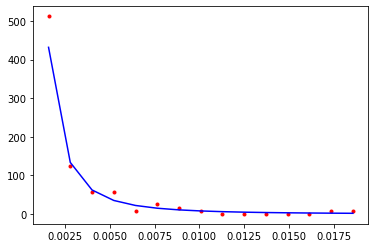

CPU times: user 4.57 ms, sys: 919 µs, total: 5.49 ms
Wall time: 1.88 ms
12091.48328895282


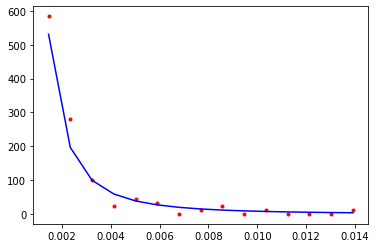

CPU times: user 4.92 ms, sys: 1.04 ms, total: 5.96 ms
Wall time: 2.02 ms
13592.299567331102


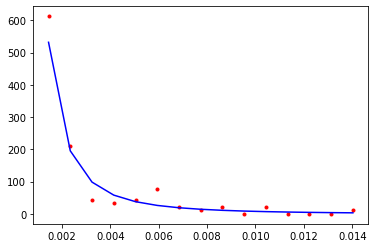

CPU times: user 5.32 ms, sys: 1.14 ms, total: 6.45 ms
Wall time: 2.18 ms
16487.04978184307


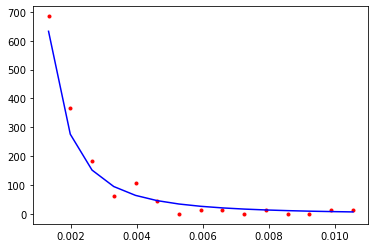

CPU times: user 5.92 ms, sys: 1.27 ms, total: 7.19 ms
Wall time: 2.44 ms
6022.0825574233695


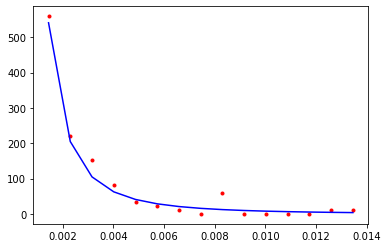

CPU times: user 6.24 ms, sys: 1.29 ms, total: 7.53 ms
Wall time: 2.55 ms
6497.716286151459


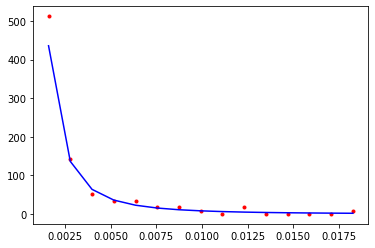

CPU times: user 6.29 ms, sys: 1.19 ms, total: 7.47 ms
Wall time: 2.52 ms
27769.186605269093


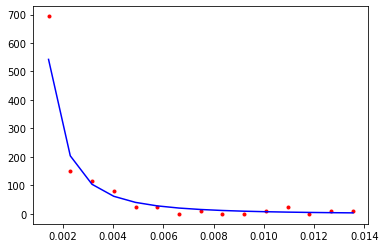

CPU times: user 6.87 ms, sys: 1.33 ms, total: 8.2 ms
Wall time: 2.76 ms
4960.147777153108


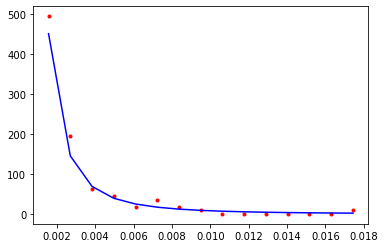

CPU times: user 7.16 ms, sys: 1.29 ms, total: 8.45 ms
Wall time: 2.83 ms
7795.612155106879


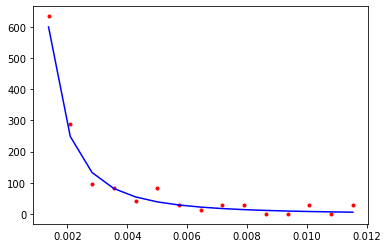

CPU times: user 7.08 ms, sys: 1.35 ms, total: 8.43 ms
Wall time: 2.86 ms
5685.62762371013


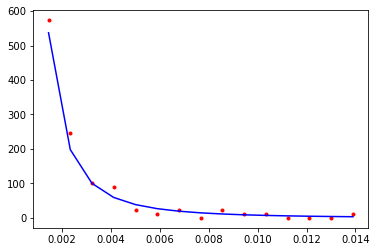

CPU times: user 1.1 ms, sys: 1.01 ms, total: 2.11 ms
Wall time: 691 µs
5094.127945783998


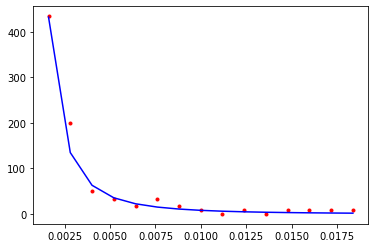

CPU times: user 1.07 ms, sys: 572 µs, total: 1.64 ms
Wall time: 589 µs
14699.125809877576


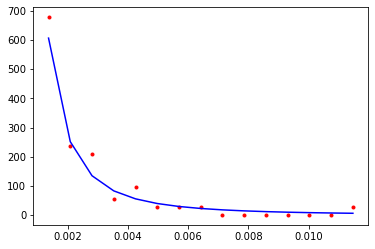

CPU times: user 1.18 ms, sys: 521 µs, total: 1.7 ms
Wall time: 582 µs
8835.770176539412


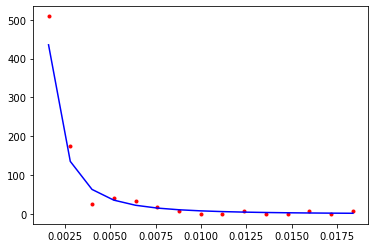

CPU times: user 1.53 ms, sys: 495 µs, total: 2.02 ms
Wall time: 683 µs
9619.928001975035


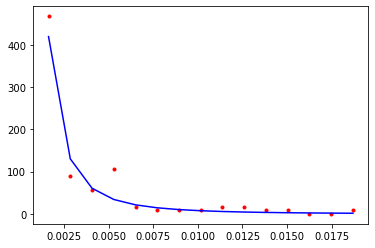

CPU times: user 1.99 ms, sys: 678 µs, total: 2.67 ms
Wall time: 933 µs
7054.459186741091


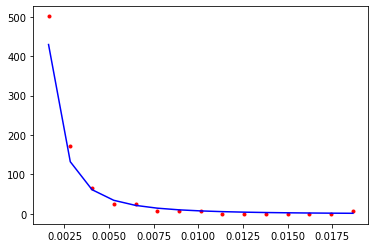

CPU times: user 2.18 ms, sys: 723 µs, total: 2.91 ms
Wall time: 997 µs
3458.2177621716223


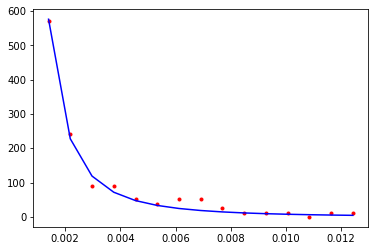

CPU times: user 2.47 ms, sys: 760 µs, total: 3.23 ms
Wall time: 1.1 ms
10329.571313705683


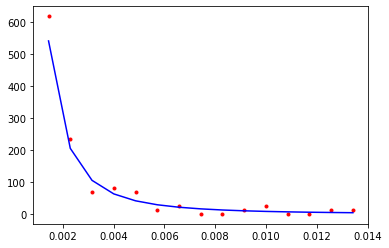

CPU times: user 2.92 ms, sys: 805 µs, total: 3.73 ms
Wall time: 1.27 ms
13200.947869346543


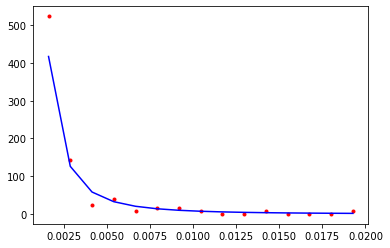

CPU times: user 3.2 ms, sys: 792 µs, total: 3.99 ms
Wall time: 1.35 ms
8235.705388956974


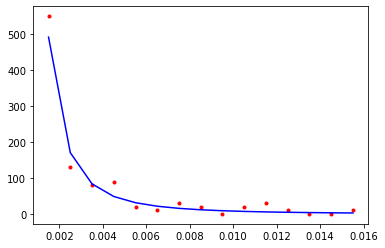

CPU times: user 3.5 ms, sys: 880 µs, total: 4.38 ms
Wall time: 1.49 ms
2796.932980912863


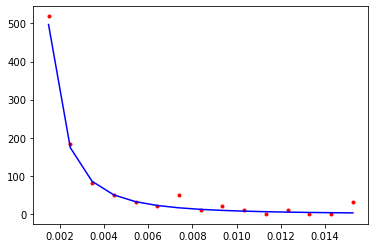

CPU times: user 4.04 ms, sys: 1.17 ms, total: 5.21 ms
Wall time: 1.84 ms
15004.909385322346


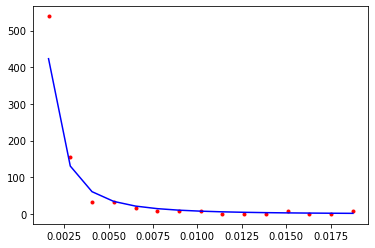

CPU times: user 4.23 ms, sys: 932 µs, total: 5.16 ms
Wall time: 1.75 ms
5455.749235711051


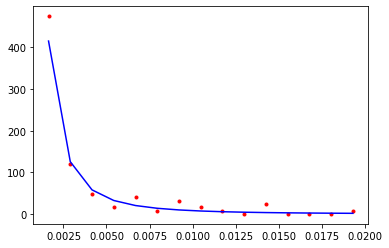

CPU times: user 4.64 ms, sys: 995 µs, total: 5.63 ms
Wall time: 1.89 ms
3843.2692428296264


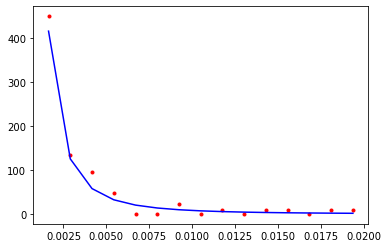

CPU times: user 5.21 ms, sys: 1.11 ms, total: 6.32 ms
Wall time: 2.15 ms
6138.613574597501


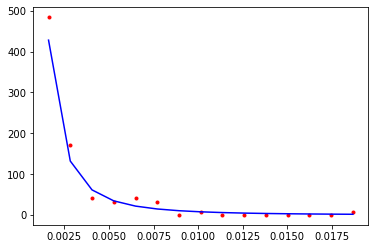

CPU times: user 5.51 ms, sys: 1.16 ms, total: 6.67 ms
Wall time: 2.27 ms
8631.175364865077


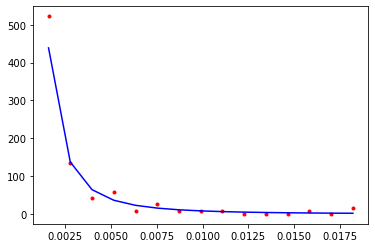

CPU times: user 5.7 ms, sys: 1.16 ms, total: 6.86 ms
Wall time: 2.31 ms
13801.41066299886


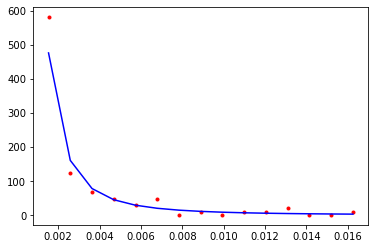

CPU times: user 6.09 ms, sys: 1.21 ms, total: 7.31 ms
Wall time: 2.45 ms
7406.709708919921


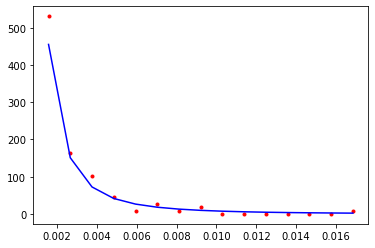

CPU times: user 6.41 ms, sys: 1.16 ms, total: 7.57 ms
Wall time: 2.54 ms
7561.0727157467445


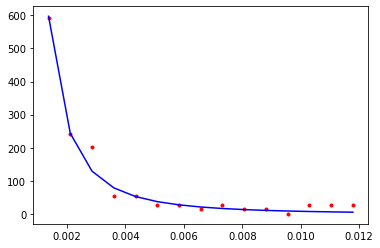

CPU times: user 6.79 ms, sys: 1.29 ms, total: 8.08 ms
Wall time: 2.71 ms
4238.800202970289


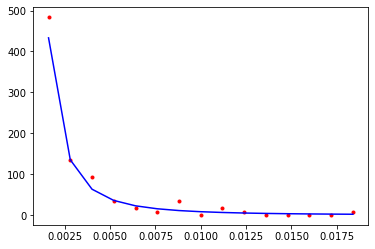

CPU times: user 6.87 ms, sys: 1.47 ms, total: 8.34 ms
Wall time: 2.85 ms
20665.258404766213


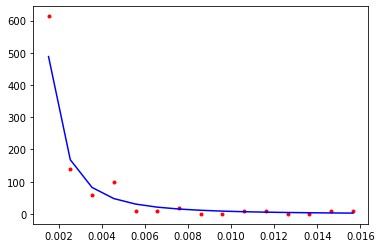

CPU times: user 7.59 ms, sys: 1.36 ms, total: 8.96 ms
Wall time: 3.02 ms
6052.014957899427


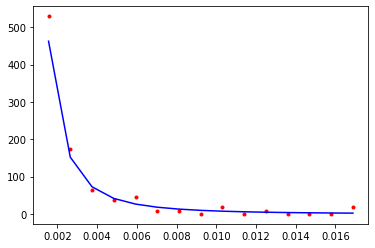

CPU times: user 1.25 ms, sys: 1.17 ms, total: 2.43 ms
Wall time: 778 µs
14686.013442662917


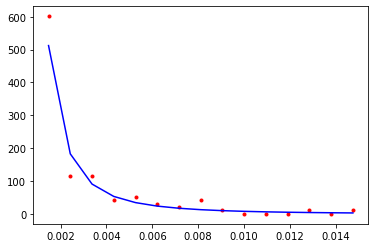

CPU times: user 854 µs, sys: 425 µs, total: 1.28 ms
Wall time: 441 µs
21851.016540130895


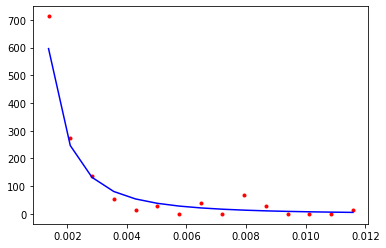

CPU times: user 1.2 ms, sys: 511 µs, total: 1.71 ms
Wall time: 587 µs
8190.088904961742


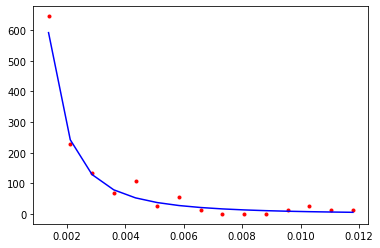

CPU times: user 1.72 ms, sys: 637 µs, total: 2.36 ms
Wall time: 818 µs
7185.222018491427


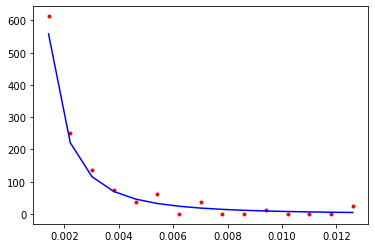

CPU times: user 1.9 ms, sys: 722 µs, total: 2.62 ms
Wall time: 909 µs
13399.950608664229


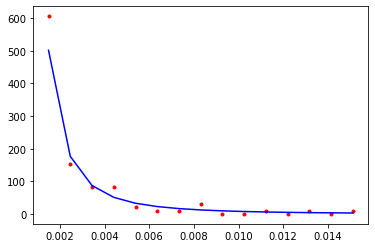

CPU times: user 2.28 ms, sys: 894 µs, total: 3.17 ms
Wall time: 1.13 ms
11278.615570145797


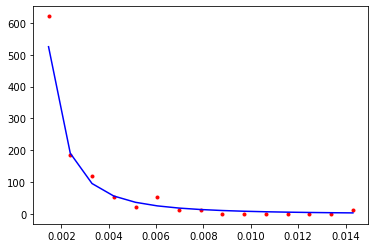

CPU times: user 2.49 ms, sys: 771 µs, total: 3.26 ms
Wall time: 1.12 ms
3537.9483181560086


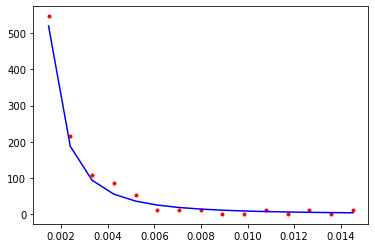

CPU times: user 2.91 ms, sys: 791 µs, total: 3.7 ms
Wall time: 1.27 ms
15086.439251153946


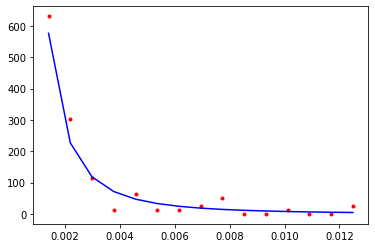

CPU times: user 3.19 ms, sys: 914 µs, total: 4.1 ms
Wall time: 1.41 ms
4325.534028461463


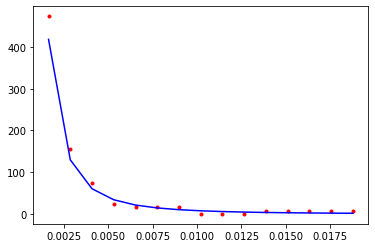

CPU times: user 3.66 ms, sys: 877 µs, total: 4.54 ms
Wall time: 1.54 ms
15835.506727216329


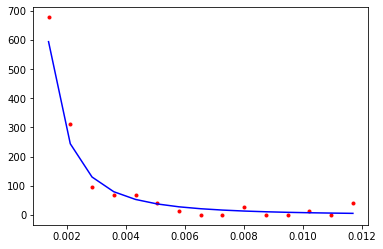

CPU times: user 3.68 ms, sys: 1.1 ms, total: 4.78 ms
Wall time: 1.69 ms
17097.144855386297


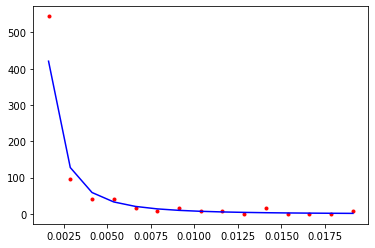

CPU times: user 4.42 ms, sys: 1.02 ms, total: 5.44 ms
Wall time: 1.85 ms
10629.899230355713


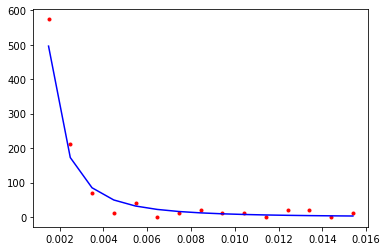

CPU times: user 4.21 ms, sys: 1.22 ms, total: 5.43 ms
Wall time: 1.93 ms
12094.301163395785


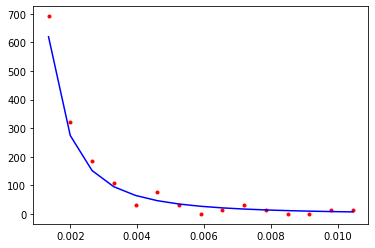

CPU times: user 4.68 ms, sys: 1.25 ms, total: 5.93 ms
Wall time: 2.12 ms
28520.898515807603


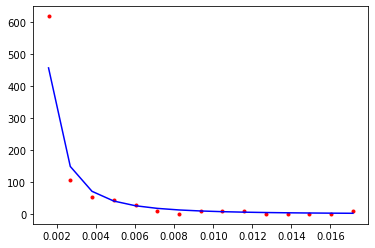

CPU times: user 5.48 ms, sys: 1.23 ms, total: 6.72 ms
Wall time: 2.3 ms
5137.660318651463


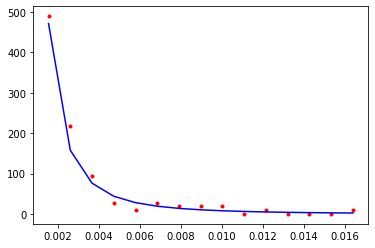

CPU times: user 5.68 ms, sys: 1.32 ms, total: 7 ms
Wall time: 2.42 ms
10456.676911808689


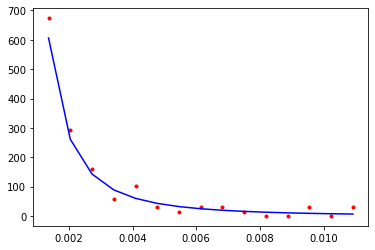

CPU times: user 6.19 ms, sys: 1.3 ms, total: 7.49 ms
Wall time: 2.54 ms
7985.421972391055


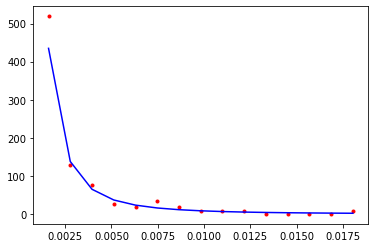

CPU times: user 6.35 ms, sys: 1.24 ms, total: 7.59 ms
Wall time: 2.55 ms
16834.451692549832


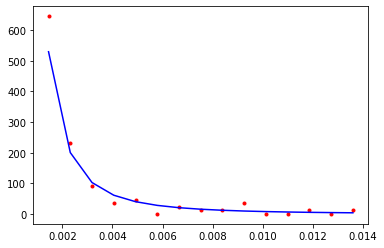

CPU times: user 7.05 ms, sys: 1.33 ms, total: 8.38 ms
Wall time: 2.81 ms
10969.729826831526


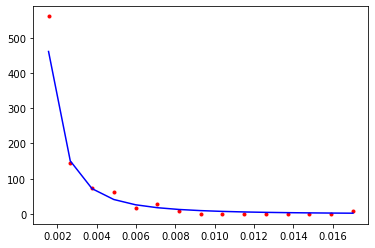

CPU times: user 7.29 ms, sys: 1.4 ms, total: 8.69 ms
Wall time: 2.94 ms
4940.551163805045


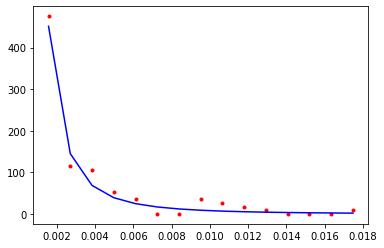

CPU times: user 7.44 ms, sys: 1.37 ms, total: 8.81 ms
Wall time: 2.96 ms
14871.179986274223


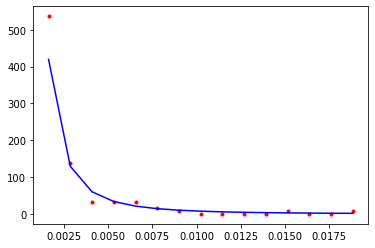

CPU times: user 1.22 ms, sys: 1.16 ms, total: 2.38 ms
Wall time: 782 µs
8283.54144355016


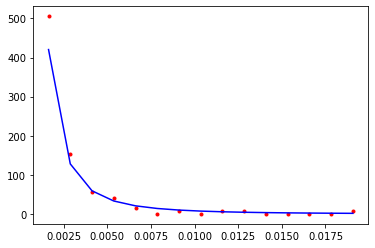

CPU times: user 908 µs, sys: 522 µs, total: 1.43 ms
Wall time: 489 µs
5690.7967958196805


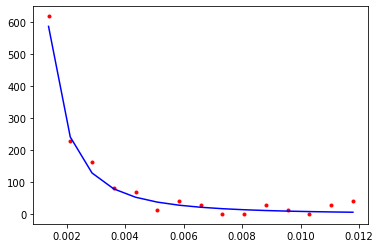

CPU times: user 1.24 ms, sys: 572 µs, total: 1.82 ms
Wall time: 618 µs
5766.037981455695


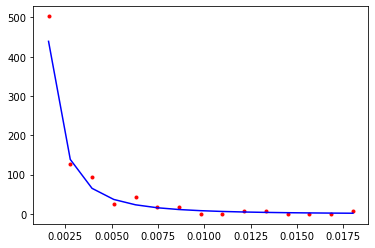

CPU times: user 1.62 ms, sys: 560 µs, total: 2.18 ms
Wall time: 728 µs
9770.79655491814


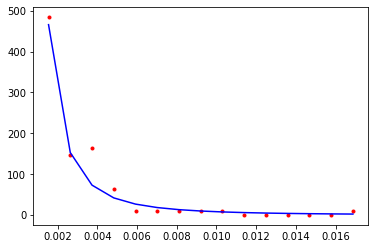

CPU times: user 1.92 ms, sys: 876 µs, total: 2.8 ms
Wall time: 1.01 ms
3775.174267370414


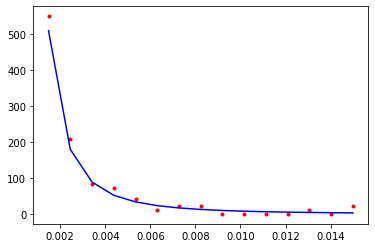

CPU times: user 2.33 ms, sys: 747 µs, total: 3.08 ms
Wall time: 1.07 ms
7783.825833906557


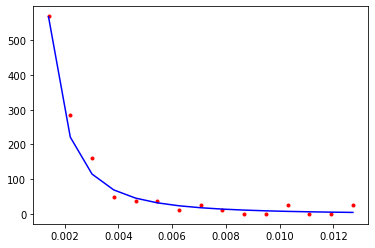

CPU times: user 2.66 ms, sys: 796 µs, total: 3.46 ms
Wall time: 1.18 ms
17865.591487522142


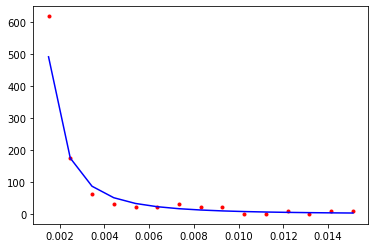

CPU times: user 2.91 ms, sys: 865 µs, total: 3.77 ms
Wall time: 1.31 ms
4180.009290942094


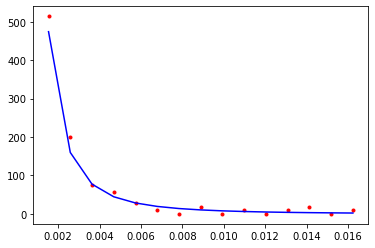

CPU times: user 3.02 ms, sys: 1.07 ms, total: 4.09 ms
Wall time: 1.43 ms
10485.242679723164


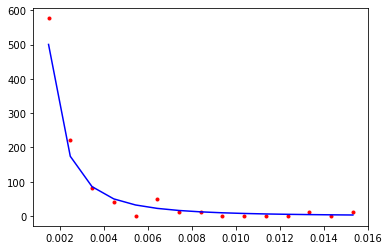

CPU times: user 3.71 ms, sys: 974 µs, total: 4.68 ms
Wall time: 1.62 ms
7620.154254230067


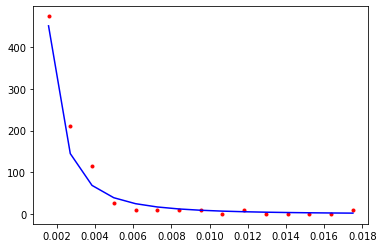

CPU times: user 4.08 ms, sys: 1.05 ms, total: 5.14 ms
Wall time: 1.76 ms
10590.437328036158


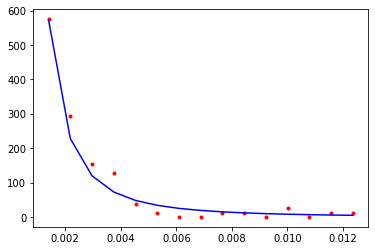

CPU times: user 4.45 ms, sys: 1.08 ms, total: 5.54 ms
Wall time: 1.89 ms
9590.38927307585


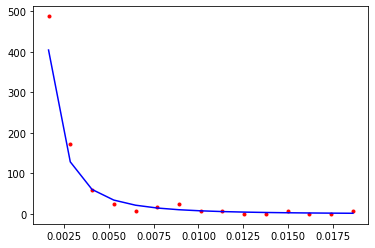

CPU times: user 4.45 ms, sys: 1.13 ms, total: 5.58 ms
Wall time: 1.92 ms
21438.359835565952


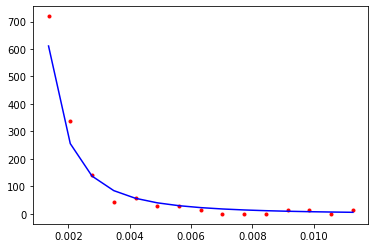

CPU times: user 5.06 ms, sys: 1.42 ms, total: 6.49 ms
Wall time: 2.27 ms
29389.22622616483


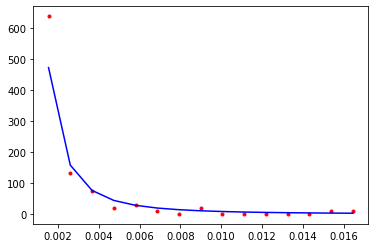

CPU times: user 5.25 ms, sys: 1.2 ms, total: 6.45 ms
Wall time: 2.21 ms
3594.6867670898155


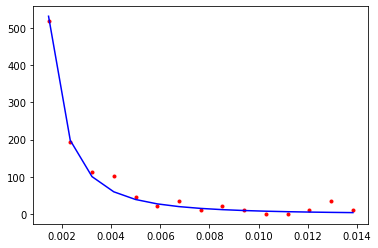

CPU times: user 5.73 ms, sys: 1.22 ms, total: 6.95 ms
Wall time: 2.34 ms
8786.523742891875


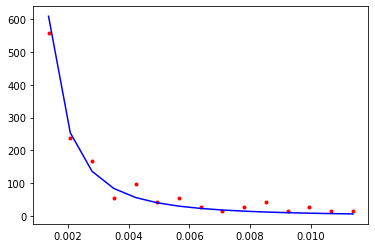

CPU times: user 6.33 ms, sys: 1.28 ms, total: 7.6 ms
Wall time: 2.57 ms
5559.028463806639


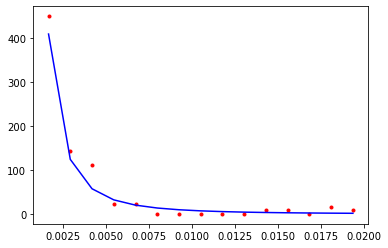

CPU times: user 6.47 ms, sys: 1.18 ms, total: 7.66 ms
Wall time: 2.57 ms
12999.438839798844


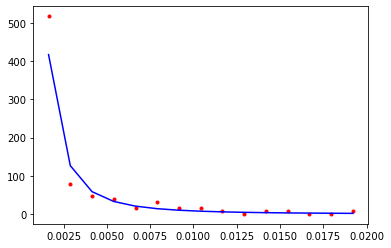

CPU times: user 6.98 ms, sys: 1.46 ms, total: 8.44 ms
Wall time: 2.86 ms
4049.6175468884467


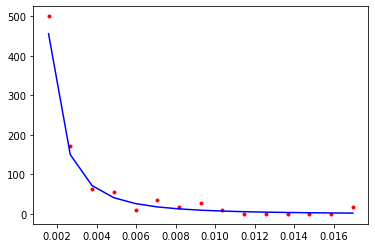

CPU times: user 7.14 ms, sys: 1.52 ms, total: 8.67 ms
Wall time: 2.95 ms
15939.920166219748


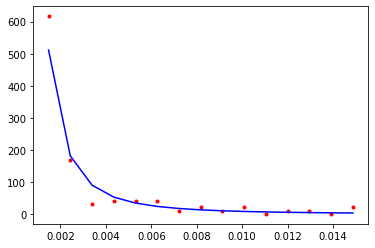

CPU times: user 7.13 ms, sys: 1.77 ms, total: 8.9 ms
Wall time: 3.11 ms
7562.669234841157


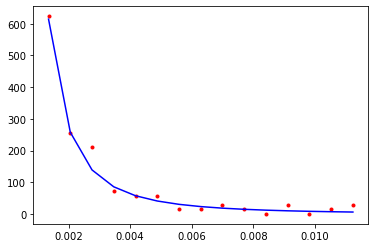

CPU times: user 1.31 ms, sys: 1.3 ms, total: 2.61 ms
Wall time: 850 µs
7864.935178612389


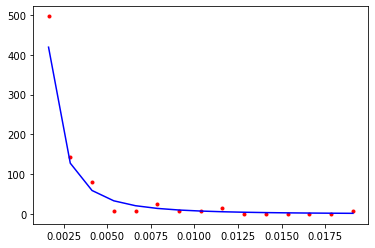

CPU times: user 885 µs, sys: 473 µs, total: 1.36 ms
Wall time: 461 µs
6925.798169218058


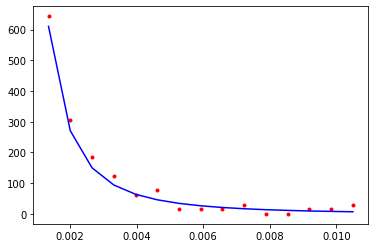

CPU times: user 1.44 ms, sys: 620 µs, total: 2.06 ms
Wall time: 715 µs
13069.965155682501


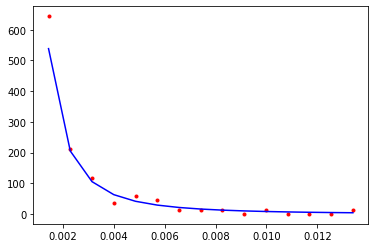

CPU times: user 1.63 ms, sys: 567 µs, total: 2.2 ms
Wall time: 738 µs
3944.191837306848


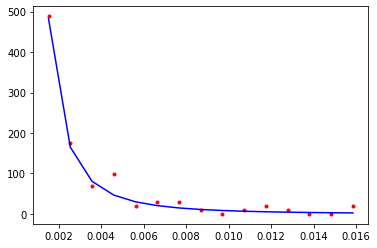

CPU times: user 1.97 ms, sys: 649 µs, total: 2.62 ms
Wall time: 879 µs
12040.102173318286


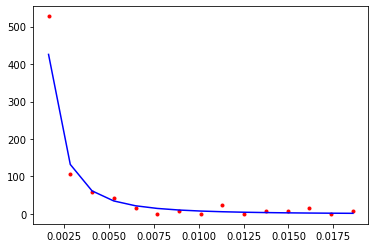

CPU times: user 2.16 ms, sys: 688 µs, total: 2.85 ms
Wall time: 990 µs
31892.449628204013


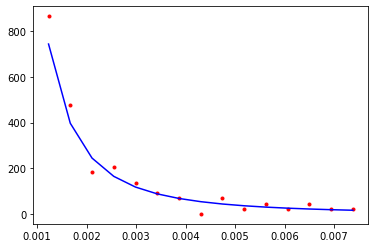

CPU times: user 2.45 ms, sys: 752 µs, total: 3.2 ms
Wall time: 1.11 ms
12598.136617252865


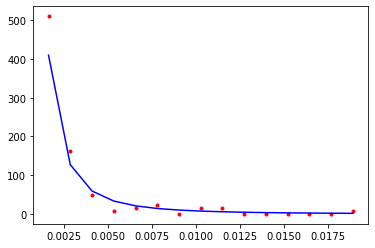

CPU times: user 3.06 ms, sys: 878 µs, total: 3.94 ms
Wall time: 1.36 ms
17393.189257603954


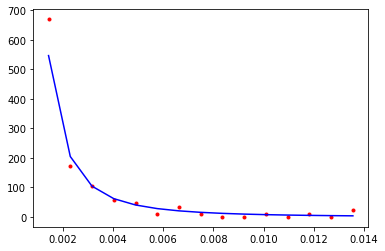

CPU times: user 3.29 ms, sys: 857 µs, total: 4.15 ms
Wall time: 1.4 ms
6626.206650763829


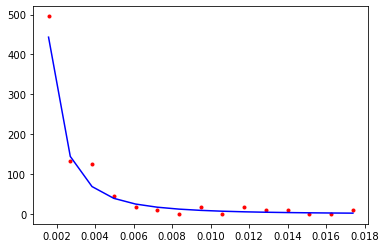

CPU times: user 3.6 ms, sys: 852 µs, total: 4.45 ms
Wall time: 1.51 ms
9167.566882567116


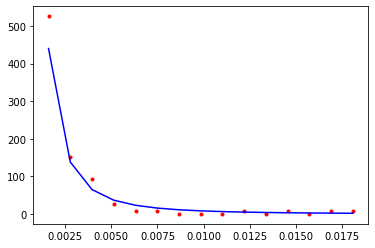

CPU times: user 3.76 ms, sys: 807 µs, total: 4.57 ms
Wall time: 1.55 ms
23097.296967795814


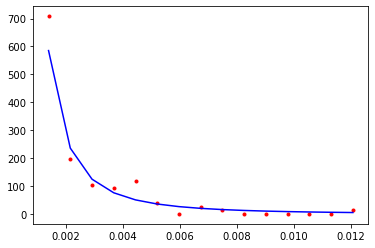

CPU times: user 4.47 ms, sys: 1.06 ms, total: 5.53 ms
Wall time: 1.88 ms
6511.606777274749


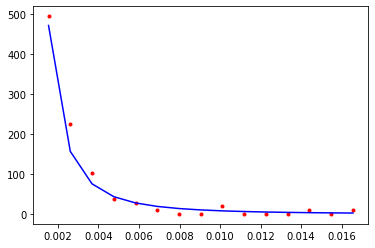

CPU times: user 4.81 ms, sys: 1.22 ms, total: 6.03 ms
Wall time: 2.09 ms
3691.496374616648


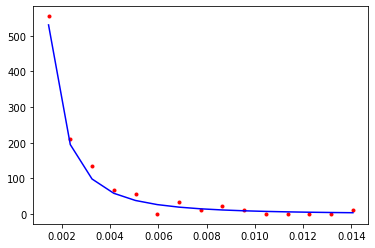

CPU times: user 4.9 ms, sys: 1.39 ms, total: 6.29 ms
Wall time: 2.21 ms
11479.472926331544


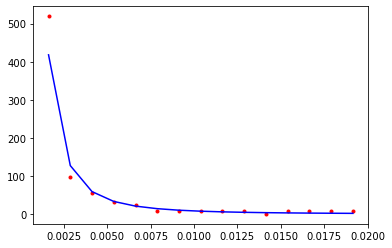

CPU times: user 5.58 ms, sys: 1.2 ms, total: 6.78 ms
Wall time: 2.3 ms
7483.89099530424


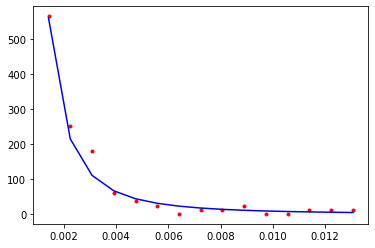

CPU times: user 5.68 ms, sys: 1.19 ms, total: 6.87 ms
Wall time: 2.36 ms
6235.895622745856


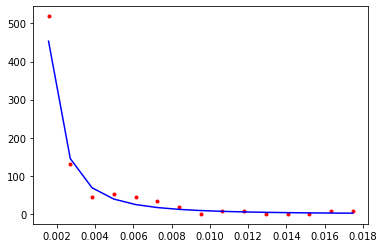

CPU times: user 6.01 ms, sys: 1.25 ms, total: 7.26 ms
Wall time: 2.46 ms
13825.831044622302


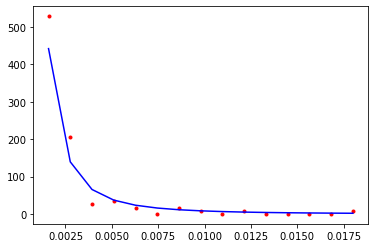

CPU times: user 6.56 ms, sys: 1.4 ms, total: 7.96 ms
Wall time: 2.69 ms
12749.08064915042


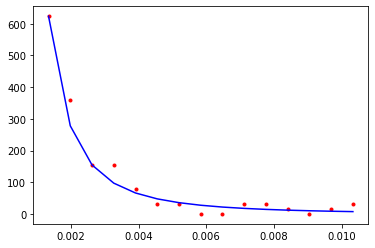

CPU times: user 6.84 ms, sys: 1.45 ms, total: 8.29 ms
Wall time: 2.85 ms
11660.688823316434


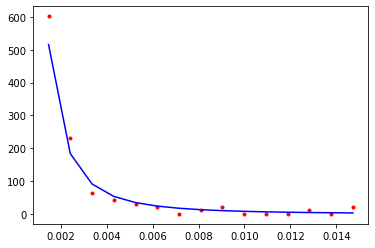

CPU times: user 6.9 ms, sys: 1.52 ms, total: 8.41 ms
Wall time: 2.9 ms
2453.770058544729


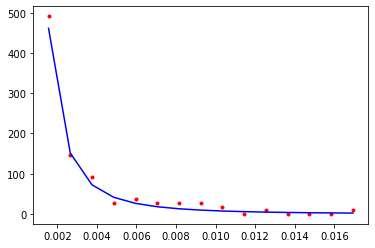

CPU times: user 7.71 ms, sys: 1.36 ms, total: 9.07 ms
Wall time: 3.03 ms
5651.91189519201


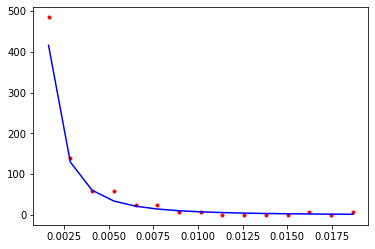

CPU times: user 1.22 ms, sys: 1.16 ms, total: 2.38 ms
Wall time: 795 µs
6654.184100574163


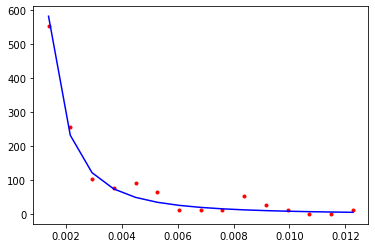

CPU times: user 859 µs, sys: 507 µs, total: 1.37 ms
Wall time: 463 µs
11217.95244604588


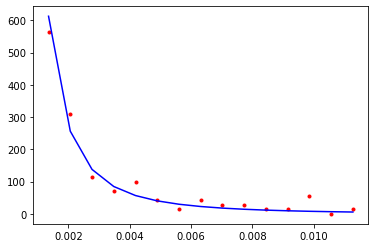

CPU times: user 1.18 ms, sys: 575 µs, total: 1.76 ms
Wall time: 600 µs
9177.099150379878


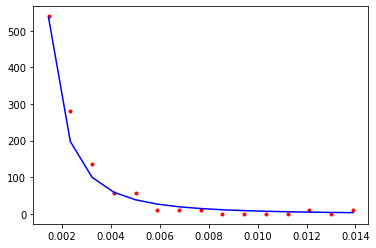

CPU times: user 1.31 ms, sys: 447 µs, total: 1.76 ms
Wall time: 6.73 ms
2343.454905156086


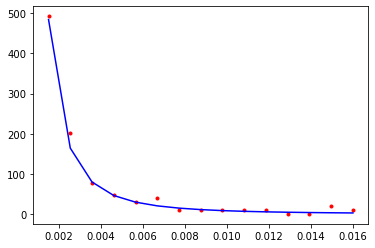

CPU times: user 1.86 ms, sys: 579 µs, total: 2.44 ms
Wall time: 831 µs
4741.3771560455625


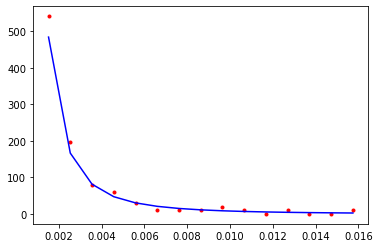

CPU times: user 2.18 ms, sys: 745 µs, total: 2.93 ms
Wall time: 1.01 ms
6873.410465173037


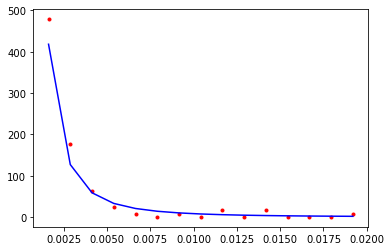

CPU times: user 2.77 ms, sys: 808 µs, total: 3.58 ms
Wall time: 1.23 ms
16262.696764017528


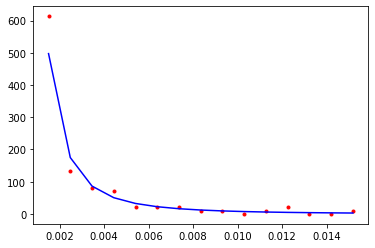

CPU times: user 3.07 ms, sys: 858 µs, total: 3.93 ms
Wall time: 1.35 ms
4437.205757932119


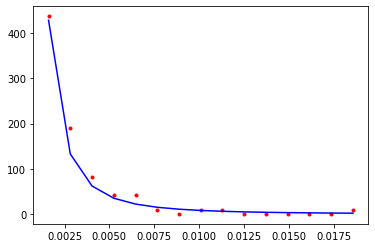

CPU times: user 3.44 ms, sys: 970 µs, total: 4.41 ms
Wall time: 1.51 ms
7802.502871171042


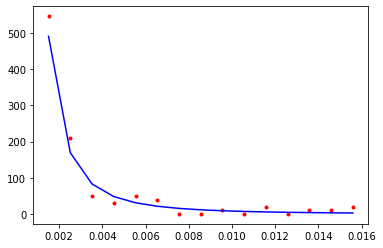

CPU times: user 3.6 ms, sys: 894 µs, total: 4.49 ms
Wall time: 1.52 ms
16867.312529816805


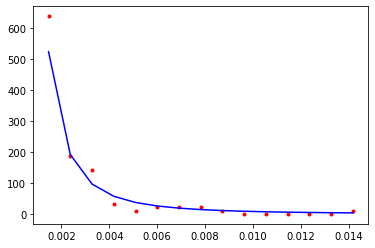

CPU times: user 3.92 ms, sys: 954 µs, total: 4.87 ms
Wall time: 1.66 ms
5944.471027280696


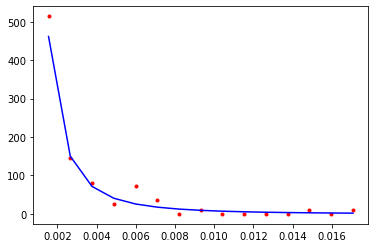

CPU times: user 4.33 ms, sys: 974 µs, total: 5.3 ms
Wall time: 1.8 ms
23811.1738830872


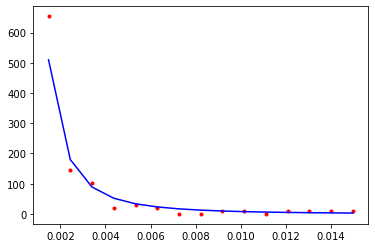

CPU times: user 4.82 ms, sys: 1.07 ms, total: 5.89 ms
Wall time: 2 ms
13586.485832753122


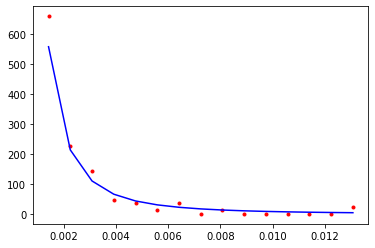

CPU times: user 5.31 ms, sys: 1.18 ms, total: 6.49 ms
Wall time: 2.21 ms
5964.456318650806


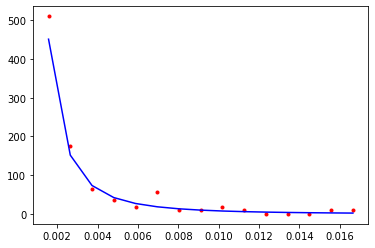

CPU times: user 5.24 ms, sys: 1.15 ms, total: 6.39 ms
Wall time: 2.17 ms
26533.56404623157


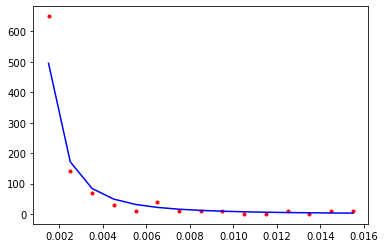

CPU times: user 5.34 ms, sys: 1.78 ms, total: 7.12 ms
Wall time: 2.56 ms
7512.279261502482


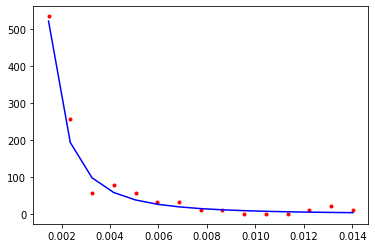

CPU times: user 6.01 ms, sys: 1.3 ms, total: 7.31 ms
Wall time: 2.49 ms
32437.551819467368


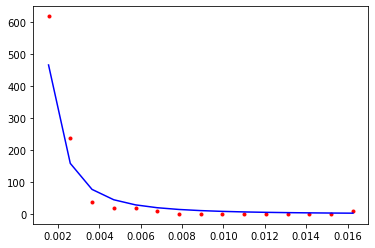

CPU times: user 6.21 ms, sys: 1.38 ms, total: 7.59 ms
Wall time: 2.61 ms
12592.108297526907


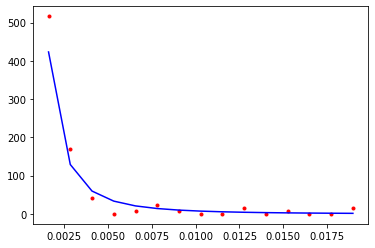

CPU times: user 6.67 ms, sys: 1.36 ms, total: 8.03 ms
Wall time: 2.71 ms
4788.879392763117


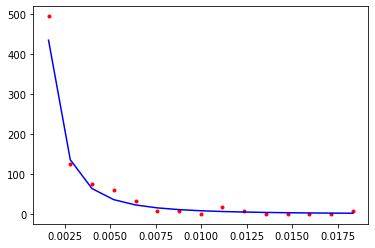

CPU times: user 7.07 ms, sys: 1.37 ms, total: 8.44 ms
Wall time: 2.86 ms
3519.781374315092


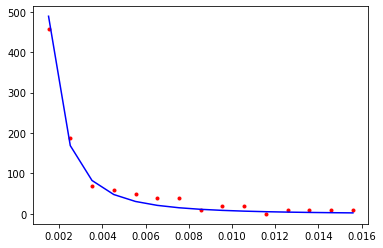

CPU times: user 7.69 ms, sys: 1.43 ms, total: 9.12 ms
Wall time: 3.06 ms
22849.991075875183


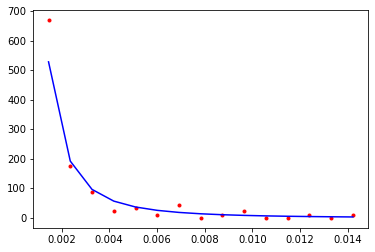

CPU times: user 1.32 ms, sys: 1.24 ms, total: 2.56 ms
Wall time: 850 µs
2416.842197297783


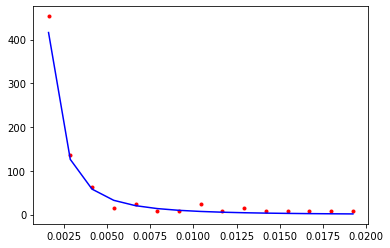

CPU times: user 892 µs, sys: 485 µs, total: 1.38 ms
Wall time: 481 µs
3522.9822251571004


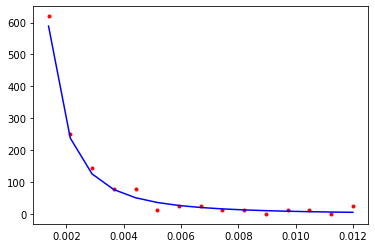

CPU times: user 1.25 ms, sys: 496 µs, total: 1.75 ms
Wall time: 594 µs
70758.88502659432


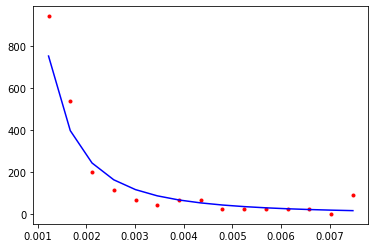

CPU times: user 1.73 ms, sys: 710 µs, total: 2.44 ms
Wall time: 857 µs
20104.11344720428


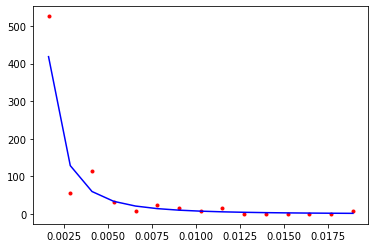

CPU times: user 2.04 ms, sys: 799 µs, total: 2.84 ms
Wall time: 1 ms
5060.6211994558325


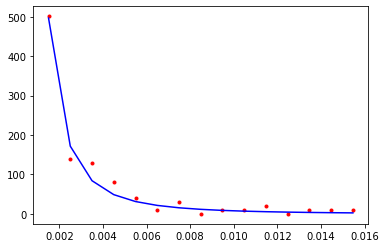

CPU times: user 2.41 ms, sys: 843 µs, total: 3.25 ms
Wall time: 1.14 ms
4084.8579513222553


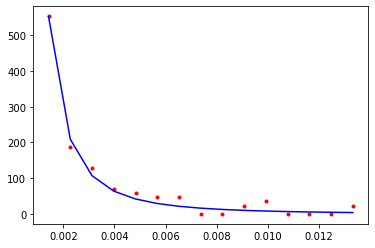

CPU times: user 2.33 ms, sys: 849 µs, total: 3.18 ms
Wall time: 1.14 ms
14919.4818909701


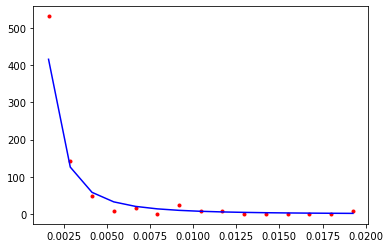

CPU times: user 2.93 ms, sys: 854 µs, total: 3.78 ms
Wall time: 1.29 ms
19163.1785855038


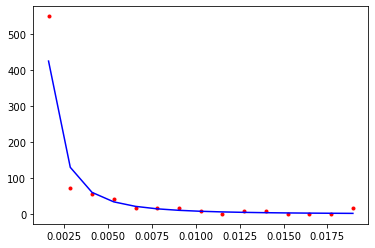

CPU times: user 3.18 ms, sys: 1.09 ms, total: 4.27 ms
Wall time: 1.53 ms
2735.8350195524604


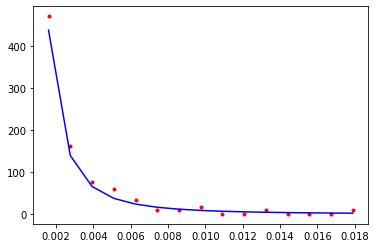

CPU times: user 3.56 ms, sys: 861 µs, total: 4.42 ms
Wall time: 1.5 ms
9232.561213333398


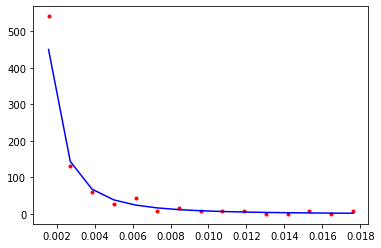

CPU times: user 4.12 ms, sys: 1.06 ms, total: 5.18 ms
Wall time: 1.78 ms
39903.25805722713


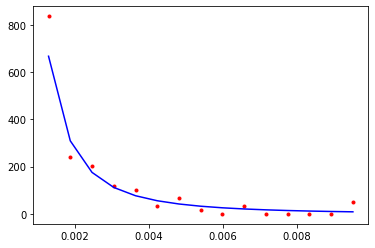

CPU times: user 4.28 ms, sys: 984 µs, total: 5.26 ms
Wall time: 1.78 ms
37066.530656211646


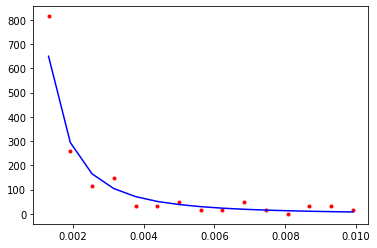

CPU times: user 4.75 ms, sys: 1.15 ms, total: 5.9 ms
Wall time: 2.01 ms
4067.798000638689


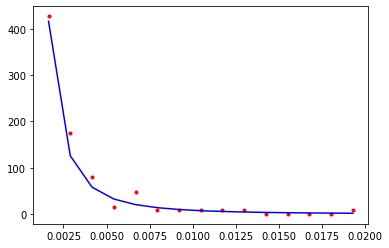

CPU times: user 5.1 ms, sys: 1.17 ms, total: 6.27 ms
Wall time: 2.16 ms
5757.226059502972


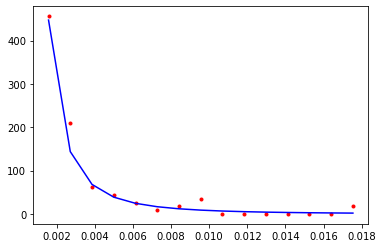

CPU times: user 4.95 ms, sys: 1.37 ms, total: 6.32 ms
Wall time: 2.22 ms
3664.64129822799


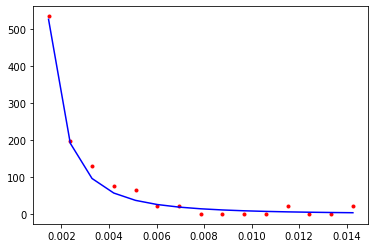

CPU times: user 5.67 ms, sys: 1.17 ms, total: 6.84 ms
Wall time: 2.32 ms
12705.626782435207


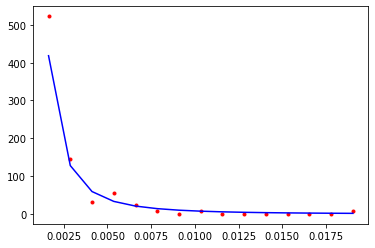

CPU times: user 6.07 ms, sys: 1.48 ms, total: 7.55 ms
Wall time: 2.6 ms
23404.78813961678


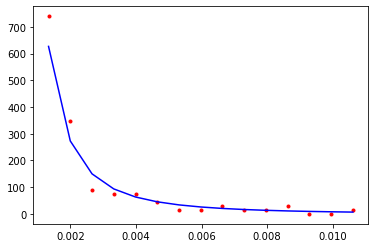

CPU times: user 6.53 ms, sys: 1.29 ms, total: 7.82 ms
Wall time: 2.65 ms
17599.22164556513


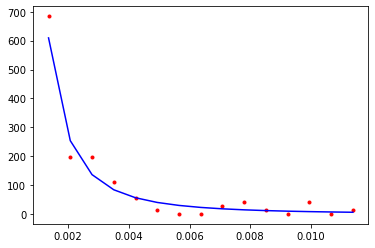

CPU times: user 6.78 ms, sys: 1.23 ms, total: 8 ms
Wall time: 2.68 ms
3104.928756657917


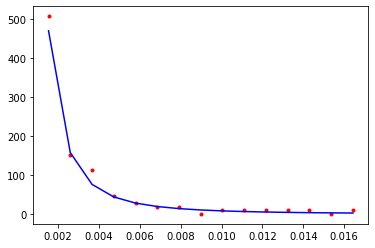

CPU times: user 6.92 ms, sys: 1.34 ms, total: 8.26 ms
Wall time: 2.79 ms
41219.77987195506


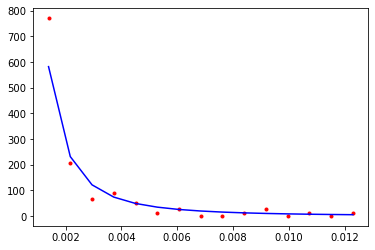

CPU times: user 7.27 ms, sys: 1.17 ms, total: 8.44 ms
Wall time: 2.82 ms
10933.136066387446


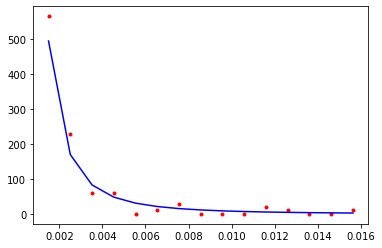

CPU times: user 1.29 ms, sys: 1.38 ms, total: 2.67 ms
Wall time: 862 µs
13574.35034515


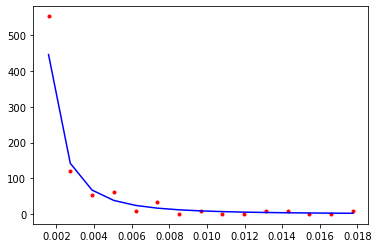

CPU times: user 1.04 ms, sys: 552 µs, total: 1.59 ms
Wall time: 559 µs
12979.32516458356


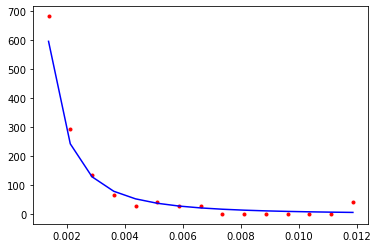

CPU times: user 1.42 ms, sys: 588 µs, total: 2.01 ms
Wall time: 709 µs
6704.420332178864


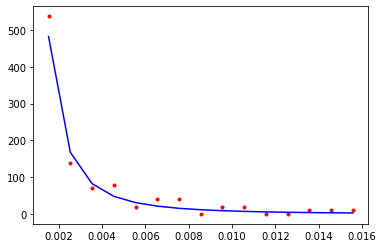

CPU times: user 1.38 ms, sys: 540 µs, total: 1.92 ms
Wall time: 648 µs
10960.268427265071


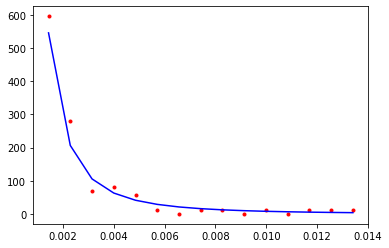

CPU times: user 2.06 ms, sys: 760 µs, total: 2.82 ms
Wall time: 1 ms
7104.179332768642


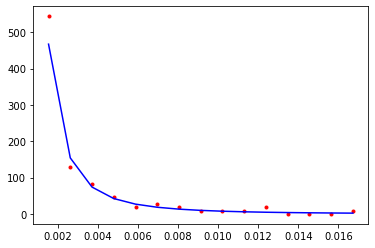

CPU times: user 2.25 ms, sys: 742 µs, total: 2.99 ms
Wall time: 1.03 ms
16221.706856412506


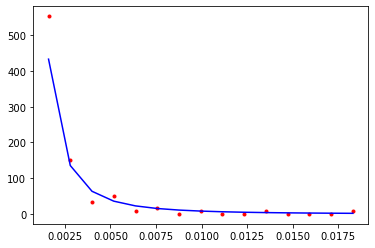

CPU times: user 2.75 ms, sys: 834 µs, total: 3.58 ms
Wall time: 1.24 ms
24584.128035925485


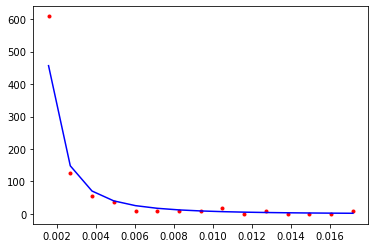

CPU times: user 2.86 ms, sys: 768 µs, total: 3.63 ms
Wall time: 1.24 ms
8956.681572503081


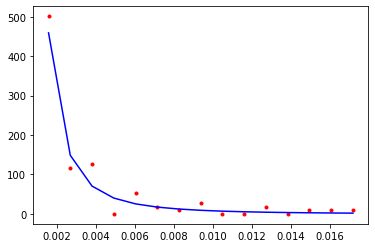

CPU times: user 3.44 ms, sys: 931 µs, total: 4.37 ms
Wall time: 1.51 ms
37483.15743888702


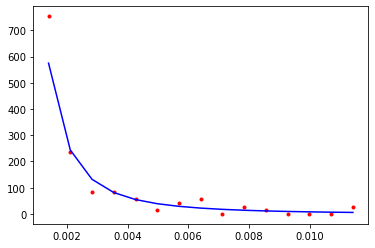

CPU times: user 3.48 ms, sys: 854 µs, total: 4.33 ms
Wall time: 1.5 ms
2091.8761890077676


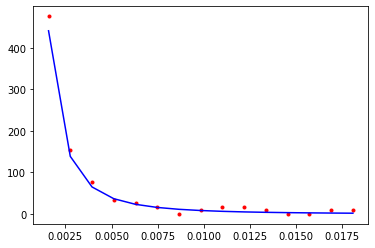

CPU times: user 3.88 ms, sys: 939 µs, total: 4.82 ms
Wall time: 1.64 ms
8631.680583771275


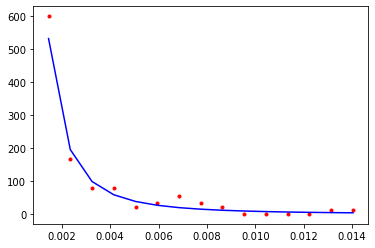

CPU times: user 4.36 ms, sys: 897 µs, total: 5.26 ms
Wall time: 1.77 ms
5819.417303632746


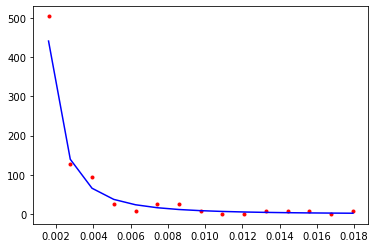

CPU times: user 4.61 ms, sys: 1.04 ms, total: 5.65 ms
Wall time: 1.92 ms
4148.9366718417


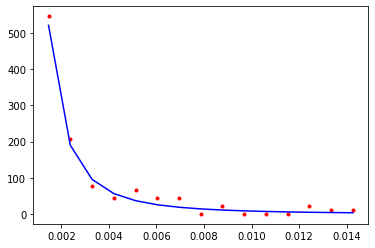

CPU times: user 5.22 ms, sys: 1.11 ms, total: 6.33 ms
Wall time: 2.16 ms
5725.132293072063


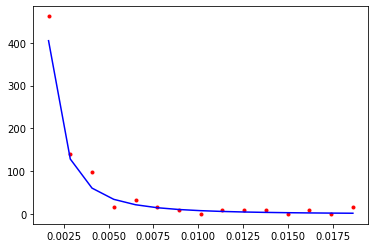

CPU times: user 5.34 ms, sys: 1.12 ms, total: 6.46 ms
Wall time: 2.18 ms
14158.516774203797


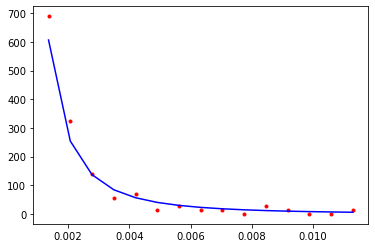

CPU times: user 5.5 ms, sys: 1.37 ms, total: 6.87 ms
Wall time: 2.4 ms
6788.885756896553


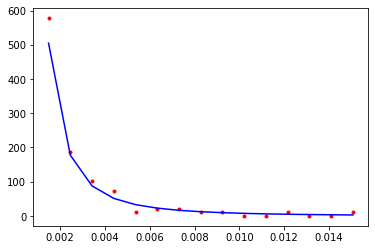

CPU times: user 6.11 ms, sys: 1.19 ms, total: 7.3 ms
Wall time: 2.45 ms
7247.464287372585


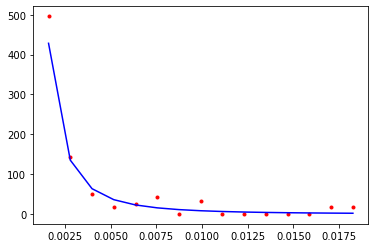

CPU times: user 6.57 ms, sys: 1.28 ms, total: 7.85 ms
Wall time: 2.65 ms
28563.213644177493


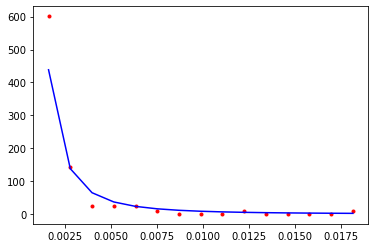

CPU times: user 6.7 ms, sys: 1.24 ms, total: 7.95 ms
Wall time: 2.68 ms
12979.424666146311


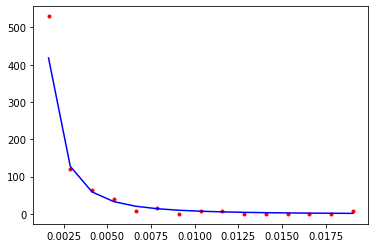

CPU times: user 7.11 ms, sys: 1.34 ms, total: 8.46 ms
Wall time: 2.84 ms
31918.352062899055


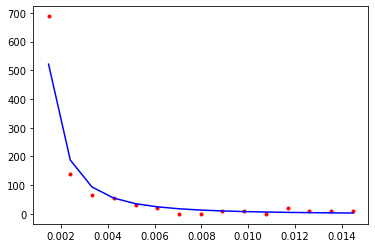

CPU times: user 7.55 ms, sys: 1.38 ms, total: 8.92 ms
Wall time: 3.01 ms
6492.786025914478


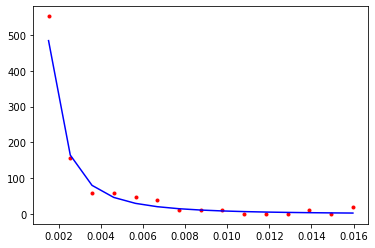

CPU times: user 995 µs, sys: 994 µs, total: 1.99 ms
Wall time: 645 µs
8841.048618498678


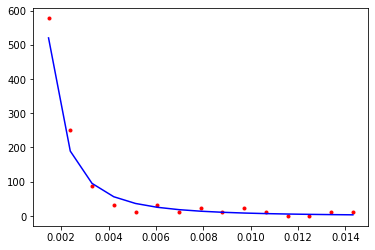

CPU times: user 1.1 ms, sys: 651 µs, total: 1.75 ms
Wall time: 623 µs
32149.209601721213


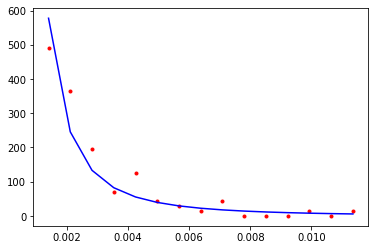

CPU times: user 1.35 ms, sys: 707 µs, total: 2.06 ms
Wall time: 753 µs
3504.556072214691


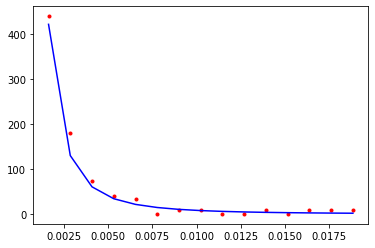

CPU times: user 1.78 ms, sys: 808 µs, total: 2.58 ms
Wall time: 948 µs
16273.907089666804


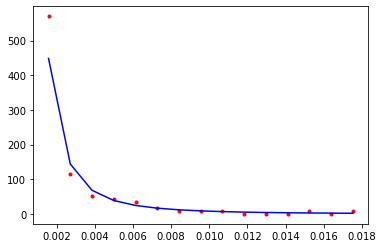

CPU times: user 1.97 ms, sys: 639 µs, total: 2.61 ms
Wall time: 874 µs
42889.221446208474


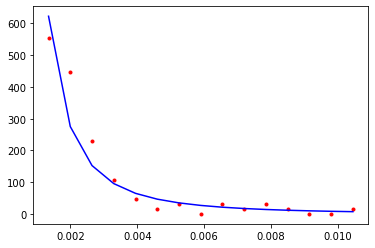

CPU times: user 2.17 ms, sys: 741 µs, total: 2.91 ms
Wall time: 1 ms
21273.628986863067


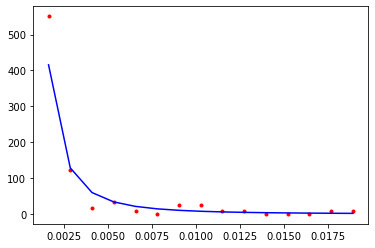

CPU times: user 2.55 ms, sys: 773 µs, total: 3.32 ms
Wall time: 1.13 ms
9850.399705941794


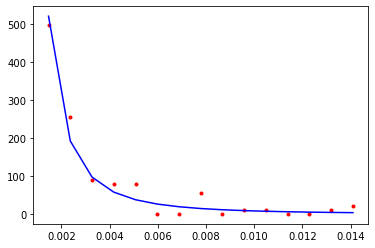

CPU times: user 2.7 ms, sys: 1.01 ms, total: 3.71 ms
Wall time: 1.32 ms
10809.500369280404


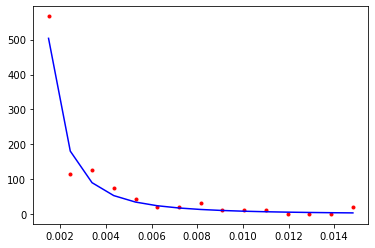

CPU times: user 3.33 ms, sys: 1.07 ms, total: 4.4 ms
Wall time: 1.54 ms
4142.745257750042


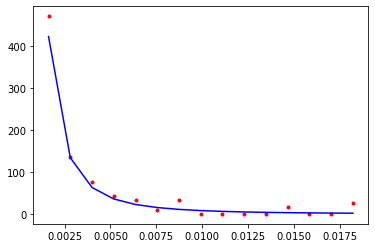

CPU times: user 3.68 ms, sys: 970 µs, total: 4.65 ms
Wall time: 1.6 ms
13070.506394618347


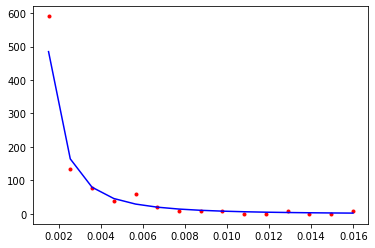

CPU times: user 4.18 ms, sys: 1.02 ms, total: 5.21 ms
Wall time: 1.78 ms
42588.61974352209


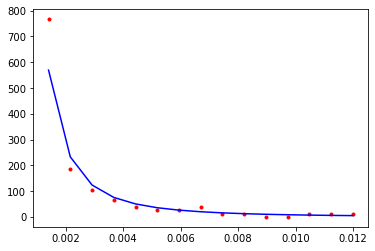

CPU times: user 4.36 ms, sys: 987 µs, total: 5.35 ms
Wall time: 1.81 ms
2264.3195981887593


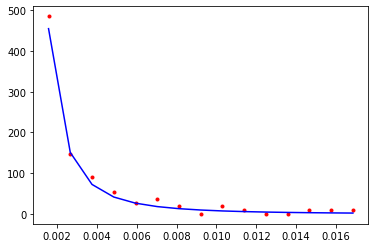

CPU times: user 4.45 ms, sys: 901 µs, total: 5.35 ms
Wall time: 1.81 ms
16831.991239634717


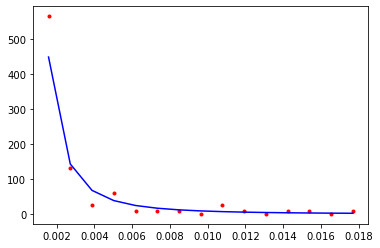

CPU times: user 5.2 ms, sys: 1.2 ms, total: 6.4 ms
Wall time: 2.17 ms
5571.00407042333


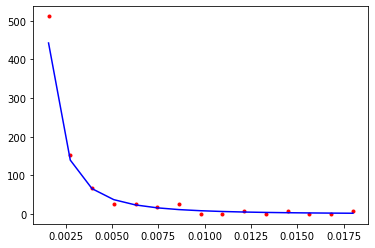

CPU times: user 5.34 ms, sys: 1.14 ms, total: 6.48 ms
Wall time: 2.18 ms
10260.756776067428


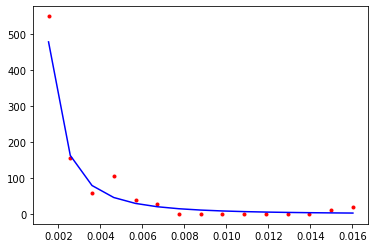

CPU times: user 5.83 ms, sys: 1.24 ms, total: 7.07 ms
Wall time: 2.4 ms
6483.712497672287


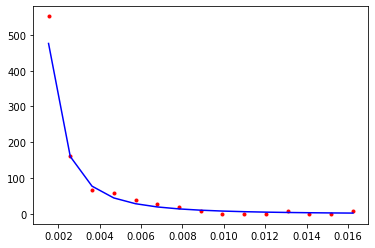

CPU times: user 6.07 ms, sys: 1.36 ms, total: 7.44 ms
Wall time: 2.55 ms
22894.059268479992


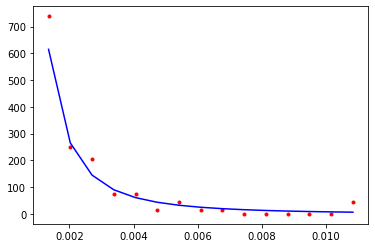

CPU times: user 6.53 ms, sys: 1.27 ms, total: 7.8 ms
Wall time: 2.63 ms
6681.915965263715


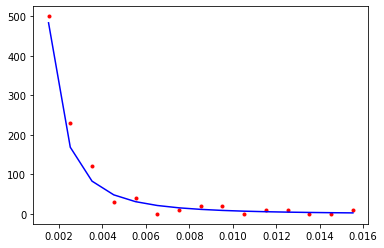

CPU times: user 6.78 ms, sys: 1.46 ms, total: 8.24 ms
Wall time: 2.81 ms
15459.41771947526


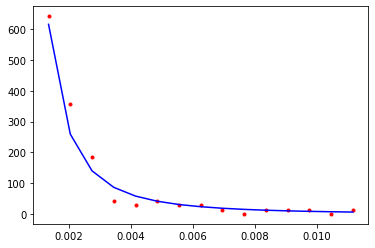

CPU times: user 6.99 ms, sys: 1.52 ms, total: 8.51 ms
Wall time: 2.86 ms
18083.30290162462


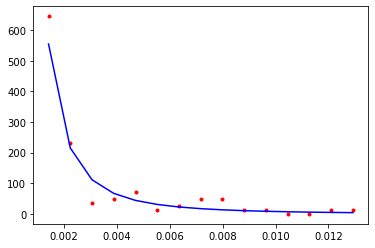

CPU times: user 7.3 ms, sys: 1.32 ms, total: 8.63 ms
Wall time: 2.9 ms
23460.626335279398


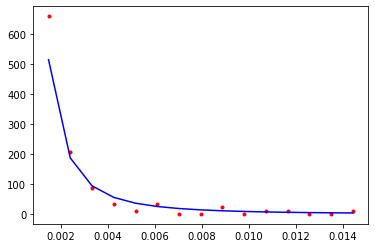

CPU times: user 1.33 ms, sys: 1.26 ms, total: 2.59 ms
Wall time: 849 µs
22071.8519158084


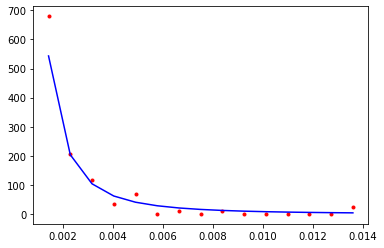

CPU times: user 885 µs, sys: 448 µs, total: 1.33 ms
Wall time: 454 µs
16088.066232167768


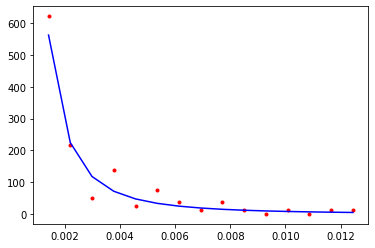

CPU times: user 1.29 ms, sys: 524 µs, total: 1.81 ms
Wall time: 610 µs
4901.74224426217


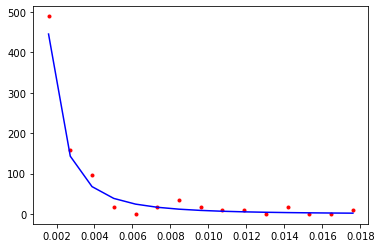

CPU times: user 1.59 ms, sys: 551 µs, total: 2.14 ms
Wall time: 722 µs
30042.41881175468


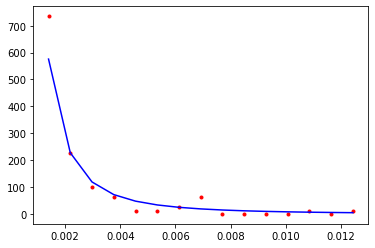

CPU times: user 1.99 ms, sys: 791 µs, total: 2.78 ms
Wall time: 978 µs
12243.66417401215


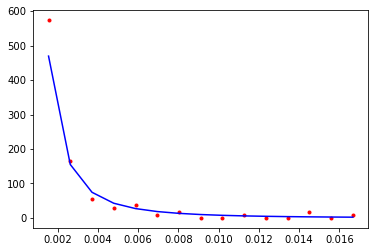

CPU times: user 2.14 ms, sys: 804 µs, total: 2.94 ms
Wall time: 1.03 ms
4557.2161274505925


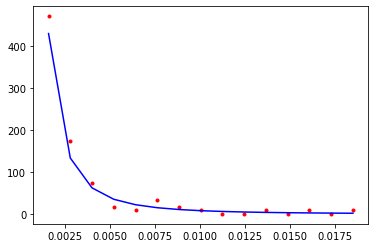

CPU times: user 2.52 ms, sys: 1.05 ms, total: 3.57 ms
Wall time: 1.27 ms
7470.6799077412015


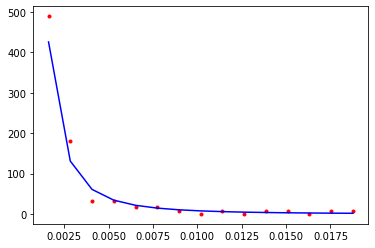

CPU times: user 3.09 ms, sys: 1.09 ms, total: 4.18 ms
Wall time: 1.49 ms
24600.81444050551


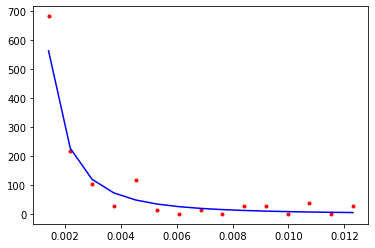

CPU times: user 3.37 ms, sys: 947 µs, total: 4.31 ms
Wall time: 1.5 ms
16359.803044694128


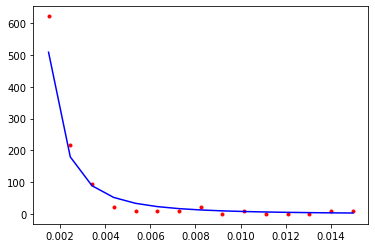

CPU times: user 3.59 ms, sys: 1.03 ms, total: 4.63 ms
Wall time: 1.6 ms
18758.489330353623


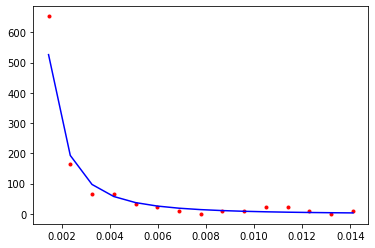

CPU times: user 3.99 ms, sys: 1.08 ms, total: 5.07 ms
Wall time: 1.75 ms
8364.139363052169


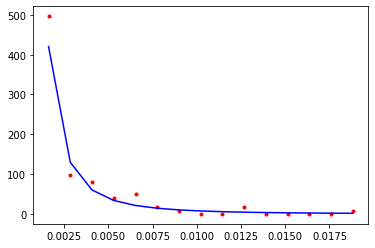

CPU times: user 4.48 ms, sys: 1.1 ms, total: 5.58 ms
Wall time: 1.9 ms
10071.754666215973


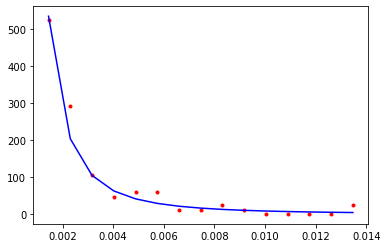

CPU times: user 4.7 ms, sys: 1 ms, total: 5.71 ms
Wall time: 1.92 ms
7745.502816991602


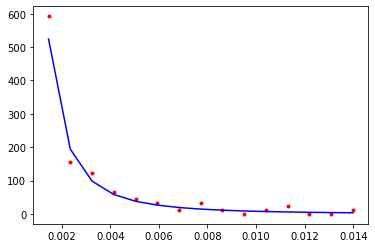

CPU times: user 4.96 ms, sys: 1.31 ms, total: 6.27 ms
Wall time: 2.18 ms
9449.067022613426


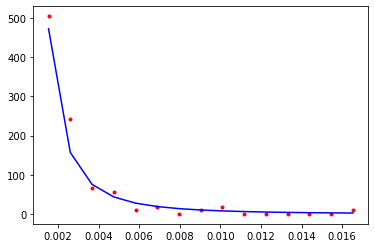

CPU times: user 5.19 ms, sys: 1.27 ms, total: 6.46 ms
Wall time: 2.3 ms
26306.351785865794


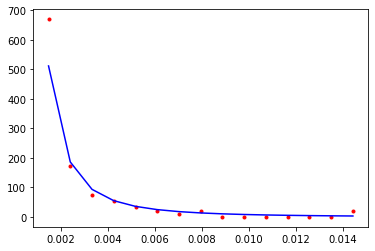

CPU times: user 5.71 ms, sys: 1.19 ms, total: 6.91 ms
Wall time: 2.34 ms
7394.65998646375


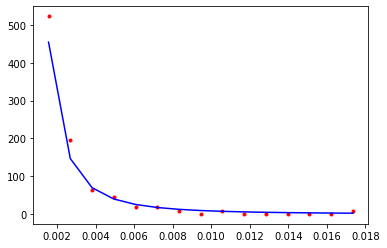

CPU times: user 5.63 ms, sys: 1.61 ms, total: 7.23 ms
Wall time: 2.58 ms
12415.24127267312


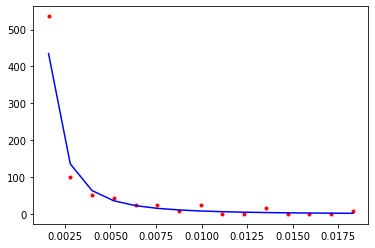

CPU times: user 6.62 ms, sys: 1.35 ms, total: 7.96 ms
Wall time: 2.7 ms
17025.966826483655


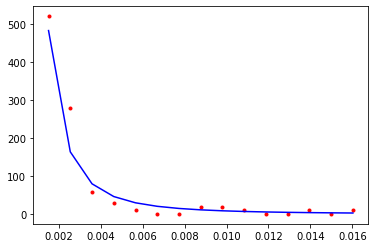

CPU times: user 6.91 ms, sys: 1.38 ms, total: 8.29 ms
Wall time: 2.81 ms
8915.131274944199


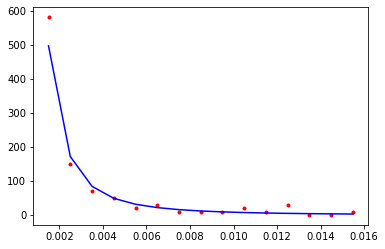

CPU times: user 7.04 ms, sys: 1.71 ms, total: 8.74 ms
Wall time: 3.03 ms
4519.410152163323


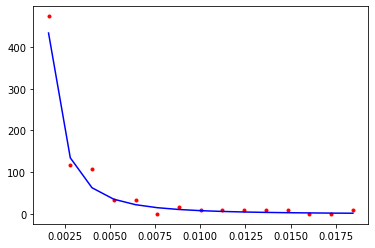

CPU times: user 7.36 ms, sys: 1.53 ms, total: 8.89 ms
Wall time: 3.02 ms
12375.965904059163


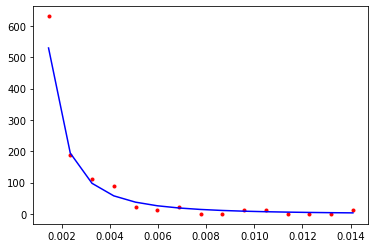

CPU times: user 1.22 ms, sys: 1.13 ms, total: 2.35 ms
Wall time: 775 µs
7399.1886684814635


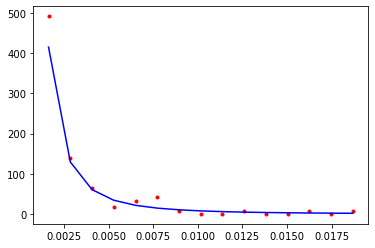

CPU times: user 895 µs, sys: 500 µs, total: 1.39 ms
Wall time: 478 µs
28422.22333825224


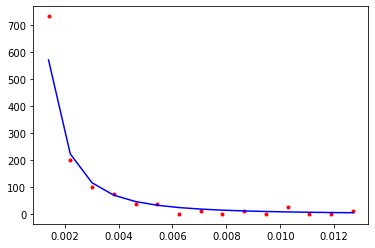

CPU times: user 1.4 ms, sys: 564 µs, total: 1.96 ms
Wall time: 684 µs
3044.061194356805


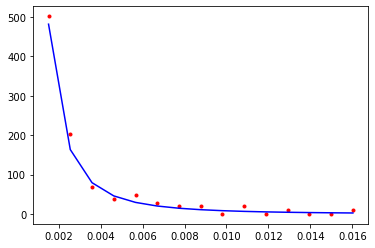

CPU times: user 1.6 ms, sys: 597 µs, total: 2.2 ms
Wall time: 745 µs
8147.893391135352


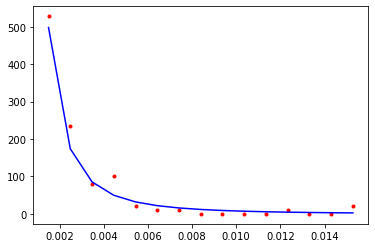

CPU times: user 2.05 ms, sys: 795 µs, total: 2.85 ms
Wall time: 991 µs
6437.155836338822


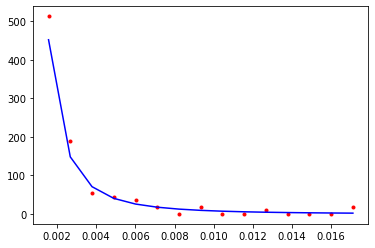

CPU times: user 2.25 ms, sys: 790 µs, total: 3.04 ms
Wall time: 1.06 ms
6650.386074492881


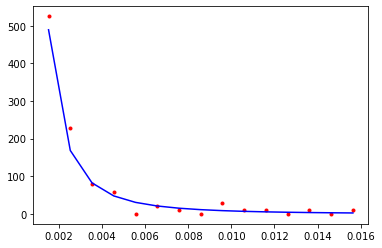

CPU times: user 2.64 ms, sys: 780 µs, total: 3.42 ms
Wall time: 1.17 ms
6823.768510085561


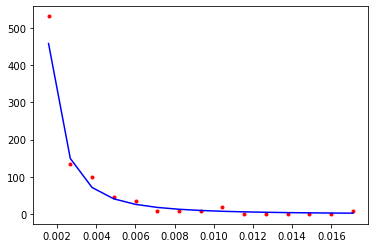

CPU times: user 2.93 ms, sys: 917 µs, total: 3.85 ms
Wall time: 1.33 ms
5742.122263022124


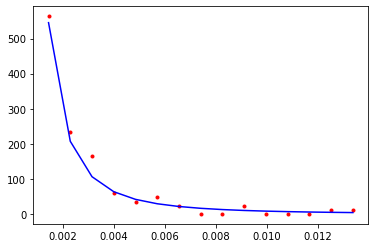

CPU times: user 3.31 ms, sys: 926 µs, total: 4.24 ms
Wall time: 1.45 ms
21851.61761692519


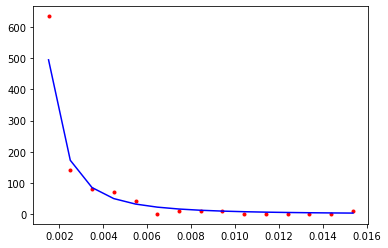

CPU times: user 3.89 ms, sys: 1.01 ms, total: 4.9 ms
Wall time: 1.67 ms
14671.171978379325


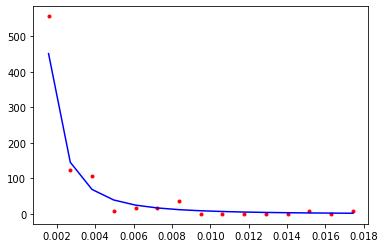

CPU times: user 3.92 ms, sys: 960 µs, total: 4.88 ms
Wall time: 1.67 ms
16441.586570197513


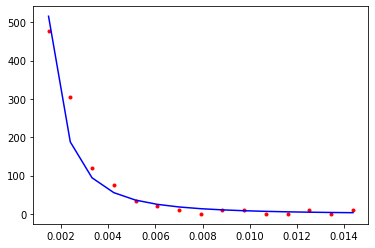

CPU times: user 4.6 ms, sys: 1.04 ms, total: 5.64 ms
Wall time: 1.92 ms
12541.822493730784


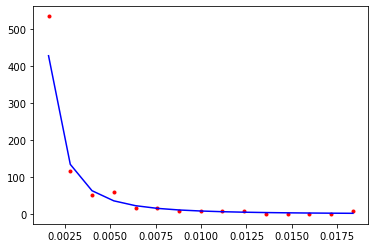

CPU times: user 4.91 ms, sys: 1.15 ms, total: 6.06 ms
Wall time: 2.07 ms
5783.76096013135


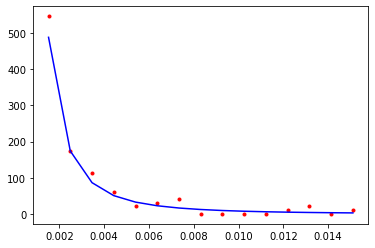

CPU times: user 5.34 ms, sys: 1.34 ms, total: 6.68 ms
Wall time: 2.28 ms
10871.53311680027


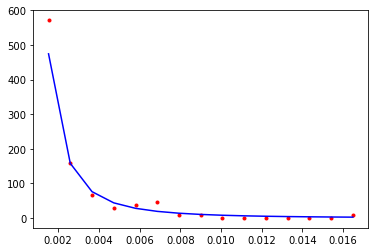

CPU times: user 5.55 ms, sys: 1.25 ms, total: 6.8 ms
Wall time: 2.33 ms
13554.428972091462


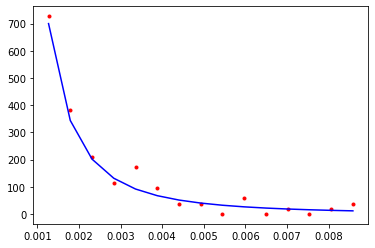

CPU times: user 5.42 ms, sys: 1.39 ms, total: 6.81 ms
Wall time: 2.37 ms
8193.55353655322


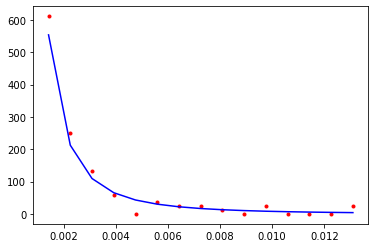

CPU times: user 6.04 ms, sys: 1.13 ms, total: 7.17 ms
Wall time: 2.41 ms
7038.376598855124


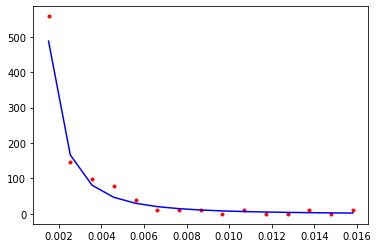

CPU times: user 6.78 ms, sys: 1.33 ms, total: 8.11 ms
Wall time: 2.73 ms
11367.36751242339


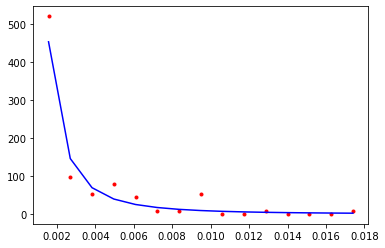

CPU times: user 6.63 ms, sys: 1.46 ms, total: 8.09 ms
Wall time: 2.77 ms
9489.77989512298


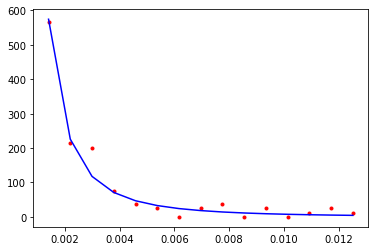

CPU times: user 7.22 ms, sys: 1.59 ms, total: 8.81 ms
Wall time: 3.01 ms
14584.765446646124


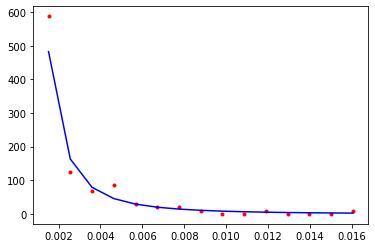

CPU times: user 7.57 ms, sys: 1.55 ms, total: 9.13 ms
Wall time: 3.11 ms
5268.463492536476


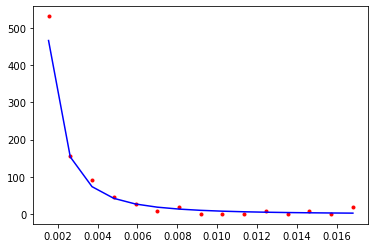

CPU times: user 1.09 ms, sys: 1.09 ms, total: 2.18 ms
Wall time: 722 µs
7490.896252749092


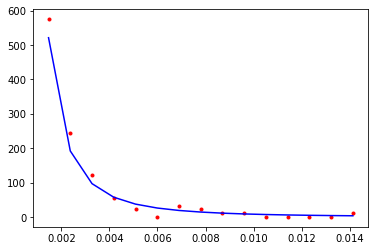

CPU times: user 902 µs, sys: 554 µs, total: 1.46 ms
Wall time: 487 µs
6323.5682236822595


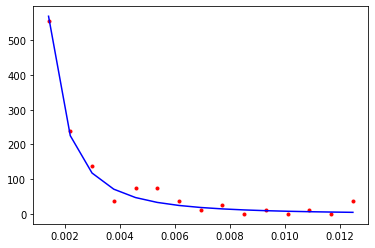

CPU times: user 1.49 ms, sys: 703 µs, total: 2.2 ms
Wall time: 757 µs
7453.377939578956


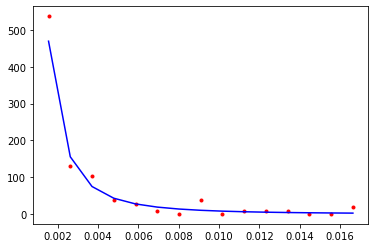

CPU times: user 1.64 ms, sys: 586 µs, total: 2.23 ms
Wall time: 754 µs
7913.574201909866


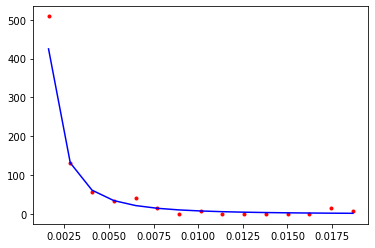

CPU times: user 2 ms, sys: 791 µs, total: 2.79 ms
Wall time: 990 µs
14825.498066197895


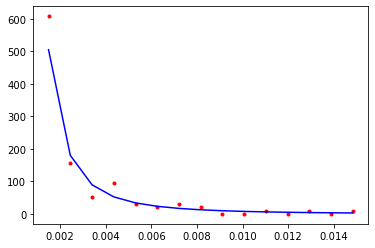

CPU times: user 2.4 ms, sys: 741 µs, total: 3.14 ms
Wall time: 1.08 ms
13240.487225623632


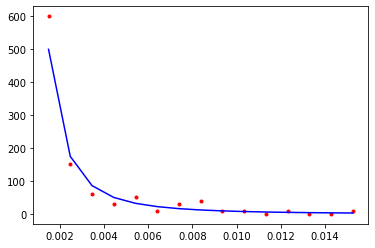

CPU times: user 2.9 ms, sys: 898 µs, total: 3.8 ms
Wall time: 1.3 ms
3588.4617668395526


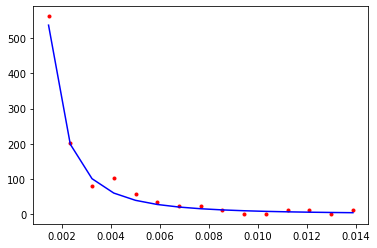

CPU times: user 3.03 ms, sys: 911 µs, total: 3.94 ms
Wall time: 1.36 ms
39242.29908198256


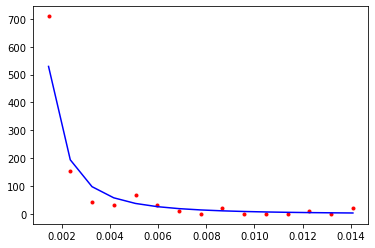

CPU times: user 3.19 ms, sys: 847 µs, total: 4.04 ms
Wall time: 1.4 ms
3771.312050655517


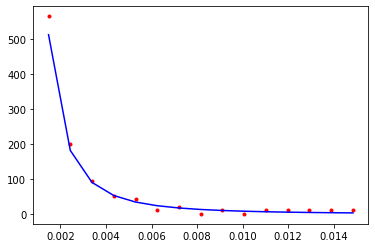

CPU times: user 3.81 ms, sys: 1.02 ms, total: 4.82 ms
Wall time: 1.63 ms
12821.682836068441


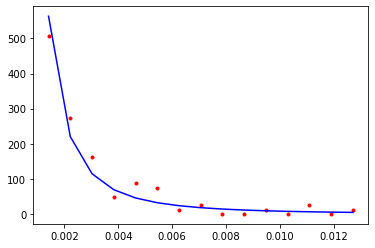

CPU times: user 4.13 ms, sys: 1.01 ms, total: 5.15 ms
Wall time: 1.77 ms
6326.765373168996


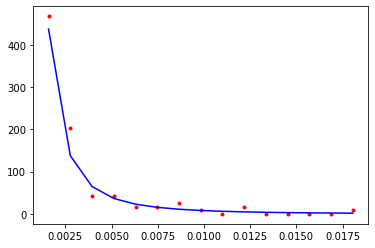

CPU times: user 4.27 ms, sys: 929 µs, total: 5.2 ms
Wall time: 1.76 ms
7328.887418118579


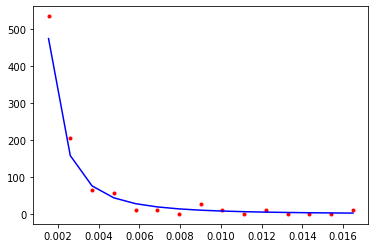

CPU times: user 4.93 ms, sys: 1.15 ms, total: 6.08 ms
Wall time: 2.06 ms
8866.942243760437


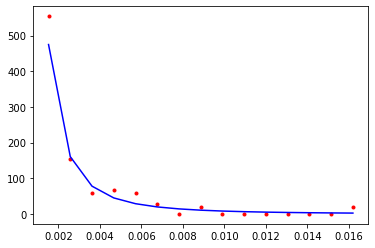

CPU times: user 4.98 ms, sys: 1.05 ms, total: 6.02 ms
Wall time: 2.04 ms
15708.621378799447


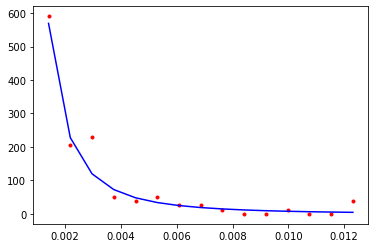

CPU times: user 5.43 ms, sys: 1.13 ms, total: 6.57 ms
Wall time: 2.21 ms
5737.3990140527085


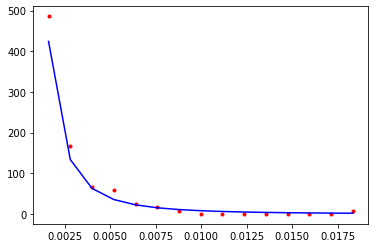

CPU times: user 6.49 ms, sys: 1.26 ms, total: 7.75 ms
Wall time: 2.61 ms
15129.452520232102


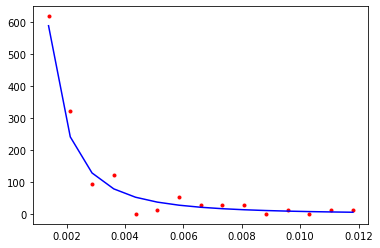

CPU times: user 6.07 ms, sys: 1.18 ms, total: 7.25 ms
Wall time: 2.45 ms
14041.852376327208


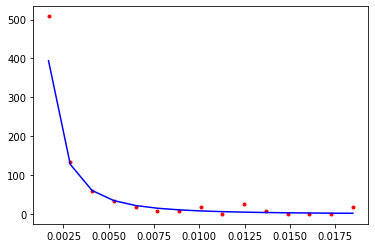

CPU times: user 6.35 ms, sys: 1.25 ms, total: 7.6 ms
Wall time: 2.56 ms
10479.81616483087


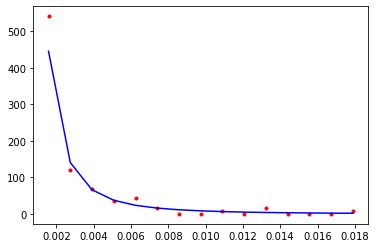

CPU times: user 6.7 ms, sys: 1.32 ms, total: 8.02 ms
Wall time: 2.7 ms
6892.183974512429


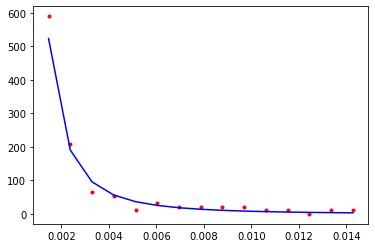

CPU times: user 7.1 ms, sys: 1.28 ms, total: 8.38 ms
Wall time: 2.82 ms
10930.56450819042


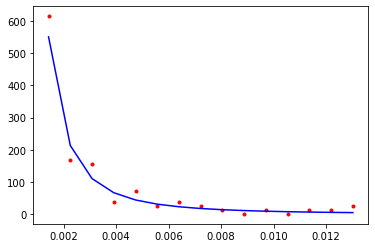

CPU times: user 7.39 ms, sys: 1.41 ms, total: 8.79 ms
Wall time: 2.97 ms
27818.256595156592


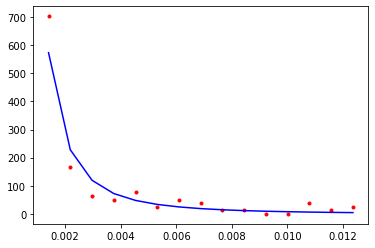

CPU times: user 1.3 ms, sys: 1.26 ms, total: 2.56 ms
Wall time: 851 µs
5791.423959073267


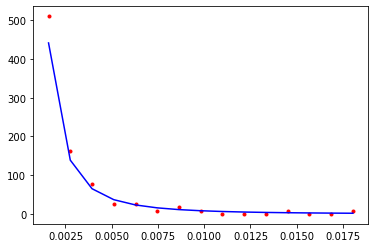

CPU times: user 1.23 ms, sys: 718 µs, total: 1.94 ms
Wall time: 686 µs
12683.322363702977


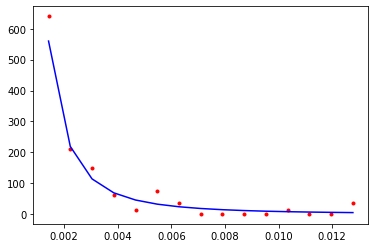

CPU times: user 1.24 ms, sys: 494 µs, total: 1.73 ms
Wall time: 578 µs
15108.629137537218


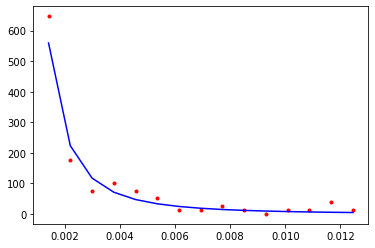

CPU times: user 1.57 ms, sys: 553 µs, total: 2.12 ms
Wall time: 714 µs
7197.387041543977


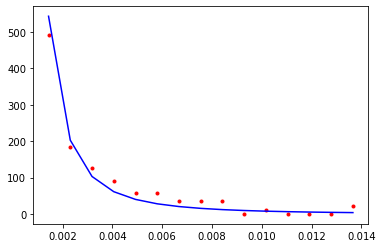

CPU times: user 1.95 ms, sys: 659 µs, total: 2.61 ms
Wall time: 867 µs
35378.31906220837


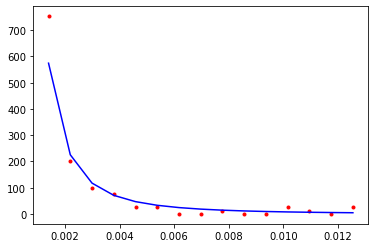

CPU times: user 2.17 ms, sys: 717 µs, total: 2.88 ms
Wall time: 993 µs
3097.9069080556574


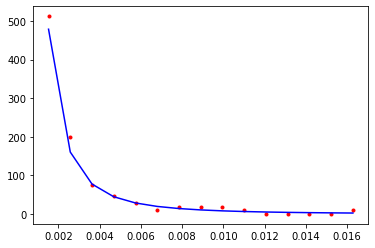

CPU times: user 2.59 ms, sys: 787 µs, total: 3.38 ms
Wall time: 1.16 ms
12686.635413326589


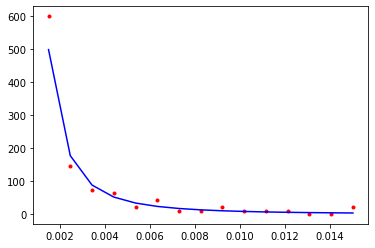

CPU times: user 3 ms, sys: 956 µs, total: 3.95 ms
Wall time: 1.38 ms
20685.7234008658


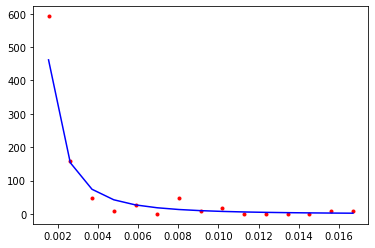

CPU times: user 3.5 ms, sys: 957 µs, total: 4.45 ms
Wall time: 1.53 ms
6301.814836176881


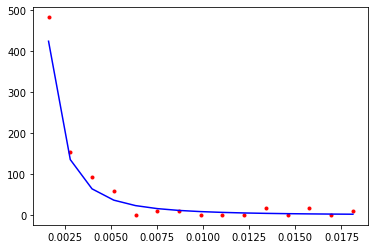

CPU times: user 3.66 ms, sys: 874 µs, total: 4.54 ms
Wall time: 1.53 ms
6838.311035740114


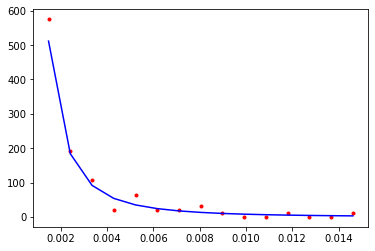

CPU times: user 3.91 ms, sys: 885 µs, total: 4.8 ms
Wall time: 1.62 ms
17169.678265775965


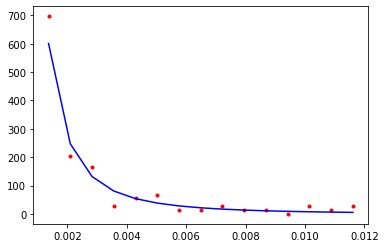

CPU times: user 4.46 ms, sys: 1.09 ms, total: 5.55 ms
Wall time: 1.9 ms
9383.770308402765


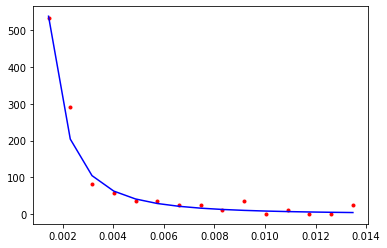

CPU times: user 4.81 ms, sys: 1.35 ms, total: 6.16 ms
Wall time: 2.14 ms
20675.51857953364


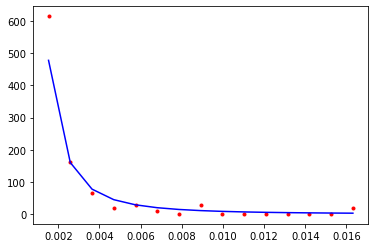

CPU times: user 4.98 ms, sys: 1.03 ms, total: 6.01 ms
Wall time: 2.02 ms
13188.233505296454


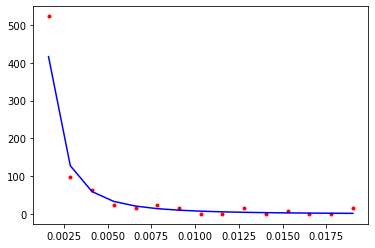

CPU times: user 5.27 ms, sys: 1.14 ms, total: 6.4 ms
Wall time: 2.16 ms
20009.12116691463


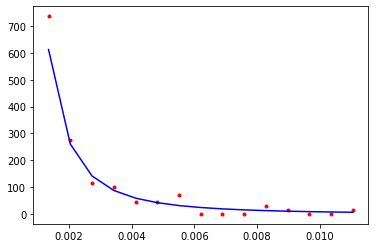

CPU times: user 5.69 ms, sys: 1.19 ms, total: 6.88 ms
Wall time: 2.33 ms
8133.699562711058


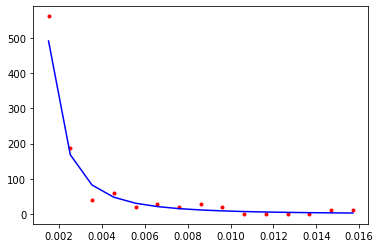

CPU times: user 5.98 ms, sys: 1.2 ms, total: 7.18 ms
Wall time: 2.43 ms
10858.472271426113


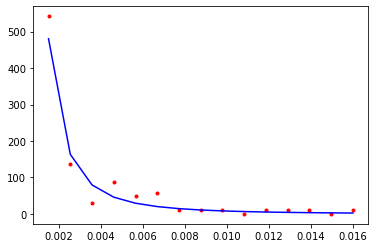

CPU times: user 6.27 ms, sys: 1.87 ms, total: 8.14 ms
Wall time: 2.94 ms
4686.300284963282


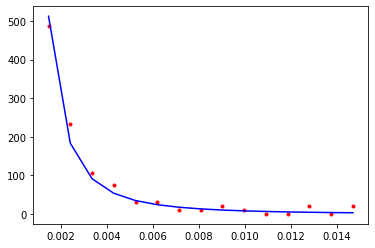

CPU times: user 6.32 ms, sys: 1.69 ms, total: 8.01 ms
Wall time: 2.88 ms
8442.909697679544


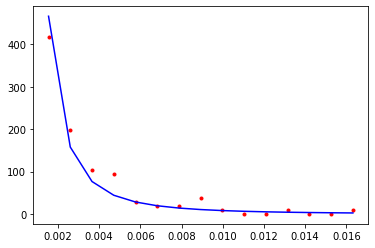

CPU times: user 7.3 ms, sys: 1.41 ms, total: 8.71 ms
Wall time: 2.94 ms
6160.178409015332


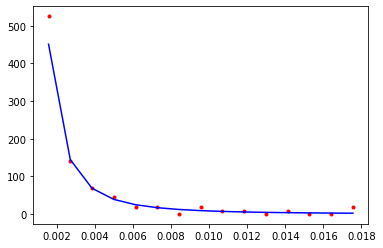

CPU times: user 7.69 ms, sys: 1.49 ms, total: 9.18 ms
Wall time: 3.08 ms
67305.03181673471


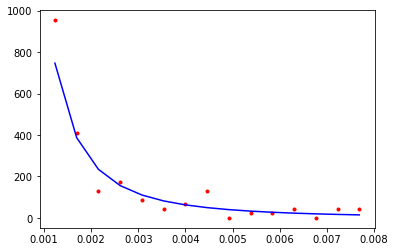

CPU times: user 1.31 ms, sys: 1.19 ms, total: 2.5 ms
Wall time: 824 µs
4781.634476622695


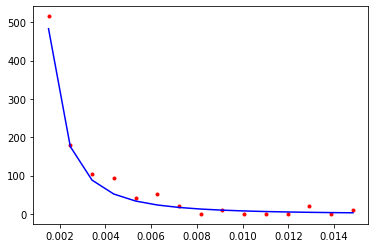

CPU times: user 869 µs, sys: 410 µs, total: 1.28 ms
Wall time: 423 µs
16112.742055623929


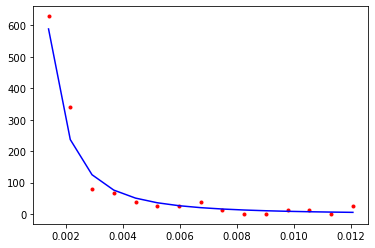

CPU times: user 1.41 ms, sys: 624 µs, total: 2.03 ms
Wall time: 711 µs
5145.031698249975


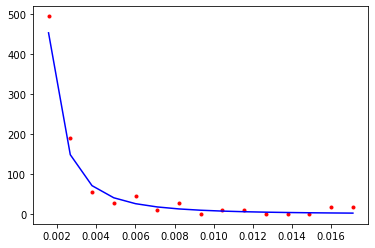

CPU times: user 1.72 ms, sys: 694 µs, total: 2.42 ms
Wall time: 851 µs
4177.213865674989


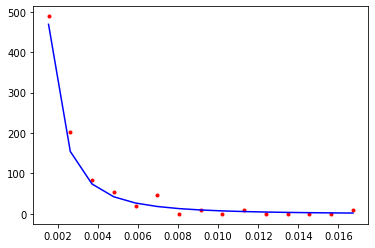

CPU times: user 1.92 ms, sys: 689 µs, total: 2.61 ms
Wall time: 882 µs
9758.904857792719


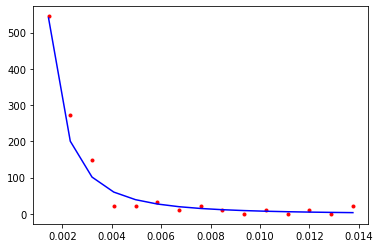

CPU times: user 2.06 ms, sys: 655 µs, total: 2.72 ms
Wall time: 957 µs
26862.320684097427


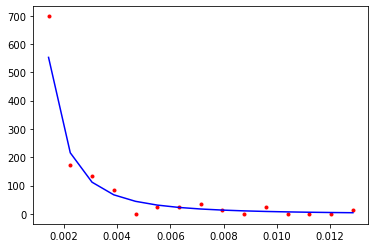

CPU times: user 2.67 ms, sys: 879 µs, total: 3.55 ms
Wall time: 1.24 ms
6768.875679260789


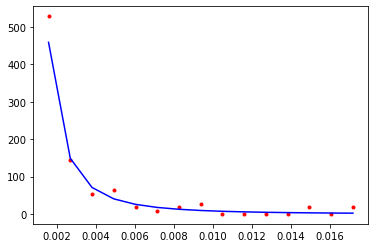

CPU times: user 2.9 ms, sys: 785 µs, total: 3.68 ms
Wall time: 1.26 ms
8813.186528734886


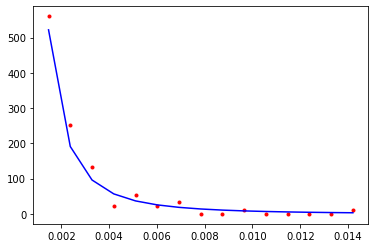

CPU times: user 3.52 ms, sys: 917 µs, total: 4.43 ms
Wall time: 1.52 ms
8656.85846124387


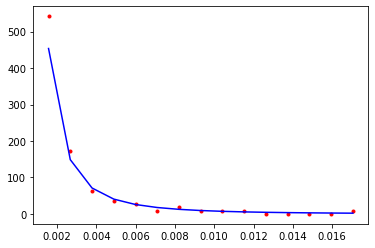

CPU times: user 3.55 ms, sys: 868 µs, total: 4.42 ms
Wall time: 1.51 ms
3765.636496468754


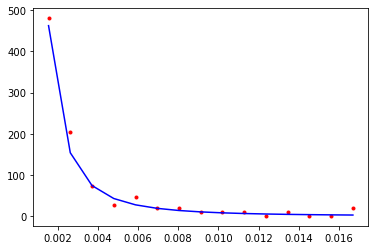

CPU times: user 3.95 ms, sys: 908 µs, total: 4.86 ms
Wall time: 1.63 ms
17507.524302441623


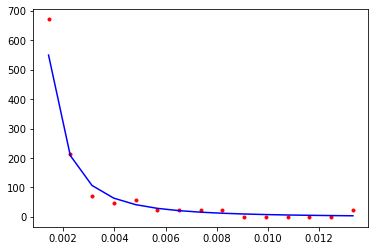

CPU times: user 4.12 ms, sys: 866 µs, total: 4.98 ms
Wall time: 1.67 ms
10859.788027212417


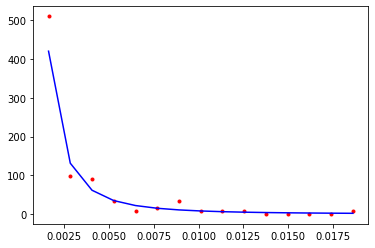

CPU times: user 4.64 ms, sys: 976 µs, total: 5.62 ms
Wall time: 1.89 ms
4094.7694638675544


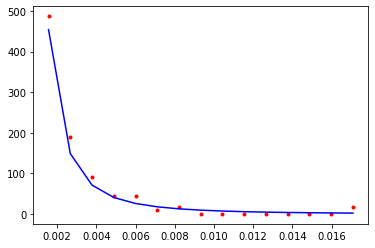

CPU times: user 4.93 ms, sys: 1.03 ms, total: 5.96 ms
Wall time: 2.01 ms
4914.174603340899


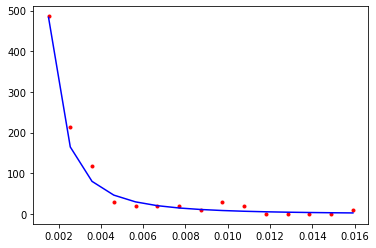

CPU times: user 5.29 ms, sys: 1.16 ms, total: 6.45 ms
Wall time: 2.19 ms
19566.22562076901


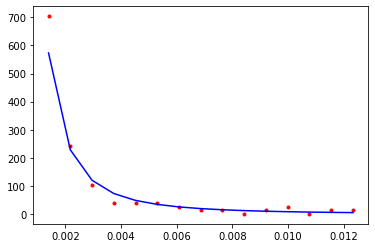

CPU times: user 5.89 ms, sys: 1.26 ms, total: 7.15 ms
Wall time: 2.43 ms
5764.055029397091


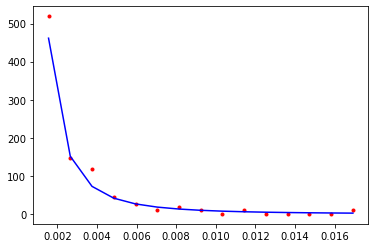

CPU times: user 6.04 ms, sys: 1.25 ms, total: 7.29 ms
Wall time: 2.46 ms
3465.5189397351664


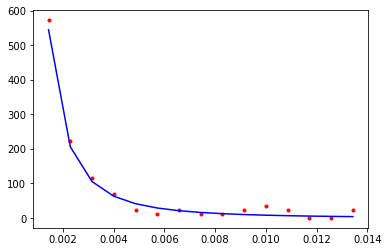

CPU times: user 6.61 ms, sys: 1.39 ms, total: 8 ms
Wall time: 2.7 ms
4799.03338851122


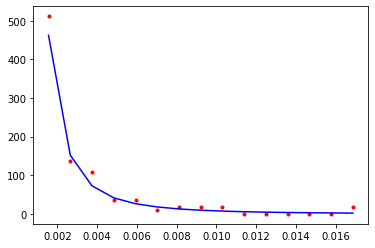

CPU times: user 6.82 ms, sys: 1.36 ms, total: 8.18 ms
Wall time: 2.75 ms
13091.98640453152


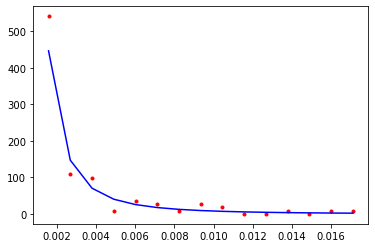

CPU times: user 7.12 ms, sys: 1.33 ms, total: 8.45 ms
Wall time: 2.84 ms
10352.17045756022


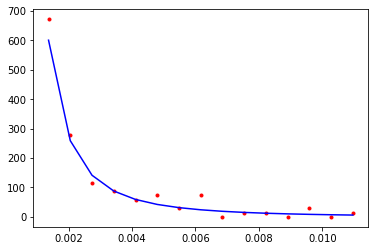

CPU times: user 7.35 ms, sys: 1.3 ms, total: 8.65 ms
Wall time: 2.91 ms
6188.18884252081


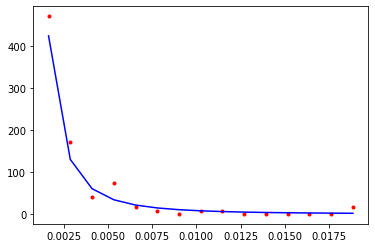

CPU times: user 1.26 ms, sys: 1.15 ms, total: 2.41 ms
Wall time: 807 µs
26503.716706324896


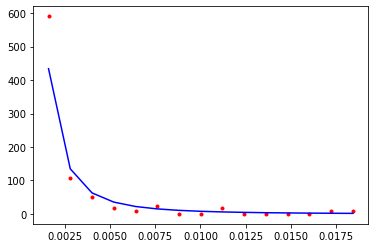

CPU times: user 906 µs, sys: 565 µs, total: 1.47 ms
Wall time: 2.56 ms
9548.927480785811


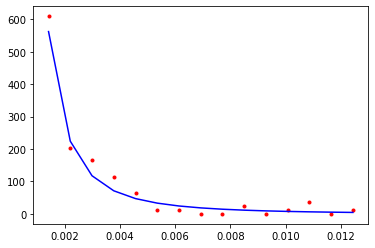

CPU times: user 1.3 ms, sys: 560 µs, total: 1.86 ms
Wall time: 633 µs
8403.474212232788


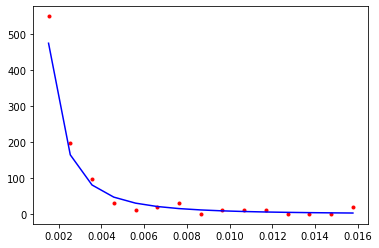

CPU times: user 1.78 ms, sys: 673 µs, total: 2.45 ms
Wall time: 858 µs
22925.556377568366


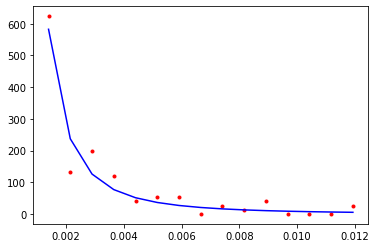

CPU times: user 2.05 ms, sys: 722 µs, total: 2.77 ms
Wall time: 965 µs
6487.952913861255


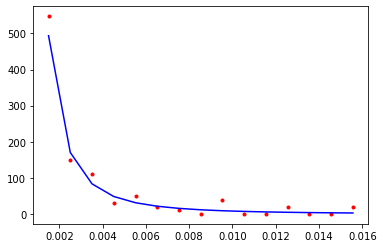

CPU times: user 2.2 ms, sys: 737 µs, total: 2.93 ms
Wall time: 1.01 ms
15639.371386980823


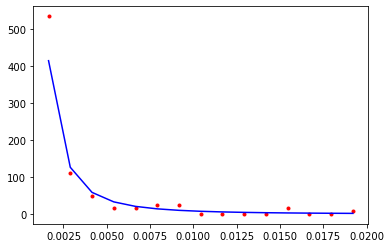

CPU times: user 2.49 ms, sys: 723 µs, total: 3.21 ms
Wall time: 1.11 ms
15196.471501978505


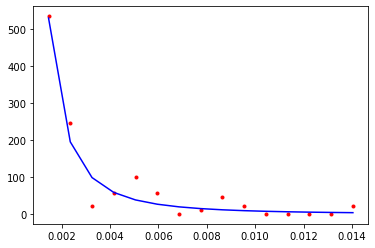

CPU times: user 2.68 ms, sys: 790 µs, total: 3.47 ms
Wall time: 1.19 ms
5565.65937905199


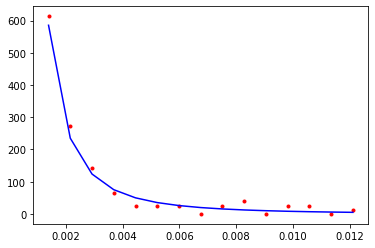

CPU times: user 3.21 ms, sys: 897 µs, total: 4.11 ms
Wall time: 1.41 ms
11456.585978201496


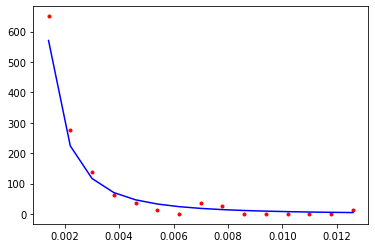

CPU times: user 3.62 ms, sys: 939 µs, total: 4.56 ms
Wall time: 1.55 ms
7657.835923969915


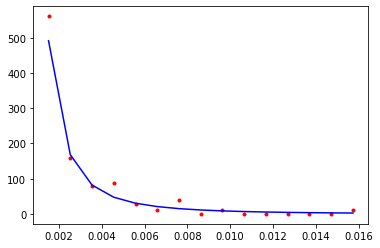

CPU times: user 3.96 ms, sys: 982 µs, total: 4.95 ms
Wall time: 1.69 ms
14455.485879415644


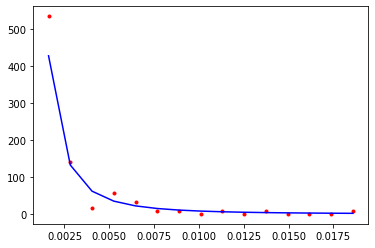

CPU times: user 4.54 ms, sys: 1.04 ms, total: 5.58 ms
Wall time: 1.89 ms
8794.821488577283


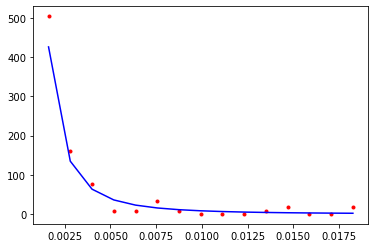

CPU times: user 4.49 ms, sys: 1 ms, total: 5.49 ms
Wall time: 1.88 ms
4824.966796192177


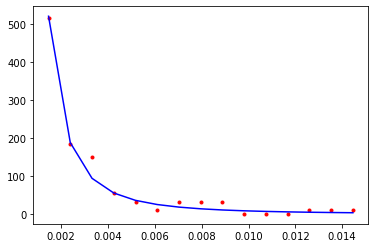

CPU times: user 5.18 ms, sys: 1.09 ms, total: 6.27 ms
Wall time: 2.12 ms
21510.675713714543


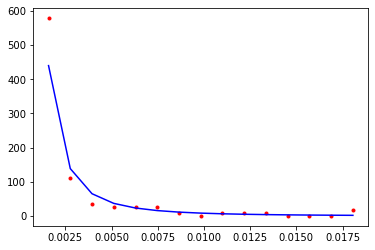

CPU times: user 5.33 ms, sys: 1.09 ms, total: 6.42 ms
Wall time: 2.16 ms
2764.7925177062752


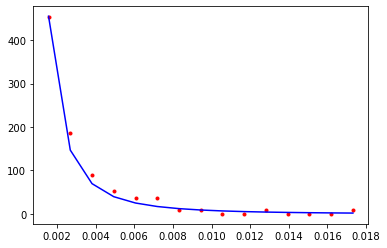

CPU times: user 5.88 ms, sys: 1.36 ms, total: 7.24 ms
Wall time: 2.46 ms
23653.34843545757


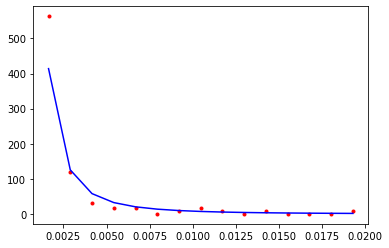

CPU times: user 6.06 ms, sys: 1.23 ms, total: 7.29 ms
Wall time: 2.45 ms
4149.751303994687


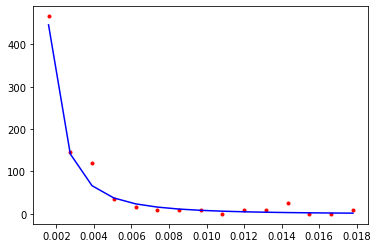

CPU times: user 6.64 ms, sys: 1.28 ms, total: 7.92 ms
Wall time: 2.65 ms
8441.980643732806


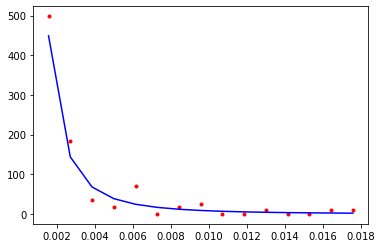

CPU times: user 6.8 ms, sys: 1.29 ms, total: 8.09 ms
Wall time: 2.72 ms
3705.7451127514123


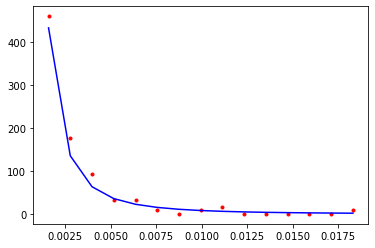

CPU times: user 7.03 ms, sys: 1.3 ms, total: 8.34 ms
Wall time: 2.81 ms
21100.645947182566


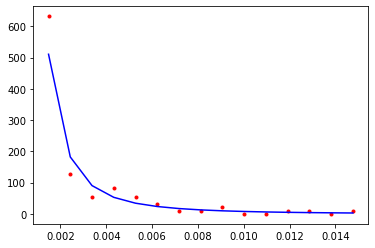

CPU times: user 7.64 ms, sys: 1.52 ms, total: 9.16 ms
Wall time: 3.08 ms
33112.440066678704


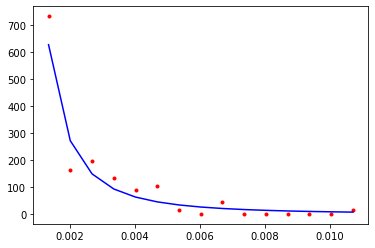

CPU times: user 1.33 ms, sys: 1.22 ms, total: 2.55 ms
Wall time: 826 µs
6294.258265231724


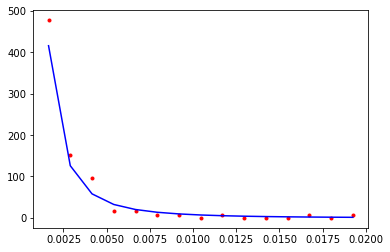

CPU times: user 909 µs, sys: 459 µs, total: 1.37 ms
Wall time: 468 µs
6434.130077261535


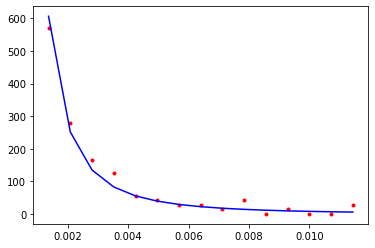

CPU times: user 1.43 ms, sys: 601 µs, total: 2.03 ms
Wall time: 713 µs
8937.8797297818


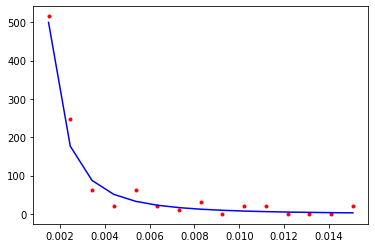

CPU times: user 1.58 ms, sys: 561 µs, total: 2.14 ms
Wall time: 721 µs
28333.571160695206


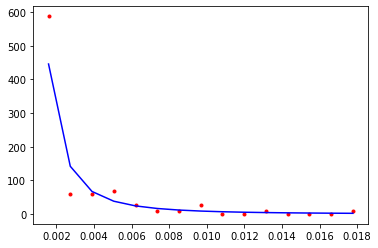

CPU times: user 1.98 ms, sys: 829 µs, total: 2.81 ms
Wall time: 996 µs
11153.865772658837


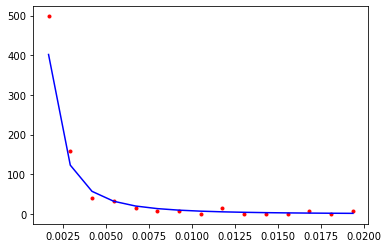

CPU times: user 2.13 ms, sys: 651 µs, total: 2.78 ms
Wall time: 957 µs
16332.603126135107


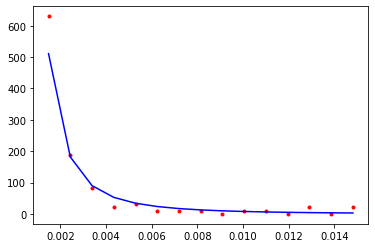

CPU times: user 2.55 ms, sys: 810 µs, total: 3.36 ms
Wall time: 1.15 ms
6436.2008070399515


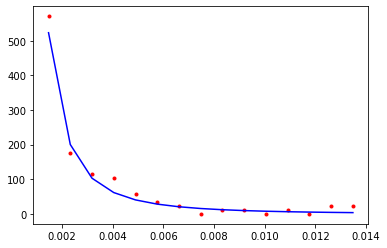

CPU times: user 2.86 ms, sys: 812 µs, total: 3.67 ms
Wall time: 1.25 ms
22783.970684503656


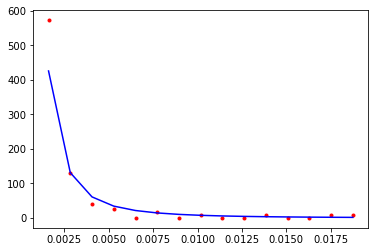

CPU times: user 3.23 ms, sys: 872 µs, total: 4.11 ms
Wall time: 1.4 ms
7692.650268493344


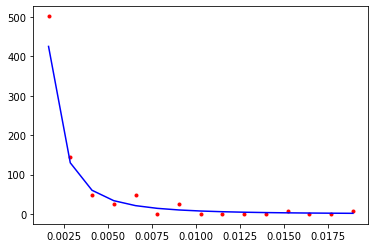

CPU times: user 3.34 ms, sys: 910 µs, total: 4.25 ms
Wall time: 1.46 ms
9929.964684458639


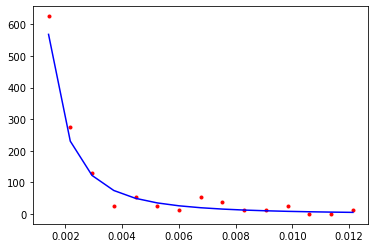

CPU times: user 3.81 ms, sys: 892 µs, total: 4.7 ms
Wall time: 1.63 ms
7962.811030039653


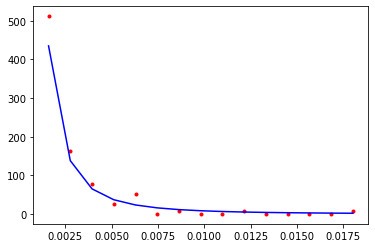

CPU times: user 4.48 ms, sys: 1.09 ms, total: 5.57 ms
Wall time: 1.92 ms
15648.415843663435


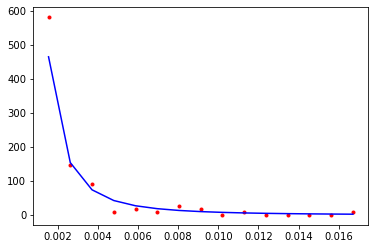

CPU times: user 4.62 ms, sys: 1.08 ms, total: 5.7 ms
Wall time: 1.93 ms
18395.766940029924


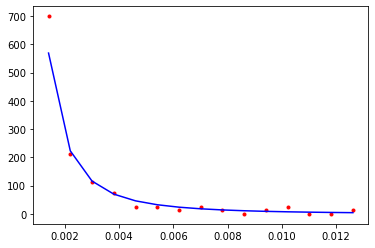

CPU times: user 5.15 ms, sys: 1.12 ms, total: 6.27 ms
Wall time: 2.13 ms
33701.00469533165


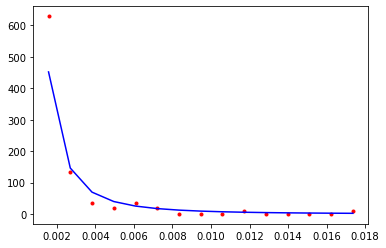

CPU times: user 5.34 ms, sys: 1.08 ms, total: 6.42 ms
Wall time: 2.15 ms
3929.8198305920123


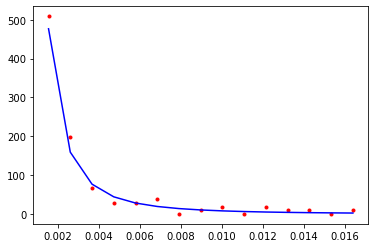

CPU times: user 5.77 ms, sys: 1.14 ms, total: 6.9 ms
Wall time: 2.32 ms
6562.42647612706


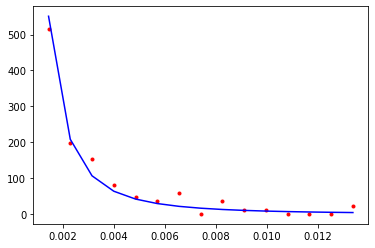

CPU times: user 6.18 ms, sys: 1.32 ms, total: 7.5 ms
Wall time: 2.55 ms
18858.903112219552


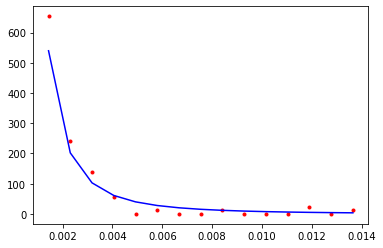

CPU times: user 6.32 ms, sys: 1.17 ms, total: 7.48 ms
Wall time: 2.52 ms
39310.2746850409


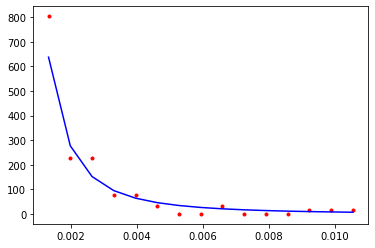

CPU times: user 6.81 ms, sys: 1.26 ms, total: 8.07 ms
Wall time: 2.71 ms
13859.82472337594


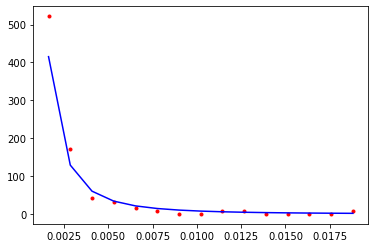

CPU times: user 7.06 ms, sys: 1.36 ms, total: 8.42 ms
Wall time: 2.84 ms
23127.945851629178


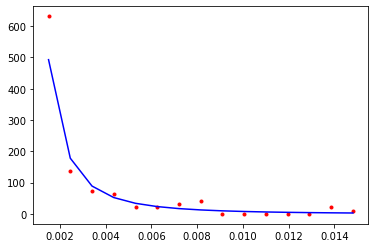

CPU times: user 7.53 ms, sys: 1.32 ms, total: 8.85 ms
Wall time: 2.96 ms
4540.2294588493205


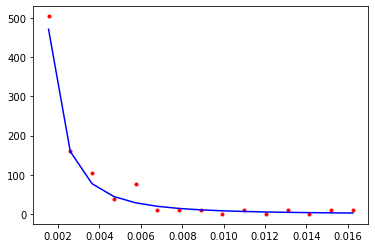

CPU times: user 1.06 ms, sys: 1.08 ms, total: 2.15 ms
Wall time: 711 µs
5537.664868518579


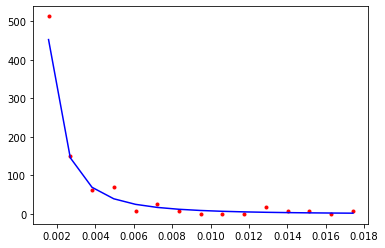

CPU times: user 1.03 ms, sys: 622 µs, total: 1.65 ms
Wall time: 579 µs
16426.601450932256


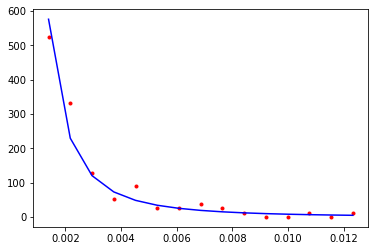

CPU times: user 1.45 ms, sys: 656 µs, total: 2.11 ms
Wall time: 731 µs
6142.1970027396155


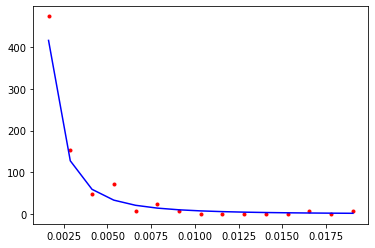

CPU times: user 1.6 ms, sys: 554 µs, total: 2.15 ms
Wall time: 727 µs
30391.334732746276


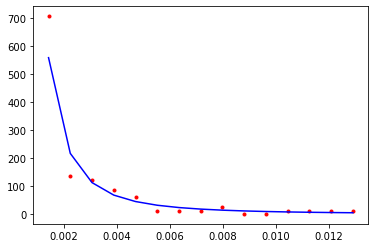

CPU times: user 1.92 ms, sys: 596 µs, total: 2.52 ms
Wall time: 846 µs
16879.689372062858


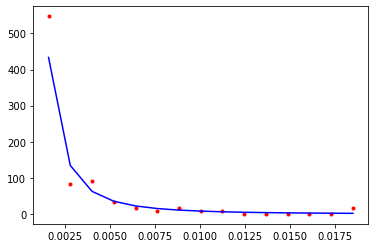

CPU times: user 2.17 ms, sys: 722 µs, total: 2.89 ms
Wall time: 989 µs
34052.82327427743


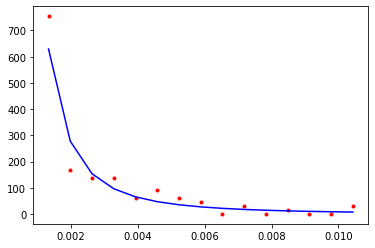

CPU times: user 2.6 ms, sys: 731 µs, total: 3.33 ms
Wall time: 1.13 ms
10316.006359411896


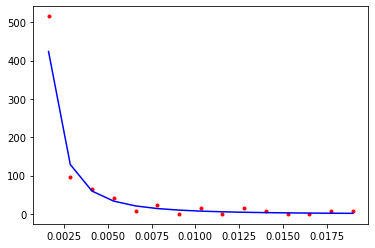

CPU times: user 2.89 ms, sys: 755 µs, total: 3.64 ms
Wall time: 1.23 ms
27105.155209020224


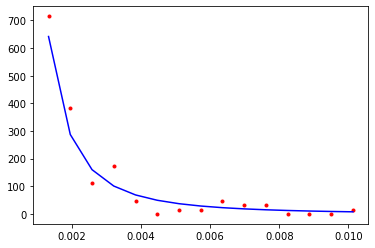

CPU times: user 3.45 ms, sys: 932 µs, total: 4.38 ms
Wall time: 1.5 ms
6250.673863465482


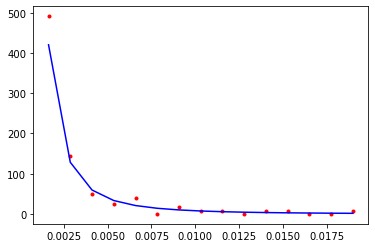

CPU times: user 3.69 ms, sys: 985 µs, total: 4.68 ms
Wall time: 1.61 ms
6432.495092109091


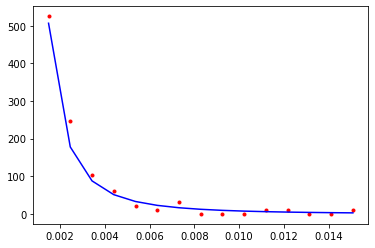

CPU times: user 3.91 ms, sys: 888 µs, total: 4.8 ms
Wall time: 1.62 ms
6459.064090836634


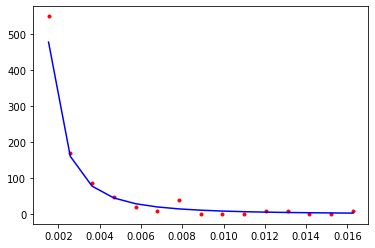

CPU times: user 4.32 ms, sys: 945 µs, total: 5.26 ms
Wall time: 1.78 ms
21697.137553432072


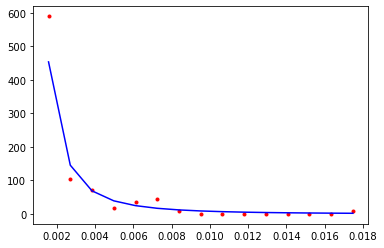

CPU times: user 4.57 ms, sys: 1.05 ms, total: 5.62 ms
Wall time: 1.92 ms
15238.348447569348


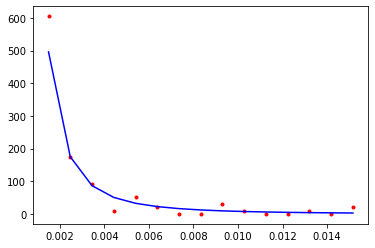

CPU times: user 5.19 ms, sys: 1.17 ms, total: 6.36 ms
Wall time: 2.17 ms
20358.78058520454


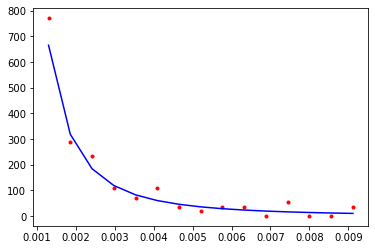

CPU times: user 5.29 ms, sys: 1.06 ms, total: 6.36 ms
Wall time: 2.14 ms
14007.081168553997


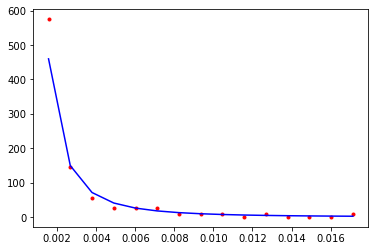

CPU times: user 5.66 ms, sys: 1.22 ms, total: 6.88 ms
Wall time: 2.33 ms
37913.531561158175


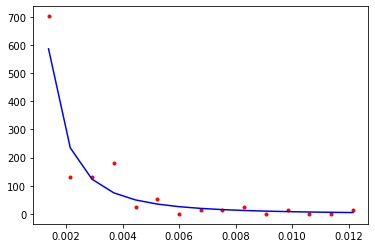

CPU times: user 5.97 ms, sys: 1.23 ms, total: 7.2 ms
Wall time: 2.44 ms
10823.613998364674


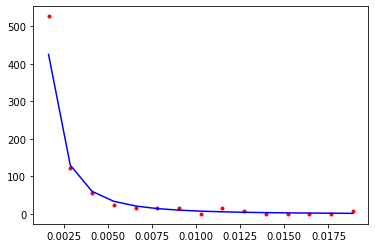

CPU times: user 6.94 ms, sys: 1.59 ms, total: 8.53 ms
Wall time: 2.93 ms
2407.5565779766785


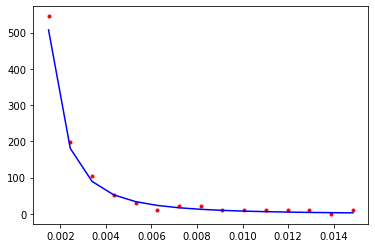

CPU times: user 6.58 ms, sys: 1.18 ms, total: 7.75 ms
Wall time: 2.6 ms
27327.143312381944


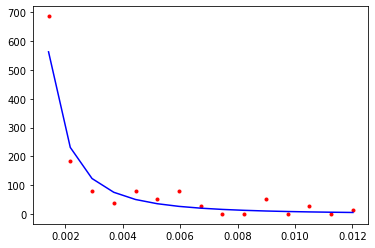

CPU times: user 7.12 ms, sys: 1.33 ms, total: 8.45 ms
Wall time: 2.83 ms
7744.604523096251


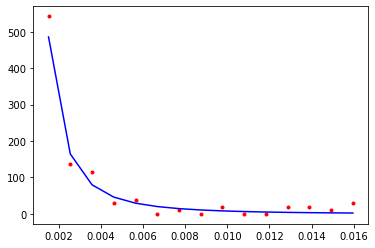

CPU times: user 7.64 ms, sys: 1.4 ms, total: 9.04 ms
Wall time: 3.04 ms
4247.377366341438


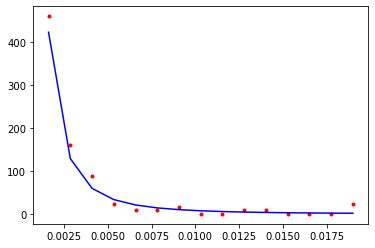

CPU times: user 1.02 ms, sys: 1.05 ms, total: 2.08 ms
Wall time: 691 µs
12874.138631872947


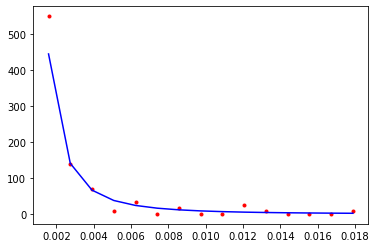

CPU times: user 924 µs, sys: 499 µs, total: 1.42 ms
Wall time: 484 µs
5521.663017226344


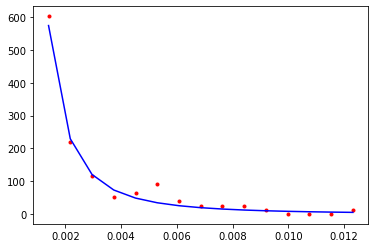

CPU times: user 1.22 ms, sys: 540 µs, total: 1.76 ms
Wall time: 595 µs
5537.313657539177


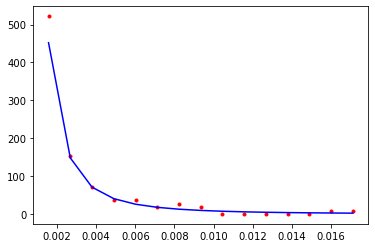

CPU times: user 1.64 ms, sys: 622 µs, total: 2.27 ms
Wall time: 767 µs
8432.115221781098


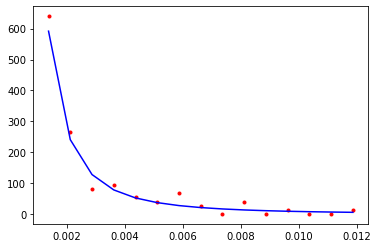

CPU times: user 1.94 ms, sys: 620 µs, total: 2.56 ms
Wall time: 870 µs
3704.334943388411


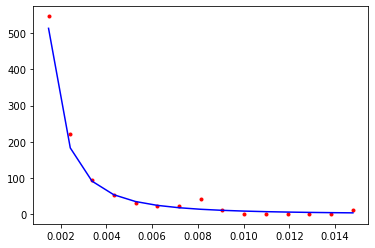

CPU times: user 2.63 ms, sys: 896 µs, total: 3.52 ms
Wall time: 1.21 ms
30769.373454617726


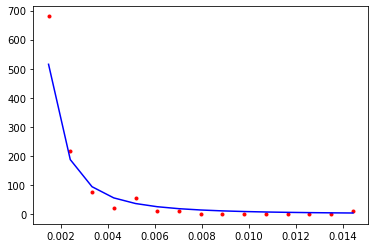

CPU times: user 2.71 ms, sys: 809 µs, total: 3.52 ms
Wall time: 1.22 ms
2568.1904305275666


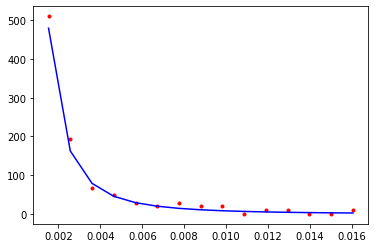

CPU times: user 2.94 ms, sys: 789 µs, total: 3.73 ms
Wall time: 1.27 ms
9925.405061525727


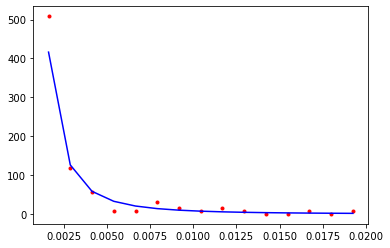

CPU times: user 3.19 ms, sys: 898 µs, total: 4.09 ms
Wall time: 1.4 ms
13140.383602754813


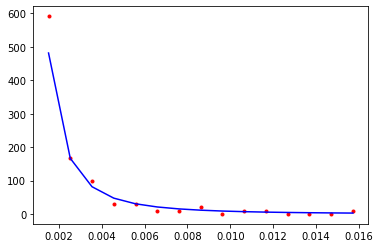

CPU times: user 3.79 ms, sys: 959 µs, total: 4.75 ms
Wall time: 1.62 ms
27122.332653439134


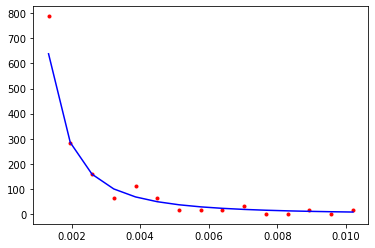

CPU times: user 4.23 ms, sys: 997 µs, total: 5.23 ms
Wall time: 1.78 ms
4745.476151336984


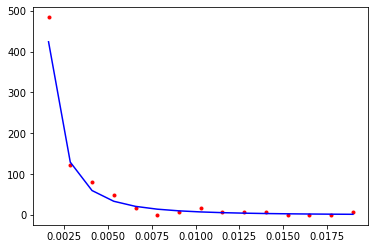

CPU times: user 4.54 ms, sys: 1.05 ms, total: 5.6 ms
Wall time: 1.9 ms
10918.219650856632


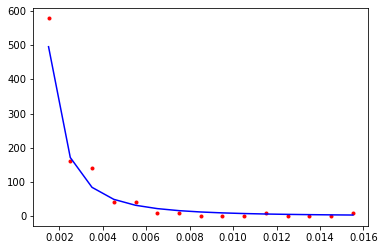

CPU times: user 4.57 ms, sys: 965 µs, total: 5.53 ms
Wall time: 1.88 ms
20142.19713393129


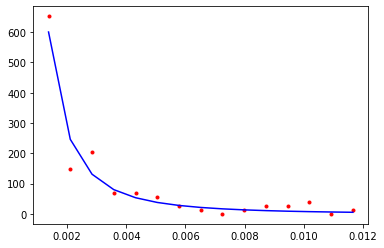

CPU times: user 4.97 ms, sys: 1.01 ms, total: 5.99 ms
Wall time: 2.02 ms
3835.8610958494332


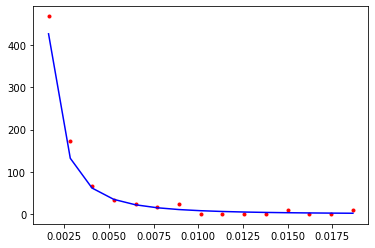

CPU times: user 5.27 ms, sys: 1.18 ms, total: 6.45 ms
Wall time: 2.2 ms
2778.484434342658


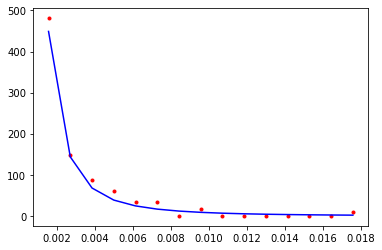

CPU times: user 6.37 ms, sys: 1.49 ms, total: 7.86 ms
Wall time: 2.67 ms
4237.909666702041


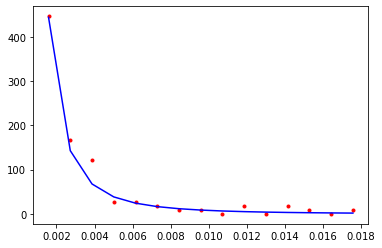

CPU times: user 6.05 ms, sys: 1.19 ms, total: 7.24 ms
Wall time: 2.43 ms
14486.343620213986


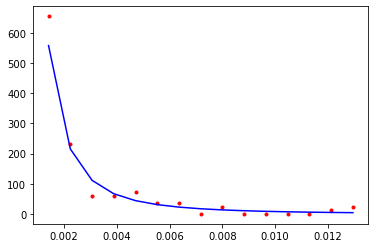

CPU times: user 6.37 ms, sys: 1.26 ms, total: 7.63 ms
Wall time: 2.58 ms
14084.072204041238


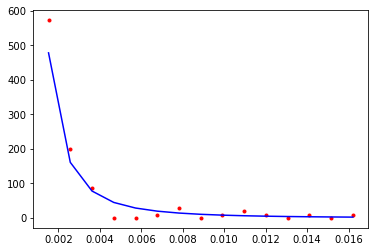

CPU times: user 6.99 ms, sys: 1.38 ms, total: 8.37 ms
Wall time: 2.83 ms
7562.144064536608


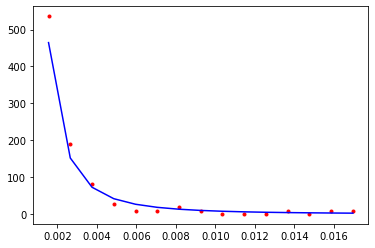

CPU times: user 7.33 ms, sys: 1.45 ms, total: 8.78 ms
Wall time: 2.96 ms
12097.57946794035


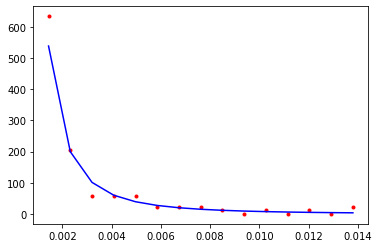

CPU times: user 7.36 ms, sys: 1.37 ms, total: 8.73 ms
Wall time: 2.94 ms
7693.793231617707


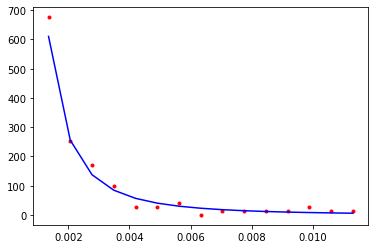

CPU times: user 1.23 ms, sys: 1.21 ms, total: 2.43 ms
Wall time: 804 µs
4728.155169538637


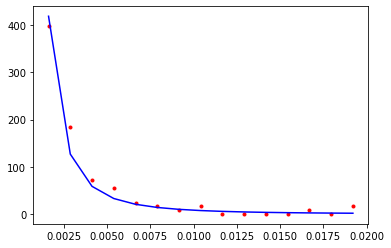

CPU times: user 1.11 ms, sys: 588 µs, total: 1.7 ms
Wall time: 599 µs
21414.38191426304


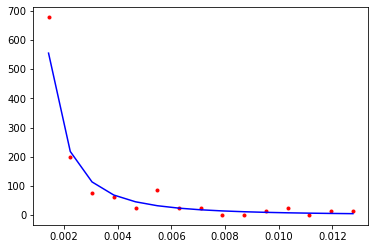

CPU times: user 1.46 ms, sys: 625 µs, total: 2.09 ms
Wall time: 720 µs
14587.289535021135


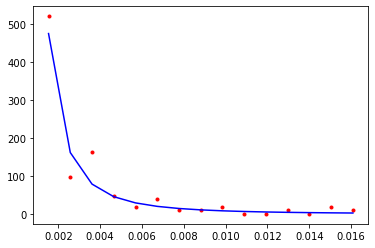

CPU times: user 1.7 ms, sys: 689 µs, total: 2.39 ms
Wall time: 818 µs
10715.956680601823


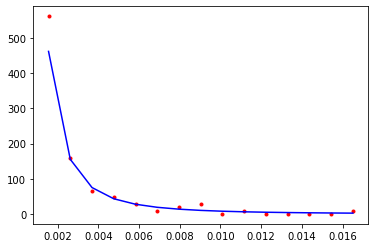

CPU times: user 1.94 ms, sys: 677 µs, total: 2.62 ms
Wall time: 883 µs
8657.155824961501


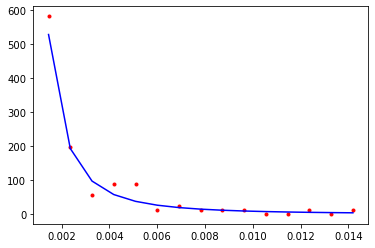

CPU times: user 2.18 ms, sys: 543 µs, total: 2.72 ms
Wall time: 895 µs
14452.995420457884


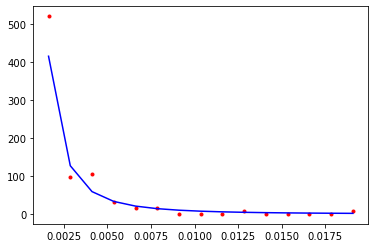

CPU times: user 2.75 ms, sys: 832 µs, total: 3.58 ms
Wall time: 1.24 ms
33033.206782979345


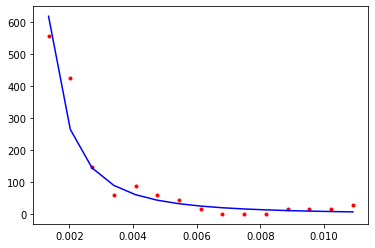

CPU times: user 3.1 ms, sys: 885 µs, total: 3.99 ms
Wall time: 1.37 ms
8781.332135635243


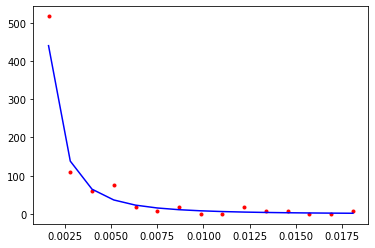

CPU times: user 3.11 ms, sys: 884 µs, total: 3.99 ms
Wall time: 1.37 ms
2211.9759071517096


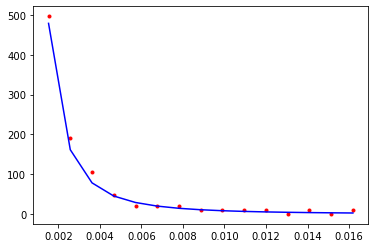

CPU times: user 3.39 ms, sys: 849 µs, total: 4.24 ms
Wall time: 1.44 ms
18750.745902094695


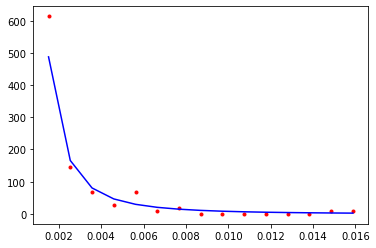

CPU times: user 3.92 ms, sys: 930 µs, total: 4.85 ms
Wall time: 1.66 ms
5087.597332263072


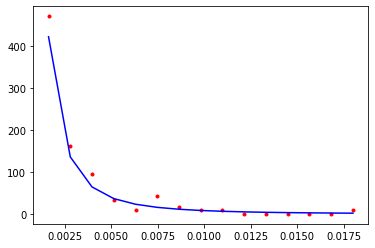

CPU times: user 4.26 ms, sys: 996 µs, total: 5.26 ms
Wall time: 1.78 ms
6763.1150718784775


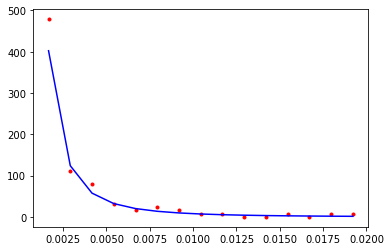

CPU times: user 4.57 ms, sys: 981 µs, total: 5.56 ms
Wall time: 1.89 ms
10126.03132046102


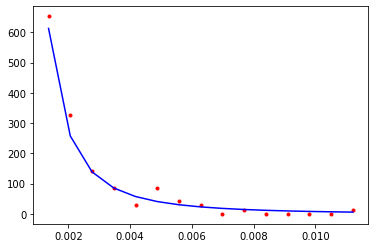

CPU times: user 5.2 ms, sys: 1.16 ms, total: 6.37 ms
Wall time: 2.15 ms
12227.93006500977


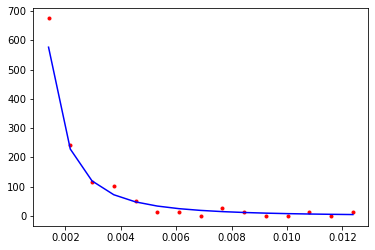

CPU times: user 5.54 ms, sys: 1.14 ms, total: 6.69 ms
Wall time: 2.25 ms
3772.4465488814253


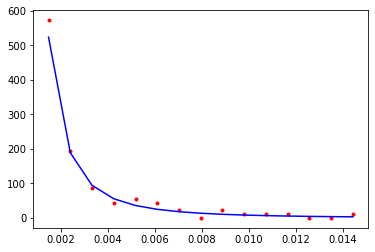

CPU times: user 5.72 ms, sys: 1.13 ms, total: 6.85 ms
Wall time: 2.3 ms
3727.8128456556947


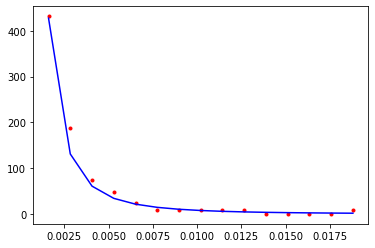

CPU times: user 6.13 ms, sys: 1.25 ms, total: 7.37 ms
Wall time: 2.48 ms
8922.110017722995


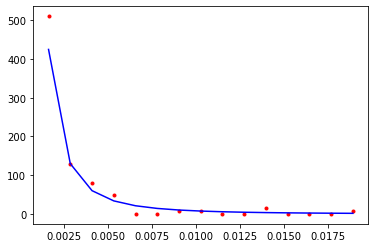

CPU times: user 5.05 ms, sys: 981 µs, total: 6.04 ms
Wall time: 2.62 ms
14815.361511926692


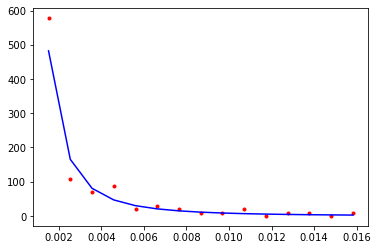

CPU times: user 6.72 ms, sys: 1.23 ms, total: 7.96 ms
Wall time: 2.67 ms
14951.961408584517


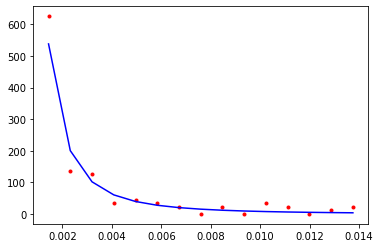

CPU times: user 6.96 ms, sys: 1.44 ms, total: 8.4 ms
Wall time: 2.86 ms
4169.35321935296


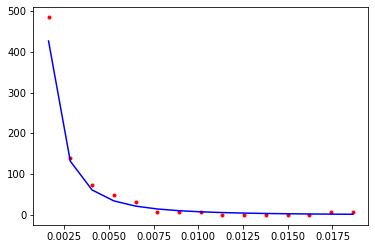

CPU times: user 7.38 ms, sys: 1.36 ms, total: 8.74 ms
Wall time: 2.93 ms
15127.60235178524


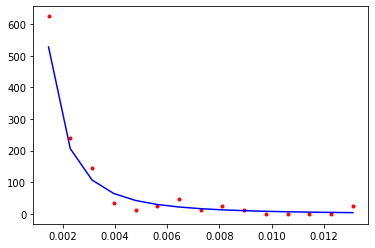

CPU times: user 1.5 ms, sys: 1.41 ms, total: 2.91 ms
Wall time: 963 µs
11761.97083868756


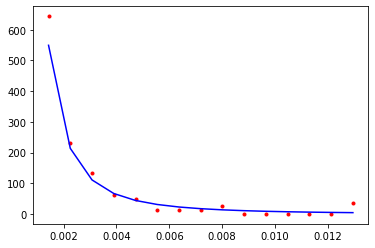

CPU times: user 965 µs, sys: 527 µs, total: 1.49 ms
Wall time: 514 µs
30282.289239490474


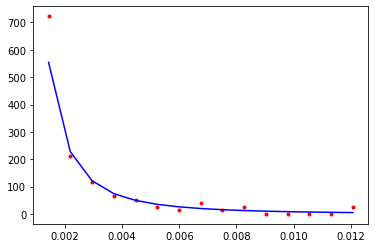

CPU times: user 1.44 ms, sys: 605 µs, total: 2.05 ms
Wall time: 704 µs
12721.529910586827


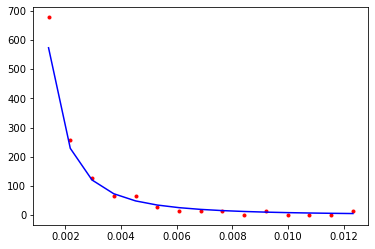

CPU times: user 1.34 ms, sys: 464 µs, total: 1.8 ms
Wall time: 605 µs
11125.915312595396


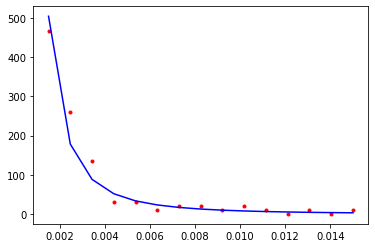

CPU times: user 1.99 ms, sys: 814 µs, total: 2.8 ms
Wall time: 996 µs
3930.302294672522


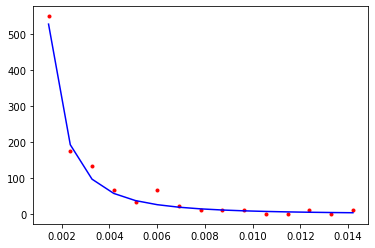

CPU times: user 2.08 ms, sys: 603 µs, total: 2.68 ms
Wall time: 903 µs
6863.966283804082


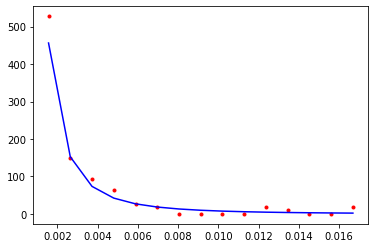

CPU times: user 2.63 ms, sys: 807 µs, total: 3.43 ms
Wall time: 1.17 ms
4698.766940255018


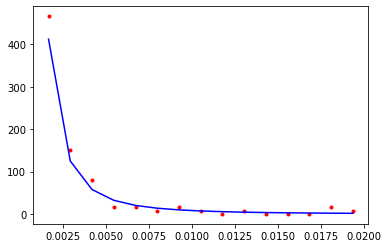

CPU times: user 2.74 ms, sys: 824 µs, total: 3.57 ms
Wall time: 1.24 ms
10283.44811243139


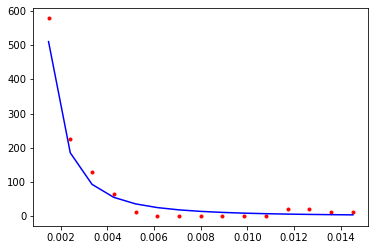

CPU times: user 3.2 ms, sys: 816 µs, total: 4.01 ms
Wall time: 1.38 ms
18416.901612531412


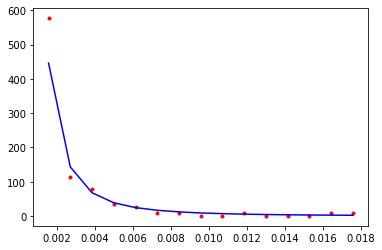

CPU times: user 3.5 ms, sys: 896 µs, total: 4.39 ms
Wall time: 1.49 ms
11801.668586758527


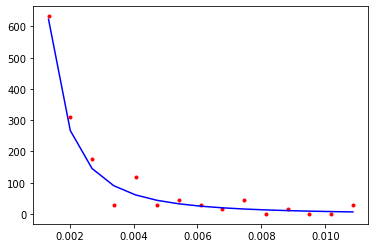

CPU times: user 3.92 ms, sys: 893 µs, total: 4.81 ms
Wall time: 1.64 ms
7022.637416694644


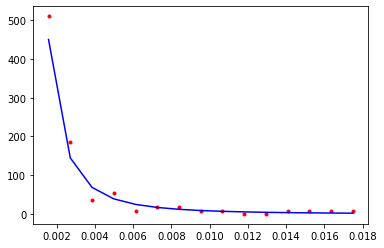

CPU times: user 4.47 ms, sys: 1.15 ms, total: 5.63 ms
Wall time: 1.91 ms
4439.8484779337605


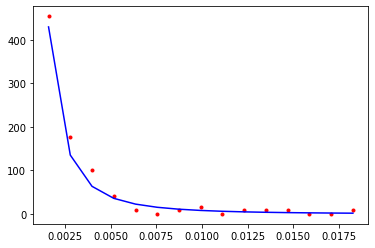

CPU times: user 4.55 ms, sys: 1.01 ms, total: 5.56 ms
Wall time: 1.88 ms
12994.901337506672


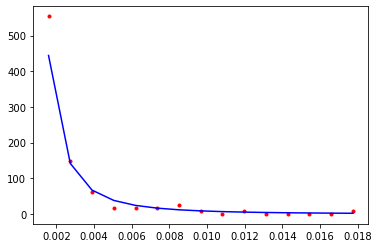

CPU times: user 4.98 ms, sys: 1.09 ms, total: 6.07 ms
Wall time: 2.05 ms
23454.232361711223


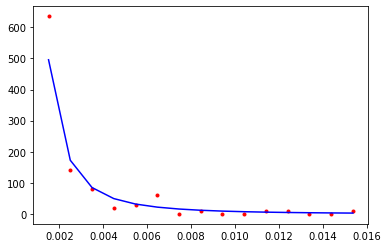

CPU times: user 5.52 ms, sys: 1.23 ms, total: 6.76 ms
Wall time: 2.3 ms
5433.3402948973035


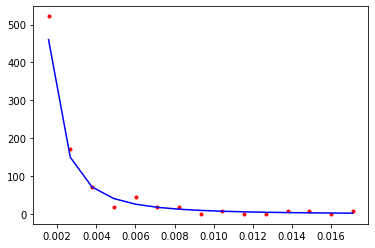

CPU times: user 5.65 ms, sys: 1.32 ms, total: 6.97 ms
Wall time: 2.38 ms
12411.44697788326


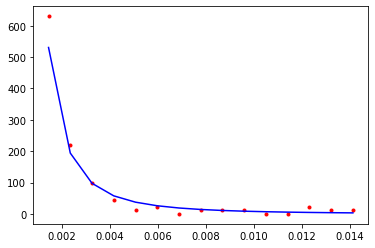

CPU times: user 6.05 ms, sys: 1.23 ms, total: 7.28 ms
Wall time: 2.47 ms
18353.735452127126


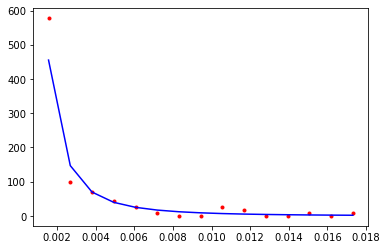

CPU times: user 6.42 ms, sys: 1.21 ms, total: 7.63 ms
Wall time: 2.56 ms
31442.820983685833


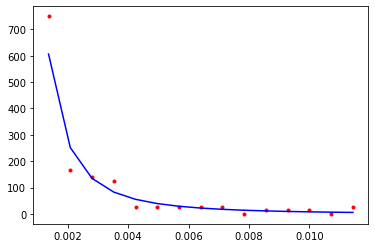

CPU times: user 6.73 ms, sys: 1.22 ms, total: 7.95 ms
Wall time: 2.67 ms
4918.195031258098


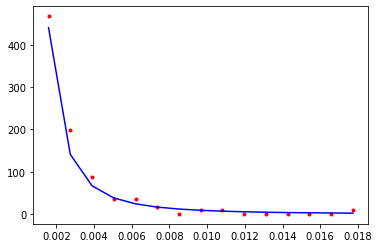

CPU times: user 7.25 ms, sys: 1.43 ms, total: 8.68 ms
Wall time: 2.93 ms
21396.94096915032


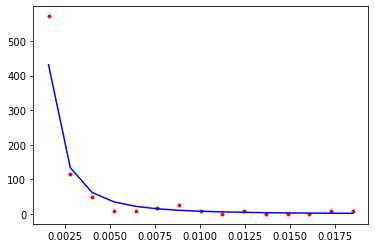

CPU times: user 7.39 ms, sys: 1.3 ms, total: 8.69 ms
Wall time: 2.92 ms
18949.87529310566


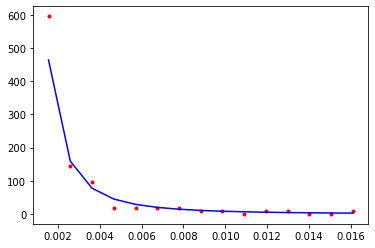

CPU times: user 1.18 ms, sys: 1.12 ms, total: 2.3 ms
Wall time: 755 µs
5323.388390667576


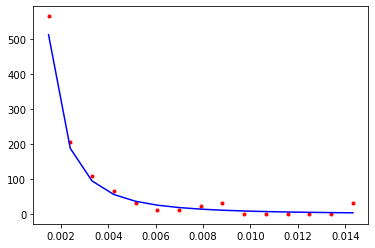

In [49]:
for _ in range(loops):
    for nn_iter in n_iter:
        lib.set_rutherford_iterations(nn_iter)
        %time r_everest = [ lib.get_random_ruth() for _ in range(n) ]
        S_everest[nn_iter] = np.array([ *S_everest[nn_iter], test_random(r_everest, bins, f) ])
    %time r_k2 = [ k2ran.get_random_ruth(cgen) for _ in range(n) ]
    S_K2 = np.array([ *S_K2, test_random(r_k2, bins, f) ])

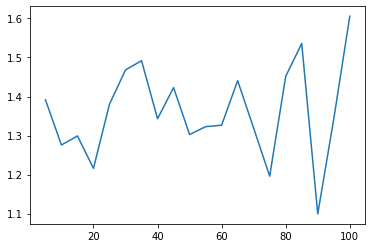

In [50]:
plt.plot(n_iter, [ np.sqrt((S_everest[nn_iter] / S_K2).mean()) for nn_iter in n_iter ])

In [51]:
lib.set_random_seed(1669281221)
k2ran.set_random_seed(1669281221)

mat = xc.materials.Lead
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

lib.set_rutherford_parameters(z,emr,t1)
cgen = k2ran.initialise_random_ruth(zatom=z, emr=emr, hcut=t1)

n = 100
n_iter = [5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
bins = 15

loops = 20
S_everest = { nn: [] for nn in n_iter }
S_K2 = []
f = lambda x: PDF(x,z,emr)/CDF(t1,z,emr)

CPU times: user 656 µs, sys: 307 µs, total: 963 µs
Wall time: 268 µs
45659.78521903871


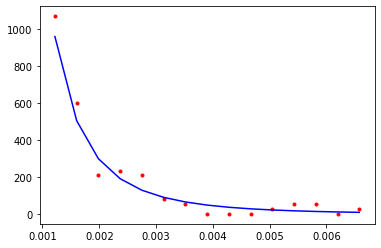

CPU times: user 1.51 ms, sys: 665 µs, total: 2.18 ms
Wall time: 761 µs
20798.238641300206


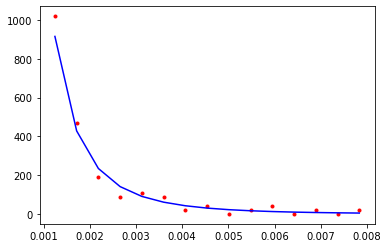

CPU times: user 1.8 ms, sys: 764 µs, total: 2.56 ms
Wall time: 893 µs
43152.76210845915


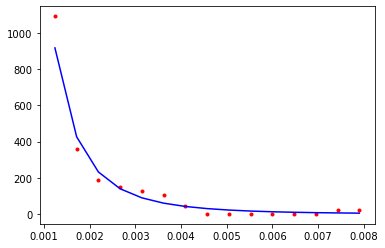

CPU times: user 2.06 ms, sys: 870 µs, total: 2.93 ms
Wall time: 1.04 ms
16703.291983571413


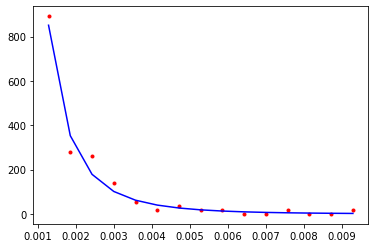

CPU times: user 2.6 ms, sys: 765 µs, total: 3.37 ms
Wall time: 1.18 ms
15942.550520268944


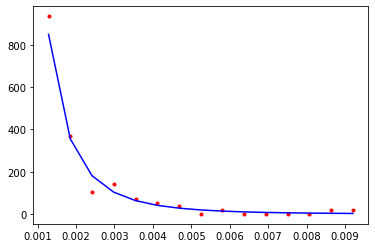

CPU times: user 2.79 ms, sys: 751 µs, total: 3.54 ms
Wall time: 1.21 ms
163690.60084720125


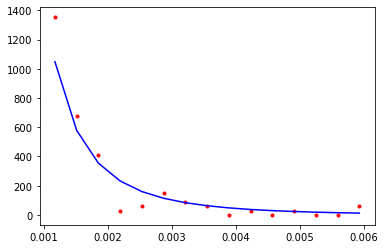

CPU times: user 3.04 ms, sys: 878 µs, total: 3.92 ms
Wall time: 1.34 ms
57303.02361523452


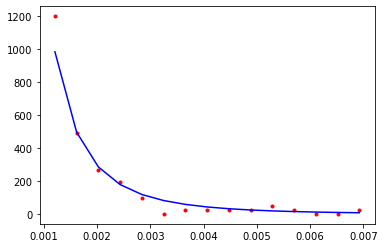

CPU times: user 3.56 ms, sys: 981 µs, total: 4.54 ms
Wall time: 1.63 ms
96873.85604690334


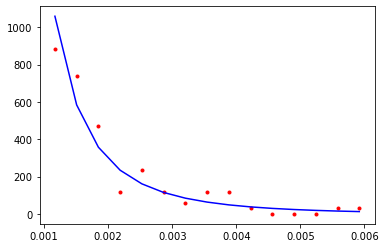

CPU times: user 4.48 ms, sys: 1.06 ms, total: 5.53 ms
Wall time: 1.87 ms
46255.98177080727


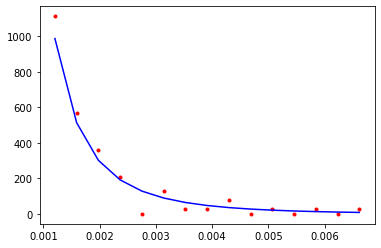

CPU times: user 3.95 ms, sys: 1.08 ms, total: 5.03 ms
Wall time: 1.77 ms
26750.65741510328


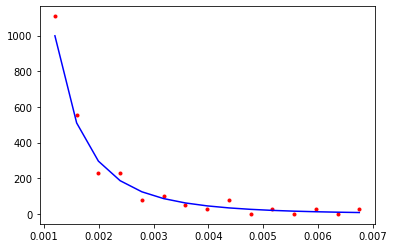

CPU times: user 5.05 ms, sys: 1.02 ms, total: 6.07 ms
Wall time: 2.03 ms
13034.780442164063


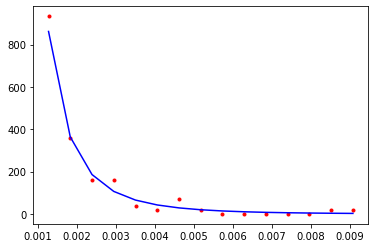

CPU times: user 5.21 ms, sys: 1.02 ms, total: 6.24 ms
Wall time: 2.08 ms
65829.25363296694


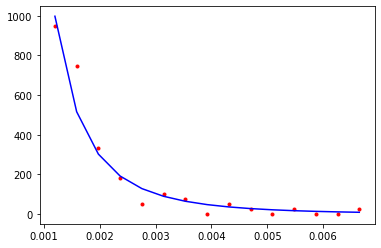

CPU times: user 5.85 ms, sys: 1.1 ms, total: 6.94 ms
Wall time: 2.33 ms
113193.63219579401


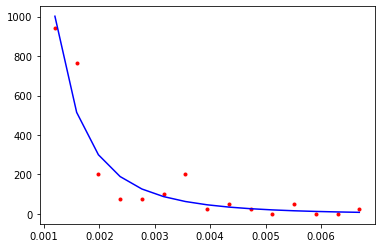

CPU times: user 6.11 ms, sys: 1.13 ms, total: 7.24 ms
Wall time: 2.42 ms
41285.4189148712


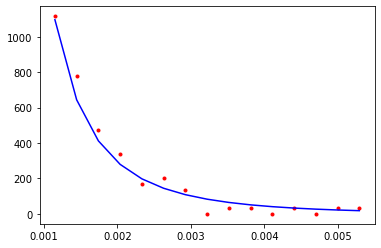

CPU times: user 6.54 ms, sys: 1.19 ms, total: 7.72 ms
Wall time: 2.58 ms
55595.687296912416


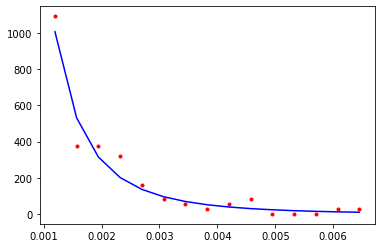

CPU times: user 6.79 ms, sys: 1.12 ms, total: 7.91 ms
Wall time: 2.63 ms
6069.207857615721


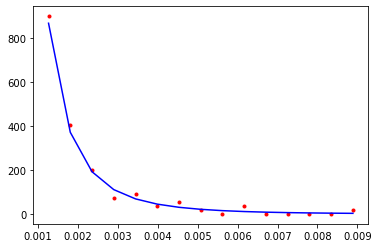

CPU times: user 7.22 ms, sys: 1.16 ms, total: 8.38 ms
Wall time: 2.78 ms
93904.88113372713


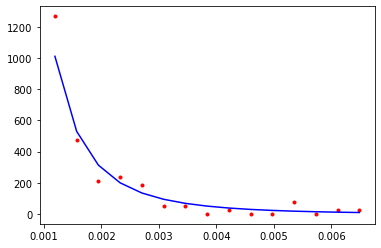

CPU times: user 7.03 ms, sys: 1.73 ms, total: 8.76 ms
Wall time: 3.07 ms
21693.00533747914


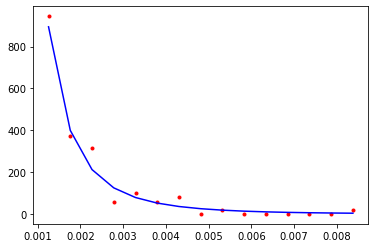

CPU times: user 6.62 ms, sys: 1.87 ms, total: 8.49 ms
Wall time: 3.05 ms
45238.162717383486


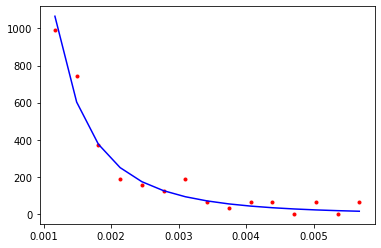

CPU times: user 8.23 ms, sys: 1.52 ms, total: 9.75 ms
Wall time: 3.29 ms
48115.45858112986


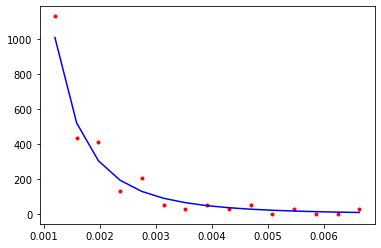

CPU times: user 1.18 ms, sys: 1.12 ms, total: 2.3 ms
Wall time: 753 µs
7552.302351638073


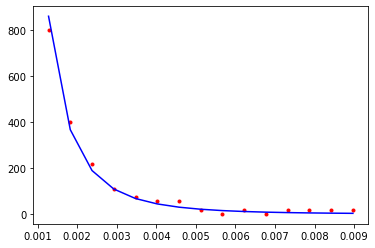

CPU times: user 920 µs, sys: 508 µs, total: 1.43 ms
Wall time: 485 µs
49106.03944420852


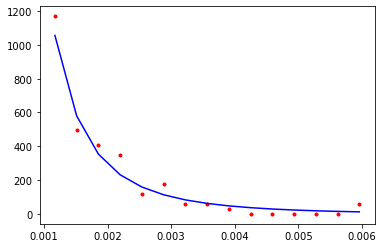

CPU times: user 1.36 ms, sys: 600 µs, total: 1.96 ms
Wall time: 664 µs
16656.445511466012


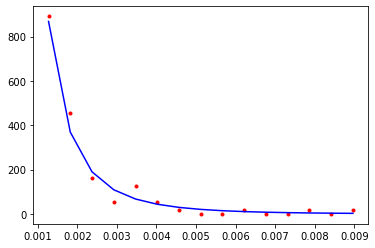

CPU times: user 1.77 ms, sys: 645 µs, total: 2.42 ms
Wall time: 802 µs
40163.178783476804


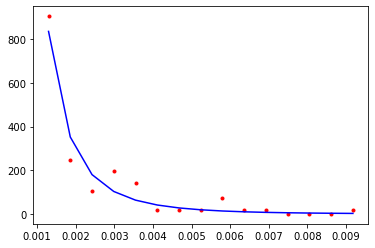

CPU times: user 2.4 ms, sys: 699 µs, total: 3.1 ms
Wall time: 1.05 ms
41125.09951902806


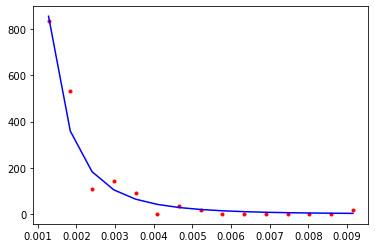

CPU times: user 2.68 ms, sys: 747 µs, total: 3.42 ms
Wall time: 1.16 ms
22886.986575869134


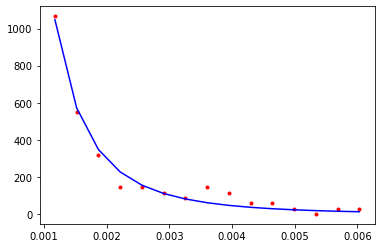

CPU times: user 2.91 ms, sys: 625 µs, total: 3.54 ms
Wall time: 1.17 ms
53573.703114268166


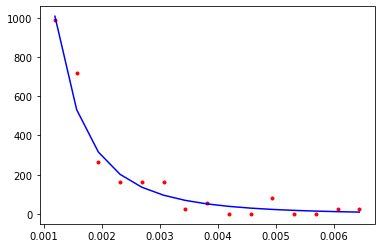

CPU times: user 3.86 ms, sys: 986 µs, total: 4.85 ms
Wall time: 1.62 ms
13989.615924184238


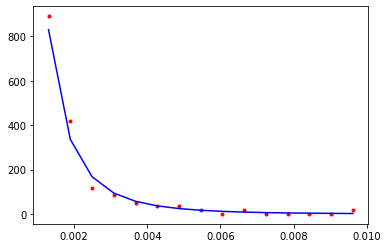

CPU times: user 3.59 ms, sys: 848 µs, total: 4.44 ms
Wall time: 1.5 ms
30932.87530650214


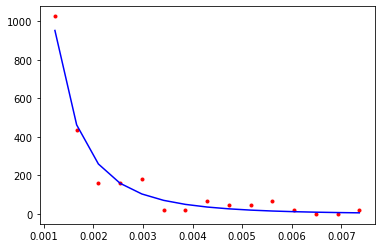

CPU times: user 4.11 ms, sys: 1.07 ms, total: 5.18 ms
Wall time: 1.78 ms
22718.017366594857


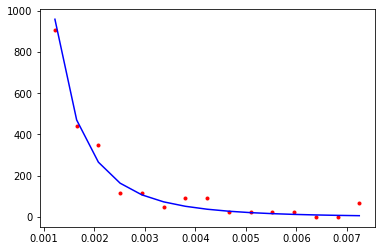

CPU times: user 4.27 ms, sys: 939 µs, total: 5.21 ms
Wall time: 1.75 ms
19977.716321363816


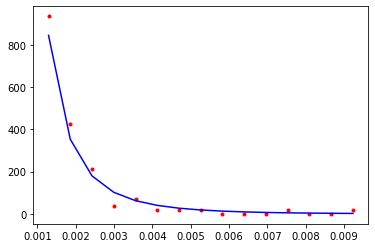

CPU times: user 4.94 ms, sys: 1.17 ms, total: 6.12 ms
Wall time: 2.08 ms
20060.427525760344


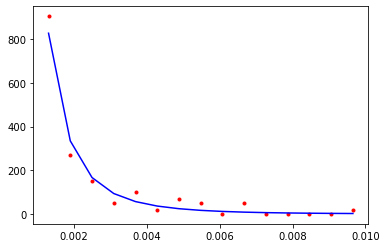

CPU times: user 5.09 ms, sys: 1.16 ms, total: 6.24 ms
Wall time: 2.14 ms
17224.96608292668


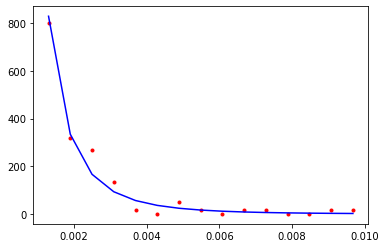

CPU times: user 5.8 ms, sys: 1.68 ms, total: 7.48 ms
Wall time: 2.62 ms
50153.88182618953


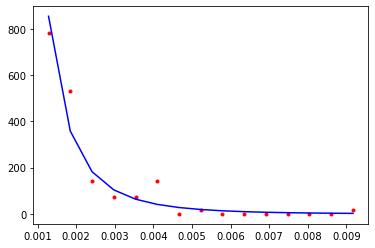

CPU times: user 5.81 ms, sys: 1.13 ms, total: 6.94 ms
Wall time: 2.35 ms
12546.717428389678


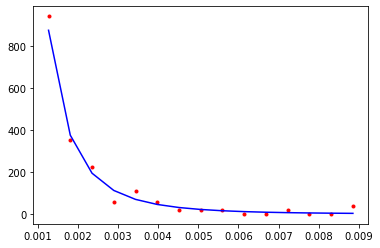

CPU times: user 5.57 ms, sys: 1.69 ms, total: 7.26 ms
Wall time: 2.58 ms
99827.65537454108


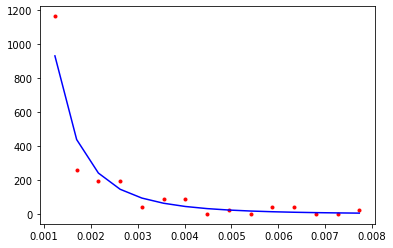

CPU times: user 6.71 ms, sys: 1.32 ms, total: 8.03 ms
Wall time: 2.72 ms
10789.337365384983


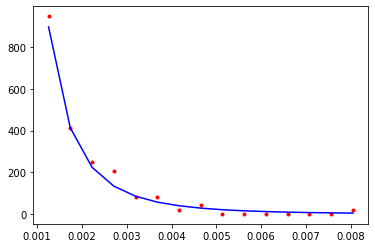

CPU times: user 7.08 ms, sys: 1.36 ms, total: 8.44 ms
Wall time: 2.87 ms
56758.1199132223


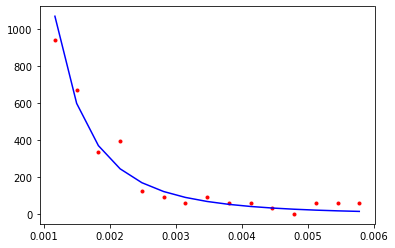

CPU times: user 7.52 ms, sys: 1.4 ms, total: 8.93 ms
Wall time: 3.01 ms
57908.985339044004


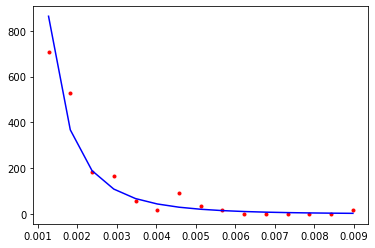

CPU times: user 7.95 ms, sys: 1.51 ms, total: 9.46 ms
Wall time: 3.19 ms
29792.700318390245


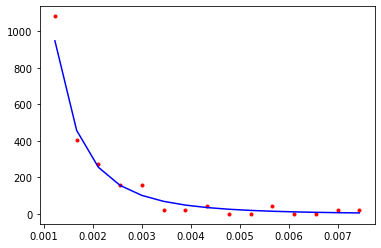

CPU times: user 8.19 ms, sys: 1.48 ms, total: 9.68 ms
Wall time: 3.25 ms
15615.890770157674


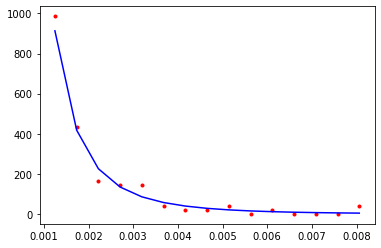

CPU times: user 1.32 ms, sys: 1.37 ms, total: 2.69 ms
Wall time: 873 µs
65645.00786352043


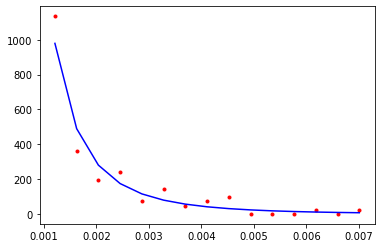

CPU times: user 936 µs, sys: 574 µs, total: 1.51 ms
Wall time: 524 µs
58243.4060413642


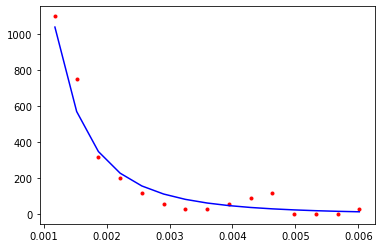

CPU times: user 1.56 ms, sys: 662 µs, total: 2.22 ms
Wall time: 770 µs
41628.37162772426


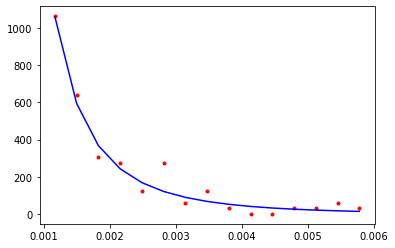

CPU times: user 1.7 ms, sys: 768 µs, total: 2.47 ms
Wall time: 897 µs
90088.77528836769


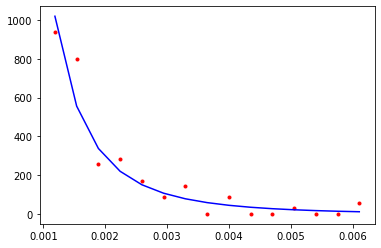

CPU times: user 2 ms, sys: 668 µs, total: 2.67 ms
Wall time: 910 µs
51264.04308095873


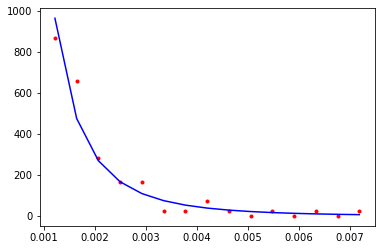

CPU times: user 2.48 ms, sys: 787 µs, total: 3.27 ms
Wall time: 1.15 ms
52633.74596256254


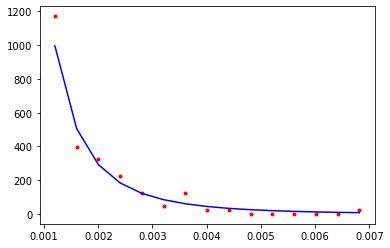

CPU times: user 2.69 ms, sys: 787 µs, total: 3.48 ms
Wall time: 1.2 ms
171784.66407902885


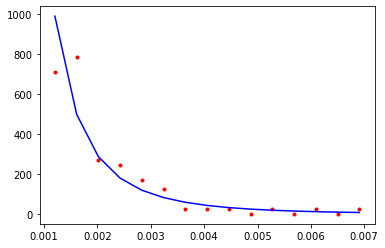

CPU times: user 3.37 ms, sys: 914 µs, total: 4.28 ms
Wall time: 1.45 ms
54753.01600654591


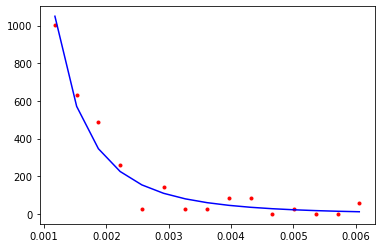

CPU times: user 3.66 ms, sys: 1.02 ms, total: 4.68 ms
Wall time: 1.63 ms
43878.772563381615


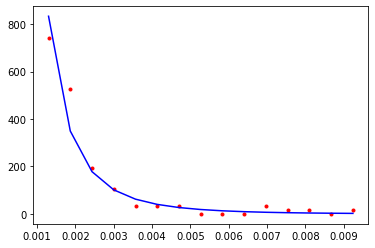

CPU times: user 3.45 ms, sys: 1.2 ms, total: 4.65 ms
Wall time: 1.64 ms
54076.053837526386


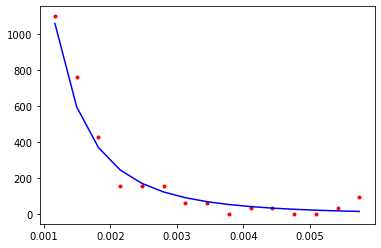

CPU times: user 4.24 ms, sys: 1.02 ms, total: 5.26 ms
Wall time: 1.82 ms
35429.63410502354


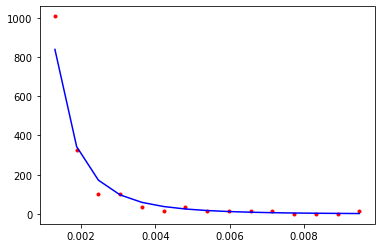

CPU times: user 4.66 ms, sys: 1.36 ms, total: 6.02 ms
Wall time: 2.1 ms
45786.346803191795


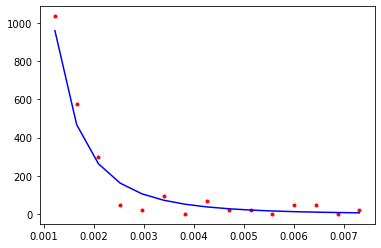

CPU times: user 4.99 ms, sys: 1.14 ms, total: 6.13 ms
Wall time: 2.09 ms
55631.0196659117


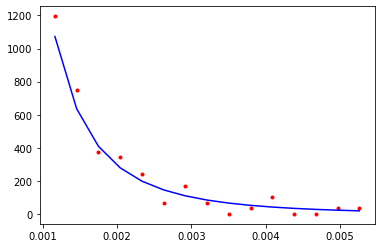

CPU times: user 5.43 ms, sys: 1.01 ms, total: 6.45 ms
Wall time: 2.16 ms
30023.457866774264


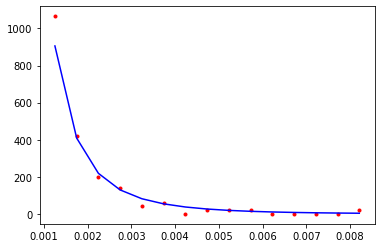

CPU times: user 5.83 ms, sys: 1.39 ms, total: 7.22 ms
Wall time: 2.47 ms
65951.72996747098


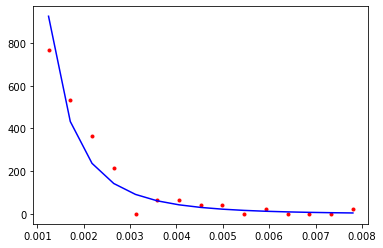

CPU times: user 6.12 ms, sys: 1.39 ms, total: 7.51 ms
Wall time: 2.55 ms
59376.223565471264


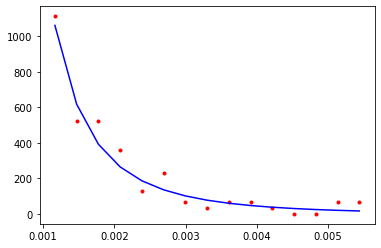

CPU times: user 6.56 ms, sys: 1.55 ms, total: 8.11 ms
Wall time: 2.79 ms
4761.1334081220975


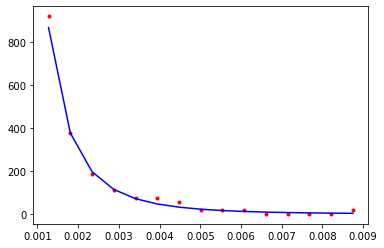

CPU times: user 7.3 ms, sys: 1.43 ms, total: 8.73 ms
Wall time: 2.94 ms
57926.43313998251


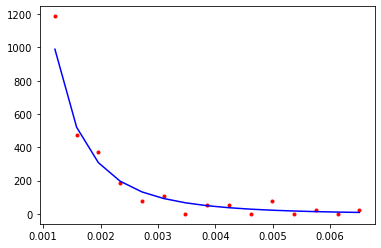

CPU times: user 7.45 ms, sys: 1.44 ms, total: 8.9 ms
Wall time: 3.02 ms
12175.723098798631


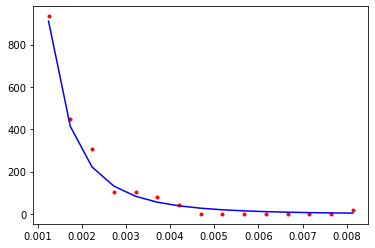

CPU times: user 7.79 ms, sys: 1.36 ms, total: 9.15 ms
Wall time: 3.07 ms
23173.093194993624


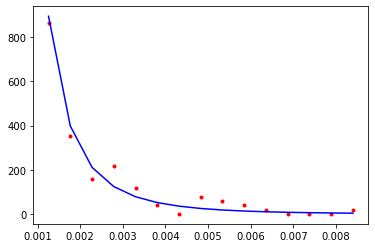

CPU times: user 8.21 ms, sys: 1.46 ms, total: 9.67 ms
Wall time: 3.24 ms
56412.78685600451


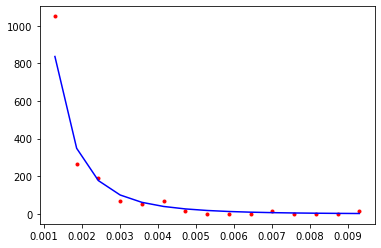

CPU times: user 1.1 ms, sys: 1.03 ms, total: 2.12 ms
Wall time: 685 µs
13758.29427812245


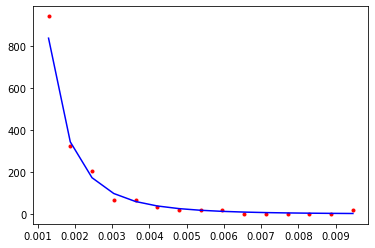

CPU times: user 947 µs, sys: 456 µs, total: 1.4 ms
Wall time: 469 µs
40776.63373043138


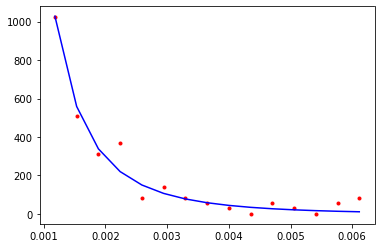

CPU times: user 1.33 ms, sys: 528 µs, total: 1.86 ms
Wall time: 631 µs
15692.438733376144


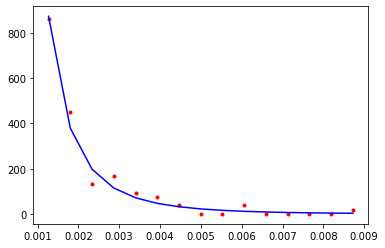

CPU times: user 1.81 ms, sys: 693 µs, total: 2.5 ms
Wall time: 879 µs
34720.52624182007


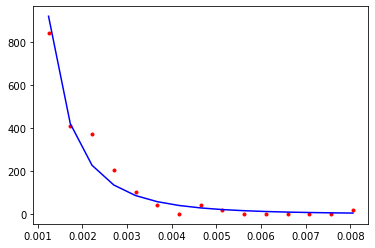

CPU times: user 2.04 ms, sys: 724 µs, total: 2.77 ms
Wall time: 961 µs
33955.585401710676


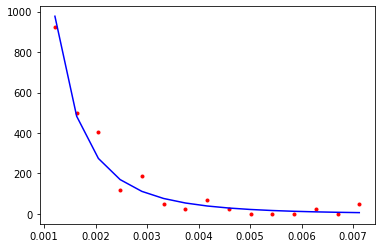

CPU times: user 2.58 ms, sys: 742 µs, total: 3.32 ms
Wall time: 1.15 ms
54130.36970593325


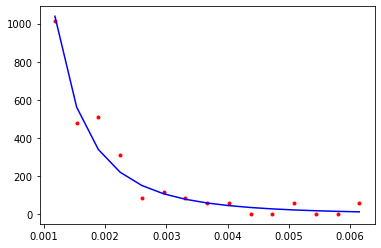

CPU times: user 2.97 ms, sys: 817 µs, total: 3.79 ms
Wall time: 1.3 ms
85589.77013960852


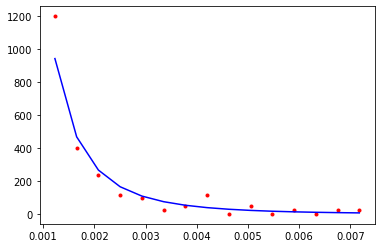

CPU times: user 3.12 ms, sys: 811 µs, total: 3.93 ms
Wall time: 1.34 ms
17680.248307045575


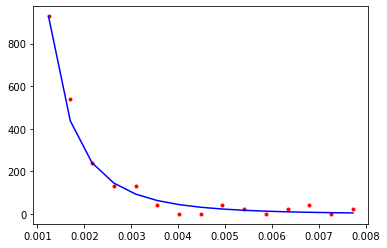

CPU times: user 3.55 ms, sys: 914 µs, total: 4.47 ms
Wall time: 1.51 ms
17744.485494376844


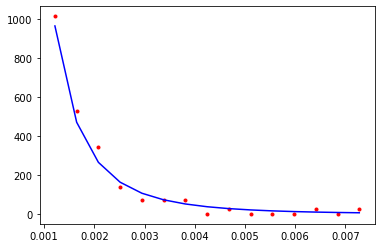

CPU times: user 3.75 ms, sys: 1.02 ms, total: 4.77 ms
Wall time: 1.65 ms
40714.384153059924


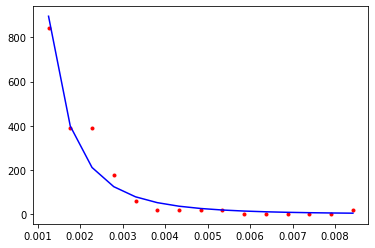

CPU times: user 4.23 ms, sys: 930 µs, total: 5.16 ms
Wall time: 1.75 ms
110866.32320446138


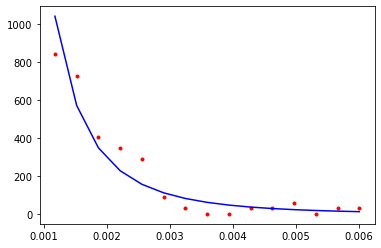

CPU times: user 4.58 ms, sys: 962 µs, total: 5.54 ms
Wall time: 1.87 ms
20717.379107971363


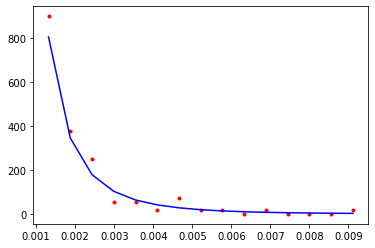

CPU times: user 5.01 ms, sys: 1.13 ms, total: 6.14 ms
Wall time: 2.09 ms
124272.49775697845


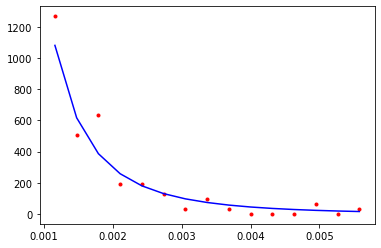

CPU times: user 5.73 ms, sys: 1.13 ms, total: 6.86 ms
Wall time: 2.31 ms
80268.76948871542


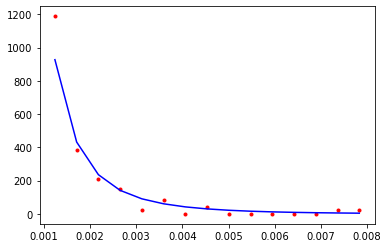

CPU times: user 5.82 ms, sys: 1.16 ms, total: 6.98 ms
Wall time: 2.36 ms
77037.70810056847


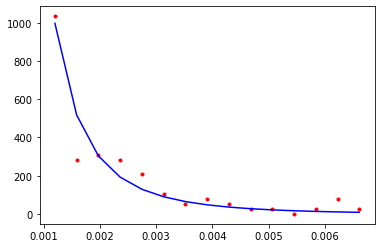

CPU times: user 6.39 ms, sys: 1.25 ms, total: 7.64 ms
Wall time: 2.57 ms
50372.68741157305


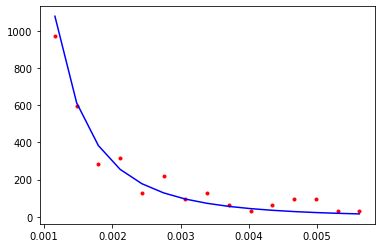

CPU times: user 6.69 ms, sys: 1.22 ms, total: 7.92 ms
Wall time: 2.65 ms
10160.157705118807


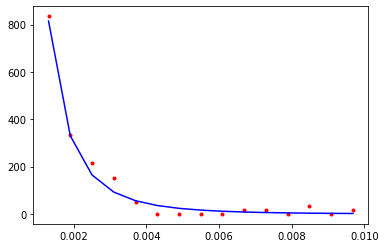

CPU times: user 6.85 ms, sys: 1.42 ms, total: 8.27 ms
Wall time: 2.82 ms
36782.9067118219


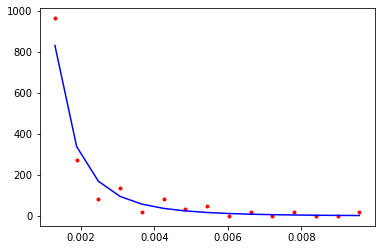

CPU times: user 7.42 ms, sys: 1.39 ms, total: 8.81 ms
Wall time: 2.97 ms
6589.906524438651


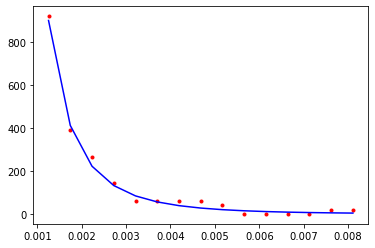

CPU times: user 7.64 ms, sys: 1.35 ms, total: 9 ms
Wall time: 3.02 ms
37781.71893931101


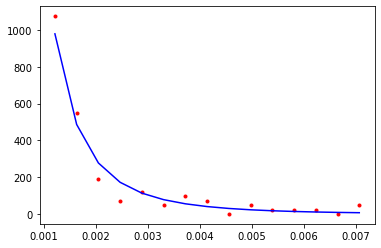

CPU times: user 7.94 ms, sys: 1.55 ms, total: 9.49 ms
Wall time: 3.22 ms
92645.39354395054


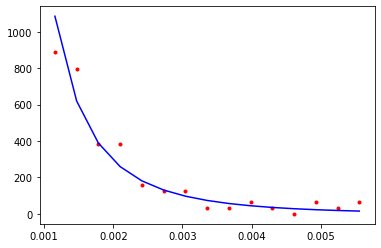

CPU times: user 1.17 ms, sys: 1.15 ms, total: 2.32 ms
Wall time: 775 µs
27062.160392492697


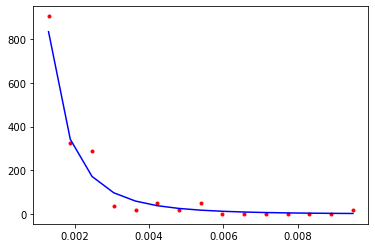

CPU times: user 1.11 ms, sys: 606 µs, total: 1.71 ms
Wall time: 599 µs
72014.19200193549


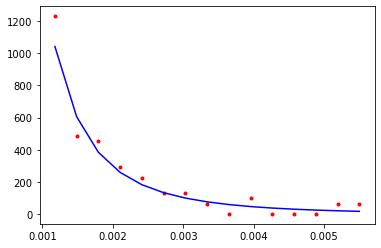

CPU times: user 1.29 ms, sys: 499 µs, total: 1.79 ms
Wall time: 603 µs
79365.69256488423


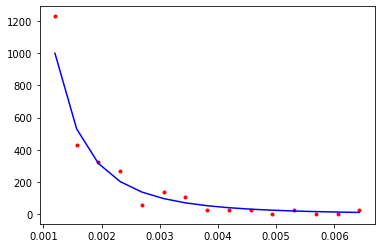

CPU times: user 1.47 ms, sys: 485 µs, total: 1.95 ms
Wall time: 653 µs
19465.58225920135


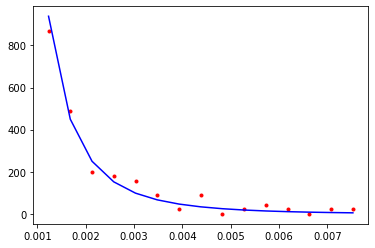

CPU times: user 2.04 ms, sys: 688 µs, total: 2.73 ms
Wall time: 935 µs
27583.036355630615


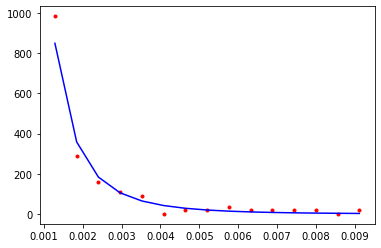

CPU times: user 2.68 ms, sys: 861 µs, total: 3.54 ms
Wall time: 1.22 ms
103640.02684557029


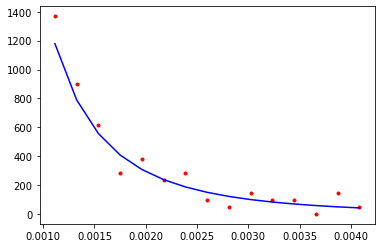

CPU times: user 2.84 ms, sys: 857 µs, total: 3.7 ms
Wall time: 1.25 ms
19544.247762542018


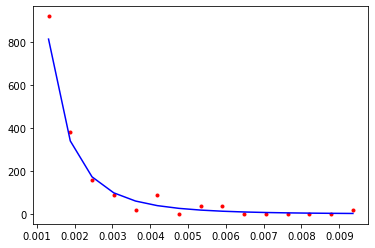

CPU times: user 3.08 ms, sys: 878 µs, total: 3.96 ms
Wall time: 1.36 ms
48999.9152930528


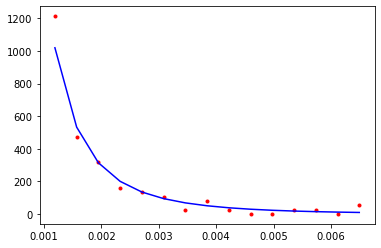

CPU times: user 3.67 ms, sys: 933 µs, total: 4.61 ms
Wall time: 1.59 ms
34067.11747790278


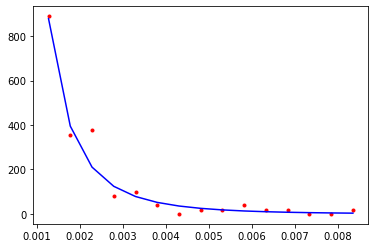

CPU times: user 3.88 ms, sys: 1.2 ms, total: 5.08 ms
Wall time: 1.78 ms
17355.72770892967


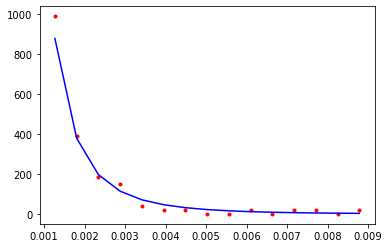

CPU times: user 4.4 ms, sys: 1.08 ms, total: 5.48 ms
Wall time: 1.88 ms
106032.9987238551


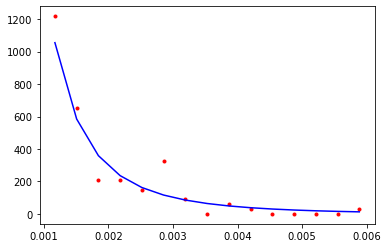

CPU times: user 4.83 ms, sys: 1.1 ms, total: 5.93 ms
Wall time: 2.03 ms
20266.79107642016


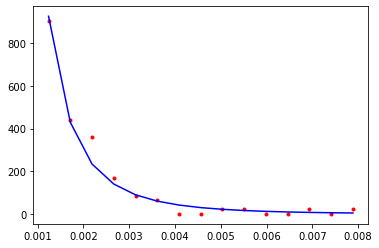

CPU times: user 5.07 ms, sys: 1.07 ms, total: 6.15 ms
Wall time: 2.07 ms
31615.793241046576


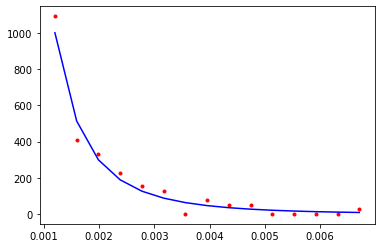

CPU times: user 5.42 ms, sys: 1.11 ms, total: 6.53 ms
Wall time: 2.2 ms
14432.838833216383


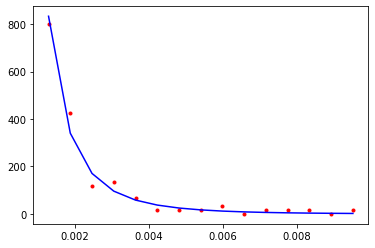

CPU times: user 6.07 ms, sys: 1.24 ms, total: 7.31 ms
Wall time: 2.47 ms
27633.558859294808


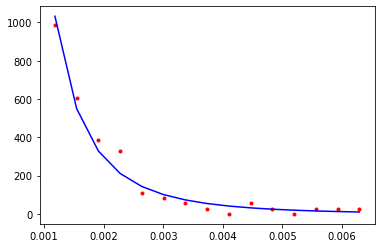

CPU times: user 6.26 ms, sys: 1.25 ms, total: 7.51 ms
Wall time: 2.53 ms
14279.616448962028


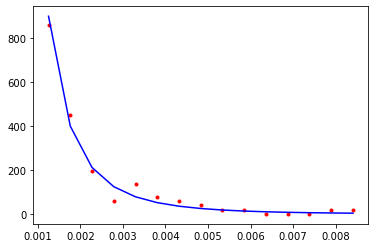

CPU times: user 6.77 ms, sys: 1.23 ms, total: 8 ms
Wall time: 2.68 ms
23394.92280332325


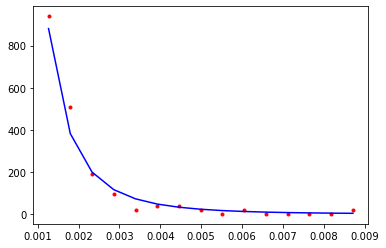

CPU times: user 7.06 ms, sys: 1.29 ms, total: 8.35 ms
Wall time: 2.79 ms
29496.21343542616


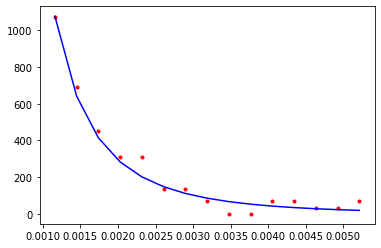

CPU times: user 7.23 ms, sys: 1.48 ms, total: 8.7 ms
Wall time: 2.97 ms
34304.66936772719


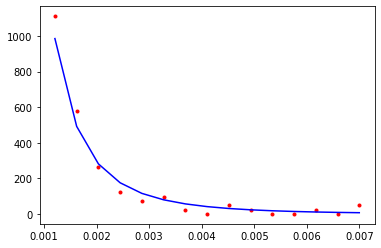

CPU times: user 7.77 ms, sys: 1.44 ms, total: 9.21 ms
Wall time: 3.11 ms
48615.904518624804


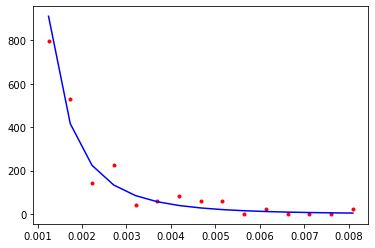

CPU times: user 8.41 ms, sys: 1.53 ms, total: 9.94 ms
Wall time: 3.34 ms
6313.865033337924


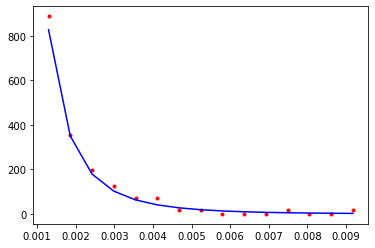

CPU times: user 1.55 ms, sys: 1.45 ms, total: 3 ms
Wall time: 982 µs
53838.7676458223


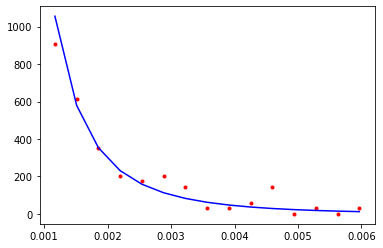

CPU times: user 1.09 ms, sys: 604 µs, total: 1.7 ms
Wall time: 594 µs
123003.2255825538


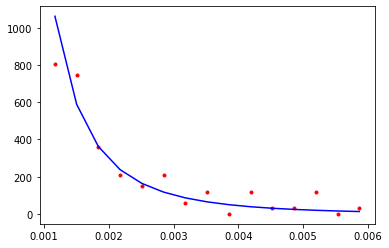

CPU times: user 1.29 ms, sys: 522 µs, total: 1.81 ms
Wall time: 621 µs
32484.71773639201


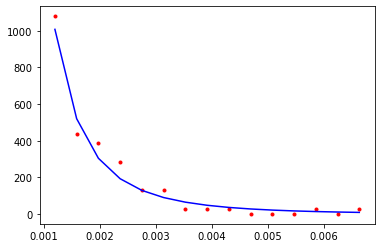

CPU times: user 1.84 ms, sys: 599 µs, total: 2.43 ms
Wall time: 818 µs
12481.56255118405


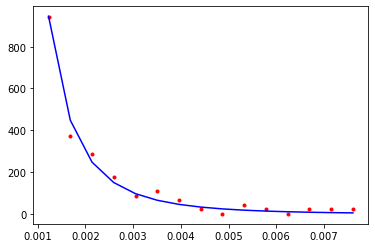

CPU times: user 2 ms, sys: 664 µs, total: 2.67 ms
Wall time: 913 µs
13062.69223026195


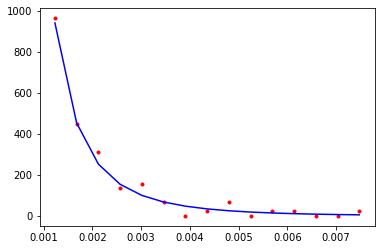

CPU times: user 2.21 ms, sys: 841 µs, total: 3.05 ms
Wall time: 1.06 ms
16025.007323778646


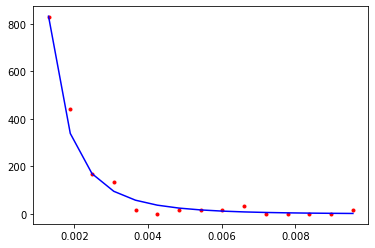

CPU times: user 2.97 ms, sys: 907 µs, total: 3.88 ms
Wall time: 1.34 ms
50190.39376788221


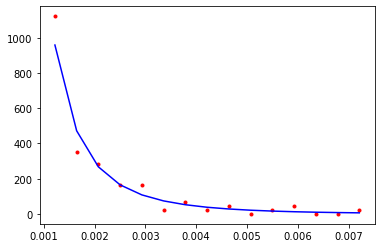

CPU times: user 3.16 ms, sys: 827 µs, total: 3.99 ms
Wall time: 1.35 ms
12457.869657608604


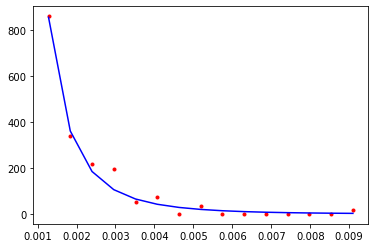

CPU times: user 3.78 ms, sys: 966 µs, total: 4.75 ms
Wall time: 1.62 ms
33430.476801893645


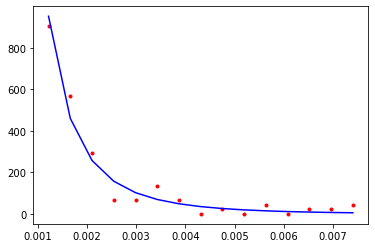

CPU times: user 4.1 ms, sys: 1.05 ms, total: 5.14 ms
Wall time: 1.77 ms
42733.13288168289


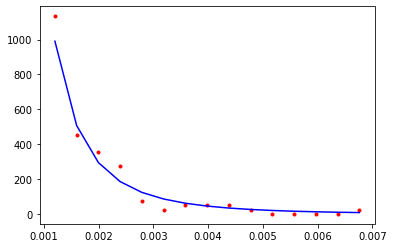

CPU times: user 4.23 ms, sys: 981 µs, total: 5.21 ms
Wall time: 1.79 ms
16453.360522147927


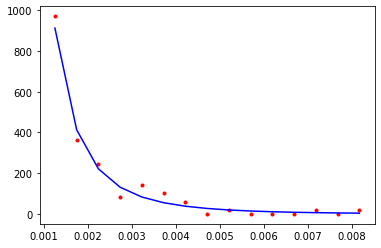

CPU times: user 4.59 ms, sys: 1.01 ms, total: 5.6 ms
Wall time: 1.9 ms
29067.58013758419


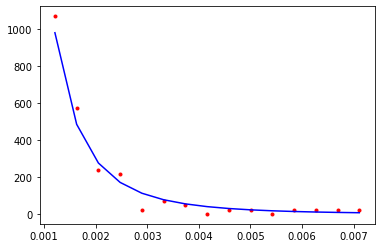

CPU times: user 5.06 ms, sys: 1.12 ms, total: 6.18 ms
Wall time: 2.09 ms
49761.61115744949


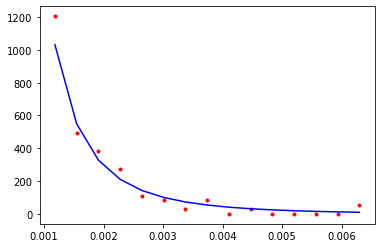

CPU times: user 5.5 ms, sys: 1.13 ms, total: 6.63 ms
Wall time: 2.24 ms
21528.425013234515


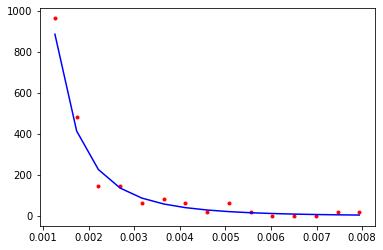

CPU times: user 5.75 ms, sys: 1.19 ms, total: 6.94 ms
Wall time: 2.35 ms
77680.95370954032


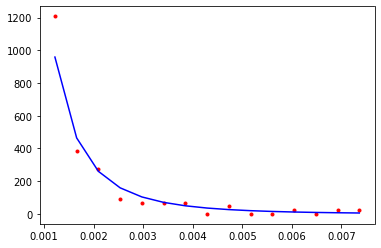

CPU times: user 6.04 ms, sys: 1.09 ms, total: 7.13 ms
Wall time: 2.41 ms
22017.294389904127


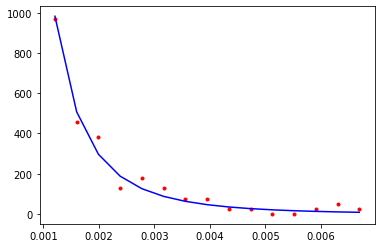

CPU times: user 6.9 ms, sys: 1.34 ms, total: 8.24 ms
Wall time: 2.78 ms
91846.05262899883


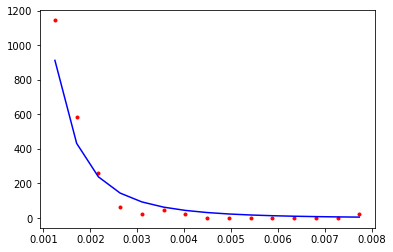

CPU times: user 7.58 ms, sys: 1.5 ms, total: 9.08 ms
Wall time: 3.1 ms
20229.51173238225


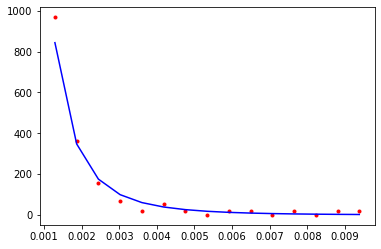

CPU times: user 7.4 ms, sys: 1.3 ms, total: 8.7 ms
Wall time: 2.91 ms
13602.282334665873


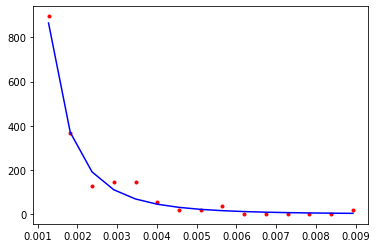

CPU times: user 7.63 ms, sys: 1.33 ms, total: 8.96 ms
Wall time: 3.02 ms
41378.00975292989


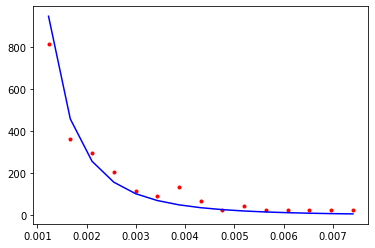

CPU times: user 8.41 ms, sys: 1.53 ms, total: 9.94 ms
Wall time: 3.34 ms
49828.84617207087


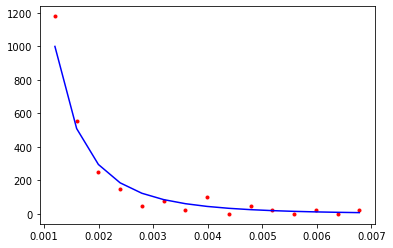

CPU times: user 1.38 ms, sys: 1.25 ms, total: 2.63 ms
Wall time: 853 µs
14211.182366898907


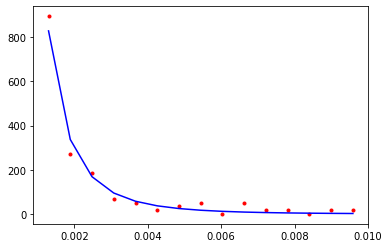

CPU times: user 920 µs, sys: 460 µs, total: 1.38 ms
Wall time: 466 µs
19941.9770341951


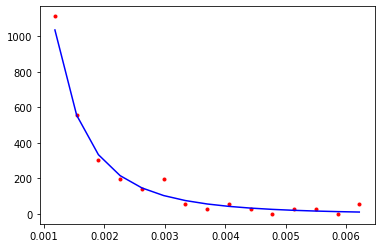

CPU times: user 1.4 ms, sys: 595 µs, total: 2 ms
Wall time: 682 µs
182651.24222368182


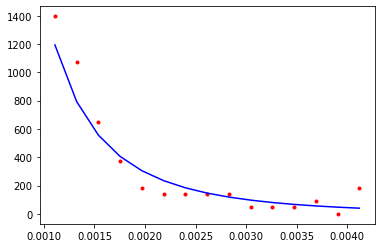

CPU times: user 1.71 ms, sys: 568 µs, total: 2.28 ms
Wall time: 765 µs
14701.824517257492


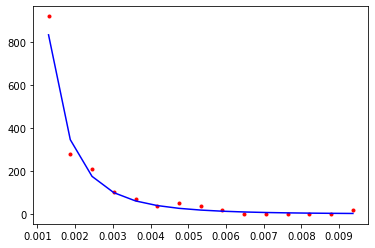

CPU times: user 2.07 ms, sys: 698 µs, total: 2.77 ms
Wall time: 945 µs
43319.71494798778


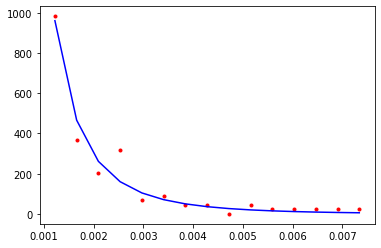

CPU times: user 2.67 ms, sys: 792 µs, total: 3.46 ms
Wall time: 1.21 ms
26168.863766528546


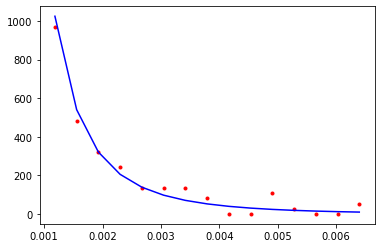

CPU times: user 2.97 ms, sys: 922 µs, total: 3.89 ms
Wall time: 1.35 ms
32545.227467285316


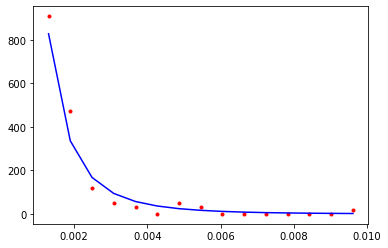

CPU times: user 3.32 ms, sys: 906 µs, total: 4.22 ms
Wall time: 1.46 ms
68734.37000398572


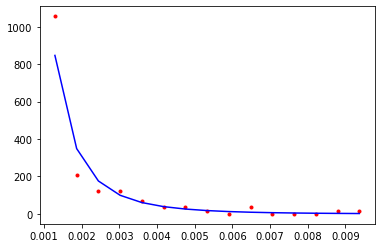

CPU times: user 3.51 ms, sys: 867 µs, total: 4.38 ms
Wall time: 1.5 ms
24232.101048884306


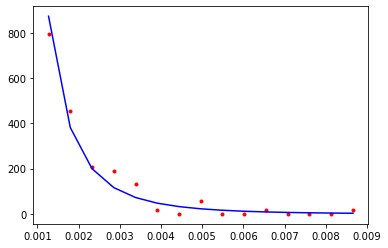

CPU times: user 4.15 ms, sys: 1.06 ms, total: 5.21 ms
Wall time: 1.77 ms
9444.432870404022


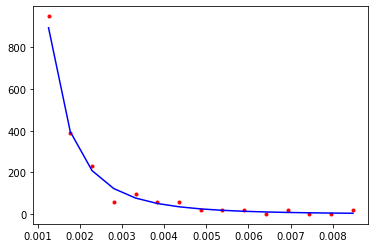

CPU times: user 4.37 ms, sys: 1.12 ms, total: 5.49 ms
Wall time: 1.89 ms
54677.28491743068


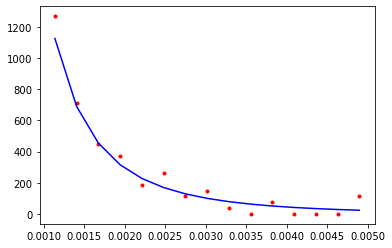

CPU times: user 4.65 ms, sys: 978 µs, total: 5.63 ms
Wall time: 1.9 ms
98141.21557690034


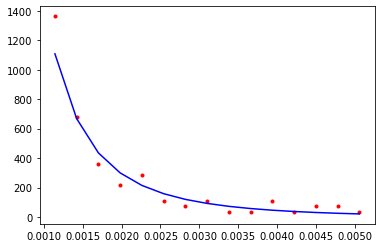

CPU times: user 4.93 ms, sys: 948 µs, total: 5.87 ms
Wall time: 1.98 ms
9041.404367044726


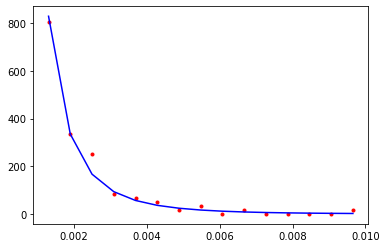

CPU times: user 5.26 ms, sys: 1.03 ms, total: 6.29 ms
Wall time: 2.12 ms
39261.880351381275


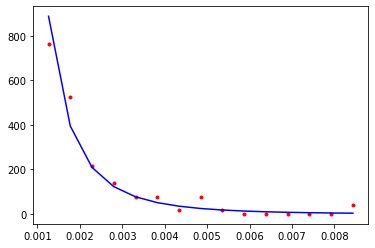

CPU times: user 5.99 ms, sys: 1.29 ms, total: 7.28 ms
Wall time: 2.47 ms
46476.289035326554


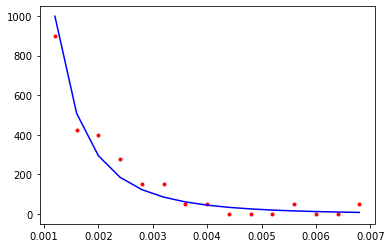

CPU times: user 6.1 ms, sys: 1.22 ms, total: 7.32 ms
Wall time: 2.48 ms
9856.820863480467


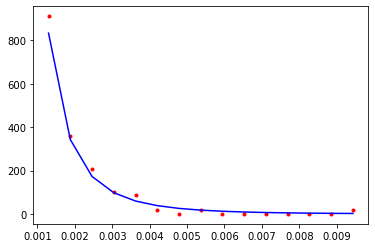

CPU times: user 6.44 ms, sys: 1.16 ms, total: 7.59 ms
Wall time: 2.55 ms
69391.47068498145


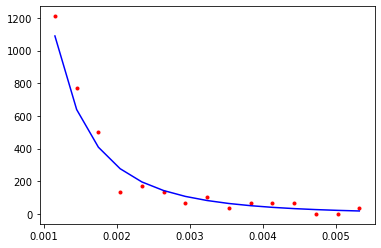

CPU times: user 6.66 ms, sys: 1.52 ms, total: 8.17 ms
Wall time: 2.81 ms
70049.95395912751


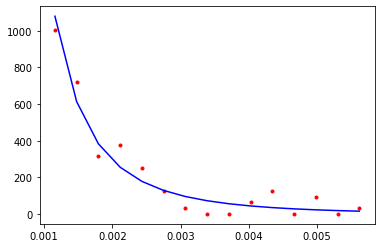

CPU times: user 7.63 ms, sys: 1.41 ms, total: 9.04 ms
Wall time: 3.05 ms
23656.40093431257


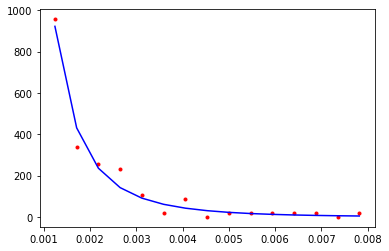

CPU times: user 8.04 ms, sys: 1.53 ms, total: 9.57 ms
Wall time: 3.22 ms
298967.40960087767


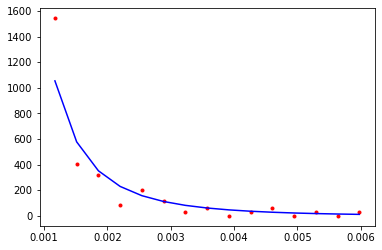

CPU times: user 7.89 ms, sys: 1.38 ms, total: 9.27 ms
Wall time: 3.13 ms
24240.099162726645


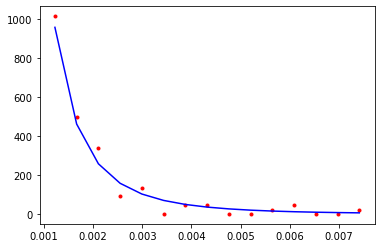

CPU times: user 1.35 ms, sys: 1.41 ms, total: 2.75 ms
Wall time: 904 µs
23403.099329782606


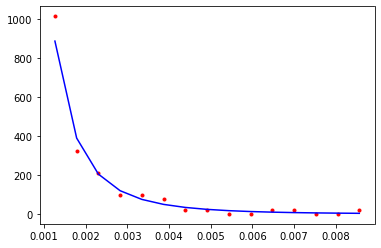

CPU times: user 897 µs, sys: 483 µs, total: 1.38 ms
Wall time: 465 µs
41946.113618746975


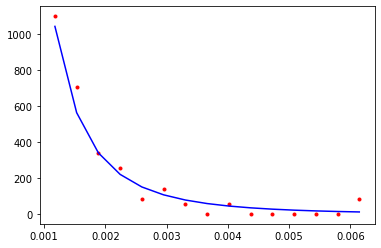

CPU times: user 1.29 ms, sys: 703 µs, total: 1.99 ms
Wall time: 698 µs
28032.422281401337


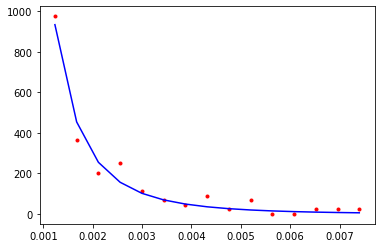

CPU times: user 1.69 ms, sys: 619 µs, total: 2.31 ms
Wall time: 785 µs
20004.569775933134


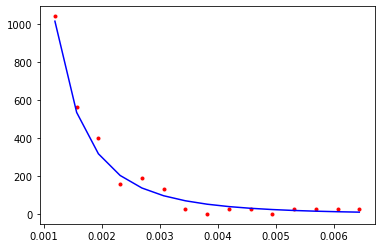

CPU times: user 2.17 ms, sys: 672 µs, total: 2.84 ms
Wall time: 990 µs
18640.184222250577


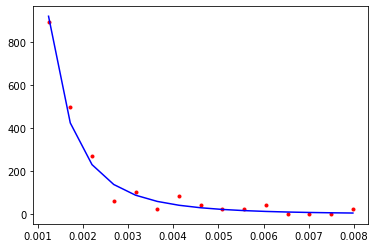

CPU times: user 2.37 ms, sys: 753 µs, total: 3.12 ms
Wall time: 1.08 ms
17673.302637625282


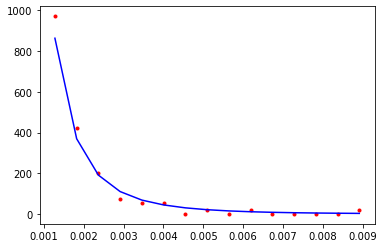

CPU times: user 2.74 ms, sys: 866 µs, total: 3.61 ms
Wall time: 1.25 ms
78990.22842918457


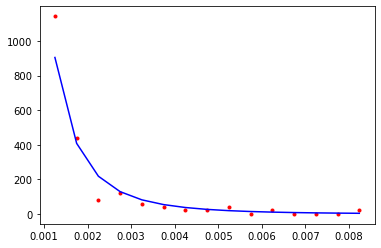

CPU times: user 3.4 ms, sys: 929 µs, total: 4.33 ms
Wall time: 1.49 ms
10346.097491862323


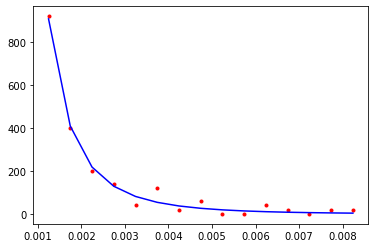

CPU times: user 3.55 ms, sys: 938 µs, total: 4.48 ms
Wall time: 1.52 ms
109975.27919548182


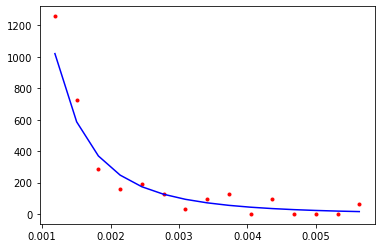

CPU times: user 3.93 ms, sys: 864 µs, total: 4.79 ms
Wall time: 1.62 ms
7573.7544182169295


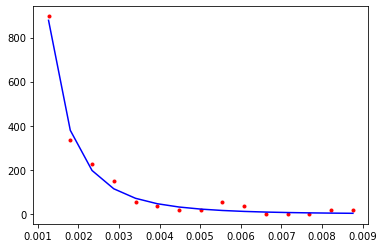

CPU times: user 4.44 ms, sys: 1.02 ms, total: 5.46 ms
Wall time: 1.89 ms
79852.46891187386


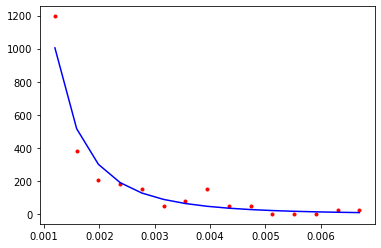

CPU times: user 4.7 ms, sys: 999 µs, total: 5.7 ms
Wall time: 1.92 ms
16174.563620638743


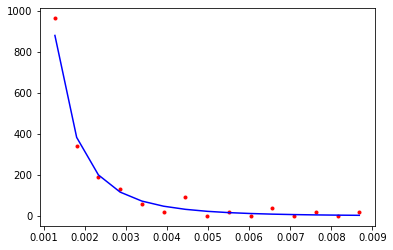

CPU times: user 5.08 ms, sys: 1.05 ms, total: 6.13 ms
Wall time: 2.06 ms
12592.869177640661


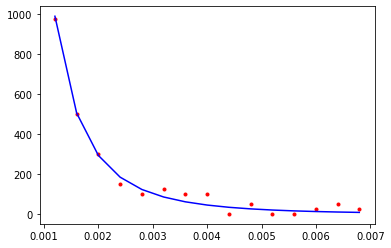

CPU times: user 5.63 ms, sys: 1.08 ms, total: 6.71 ms
Wall time: 2.27 ms
7723.198539995714


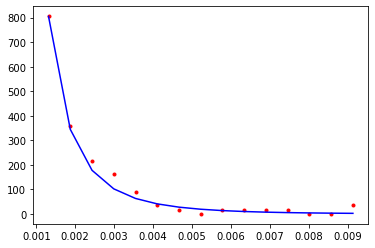

CPU times: user 5.89 ms, sys: 1.2 ms, total: 7.08 ms
Wall time: 2.39 ms
93854.91113191815


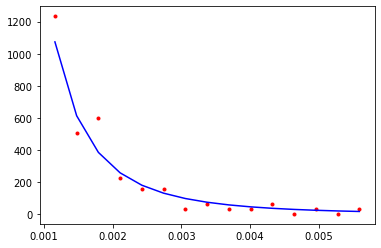

CPU times: user 6.02 ms, sys: 1.17 ms, total: 7.19 ms
Wall time: 2.43 ms
10395.440833576751


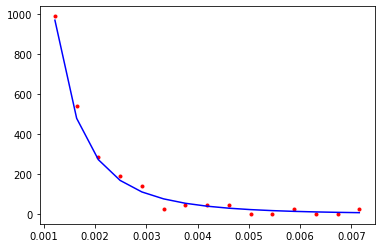

CPU times: user 6.84 ms, sys: 1.26 ms, total: 8.09 ms
Wall time: 2.73 ms
17906.54245228311


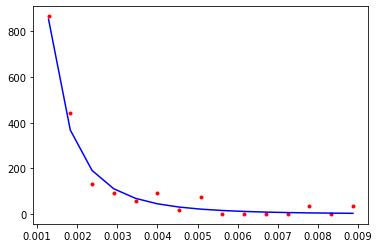

CPU times: user 7 ms, sys: 1.39 ms, total: 8.39 ms
Wall time: 2.83 ms
73651.64445038943


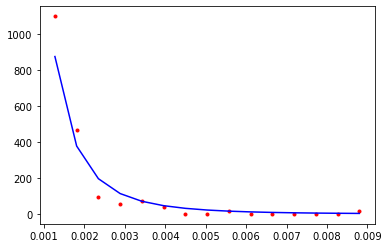

CPU times: user 7.61 ms, sys: 1.54 ms, total: 9.15 ms
Wall time: 3.1 ms
34908.691270191965


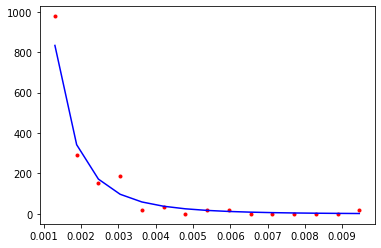

CPU times: user 7.43 ms, sys: 1.51 ms, total: 8.94 ms
Wall time: 3.05 ms
53104.11125332289


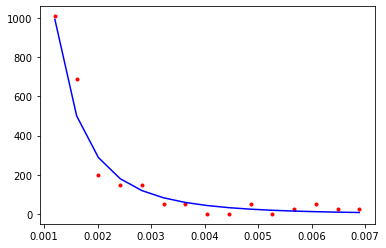

CPU times: user 8.25 ms, sys: 1.5 ms, total: 9.75 ms
Wall time: 3.28 ms
24285.065551786465


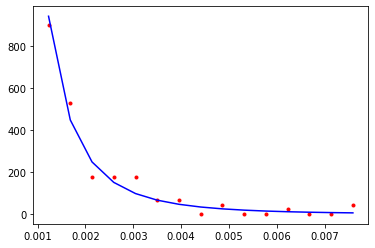

CPU times: user 1.37 ms, sys: 1.31 ms, total: 2.68 ms
Wall time: 847 µs
35091.10163415789


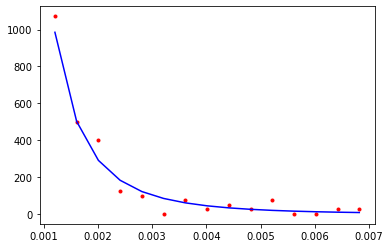

CPU times: user 881 µs, sys: 463 µs, total: 1.34 ms
Wall time: 458 µs
133456.32323695908


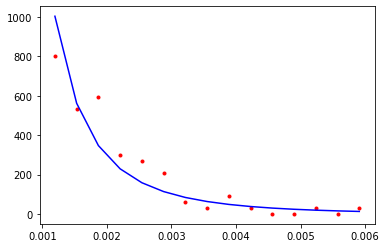

CPU times: user 1.51 ms, sys: 642 µs, total: 2.15 ms
Wall time: 747 µs
18267.103161294588


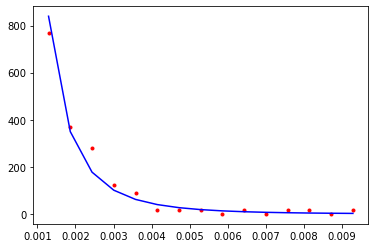

CPU times: user 1.64 ms, sys: 583 µs, total: 2.22 ms
Wall time: 760 µs
9347.955291417835


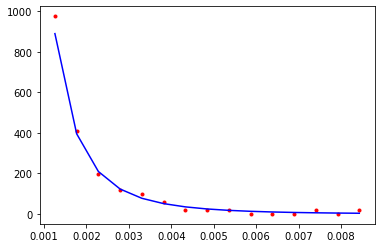

CPU times: user 1.94 ms, sys: 668 µs, total: 2.61 ms
Wall time: 895 µs
217969.81447074347


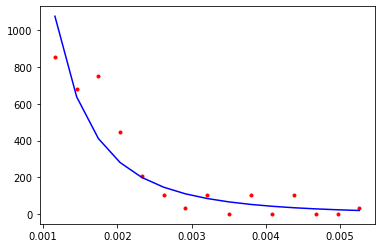

CPU times: user 2.63 ms, sys: 770 µs, total: 3.4 ms
Wall time: 1.16 ms
29809.841489501618


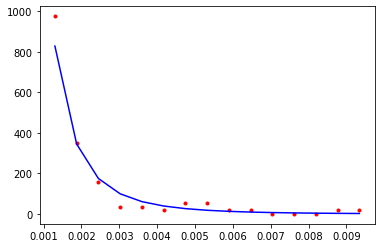

CPU times: user 2.84 ms, sys: 806 µs, total: 3.65 ms
Wall time: 1.23 ms
28511.212385471903


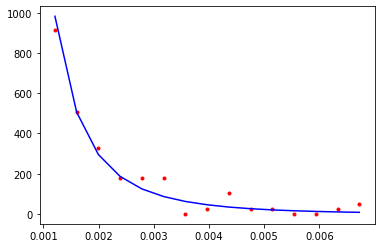

CPU times: user 3.14 ms, sys: 845 µs, total: 3.99 ms
Wall time: 1.35 ms
73752.91979876174


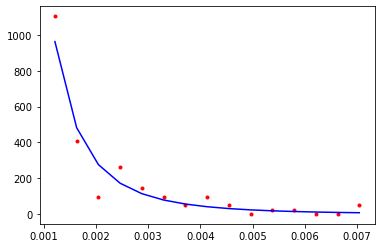

CPU times: user 3.67 ms, sys: 945 µs, total: 4.61 ms
Wall time: 1.59 ms
31893.12911433565


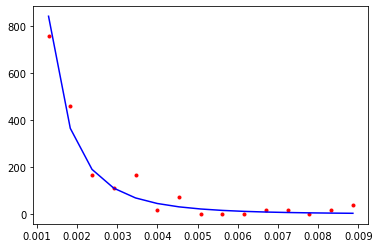

CPU times: user 3.87 ms, sys: 857 µs, total: 4.73 ms
Wall time: 1.61 ms
12849.57004590305


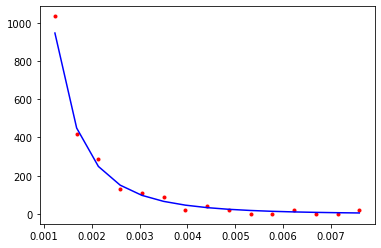

CPU times: user 4.21 ms, sys: 1.05 ms, total: 5.25 ms
Wall time: 1.81 ms
49692.21145182854


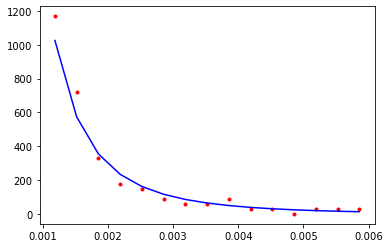

CPU times: user 4.65 ms, sys: 1.09 ms, total: 5.74 ms
Wall time: 1.97 ms
23361.160696675903


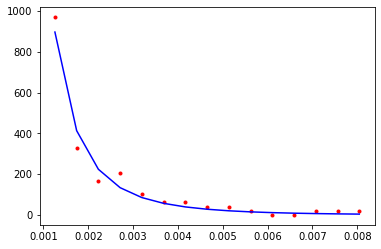

CPU times: user 5.24 ms, sys: 1.15 ms, total: 6.39 ms
Wall time: 2.17 ms
29824.4283377103


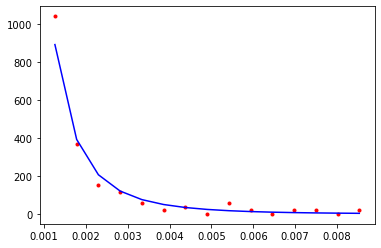

CPU times: user 5.5 ms, sys: 1.08 ms, total: 6.59 ms
Wall time: 2.22 ms
9651.390970899842


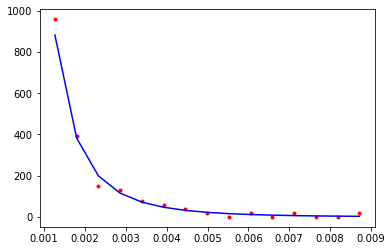

CPU times: user 5.94 ms, sys: 1.27 ms, total: 7.22 ms
Wall time: 2.47 ms
26004.44671013098


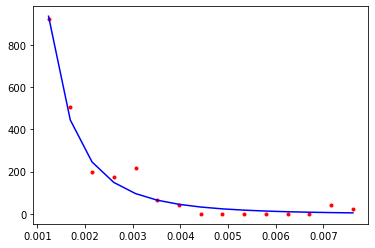

CPU times: user 6.51 ms, sys: 1.27 ms, total: 7.78 ms
Wall time: 2.63 ms
7551.196562638555


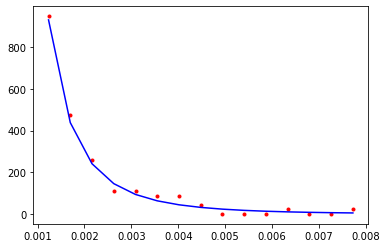

CPU times: user 6.72 ms, sys: 1.34 ms, total: 8.06 ms
Wall time: 2.73 ms
112910.60746880183


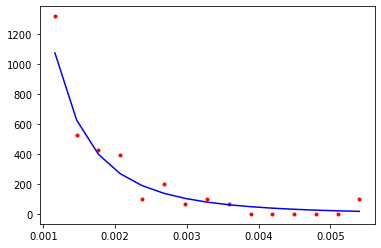

CPU times: user 6.95 ms, sys: 1.3 ms, total: 8.25 ms
Wall time: 2.78 ms
13334.70153623149


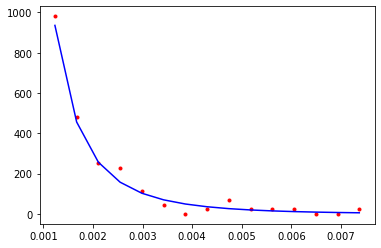

CPU times: user 7.21 ms, sys: 1.5 ms, total: 8.71 ms
Wall time: 2.96 ms
232537.3132784038


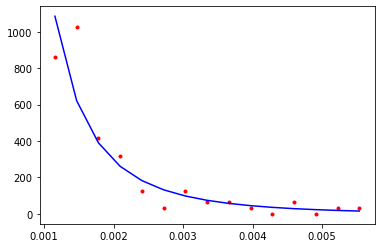

CPU times: user 7.75 ms, sys: 1.48 ms, total: 9.24 ms
Wall time: 3.12 ms
94231.15580401373


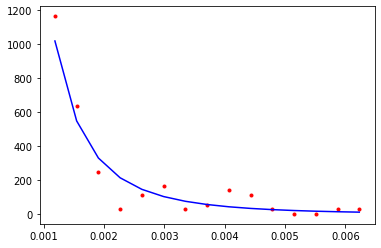

CPU times: user 8.94 ms, sys: 1.75 ms, total: 10.7 ms
Wall time: 3.62 ms
79933.95113019817


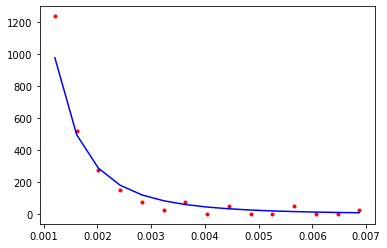

CPU times: user 1.43 ms, sys: 1.24 ms, total: 2.68 ms
Wall time: 868 µs
68745.14757296313


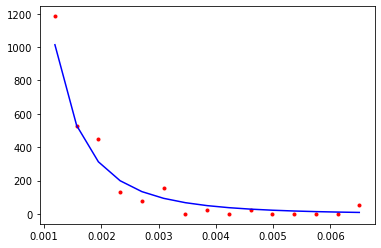

CPU times: user 945 µs, sys: 543 µs, total: 1.49 ms
Wall time: 502 µs
103322.1665321851


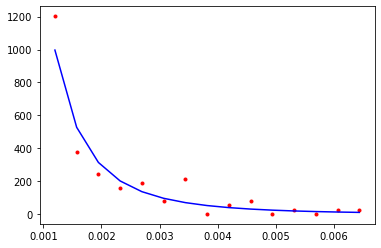

CPU times: user 1.28 ms, sys: 550 µs, total: 1.83 ms
Wall time: 622 µs
11796.328830174953


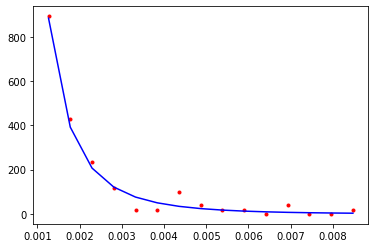

CPU times: user 1.85 ms, sys: 744 µs, total: 2.6 ms
Wall time: 903 µs
64181.53795373715


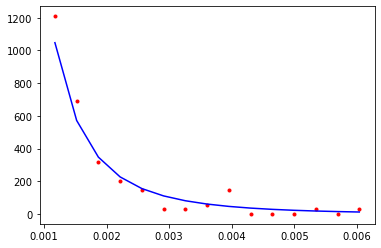

CPU times: user 2 ms, sys: 641 µs, total: 2.64 ms
Wall time: 898 µs
46081.337651194546


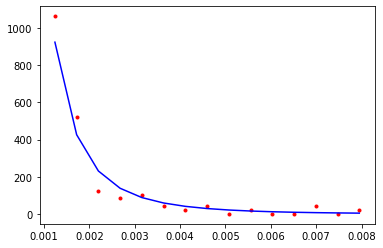

CPU times: user 2.38 ms, sys: 756 µs, total: 3.13 ms
Wall time: 1.07 ms
6847.988687879893


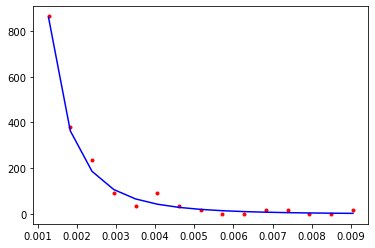

CPU times: user 2.78 ms, sys: 799 µs, total: 3.58 ms
Wall time: 1.22 ms
13450.432431814057


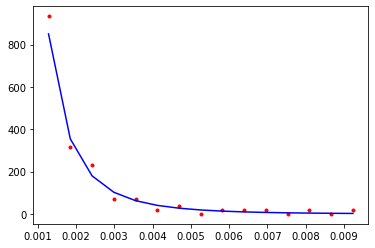

CPU times: user 3.16 ms, sys: 790 µs, total: 3.95 ms
Wall time: 1.34 ms
111053.41742016237


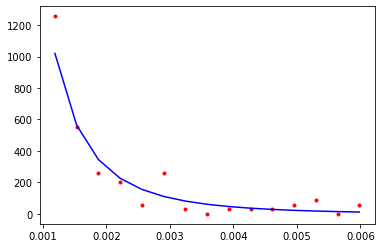

CPU times: user 3.53 ms, sys: 932 µs, total: 4.46 ms
Wall time: 1.53 ms
66805.11499822835


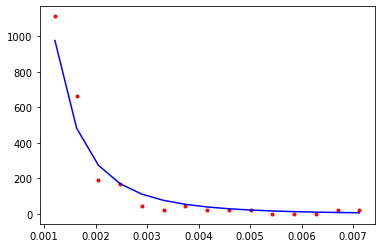

CPU times: user 4.16 ms, sys: 910 µs, total: 5.07 ms
Wall time: 1.71 ms
70187.22281273894


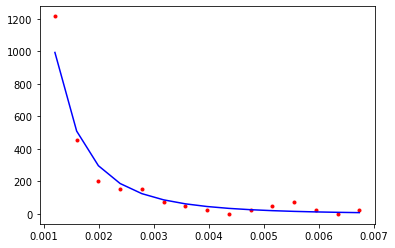

CPU times: user 4.32 ms, sys: 930 µs, total: 5.25 ms
Wall time: 1.78 ms
5895.3828496338865


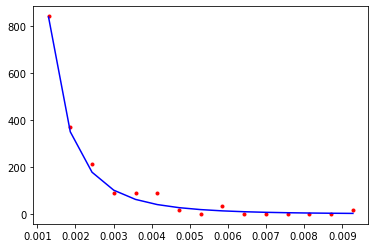

CPU times: user 4.65 ms, sys: 968 µs, total: 5.62 ms
Wall time: 1.91 ms
54822.20227298105


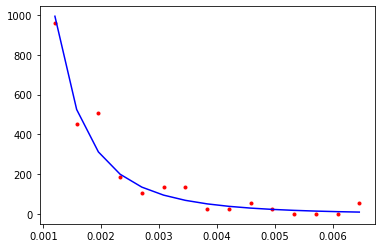

CPU times: user 5.28 ms, sys: 1.13 ms, total: 6.41 ms
Wall time: 2.17 ms
8796.75580364518


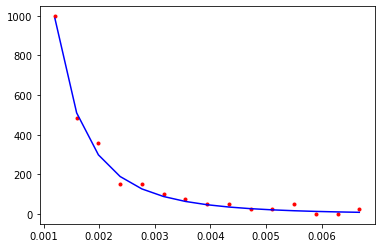

CPU times: user 5.42 ms, sys: 1.2 ms, total: 6.62 ms
Wall time: 2.24 ms
21931.251069306058


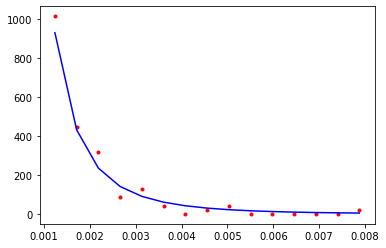

CPU times: user 5.82 ms, sys: 1.36 ms, total: 7.18 ms
Wall time: 2.48 ms
52354.95745143075


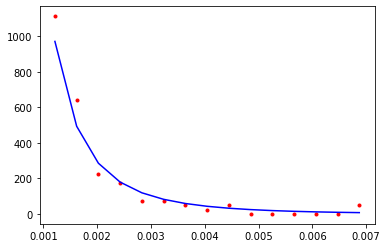

CPU times: user 6.18 ms, sys: 1.2 ms, total: 7.38 ms
Wall time: 2.47 ms
23212.384807692077


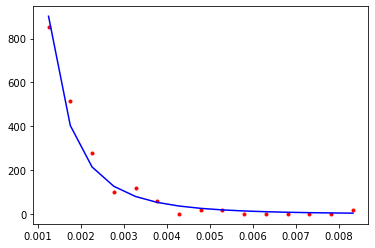

CPU times: user 6.78 ms, sys: 1.24 ms, total: 8.03 ms
Wall time: 2.68 ms
81759.49034099629


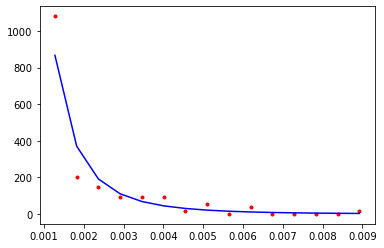

CPU times: user 7.01 ms, sys: 1.31 ms, total: 8.32 ms
Wall time: 2.81 ms
43007.45996564578


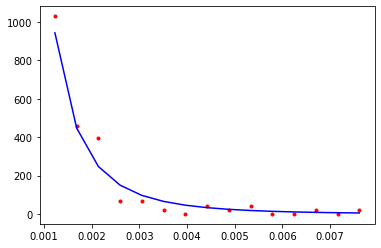

CPU times: user 7.35 ms, sys: 1.3 ms, total: 8.65 ms
Wall time: 2.9 ms
8945.624632760408


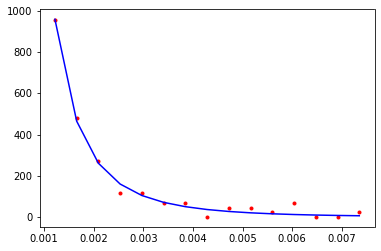

CPU times: user 7.95 ms, sys: 1.46 ms, total: 9.41 ms
Wall time: 3.17 ms
9570.244302245637


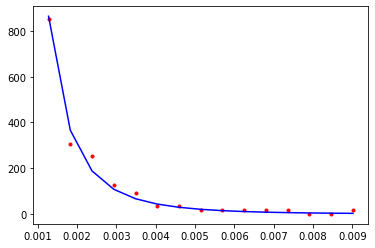

CPU times: user 8.38 ms, sys: 1.48 ms, total: 9.86 ms
Wall time: 3.3 ms
87930.48702657038


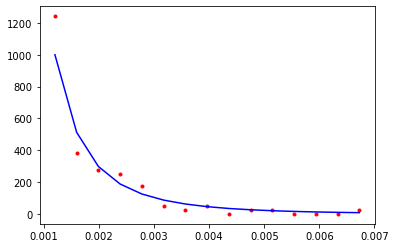

CPU times: user 1.33 ms, sys: 1.23 ms, total: 2.56 ms
Wall time: 825 µs
23662.82788832804


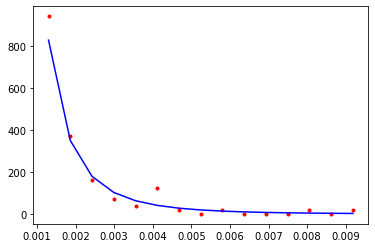

CPU times: user 1.18 ms, sys: 639 µs, total: 1.81 ms
Wall time: 624 µs
60047.88432853191


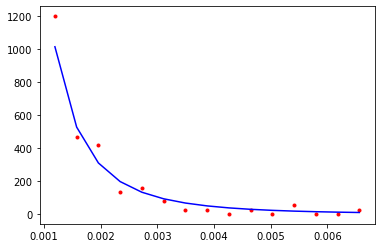

CPU times: user 1.3 ms, sys: 487 µs, total: 1.79 ms
Wall time: 608 µs
37563.90571049637


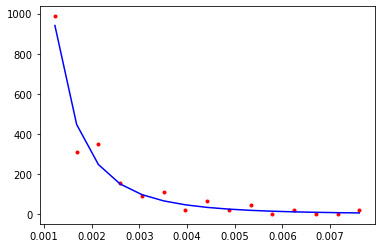

CPU times: user 1.67 ms, sys: 598 µs, total: 2.27 ms
Wall time: 768 µs
55405.02086062805


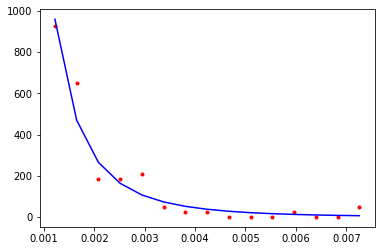

CPU times: user 1.98 ms, sys: 605 µs, total: 2.59 ms
Wall time: 871 µs
20479.697305996866


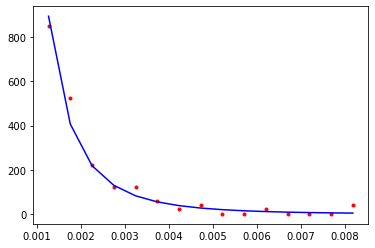

CPU times: user 2.34 ms, sys: 690 µs, total: 3.03 ms
Wall time: 1.04 ms
19862.7120873161


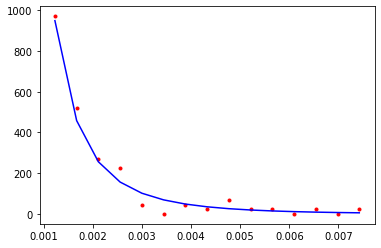

CPU times: user 2.72 ms, sys: 806 µs, total: 3.53 ms
Wall time: 1.21 ms
23876.551606149413


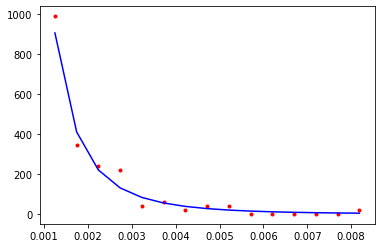

CPU times: user 3.23 ms, sys: 812 µs, total: 4.04 ms
Wall time: 1.36 ms
24455.725245304777


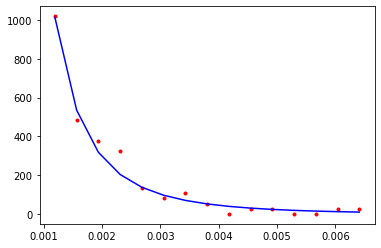

CPU times: user 3.52 ms, sys: 789 µs, total: 4.31 ms
Wall time: 1.46 ms
26429.801330799597


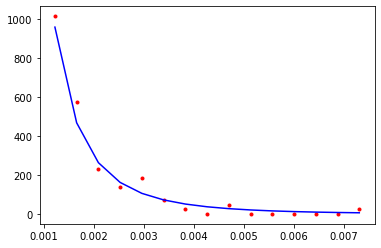

CPU times: user 3.89 ms, sys: 876 µs, total: 4.76 ms
Wall time: 1.61 ms
31209.994008418565


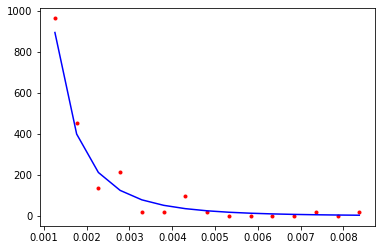

CPU times: user 4.5 ms, sys: 1.05 ms, total: 5.56 ms
Wall time: 1.89 ms
60975.484215081895


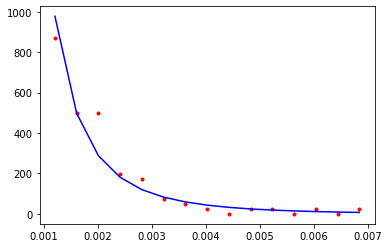

CPU times: user 4.87 ms, sys: 1.07 ms, total: 5.94 ms
Wall time: 2.01 ms
41097.61019515644


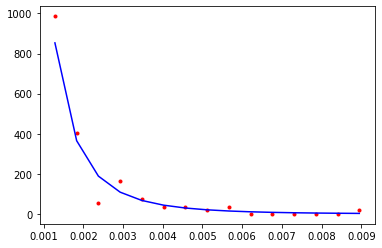

CPU times: user 4.83 ms, sys: 987 µs, total: 5.82 ms
Wall time: 1.97 ms
27812.861522744006


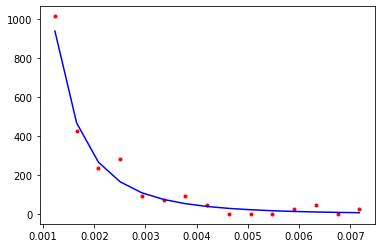

CPU times: user 5.38 ms, sys: 1.13 ms, total: 6.51 ms
Wall time: 2.2 ms
36506.48210152878


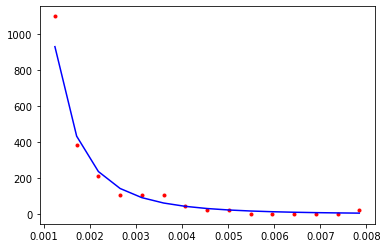

CPU times: user 6.02 ms, sys: 1.23 ms, total: 7.26 ms
Wall time: 2.45 ms
79866.9505963916


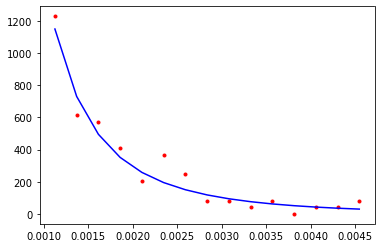

CPU times: user 6.23 ms, sys: 1.23 ms, total: 7.46 ms
Wall time: 2.51 ms
34285.45636680293


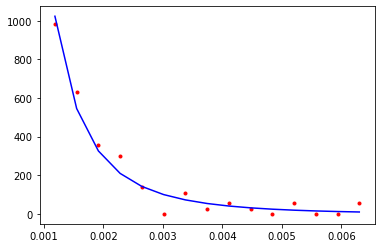

CPU times: user 6.43 ms, sys: 1.14 ms, total: 7.57 ms
Wall time: 2.54 ms
66474.14930143225


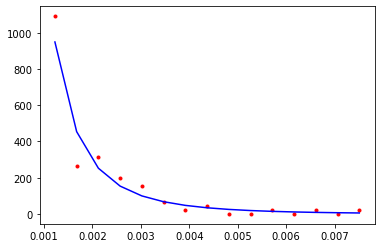

CPU times: user 7.11 ms, sys: 1.39 ms, total: 8.51 ms
Wall time: 2.88 ms
34384.62537368446


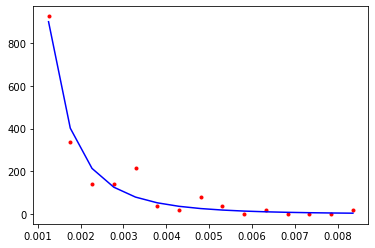

CPU times: user 7.56 ms, sys: 1.42 ms, total: 8.98 ms
Wall time: 3.03 ms
69313.35264194869


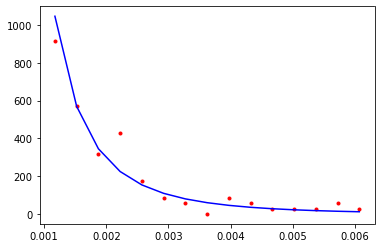

CPU times: user 7.86 ms, sys: 1.34 ms, total: 9.2 ms
Wall time: 3.08 ms
25045.395345003566


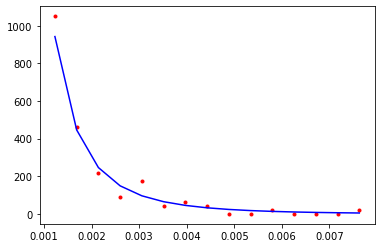

CPU times: user 8.47 ms, sys: 1.51 ms, total: 9.99 ms
Wall time: 3.35 ms
37816.06788152465


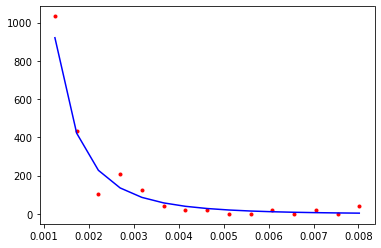

CPU times: user 1.21 ms, sys: 1.13 ms, total: 2.34 ms
Wall time: 770 µs
41938.331500600565


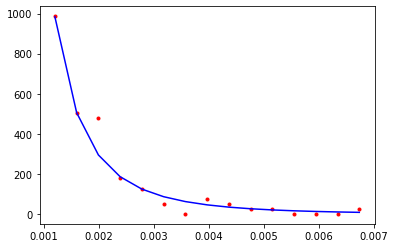

CPU times: user 975 µs, sys: 624 µs, total: 1.6 ms
Wall time: 548 µs
37726.245990208285


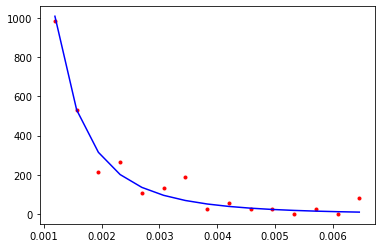

CPU times: user 1.06 ms, sys: 446 µs, total: 1.5 ms
Wall time: 514 µs
5928.3108747775


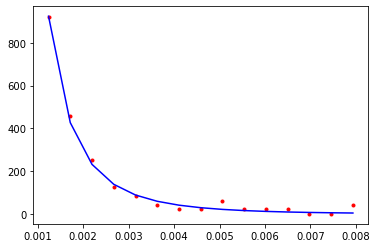

CPU times: user 1.65 ms, sys: 569 µs, total: 2.22 ms
Wall time: 753 µs
17740.67411374615


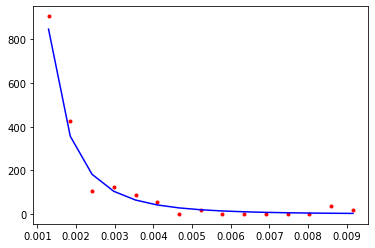

CPU times: user 2 ms, sys: 710 µs, total: 2.71 ms
Wall time: 933 µs
60707.58523065874


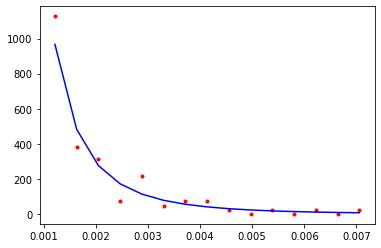

CPU times: user 1.57 ms, sys: 555 µs, total: 2.12 ms
Wall time: 1.6 ms
32760.344604652728


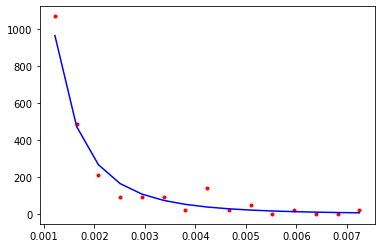

CPU times: user 2.54 ms, sys: 1.17 ms, total: 3.71 ms
Wall time: 1.39 ms
42605.24883345482


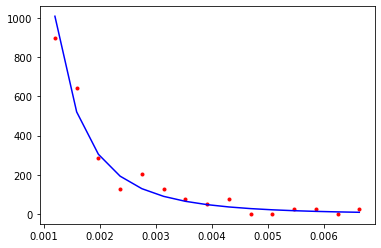

CPU times: user 2.99 ms, sys: 840 µs, total: 3.83 ms
Wall time: 1.33 ms
75017.70614436363


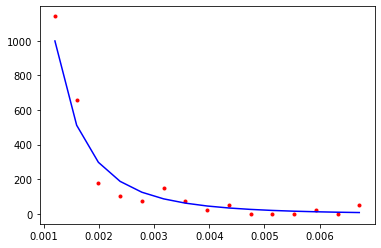

CPU times: user 3.72 ms, sys: 972 µs, total: 4.7 ms
Wall time: 1.62 ms
14504.18305055442


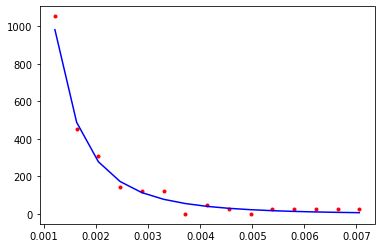

CPU times: user 3.78 ms, sys: 890 µs, total: 4.67 ms
Wall time: 1.6 ms
73815.48604358222


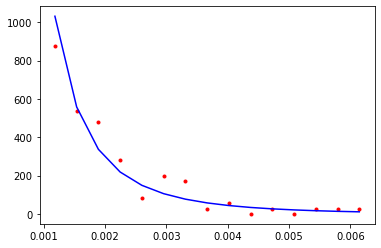

CPU times: user 4.08 ms, sys: 851 µs, total: 4.93 ms
Wall time: 1.66 ms
33345.49040621373


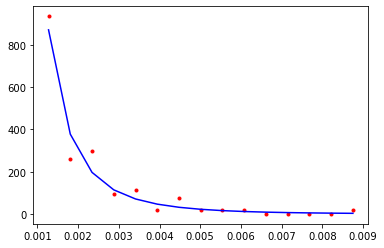

CPU times: user 4.7 ms, sys: 1.04 ms, total: 5.74 ms
Wall time: 1.94 ms
83569.91304666629


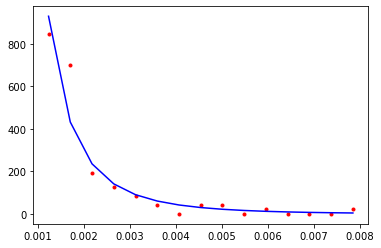

CPU times: user 4.88 ms, sys: 1.26 ms, total: 6.14 ms
Wall time: 2.12 ms
25213.126239578552


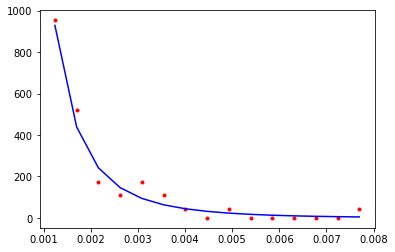

CPU times: user 5.43 ms, sys: 1.13 ms, total: 6.56 ms
Wall time: 2.22 ms
97472.50784891218


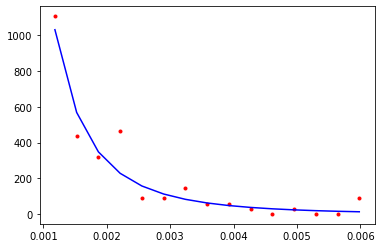

CPU times: user 5.89 ms, sys: 1.12 ms, total: 7.01 ms
Wall time: 2.36 ms
29037.878819167174


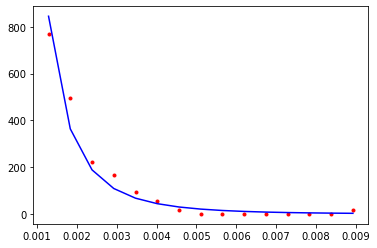

CPU times: user 6.48 ms, sys: 1.38 ms, total: 7.86 ms
Wall time: 2.67 ms
83964.2805872902


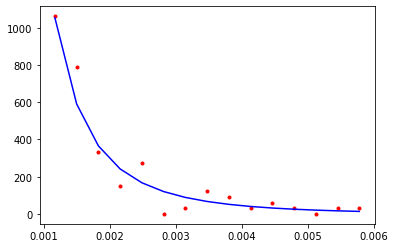

CPU times: user 6.73 ms, sys: 1.25 ms, total: 7.98 ms
Wall time: 2.68 ms
27138.29046773635


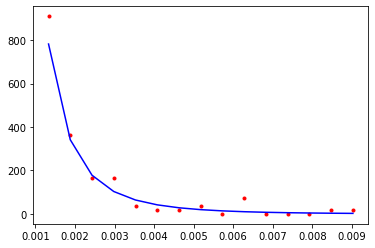

CPU times: user 6.89 ms, sys: 1.3 ms, total: 8.19 ms
Wall time: 2.77 ms
31197.421817051803


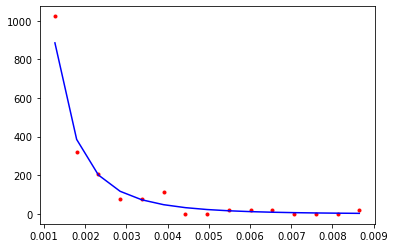

CPU times: user 7.62 ms, sys: 1.41 ms, total: 9.03 ms
Wall time: 3.03 ms
15793.951450327451


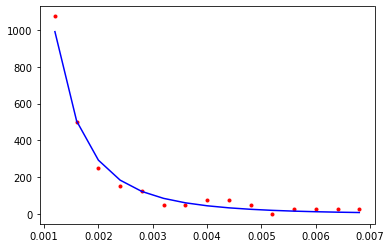

CPU times: user 7.89 ms, sys: 1.4 ms, total: 9.29 ms
Wall time: 3.12 ms
36353.335907287445


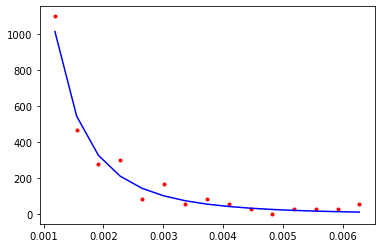

CPU times: user 8.18 ms, sys: 1.36 ms, total: 9.53 ms
Wall time: 3.18 ms
71189.1987183051


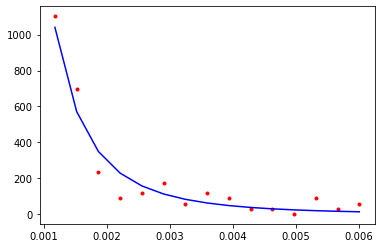

CPU times: user 1.19 ms, sys: 1.17 ms, total: 2.36 ms
Wall time: 770 µs
11323.322716800727


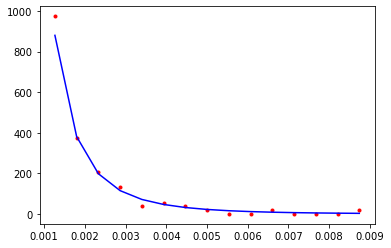

CPU times: user 962 µs, sys: 519 µs, total: 1.48 ms
Wall time: 506 µs
48864.294908954034


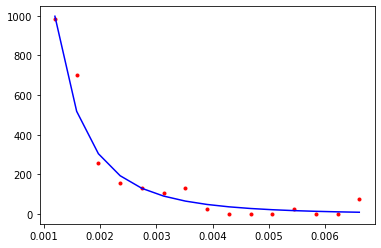

CPU times: user 1.32 ms, sys: 545 µs, total: 1.86 ms
Wall time: 627 µs
76203.89553593844


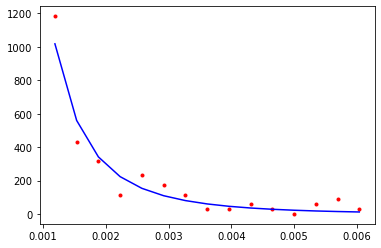

CPU times: user 1.66 ms, sys: 525 µs, total: 2.19 ms
Wall time: 738 µs
73667.16282979341


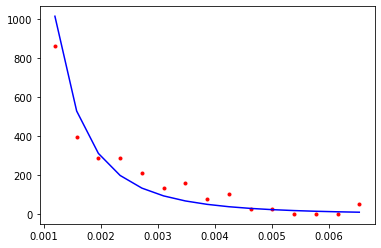

CPU times: user 2.14 ms, sys: 779 µs, total: 2.92 ms
Wall time: 1.01 ms
72767.46589666426


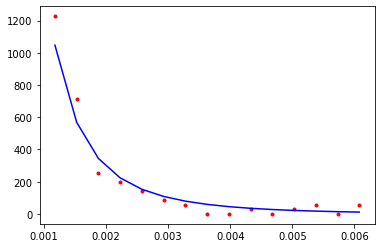

CPU times: user 2.34 ms, sys: 715 µs, total: 3.06 ms
Wall time: 1.05 ms
63585.61108866987


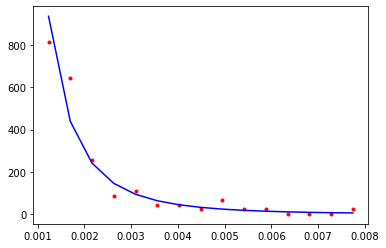

CPU times: user 2.73 ms, sys: 760 µs, total: 3.49 ms
Wall time: 1.19 ms
24847.48723957852


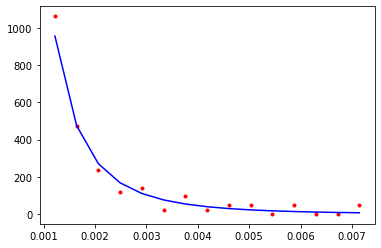

CPU times: user 3.45 ms, sys: 966 µs, total: 4.42 ms
Wall time: 1.52 ms
60620.97722718643


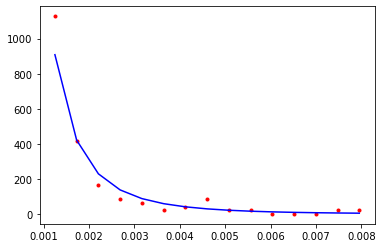

CPU times: user 3.5 ms, sys: 886 µs, total: 4.38 ms
Wall time: 1.5 ms
25070.22095739038


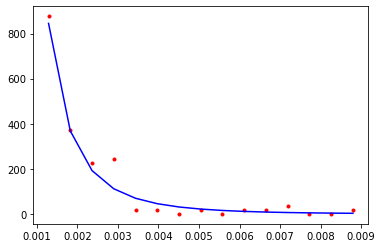

CPU times: user 3.65 ms, sys: 797 µs, total: 4.45 ms
Wall time: 1.51 ms
61842.34864622084


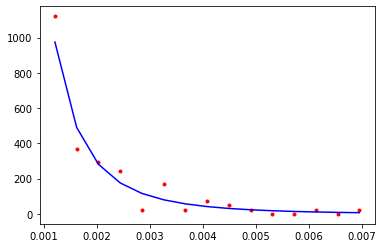

CPU times: user 4.23 ms, sys: 901 µs, total: 5.13 ms
Wall time: 1.74 ms
86568.97018165197


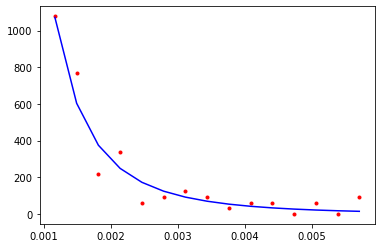

CPU times: user 4.66 ms, sys: 970 µs, total: 5.63 ms
Wall time: 1.9 ms
61662.61099321213


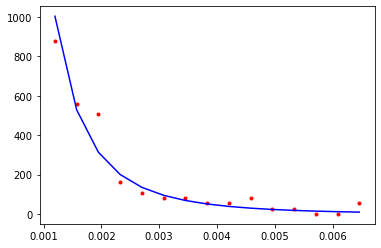

CPU times: user 4.81 ms, sys: 1.19 ms, total: 6 ms
Wall time: 2.08 ms
80986.12153291752


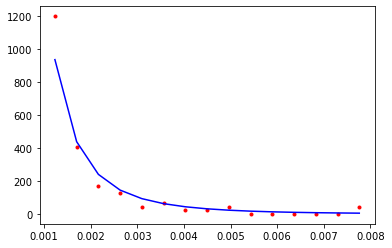

CPU times: user 5.62 ms, sys: 1.26 ms, total: 6.88 ms
Wall time: 2.34 ms
29855.492991513547


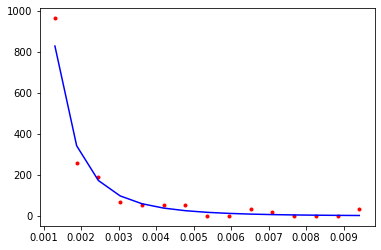

CPU times: user 5.8 ms, sys: 1.2 ms, total: 7 ms
Wall time: 2.36 ms
96733.26566905709


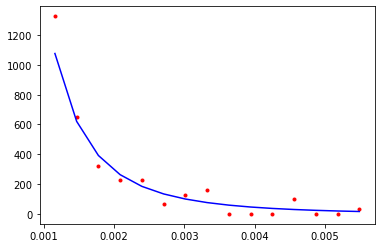

CPU times: user 6.16 ms, sys: 1.15 ms, total: 7.32 ms
Wall time: 2.47 ms
12537.892012460692


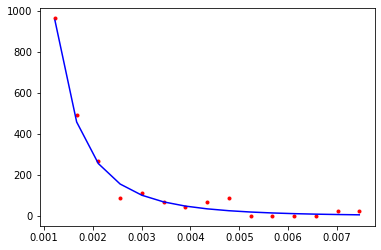

CPU times: user 6.83 ms, sys: 1.31 ms, total: 8.15 ms
Wall time: 2.74 ms
41401.77386879086


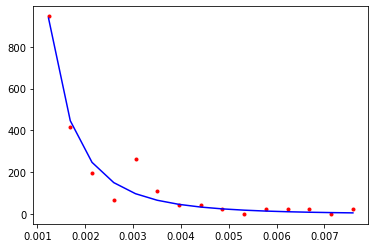

CPU times: user 7.18 ms, sys: 1.34 ms, total: 8.52 ms
Wall time: 2.87 ms
48739.83490912425


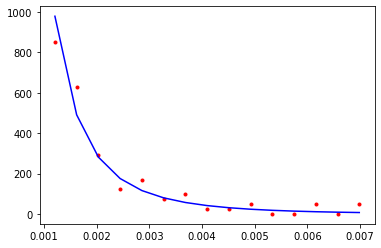

CPU times: user 7.31 ms, sys: 1.29 ms, total: 8.6 ms
Wall time: 2.88 ms
63776.031787416076


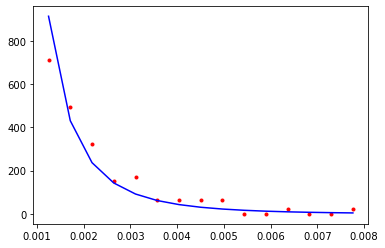

CPU times: user 7.65 ms, sys: 1.43 ms, total: 9.08 ms
Wall time: 3.08 ms
34108.89063189575


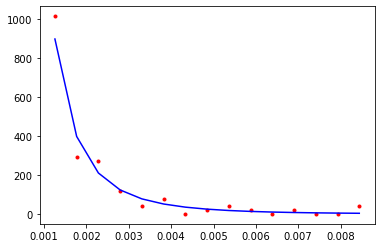

CPU times: user 8.07 ms, sys: 1.38 ms, total: 9.45 ms
Wall time: 3.15 ms
215712.5152531625


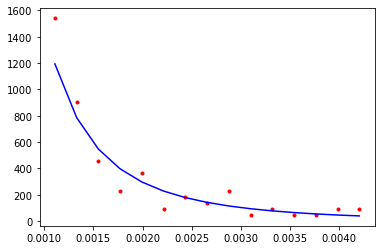

CPU times: user 1.2 ms, sys: 1.07 ms, total: 2.26 ms
Wall time: 728 µs
33692.506715977135


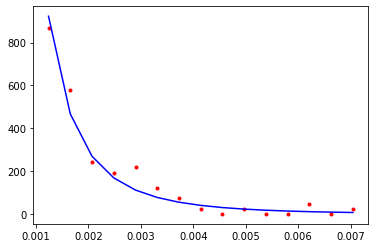

CPU times: user 894 µs, sys: 528 µs, total: 1.42 ms
Wall time: 490 µs
53095.33606843104


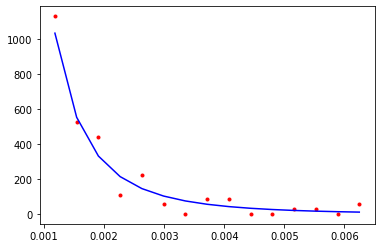

CPU times: user 1.53 ms, sys: 643 µs, total: 2.17 ms
Wall time: 747 µs
24922.247489004392


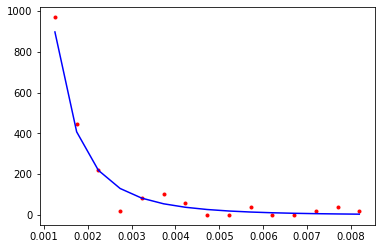

CPU times: user 1.67 ms, sys: 558 µs, total: 2.23 ms
Wall time: 760 µs
26448.58705677709


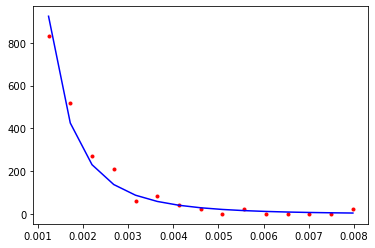

CPU times: user 2.18 ms, sys: 752 µs, total: 2.93 ms
Wall time: 1.02 ms
36070.693729669365


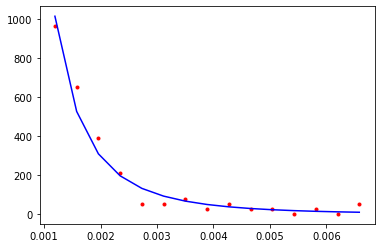

CPU times: user 2.36 ms, sys: 742 µs, total: 3.1 ms
Wall time: 1.07 ms
53951.340835260875


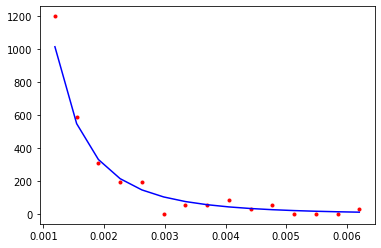

CPU times: user 2.83 ms, sys: 801 µs, total: 3.63 ms
Wall time: 1.24 ms
24460.03949486933


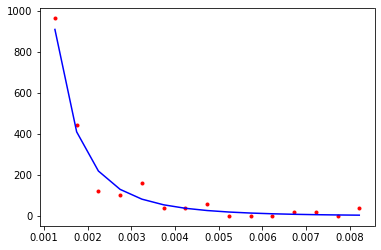

CPU times: user 3.12 ms, sys: 823 µs, total: 3.95 ms
Wall time: 1.34 ms
30468.7467611512


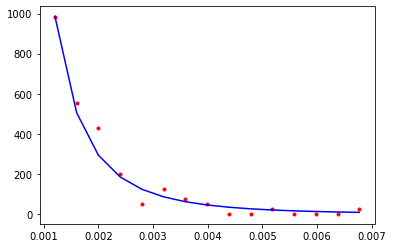

CPU times: user 3.59 ms, sys: 966 µs, total: 4.56 ms
Wall time: 1.54 ms
49383.28885691658


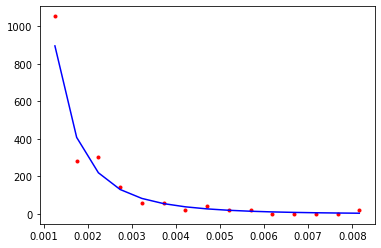

CPU times: user 3.94 ms, sys: 893 µs, total: 4.83 ms
Wall time: 1.63 ms
61904.07452195684


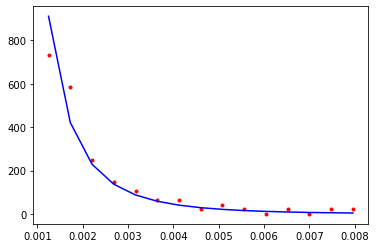

CPU times: user 4.73 ms, sys: 1.25 ms, total: 5.98 ms
Wall time: 2.03 ms
72826.07026403454


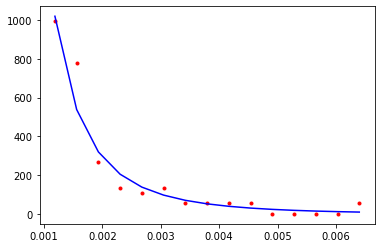

CPU times: user 4.85 ms, sys: 1.23 ms, total: 6.08 ms
Wall time: 2.09 ms
9207.263381539557


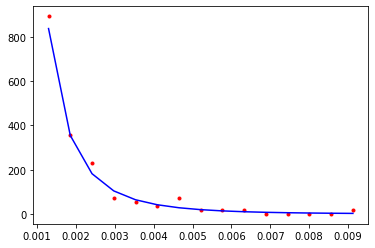

CPU times: user 4.97 ms, sys: 1.05 ms, total: 6.02 ms
Wall time: 2.04 ms
25064.555701367273


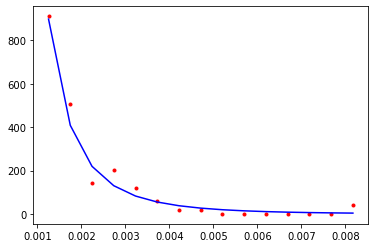

CPU times: user 5.46 ms, sys: 1.11 ms, total: 6.58 ms
Wall time: 2.22 ms
40281.32329050438


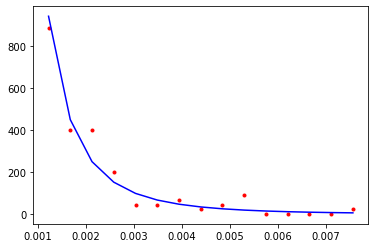

CPU times: user 5.99 ms, sys: 1.21 ms, total: 7.2 ms
Wall time: 2.44 ms
177635.92634133936


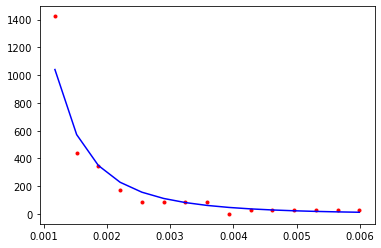

CPU times: user 6.22 ms, sys: 1.2 ms, total: 7.42 ms
Wall time: 2.49 ms
17152.03001942788


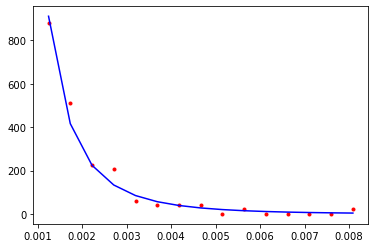

CPU times: user 6.68 ms, sys: 1.26 ms, total: 7.94 ms
Wall time: 2.68 ms
47539.807097936624


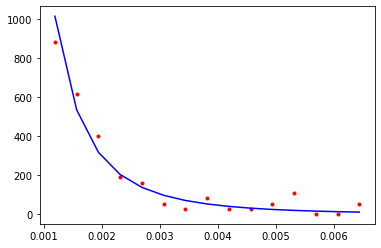

CPU times: user 7 ms, sys: 1.29 ms, total: 8.3 ms
Wall time: 2.8 ms
19939.325130163623


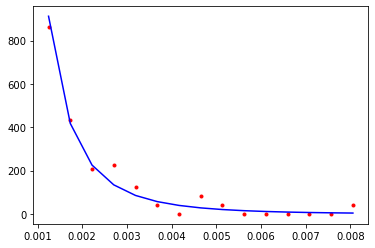

CPU times: user 7.4 ms, sys: 1.35 ms, total: 8.74 ms
Wall time: 2.93 ms
9302.561452834801


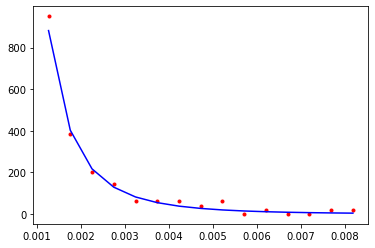

CPU times: user 7.69 ms, sys: 1.25 ms, total: 8.94 ms
Wall time: 2.98 ms
60153.152634100756


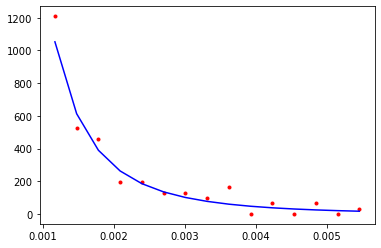

CPU times: user 8.26 ms, sys: 1.45 ms, total: 9.71 ms
Wall time: 3.25 ms
12323.377520747359


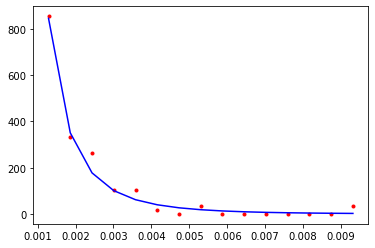

CPU times: user 1.25 ms, sys: 1.23 ms, total: 2.48 ms
Wall time: 820 µs
44245.83339878619


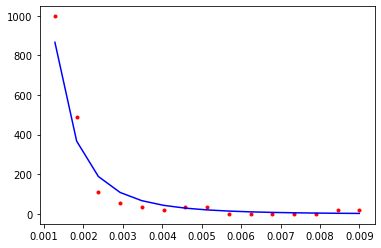

CPU times: user 900 µs, sys: 529 µs, total: 1.43 ms
Wall time: 493 µs
38494.30506933229


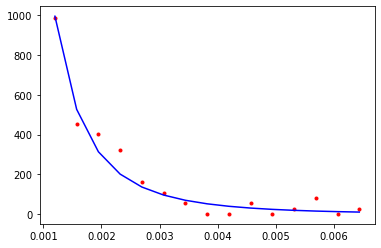

CPU times: user 1.44 ms, sys: 636 µs, total: 2.07 ms
Wall time: 716 µs
23465.967966677767


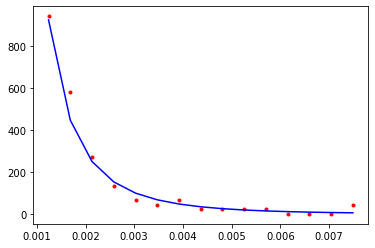

CPU times: user 1.82 ms, sys: 754 µs, total: 2.58 ms
Wall time: 893 µs
145199.17400690357


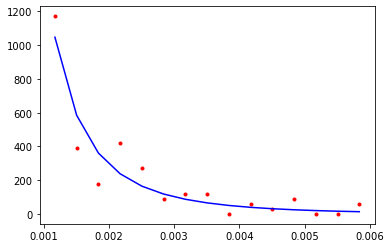

CPU times: user 2.05 ms, sys: 649 µs, total: 2.7 ms
Wall time: 913 µs
20052.972799681607


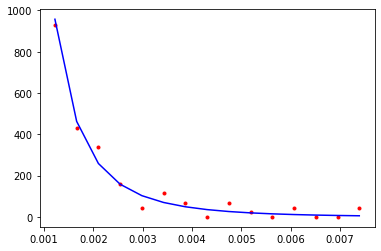

CPU times: user 2.36 ms, sys: 748 µs, total: 3.11 ms
Wall time: 1.07 ms
46297.079068251674


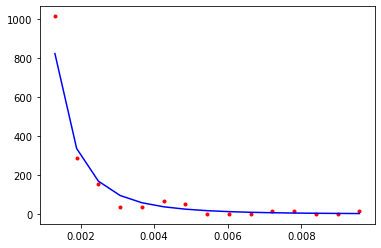

CPU times: user 2.79 ms, sys: 747 µs, total: 3.54 ms
Wall time: 1.21 ms
60598.40191670755


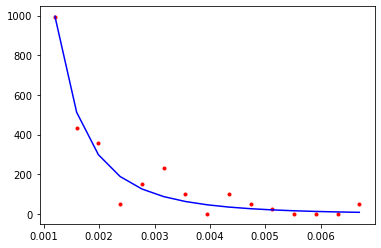

CPU times: user 3.15 ms, sys: 876 µs, total: 4.03 ms
Wall time: 1.38 ms
25587.963459170962


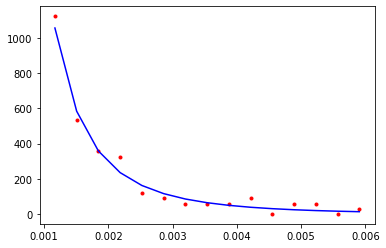

CPU times: user 3.52 ms, sys: 851 µs, total: 4.37 ms
Wall time: 1.47 ms
95779.74710230784


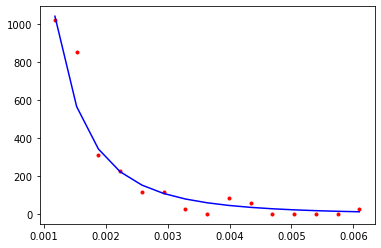

CPU times: user 4.21 ms, sys: 1.03 ms, total: 5.24 ms
Wall time: 1.79 ms
38106.53224224427


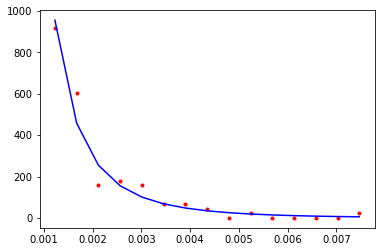

CPU times: user 4.26 ms, sys: 975 µs, total: 5.24 ms
Wall time: 1.77 ms
15186.528689304627


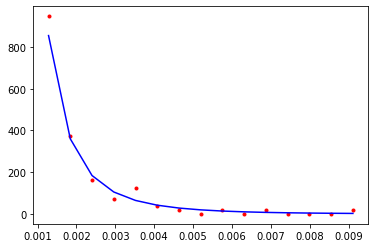

CPU times: user 4.71 ms, sys: 969 µs, total: 5.68 ms
Wall time: 1.93 ms
22362.21516318621


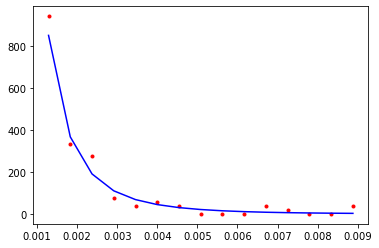

CPU times: user 5.25 ms, sys: 1.22 ms, total: 6.48 ms
Wall time: 2.22 ms
33064.88934416944


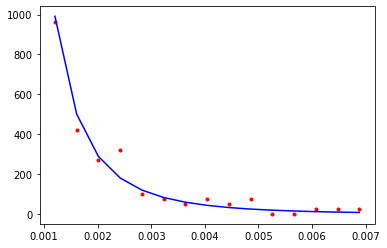

CPU times: user 5.56 ms, sys: 1.2 ms, total: 6.77 ms
Wall time: 2.29 ms
49737.28996455531


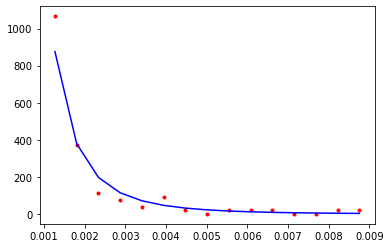

CPU times: user 5.95 ms, sys: 1.58 ms, total: 7.53 ms
Wall time: 2.64 ms
21605.3734695523


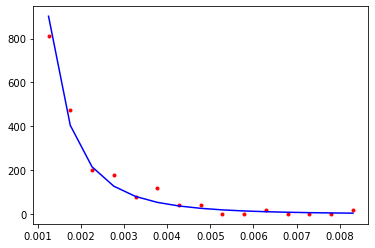

CPU times: user 6.18 ms, sys: 1.37 ms, total: 7.56 ms
Wall time: 2.62 ms
40638.067077527834


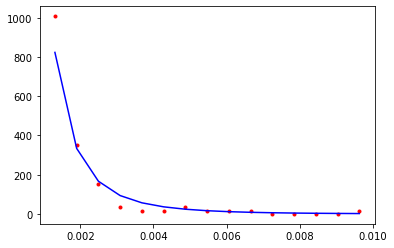

CPU times: user 6.47 ms, sys: 1.63 ms, total: 8.1 ms
Wall time: 2.89 ms
39474.285189966075


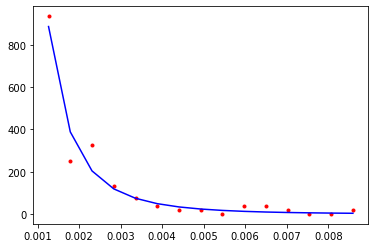

CPU times: user 7.18 ms, sys: 1.46 ms, total: 8.65 ms
Wall time: 2.94 ms
53772.124621429364


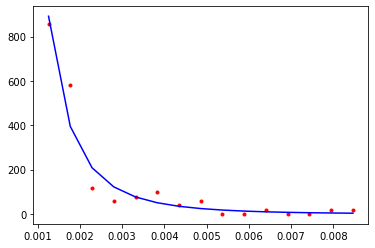

CPU times: user 7.01 ms, sys: 1.66 ms, total: 8.67 ms
Wall time: 3.05 ms
8158.687001871188


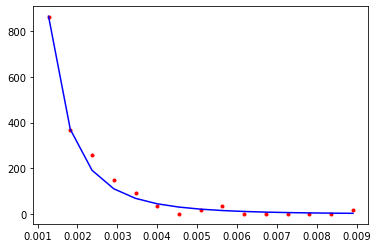

CPU times: user 7.77 ms, sys: 1.55 ms, total: 9.32 ms
Wall time: 3.19 ms
52212.004339571205


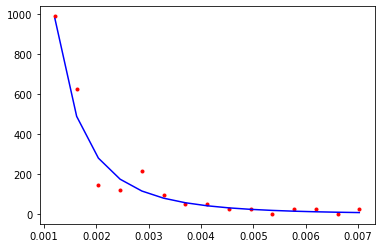

CPU times: user 8.02 ms, sys: 1.44 ms, total: 9.46 ms
Wall time: 3.19 ms
171360.4572932227


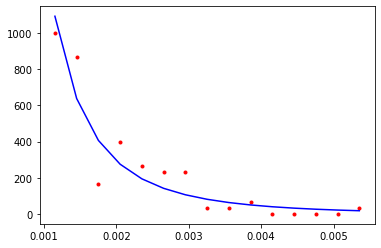

CPU times: user 1.29 ms, sys: 1.3 ms, total: 2.59 ms
Wall time: 837 µs
39712.96042170475


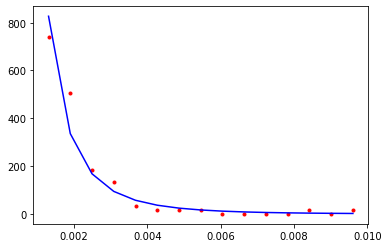

CPU times: user 1.16 ms, sys: 590 µs, total: 1.75 ms
Wall time: 604 µs
79490.87971666125


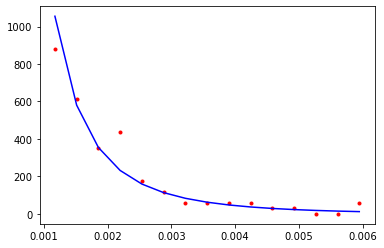

CPU times: user 1.29 ms, sys: 545 µs, total: 1.83 ms
Wall time: 629 µs
26498.171837859954


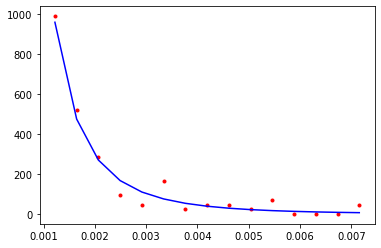

CPU times: user 1.81 ms, sys: 664 µs, total: 2.47 ms
Wall time: 826 µs
48514.09142866561


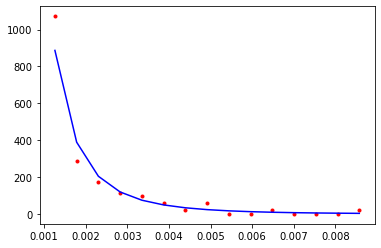

CPU times: user 2.03 ms, sys: 642 µs, total: 2.67 ms
Wall time: 914 µs
22948.531644065224


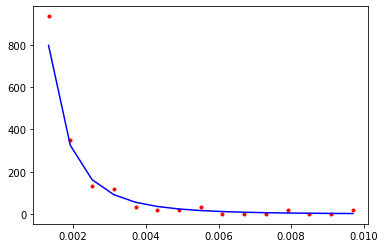

CPU times: user 2.39 ms, sys: 755 µs, total: 3.14 ms
Wall time: 1.07 ms
32665.158342112816


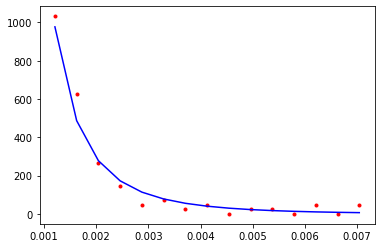

CPU times: user 3.01 ms, sys: 926 µs, total: 3.94 ms
Wall time: 1.35 ms
33226.72765562052


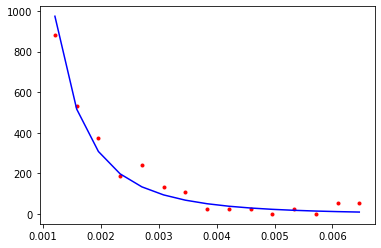

CPU times: user 3.35 ms, sys: 935 µs, total: 4.29 ms
Wall time: 1.49 ms
45668.0797345016


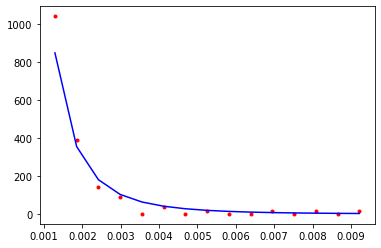

CPU times: user 3.51 ms, sys: 893 µs, total: 4.4 ms
Wall time: 1.49 ms
15152.42670370947


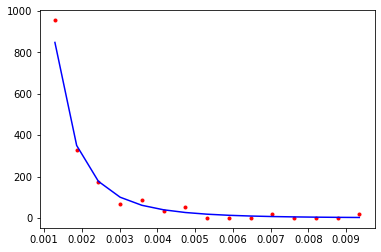

CPU times: user 3.92 ms, sys: 910 µs, total: 4.83 ms
Wall time: 1.64 ms
68648.04948627019


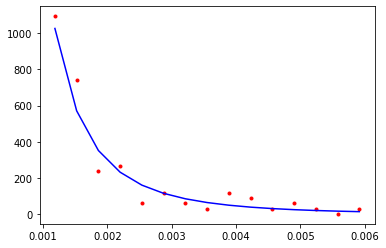

CPU times: user 4.18 ms, sys: 944 µs, total: 5.13 ms
Wall time: 1.75 ms
16497.468281142254


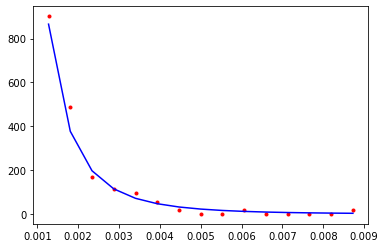

CPU times: user 4.97 ms, sys: 1.17 ms, total: 6.14 ms
Wall time: 2.08 ms
29290.631735020725


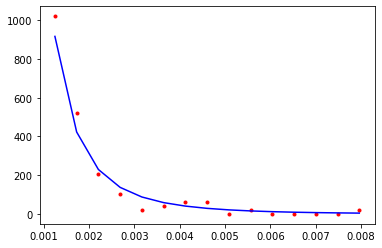

CPU times: user 5.25 ms, sys: 1.13 ms, total: 6.38 ms
Wall time: 2.17 ms
106260.24801301838


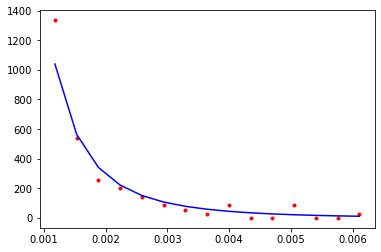

CPU times: user 5.45 ms, sys: 1.11 ms, total: 6.56 ms
Wall time: 2.21 ms
90229.94749084016


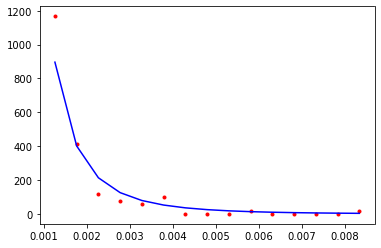

CPU times: user 5.56 ms, sys: 1.81 ms, total: 7.36 ms
Wall time: 2.6 ms
11885.79881860975


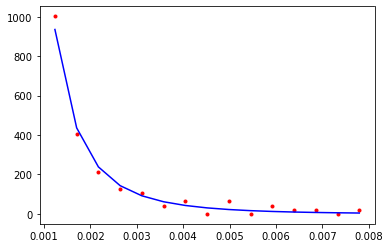

CPU times: user 6.43 ms, sys: 1.36 ms, total: 7.79 ms
Wall time: 2.63 ms
59985.32654828644


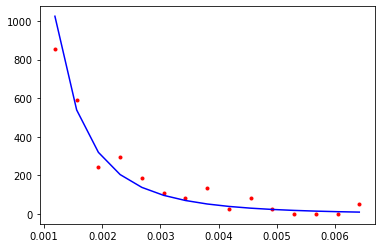

CPU times: user 6.55 ms, sys: 1.26 ms, total: 7.81 ms
Wall time: 2.64 ms
59872.63291830889


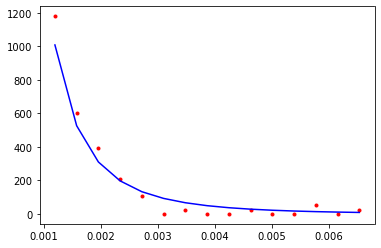

CPU times: user 7.18 ms, sys: 1.39 ms, total: 8.57 ms
Wall time: 2.88 ms
106289.23278641896


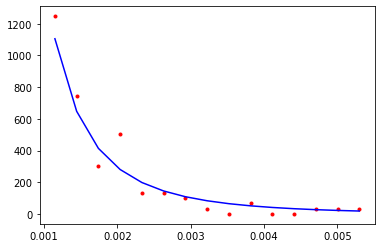

CPU times: user 3.37 ms, sys: 148 µs, total: 3.52 ms
Wall time: 3.46 ms
30985.463098815322


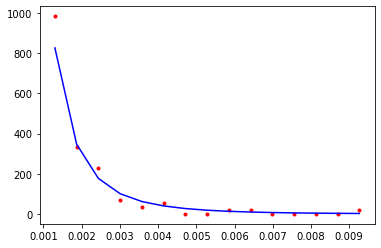

CPU times: user 7.11 ms, sys: 1.84 ms, total: 8.95 ms
Wall time: 3.12 ms
76933.71089284419


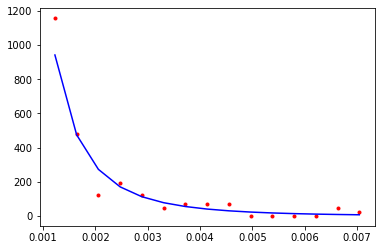

CPU times: user 8.05 ms, sys: 1.67 ms, total: 9.73 ms
Wall time: 3.32 ms
60466.99806331246


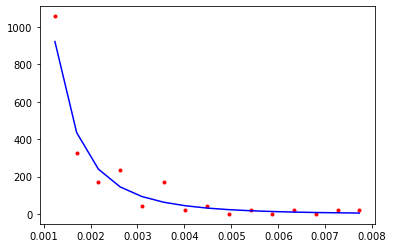

CPU times: user 1.43 ms, sys: 1.37 ms, total: 2.79 ms
Wall time: 908 µs
13623.522903422072


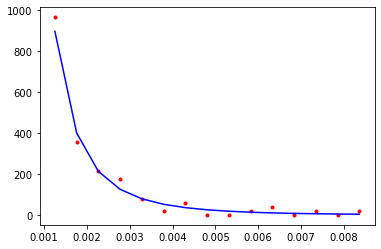

CPU times: user 1.09 ms, sys: 520 µs, total: 1.61 ms
Wall time: 566 µs
47669.56375560286


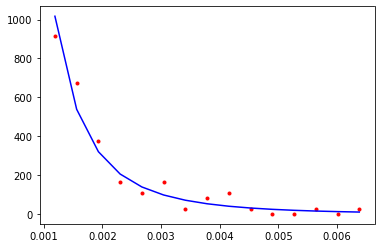

CPU times: user 1.41 ms, sys: 725 µs, total: 2.13 ms
Wall time: 766 µs
4622.623056564774


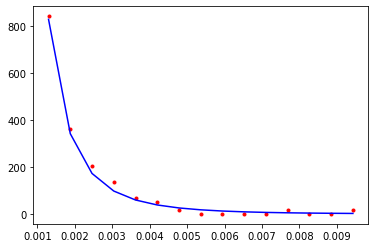

CPU times: user 1.82 ms, sys: 673 µs, total: 2.49 ms
Wall time: 866 µs
317669.77259885793


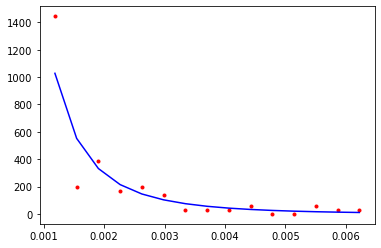

CPU times: user 1.97 ms, sys: 664 µs, total: 2.64 ms
Wall time: 908 µs
48585.14683069889


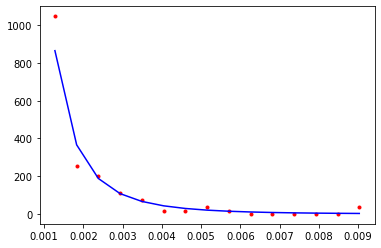

CPU times: user 2.7 ms, sys: 823 µs, total: 3.52 ms
Wall time: 1.2 ms
68512.27059522447


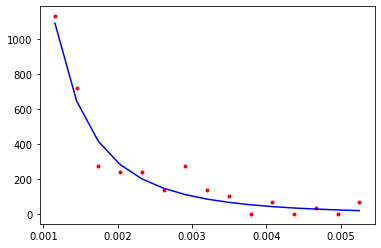

CPU times: user 2.85 ms, sys: 768 µs, total: 3.62 ms
Wall time: 1.23 ms
10486.142499716494


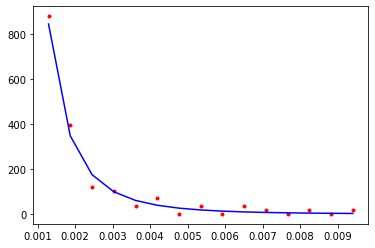

CPU times: user 3.31 ms, sys: 894 µs, total: 4.21 ms
Wall time: 1.45 ms
89130.79807110789


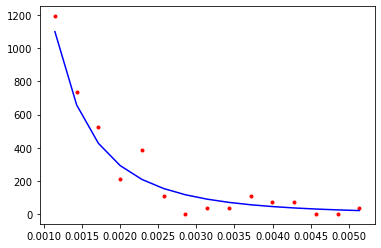

CPU times: user 3.56 ms, sys: 922 µs, total: 4.49 ms
Wall time: 1.54 ms
8236.939131450845


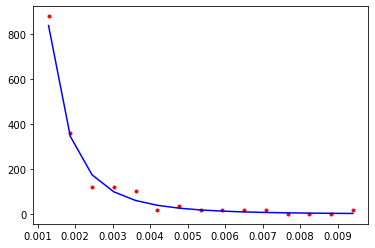

CPU times: user 3.96 ms, sys: 874 µs, total: 4.83 ms
Wall time: 1.63 ms
96687.74285753848


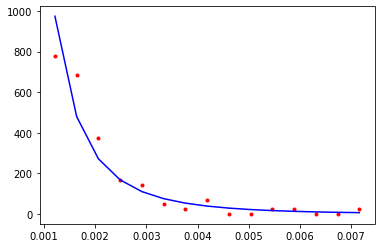

CPU times: user 4.52 ms, sys: 1.1 ms, total: 5.62 ms
Wall time: 1.92 ms
8087.905013101182


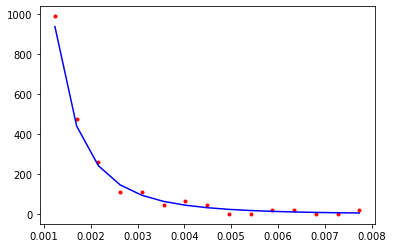

CPU times: user 4.92 ms, sys: 1.14 ms, total: 6.06 ms
Wall time: 2.07 ms
19311.36533958521


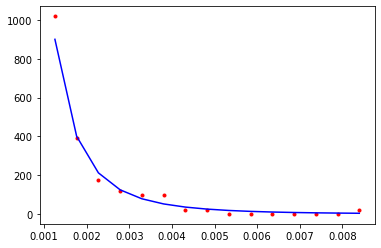

CPU times: user 5.21 ms, sys: 1.14 ms, total: 6.36 ms
Wall time: 2.17 ms
65626.87861451216


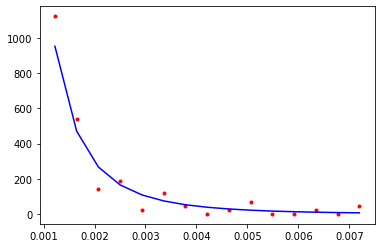

CPU times: user 5.33 ms, sys: 1.17 ms, total: 6.5 ms
Wall time: 2.22 ms
42977.001896371956


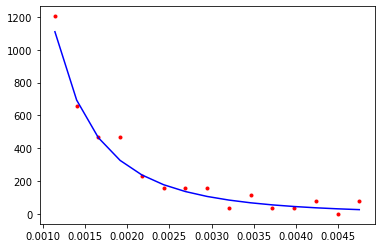

CPU times: user 5.8 ms, sys: 1.2 ms, total: 7.01 ms
Wall time: 2.36 ms
18157.919169684123


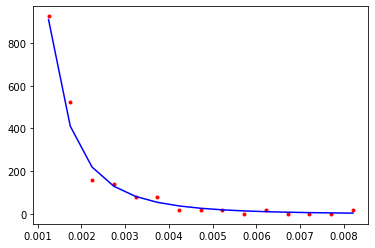

CPU times: user 6.24 ms, sys: 1.18 ms, total: 7.41 ms
Wall time: 2.51 ms
98825.84500234958


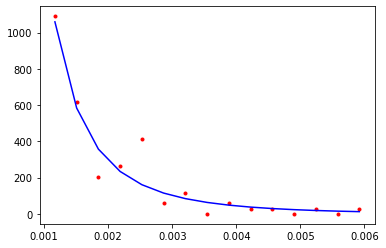

CPU times: user 6.46 ms, sys: 1.25 ms, total: 7.71 ms
Wall time: 2.61 ms
7803.582187809488


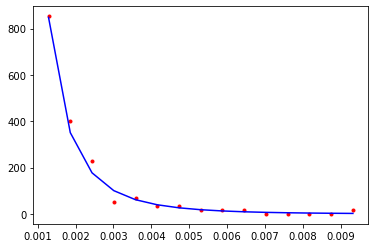

CPU times: user 7.09 ms, sys: 1.38 ms, total: 8.47 ms
Wall time: 2.86 ms
31996.705096874073


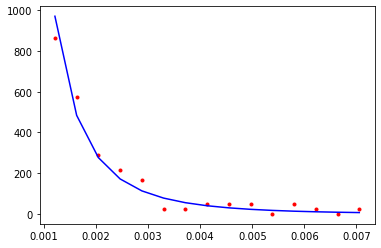

CPU times: user 7.63 ms, sys: 1.41 ms, total: 9.04 ms
Wall time: 3.04 ms
92675.49260489893


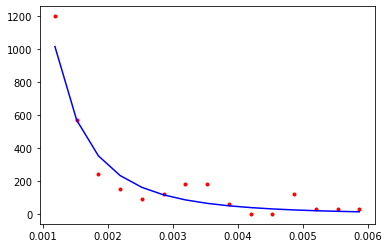

CPU times: user 7.77 ms, sys: 1.42 ms, total: 9.19 ms
Wall time: 3.09 ms
28416.386376510734


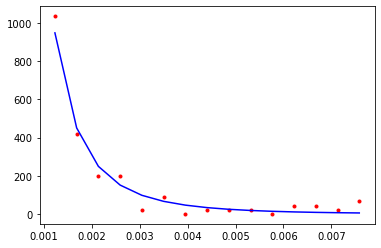

CPU times: user 9.15 ms, sys: 1.83 ms, total: 11 ms
Wall time: 3.73 ms
20228.868317245076


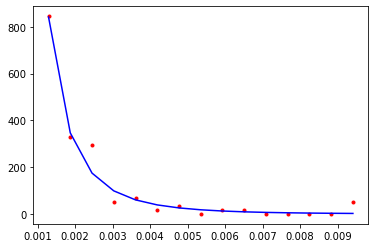

CPU times: user 1.33 ms, sys: 1.25 ms, total: 2.58 ms
Wall time: 844 µs
27004.513318537523


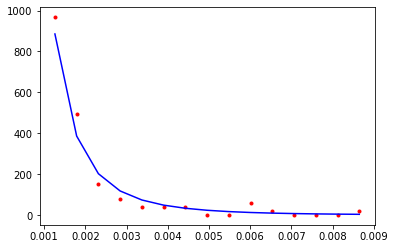

CPU times: user 940 µs, sys: 519 µs, total: 1.46 ms
Wall time: 498 µs
42712.5147855134


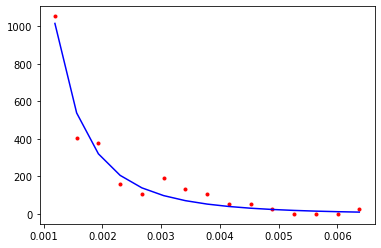

CPU times: user 1.3 ms, sys: 493 µs, total: 1.79 ms
Wall time: 605 µs
18503.69912626253


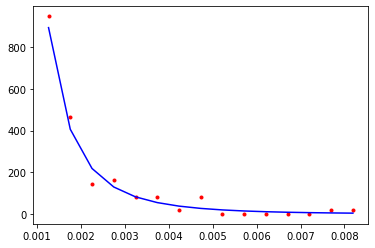

CPU times: user 1.87 ms, sys: 770 µs, total: 2.64 ms
Wall time: 904 µs
22793.22509903131


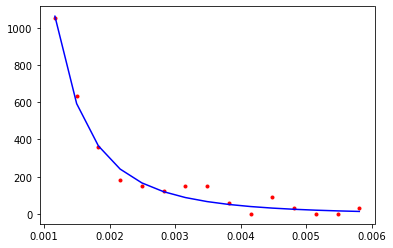

CPU times: user 2.16 ms, sys: 724 µs, total: 2.88 ms
Wall time: 1 ms
39245.17980273983


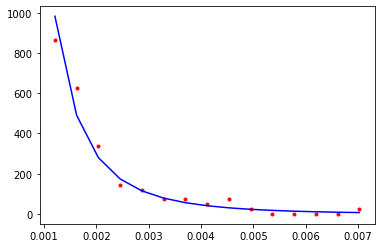

CPU times: user 2.32 ms, sys: 710 µs, total: 3.03 ms
Wall time: 1.05 ms
166890.68561832135


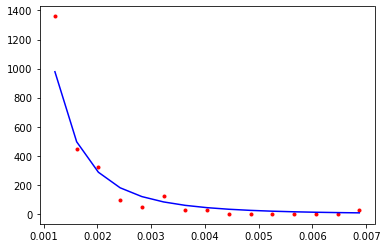

CPU times: user 3.02 ms, sys: 832 µs, total: 3.85 ms
Wall time: 1.31 ms
5287.94340616843


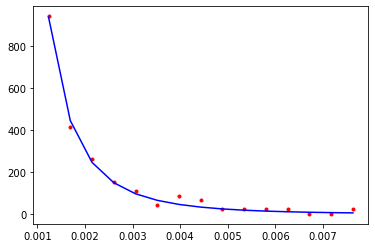

CPU times: user 3.14 ms, sys: 876 µs, total: 4.01 ms
Wall time: 1.35 ms
30803.381317613577


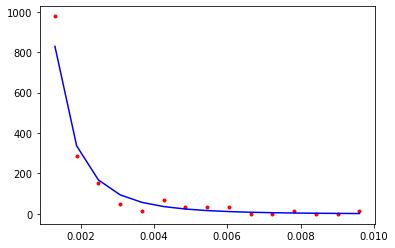

CPU times: user 3.46 ms, sys: 845 µs, total: 4.3 ms
Wall time: 1.47 ms
42809.67402032486


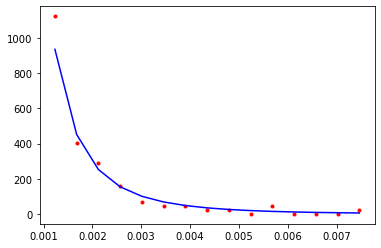

CPU times: user 3.88 ms, sys: 885 µs, total: 4.77 ms
Wall time: 1.63 ms
92315.93106033867


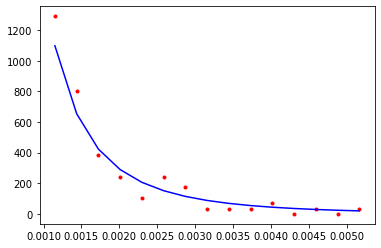

CPU times: user 4.28 ms, sys: 961 µs, total: 5.24 ms
Wall time: 1.79 ms
20918.827984171792


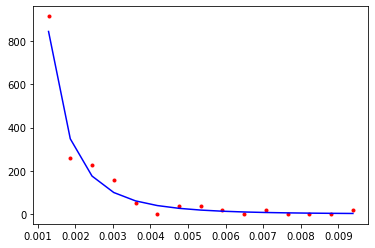

CPU times: user 4.52 ms, sys: 982 µs, total: 5.5 ms
Wall time: 1.88 ms
30870.4105011313


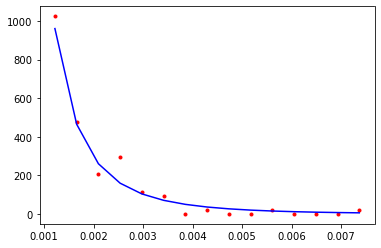

CPU times: user 5.12 ms, sys: 1.13 ms, total: 6.25 ms
Wall time: 2.12 ms
111258.16213913907


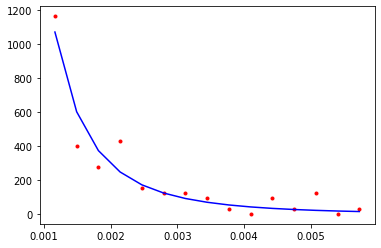

CPU times: user 5.58 ms, sys: 1.09 ms, total: 6.67 ms
Wall time: 2.24 ms
13094.781015534734


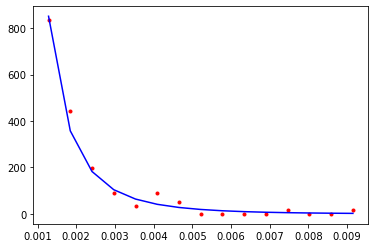

CPU times: user 5.85 ms, sys: 1.21 ms, total: 7.07 ms
Wall time: 2.38 ms
24303.245163170333


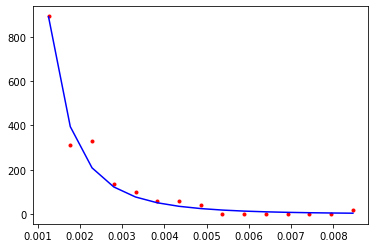

CPU times: user 6.24 ms, sys: 1.42 ms, total: 7.66 ms
Wall time: 2.63 ms
42805.55255799212


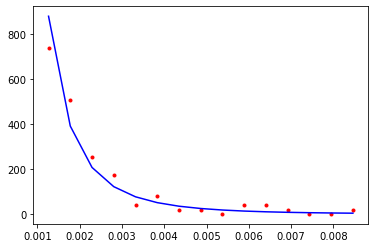

CPU times: user 6.76 ms, sys: 1.34 ms, total: 8.1 ms
Wall time: 2.74 ms
35028.623286635666


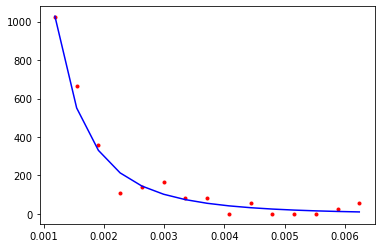

CPU times: user 6.84 ms, sys: 1.38 ms, total: 8.22 ms
Wall time: 2.78 ms
33340.04181538269


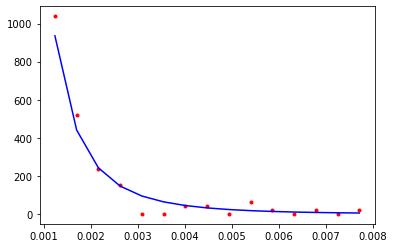

CPU times: user 7.2 ms, sys: 1.4 ms, total: 8.6 ms
Wall time: 2.92 ms
13741.693554240086


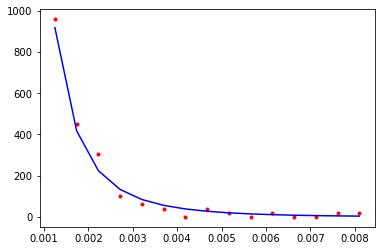

CPU times: user 7.82 ms, sys: 1.39 ms, total: 9.21 ms
Wall time: 3.08 ms
23500.187565496697


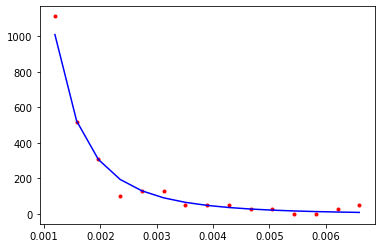

CPU times: user 8.22 ms, sys: 1.36 ms, total: 9.58 ms
Wall time: 3.22 ms
39138.78335776656


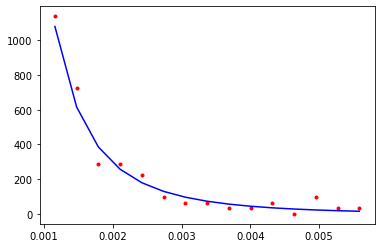

CPU times: user 1.48 ms, sys: 1.39 ms, total: 2.87 ms
Wall time: 931 µs
43183.55781184659


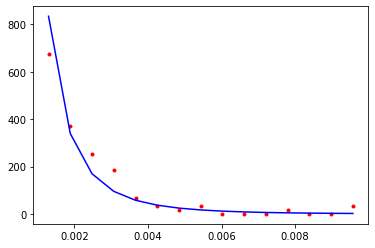

CPU times: user 1.22 ms, sys: 676 µs, total: 1.89 ms
Wall time: 661 µs
64527.81433302977


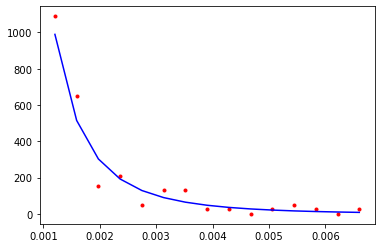

CPU times: user 1.32 ms, sys: 597 µs, total: 1.91 ms
Wall time: 654 µs
20532.15747272706


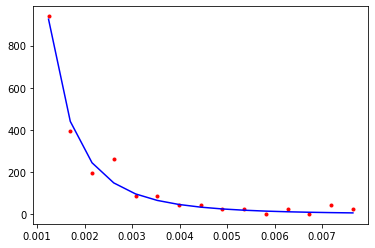

CPU times: user 1.68 ms, sys: 544 µs, total: 2.22 ms
Wall time: 742 µs
20419.50646119776


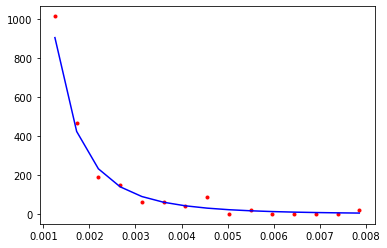

CPU times: user 2.2 ms, sys: 979 µs, total: 3.17 ms
Wall time: 1.16 ms
25102.749161331772


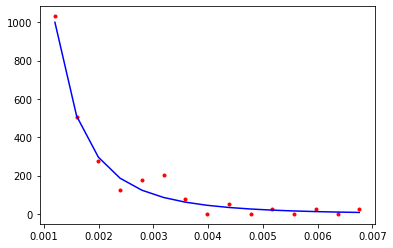

CPU times: user 2.25 ms, sys: 802 µs, total: 3.06 ms
Wall time: 1.06 ms
25011.25183593649


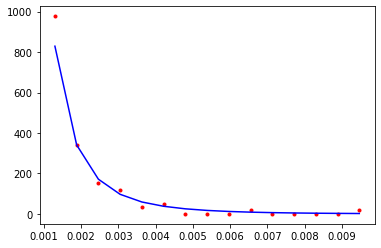

CPU times: user 2.69 ms, sys: 768 µs, total: 3.45 ms
Wall time: 1.2 ms
109399.47505694332


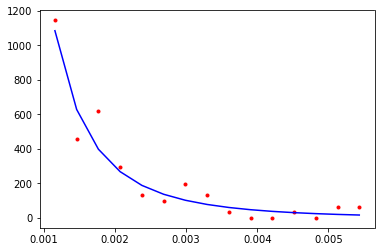

CPU times: user 3.09 ms, sys: 831 µs, total: 3.92 ms
Wall time: 1.37 ms
14287.430807970546


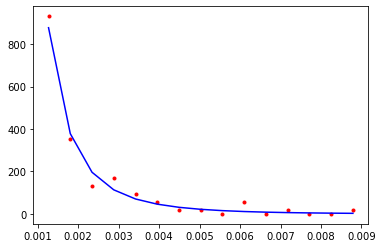

CPU times: user 3.48 ms, sys: 1.06 ms, total: 4.55 ms
Wall time: 1.59 ms
9457.812059361588


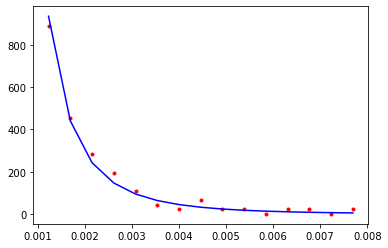

CPU times: user 3.97 ms, sys: 905 µs, total: 4.88 ms
Wall time: 1.65 ms
81874.5257000025


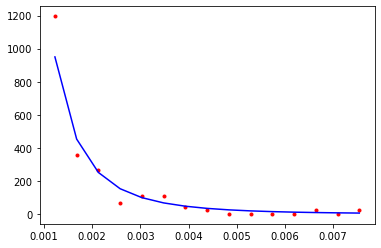

CPU times: user 4.99 ms, sys: 1.23 ms, total: 6.22 ms
Wall time: 2.11 ms
8981.350728129384


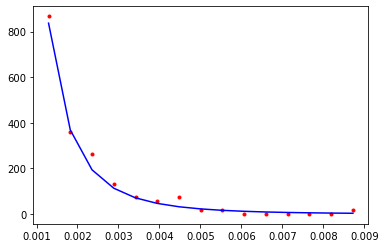

CPU times: user 4.87 ms, sys: 1.15 ms, total: 6.02 ms
Wall time: 2.06 ms
27279.82551704938


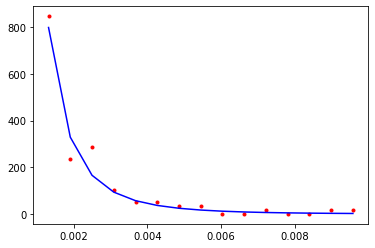

CPU times: user 5.19 ms, sys: 1.32 ms, total: 6.51 ms
Wall time: 2.24 ms
71691.2320459303


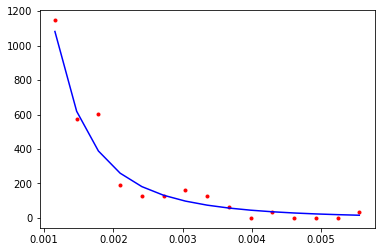

CPU times: user 5.17 ms, sys: 1.69 ms, total: 6.86 ms
Wall time: 2.44 ms
138833.32081316237


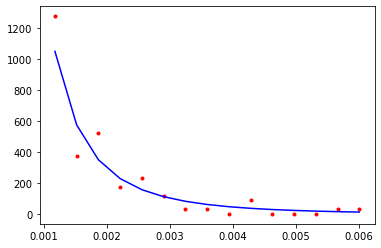

CPU times: user 5.88 ms, sys: 1.3 ms, total: 7.18 ms
Wall time: 2.45 ms
12221.97528445771


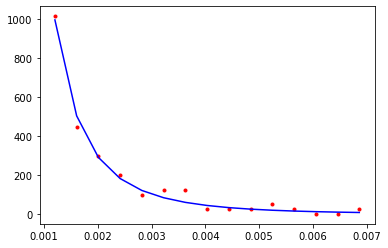

CPU times: user 6.17 ms, sys: 1.26 ms, total: 7.43 ms
Wall time: 2.52 ms
20290.425882955904


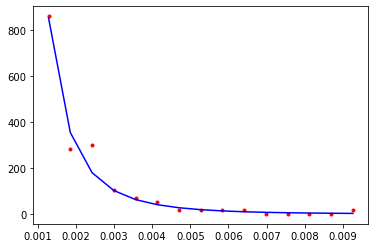

CPU times: user 6.48 ms, sys: 1.36 ms, total: 7.84 ms
Wall time: 2.7 ms
11026.922003121917


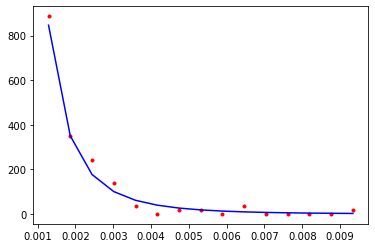

CPU times: user 6.68 ms, sys: 1.46 ms, total: 8.14 ms
Wall time: 2.82 ms
18992.761739995538


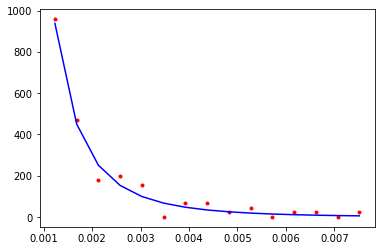

CPU times: user 7.24 ms, sys: 1.5 ms, total: 8.74 ms
Wall time: 3.02 ms
35653.52629511845


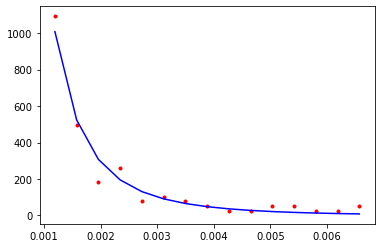

CPU times: user 7.84 ms, sys: 1.38 ms, total: 9.23 ms
Wall time: 3.09 ms
22467.18539100818


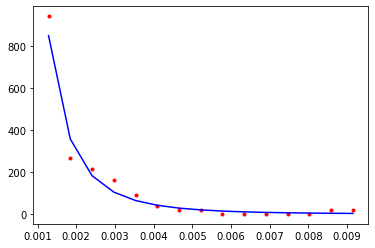

CPU times: user 8.24 ms, sys: 1.58 ms, total: 9.82 ms
Wall time: 3.31 ms
41231.70168958033


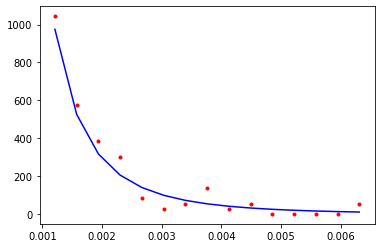

CPU times: user 1.14 ms, sys: 1.21 ms, total: 2.34 ms
Wall time: 773 µs
28165.890845121587


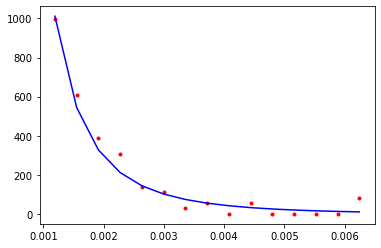

CPU times: user 738 µs, sys: 391 µs, total: 1.13 ms
Wall time: 379 µs
140638.10351644654


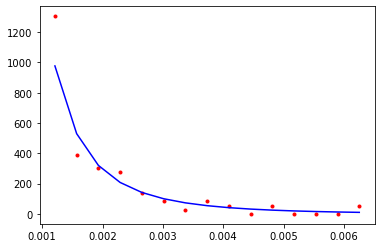

CPU times: user 1.46 ms, sys: 624 µs, total: 2.09 ms
Wall time: 725 µs
41347.235866413386


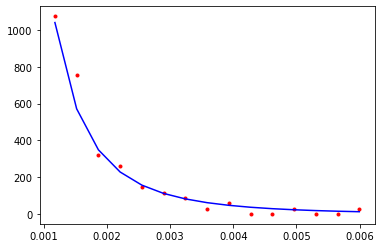

CPU times: user 1.68 ms, sys: 573 µs, total: 2.26 ms
Wall time: 763 µs
71101.18377136209


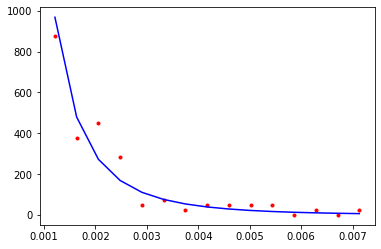

CPU times: user 2.07 ms, sys: 721 µs, total: 2.79 ms
Wall time: 949 µs
34992.841249428995


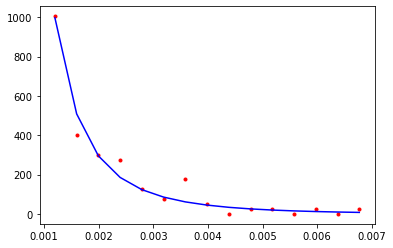

CPU times: user 2.63 ms, sys: 771 µs, total: 3.4 ms
Wall time: 1.16 ms
16253.000913248085


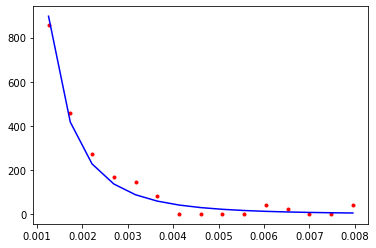

CPU times: user 2.67 ms, sys: 817 µs, total: 3.49 ms
Wall time: 1.2 ms
13952.93263093917


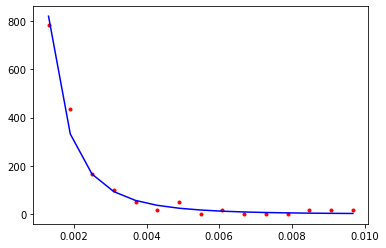

CPU times: user 3.06 ms, sys: 861 µs, total: 3.93 ms
Wall time: 1.36 ms
37314.34404959678


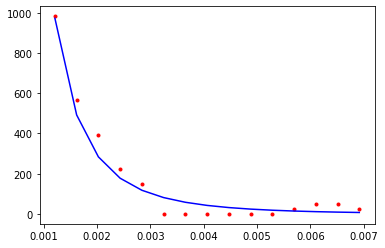

CPU times: user 3.82 ms, sys: 846 µs, total: 4.66 ms
Wall time: 1.6 ms
39557.41666430019


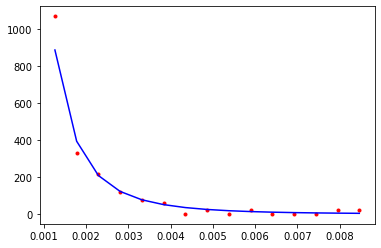

CPU times: user 3.96 ms, sys: 896 µs, total: 4.85 ms
Wall time: 1.64 ms
55626.95676635158


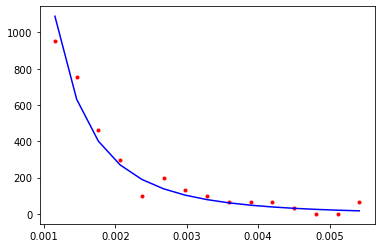

CPU times: user 4.27 ms, sys: 918 µs, total: 5.19 ms
Wall time: 1.76 ms
5015.469579092291


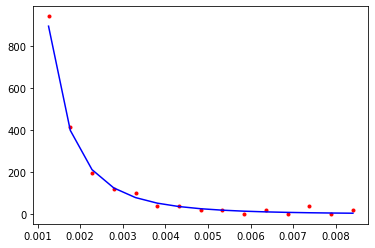

CPU times: user 4.89 ms, sys: 1.05 ms, total: 5.94 ms
Wall time: 2.02 ms
24658.76171144895


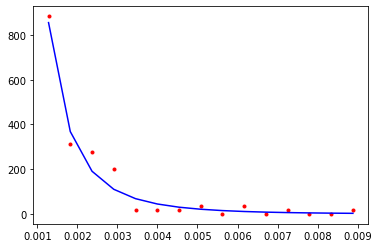

CPU times: user 5.19 ms, sys: 1.22 ms, total: 6.41 ms
Wall time: 2.21 ms
46970.74652847493


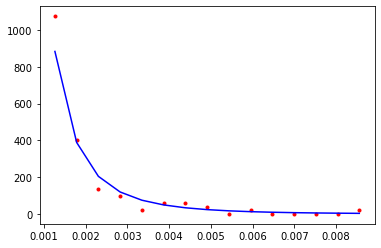

CPU times: user 5.77 ms, sys: 1.25 ms, total: 7.01 ms
Wall time: 2.37 ms
48621.11190462168


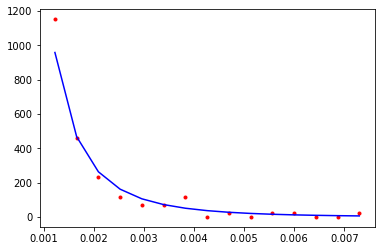

CPU times: user 5.83 ms, sys: 1.17 ms, total: 7.01 ms
Wall time: 2.36 ms
18229.375791181592


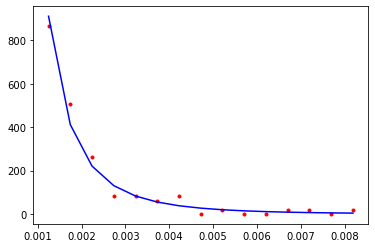

CPU times: user 6.29 ms, sys: 1.26 ms, total: 7.55 ms
Wall time: 2.55 ms
22187.38148673295


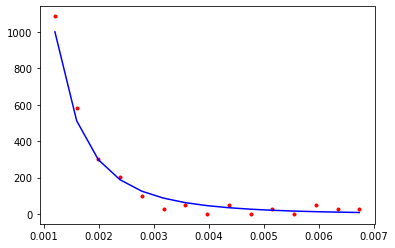

CPU times: user 5.2 ms, sys: 1.05 ms, total: 6.25 ms
Wall time: 2.7 ms
77502.06967566012


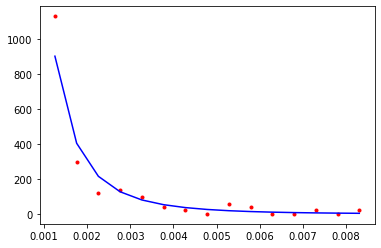

CPU times: user 6.93 ms, sys: 1.3 ms, total: 8.23 ms
Wall time: 2.78 ms
109464.4260038158


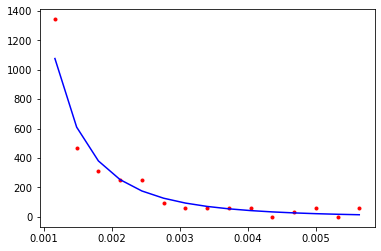

CPU times: user 7.39 ms, sys: 1.66 ms, total: 9.05 ms
Wall time: 3.08 ms
10903.1959422562


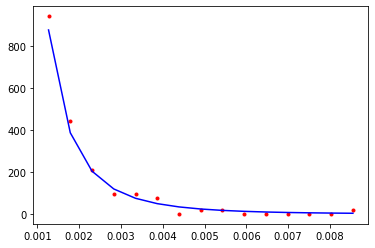

CPU times: user 7.98 ms, sys: 1.48 ms, total: 9.46 ms
Wall time: 3.19 ms
34432.73201042594


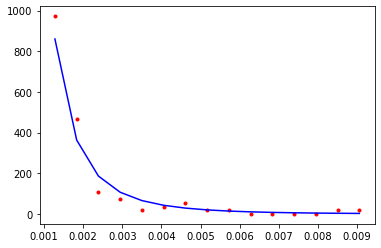

CPU times: user 7.93 ms, sys: 1.29 ms, total: 9.22 ms
Wall time: 3.09 ms
29651.01171787696


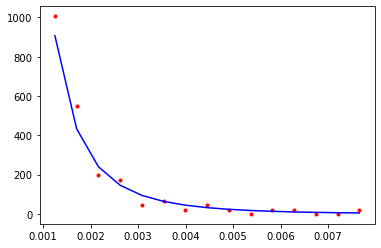

CPU times: user 1.1 ms, sys: 1.05 ms, total: 2.14 ms
Wall time: 697 µs
36837.7667832796


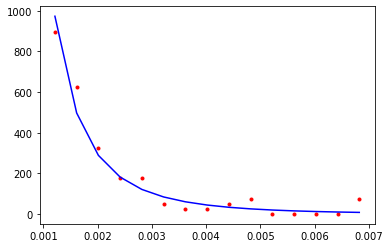

In [52]:
for _ in range(loops):
    for nn_iter in n_iter:
        lib.set_rutherford_iterations(nn_iter)
        %time r_everest = [ lib.get_random_ruth() for _ in range(n) ]
        S_everest[nn_iter] = np.array([ *S_everest[nn_iter], test_random(r_everest, bins, f) ])
    %time r_k2 = [ k2ran.get_random_ruth(cgen) for _ in range(n) ]
    S_K2 = np.array([ *S_K2, test_random(r_k2, bins, f) ])

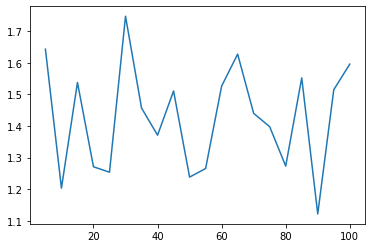

In [53]:
plt.plot(n_iter, [ np.sqrt((S_everest[nn_iter] / S_K2).mean()) for nn_iter in n_iter ])

## Investigating number of Newton iterations

In [8]:
mat = xc.materials.Copper
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

lib.set_rutherford_parameters(z,emr,t1)

result = []
for n_iter in range(1,50):
    lib.set_random_seed(1669281221)
    lib.set_rutherford_iterations(n_iter)
    result = [ *result, lib.get_random_ruth() ]

result = abs(result[-1] - np.array(result))/result[-1]

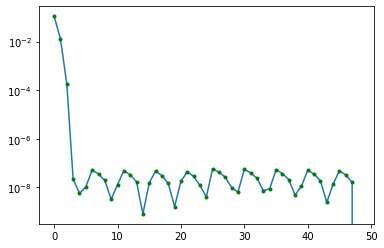

In [9]:
fig = plt.figure()
ax = fig.add_subplot()
ax.plot(result)
ax.plot(result, 'g.')
ax.set_yscale('log')
plt.show()

In [11]:
result = []
for n_iter in range(7,50):
    lib.set_random_seed(1669281221)
    lib.set_rutherford_iterations(n_iter)
    result = [ *result, lib.get_random_ruth() ]

result = abs(result[-1] - np.array(result))/result[-1]

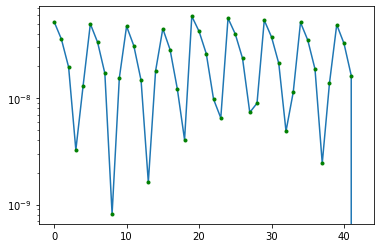

In [12]:
fig = plt.figure()
ax = fig.add_subplot()
ax.plot(result)
ax.plot(result, 'g.')
ax.set_yscale('log')
plt.show()

In [13]:
result = []
for n_iter in range(1,50):
    lib.set_random_seed(1669281221)
    lib.set_rutherford_iterations(n_iter)
    lib.get_random_ruth()
    lib.get_random_ruth()
    lib.get_random_ruth()
    result = [ *result, lib.get_random_ruth() ]

result = abs(result[-1] - np.array(result))/result[-1]

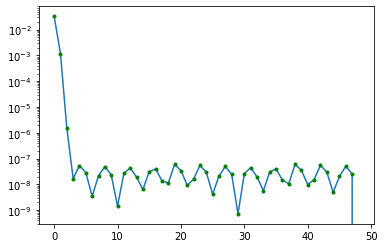

In [14]:
fig = plt.figure()
ax = fig.add_subplot()
ax.plot(result)
ax.plot(result, 'g.')
ax.set_yscale('log')
plt.show()

In [15]:
result = []
for n_iter in range(1,50):
    lib.set_random_seed(1669281221)
    lib.set_rutherford_iterations(n_iter)
    lib.get_random_ruth()
    lib.get_random_ruth()
    lib.get_random_ruth()
    lib.get_random_ruth()
    lib.get_random_ruth()
    result = [ *result, lib.get_random_ruth() ]

result = abs(result[-1] - np.array(result))/result[-1]

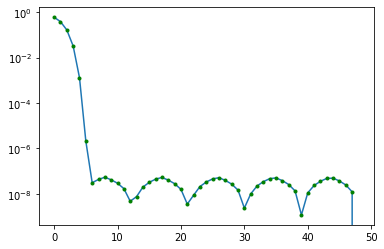

In [16]:
fig = plt.figure()
ax = fig.add_subplot()
ax.plot(result)
ax.plot(result, 'g.')
ax.set_yscale('log')
plt.show()

In [26]:
mat = xc.materials.Copper
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

lib.set_rutherford_parameters(z,emr,t1)

result_val  = []
result_prec = []
for n in range(5000):
    # Sample n values
    lib.set_random_seed(16692811)
    for _ in range(n):
        lib.set_rutherford_iterations(1)
        lib.get_random_ruth()

    # Get the n-th random number with 100 iterations, interpret it as 'perfect'
    lib.set_rutherford_iterations(100)
    norm = lib.get_random_ruth()

    # Sample again n values
    lib.set_random_seed(16692811)
    for _ in range(n):
        lib.set_rutherford_iterations(1)
        lib.get_random_ruth()

    # Get the n-th random number with 7 iterations and calculate its deviation from the perfect one
    lib.set_rutherford_iterations(7)
    val = lib.get_random_ruth()
    result_val  = [ *result_val, val ]
    result_prec = [ *result_prec, abs(norm-val) / norm ]

result_val = np.array(result_val)
result_prec = np.array(result_prec)

5.5645322521160574e-06
6.701110377147224e-05


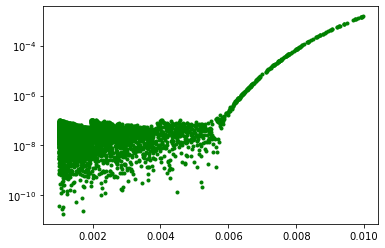

In [27]:
print(result_prec.mean())
print(result_prec.std())
fig = plt.figure()
ax = fig.add_subplot()
ax.plot(result_val, result_prec, 'g.')
ax.set_yscale('log')
plt.show()

In [28]:
mat = xc.materials.Berylium
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

lib.set_rutherford_parameters(z,emr,t1)

result_val  = []
result_prec = []
for n in range(5000):
    # Sample n values
    lib.set_random_seed(16692811)
    for _ in range(n):
        lib.set_rutherford_iterations(1)
        lib.get_random_ruth()

    # Get the n-th random number with 100 iterations, interpret it as 'perfect'
    lib.set_rutherford_iterations(100)
    norm = lib.get_random_ruth()

    # Sample again n values
    lib.set_random_seed(16692811)
    for _ in range(n):
        lib.set_rutherford_iterations(1)
        lib.get_random_ruth()

    # Get the n-th random number with 7 iterations and calculate its deviation from the perfect one
    lib.set_rutherford_iterations(7)
    val = lib.get_random_ruth()
    result_val  = [ *result_val, val ]
    result_prec = [ *result_prec, abs(norm-val) / norm ]

result_val = np.array(result_val)
result_prec = np.array(result_prec)

9.01198863602232e-05
0.0010032097810975906


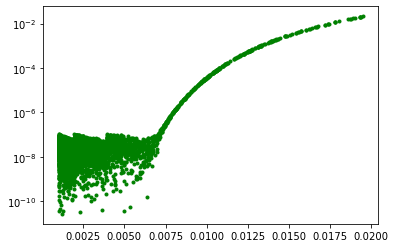

In [29]:
print(result_prec.mean())
print(result_prec.std())
fig = plt.figure()
ax = fig.add_subplot()
ax.plot(result_val, result_prec, 'g.')
ax.set_yscale('log')
plt.show()

In [30]:
mat = xc.materials.Lead
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

lib.set_rutherford_parameters(z,emr,t1)

result_val  = []
result_prec = []
for n in range(5000):
    # Sample n values
    lib.set_random_seed(16692811)
    for _ in range(n):
        lib.set_rutherford_iterations(1)
        lib.get_random_ruth()

    # Get the n-th random number with 100 iterations, interpret it as 'perfect'
    lib.set_rutherford_iterations(100)
    norm = lib.get_random_ruth()

    # Sample again n values
    lib.set_random_seed(16692811)
    for _ in range(n):
        lib.set_rutherford_iterations(1)
        lib.get_random_ruth()

    # Get the n-th random number with 7 iterations and calculate its deviation from the perfect one
    lib.set_rutherford_iterations(7)
    val = lib.get_random_ruth()
    result_val  = [ *result_val, val ]
    result_prec = [ *result_prec, abs(norm-val) / norm ]

result_val = np.array(result_val)
result_prec = np.array(result_prec)

9.688527081241724e-05
0.0014788582885845564


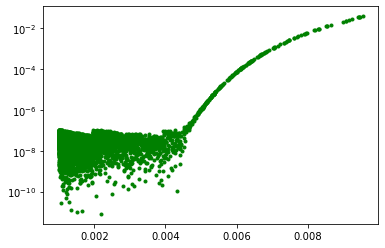

In [31]:
print(result_prec.mean())
print(result_prec.std())
fig = plt.figure()
ax = fig.add_subplot()
ax.plot(result_val, result_prec, 'g.')
ax.set_yscale('log')
plt.show()

In [42]:
mat = xc.materials.Copper
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

lib.set_rutherford_parameters(z,emr,t1)

result_val  = []
result_prec = []
for n in range(5000):
    # Sample n values
    lib.set_random_seed(16692811)
    for _ in range(n):
        lib.set_rutherford_iterations(1)
        lib.get_random_ruth()

    # Get the n-th random number with 100 iterations, interpret it as 'perfect'
    lib.set_rutherford_iterations(100)
    norm = lib.get_random_ruth()

    # Sample again n values
    lib.set_random_seed(16692811)
    for _ in range(n):
        lib.set_rutherford_iterations(1)
        lib.get_random_ruth()

    # Get the n-th random number with 25 iterations and calculate its deviation from the perfect one
    lib.set_rutherford_iterations(6)
    val = lib.get_random_ruth()
    result_val  = [ *result_val, val ]
    result_prec = [ *result_prec, abs(norm-val) / norm ]

result_val = np.array(result_val)
result_prec = np.array(result_prec)

0.0002447048701792093
0.0018977726489164386


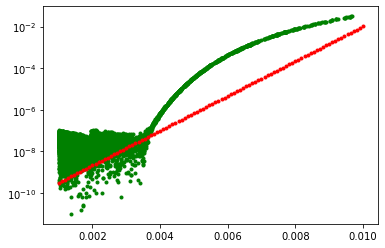

In [69]:
print(result_prec.mean())
print(result_prec.std())
fig = plt.figure()
ax = fig.add_subplot()
ax.plot(result_val, result_prec, 'g.')
x = np.linspace(0.001,0.01,100)
ax.plot(x, 4.6e-11*np.exp(1920*x), 'r.')
ax.set_yscale('log')
plt.show()

In [22]:
mat = xc.materials.Berylium
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

lib.set_rutherford_parameters(z,emr,t1)

result_val  = []
result_prec = []
for n in range(5000):
    # Sample n values
    lib.set_random_seed(16692811)
    for _ in range(n):
        lib.set_rutherford_iterations(1)
        lib.get_random_ruth()

    # Get the n-th random number with 100 iterations, interpret it as 'perfect'
    lib.set_rutherford_iterations(100)
    norm = lib.get_random_ruth()

    # Sample again n values
    lib.set_random_seed(16692811)
    for _ in range(n):
        lib.set_rutherford_iterations(1)
        lib.get_random_ruth()

    # Get the n-th random number with 25 iterations and calculate its deviation from the perfect one
    lib.set_rutherford_iterations(25)
    val = lib.get_random_ruth()
    result_val  = [ *result_val, val ]
    result_prec = [ *result_prec, abs(norm-val) / norm ]

result_val = np.array(result_val)
result_prec = np.array(result_prec)

3.0061211230171924e-08
2.219858713429089e-08


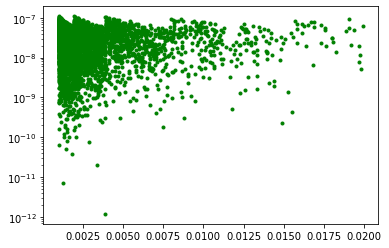

In [23]:
print(result_prec.mean())
print(result_prec.std())
fig = plt.figure()
ax = fig.add_subplot()
ax.plot(result_val, result_prec, 'g.')
ax.set_yscale('log')
plt.show()

In [24]:
mat = xc.materials.Lead
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

lib.set_rutherford_parameters(z,emr,t1)

result_val  = []
result_prec = []
for n in range(5000):
    # Sample n values
    lib.set_random_seed(16692811)
    for _ in range(n):
        lib.set_rutherford_iterations(1)
        lib.get_random_ruth()

    # Get the n-th random number with 100 iterations, interpret it as 'perfect'
    lib.set_rutherford_iterations(100)
    norm = lib.get_random_ruth()

    # Sample again n values
    lib.set_random_seed(16692811)
    for _ in range(n):
        lib.set_rutherford_iterations(1)
        lib.get_random_ruth()

    # Get the n-th random number with 25 iterations and calculate its deviation from the perfect one
    lib.set_rutherford_iterations(25)
    val = lib.get_random_ruth()
    result_val  = [ *result_val, val ]
    result_prec = [ *result_prec, abs(norm-val) / norm ]

result_val = np.array(result_val)
result_prec = np.array(result_prec)

2.967182103633592e-08
2.2281295086209595e-08


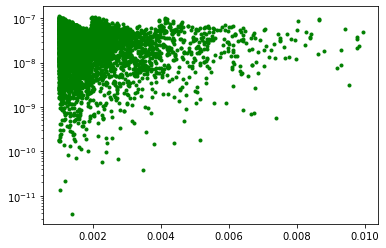

In [25]:
print(result_prec.mean())
print(result_prec.std())
fig = plt.figure()
ax = fig.add_subplot()
ax.plot(result_val, result_prec, 'g.')
ax.set_yscale('log')
plt.show()

# Gaussian random number generator

## 1000000 samples

In [33]:
n = 1000000
bins = 1000
mu = 0
sigma = 1

loops = 20
S_everest = []
S_K2 = []
f = lambda x: 1/np.sqrt(2*np.pi)/sigma * np.exp(-(x-mu)**2/sigma**2/2)

CPU times: user 211 ms, sys: 12.2 ms, total: 223 ms
Wall time: 222 ms
CPU times: user 1.45 s, sys: 15.9 ms, total: 1.46 s
Wall time: 1.46 s
0.010070994840629547


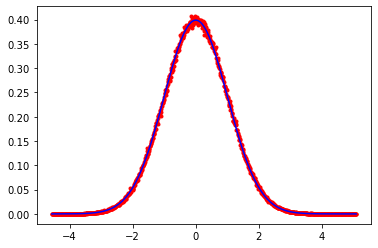

0.010509263147450808


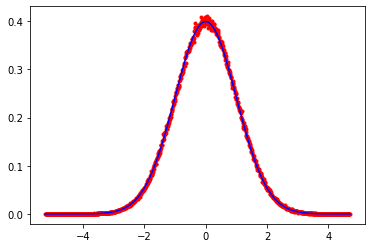

CPU times: user 301 ms, sys: 32.7 ms, total: 333 ms
Wall time: 211 ms
CPU times: user 1.43 s, sys: 15 ms, total: 1.45 s
Wall time: 1.45 s
0.010111679472853186


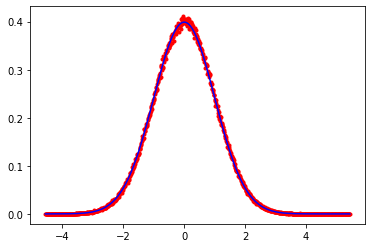

0.012572902795088409


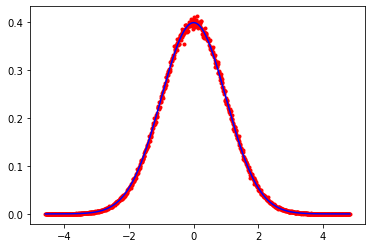

CPU times: user 295 ms, sys: 33.2 ms, total: 328 ms
Wall time: 213 ms
CPU times: user 1.42 s, sys: 11.8 ms, total: 1.43 s
Wall time: 1.43 s
0.01142538215041141


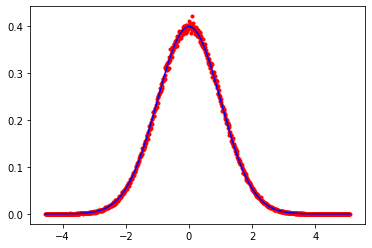

0.012706943222770503


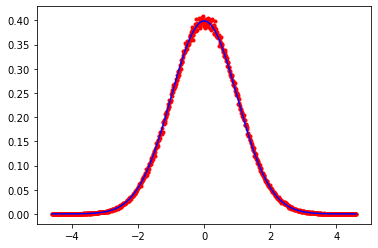

CPU times: user 285 ms, sys: 33.4 ms, total: 319 ms
Wall time: 226 ms
CPU times: user 1.49 s, sys: 17.2 ms, total: 1.51 s
Wall time: 1.51 s
0.01062982483722155


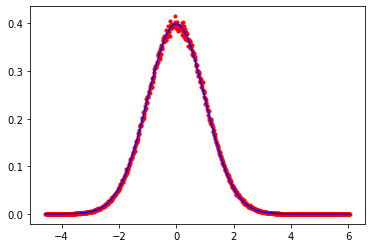

0.011095733376799817


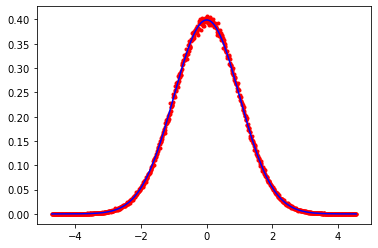

CPU times: user 284 ms, sys: 31.2 ms, total: 315 ms
Wall time: 218 ms
CPU times: user 1.45 s, sys: 15.3 ms, total: 1.46 s
Wall time: 1.46 s
0.010099971441584412


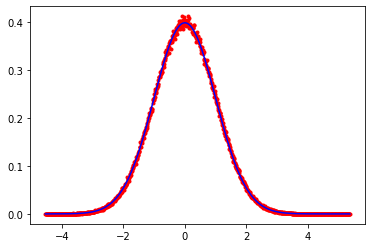

0.011823405073854114


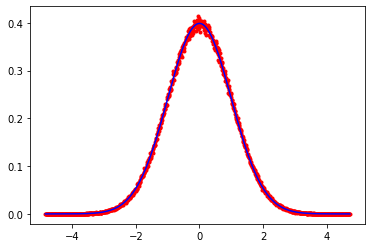

CPU times: user 302 ms, sys: 32.5 ms, total: 335 ms
Wall time: 210 ms
CPU times: user 1.43 s, sys: 12.1 ms, total: 1.44 s
Wall time: 1.44 s
0.010209664371364894


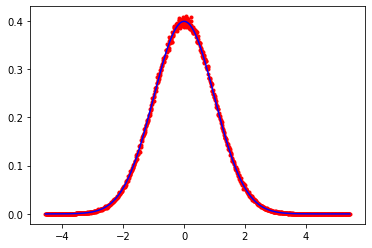

0.011753519922878906


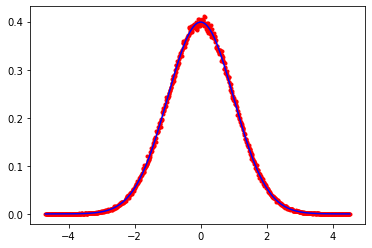

CPU times: user 303 ms, sys: 34.4 ms, total: 337 ms
Wall time: 210 ms
CPU times: user 1.42 s, sys: 13.3 ms, total: 1.44 s
Wall time: 1.44 s
0.010451254368297951


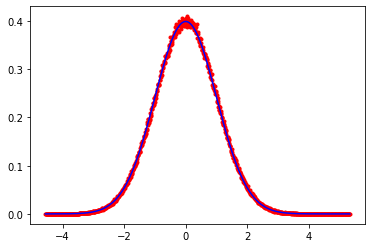

0.010474251615486643


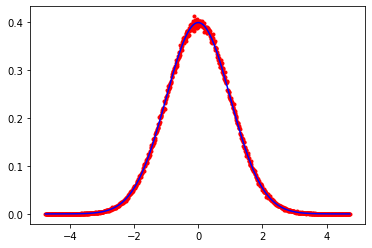

CPU times: user 293 ms, sys: 30 ms, total: 323 ms
Wall time: 206 ms
CPU times: user 1.48 s, sys: 19 ms, total: 1.5 s
Wall time: 1.5 s
0.010721318137384736


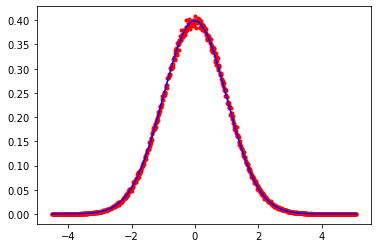

0.009398536227110049


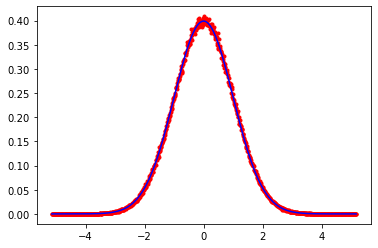

CPU times: user 268 ms, sys: 29.8 ms, total: 298 ms
Wall time: 215 ms
CPU times: user 1.46 s, sys: 14.8 ms, total: 1.48 s
Wall time: 1.48 s
0.01059983873234132


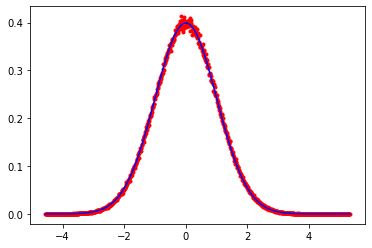

0.012244648011954223


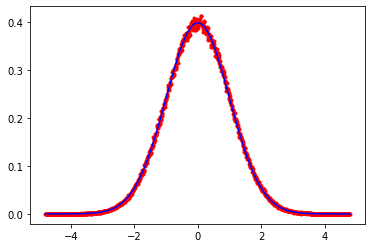

CPU times: user 301 ms, sys: 36.4 ms, total: 337 ms
Wall time: 215 ms
CPU times: user 1.48 s, sys: 18.2 ms, total: 1.5 s
Wall time: 1.51 s
0.010403439024358634


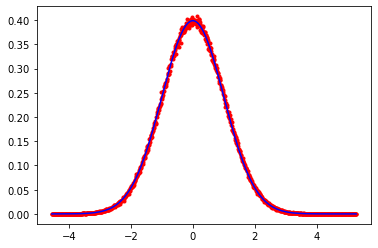

0.01070828976225953


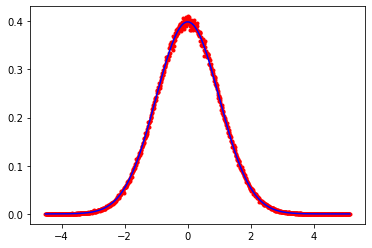

CPU times: user 304 ms, sys: 33.1 ms, total: 337 ms
Wall time: 213 ms
CPU times: user 1.45 s, sys: 16.9 ms, total: 1.47 s
Wall time: 1.47 s
0.010165252247710702


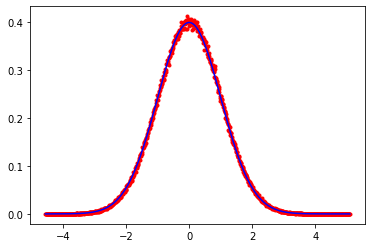

0.009476126948149637


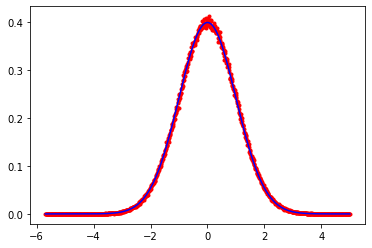

CPU times: user 291 ms, sys: 36.2 ms, total: 327 ms
Wall time: 216 ms
CPU times: user 1.5 s, sys: 18.5 ms, total: 1.51 s
Wall time: 1.52 s
0.010076418504110079


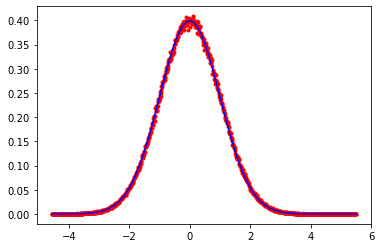

0.011179125714899828


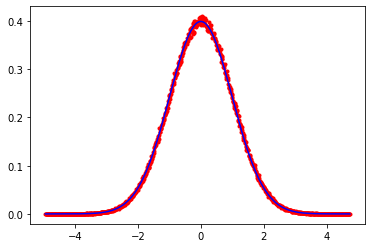

CPU times: user 299 ms, sys: 34.3 ms, total: 333 ms
Wall time: 211 ms
CPU times: user 1.48 s, sys: 19.3 ms, total: 1.5 s
Wall time: 1.5 s
0.010254968923016312


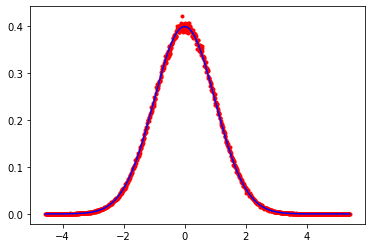

0.010189522023632106


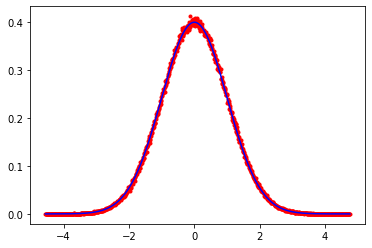

CPU times: user 295 ms, sys: 33.9 ms, total: 328 ms
Wall time: 217 ms
CPU times: user 1.49 s, sys: 18.3 ms, total: 1.51 s
Wall time: 1.51 s
0.009291154549680929


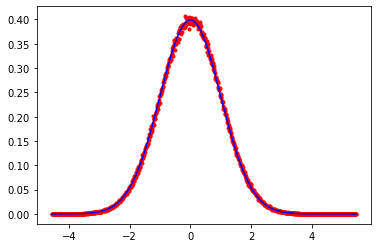

0.00964774595094629


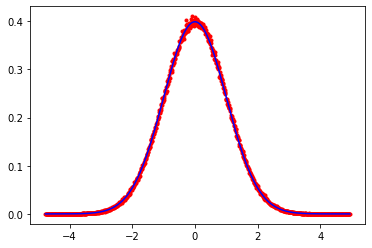

CPU times: user 301 ms, sys: 39.6 ms, total: 340 ms
Wall time: 223 ms
CPU times: user 1.46 s, sys: 15.1 ms, total: 1.47 s
Wall time: 1.47 s
0.011529832744854477


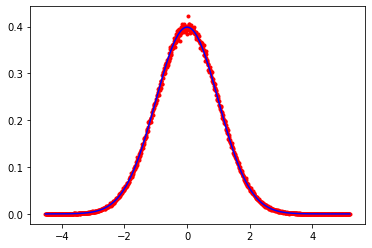

0.011612829045143748


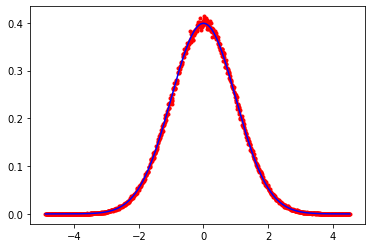

CPU times: user 301 ms, sys: 33.7 ms, total: 335 ms
Wall time: 211 ms
CPU times: user 1.42 s, sys: 14.9 ms, total: 1.44 s
Wall time: 1.44 s
0.011404726263446054


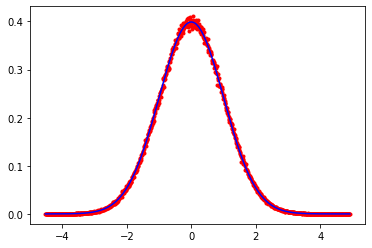

0.010875623153843737


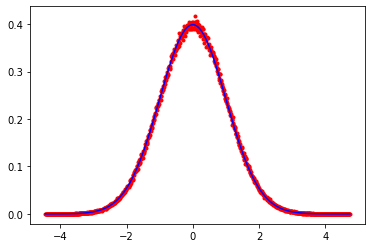

CPU times: user 305 ms, sys: 34.7 ms, total: 340 ms
Wall time: 210 ms
CPU times: user 1.48 s, sys: 14.6 ms, total: 1.5 s
Wall time: 1.5 s
0.010066351525533472


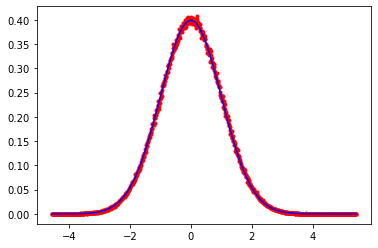

0.010529759506278956


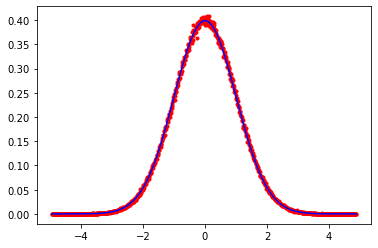

CPU times: user 289 ms, sys: 31.5 ms, total: 321 ms
Wall time: 211 ms
CPU times: user 1.43 s, sys: 13.6 ms, total: 1.44 s
Wall time: 1.44 s
0.010280794655012224


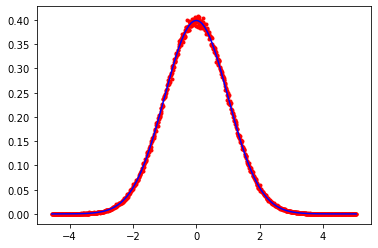

0.010580314337166828


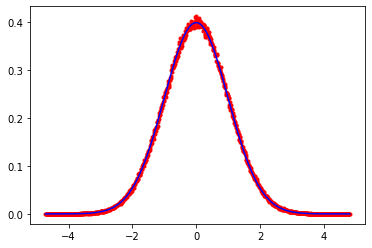

CPU times: user 303 ms, sys: 34 ms, total: 337 ms
Wall time: 209 ms
CPU times: user 1.47 s, sys: 17 ms, total: 1.49 s
Wall time: 1.5 s
0.01057093540279409


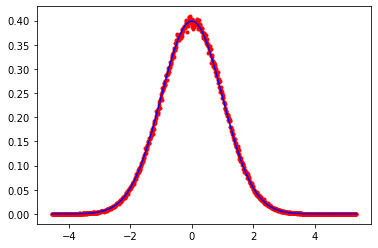

0.010169172152278031


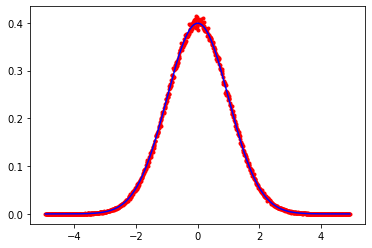

CPU times: user 287 ms, sys: 31.1 ms, total: 318 ms
Wall time: 211 ms
CPU times: user 1.46 s, sys: 16 ms, total: 1.48 s
Wall time: 1.48 s
0.009489103466070237


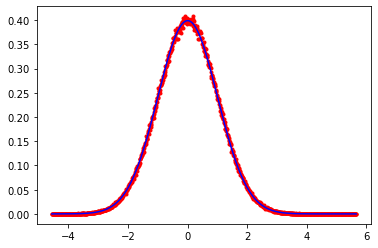

0.008145577993626755


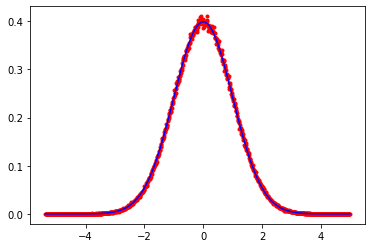

In [34]:
for _ in range(loops):
    %time r_everest = [ lib.get_random_gauss() for _ in range(n)]
    %time r_k2      = [ k2ran.get_random_gauss(100) for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [35]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

0.10194432442727654
0.10384923928022269
[0.97892643 0.89679643 0.94823247 0.97877991 0.92424857 0.93201255
 0.9989016  1.0680559  0.93041451 0.98566289 1.03572306 0.94939989
 1.00320634 0.98134545 0.99642012 1.02403631 0.97774774 0.98574381
 1.01956263 1.07932351]
0.9857866199688193


## 5000 samples

In [36]:
n = 5000
bins = 100
mu = 0
sigma = 1

loops = 20
S_everest = []
S_K2 = []
f = lambda x: 1/np.sqrt(2*np.pi)/sigma * np.exp(-(x-mu)**2/sigma**2/2)

CPU times: user 9.56 ms, sys: 4.72 ms, total: 14.3 ms
Wall time: 13.5 ms
CPU times: user 21.6 ms, sys: 3.39 ms, total: 25 ms
Wall time: 25.1 ms
0.030969099152956682


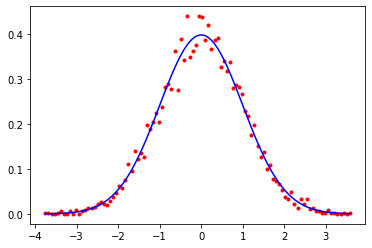

0.028978301588058433


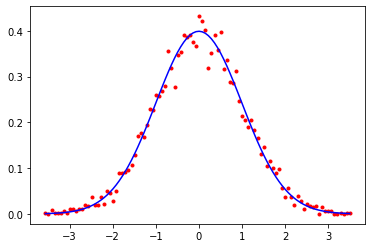

CPU times: user 3.38 ms, sys: 1.25 ms, total: 4.63 ms
Wall time: 1.61 ms
CPU times: user 18.8 ms, sys: 2.41 ms, total: 21.2 ms
Wall time: 7.11 ms
0.028046269186702142


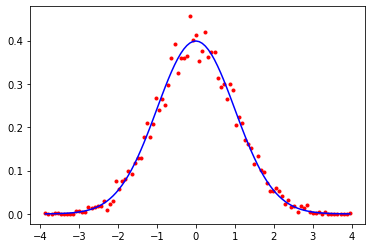

0.027024290322198732


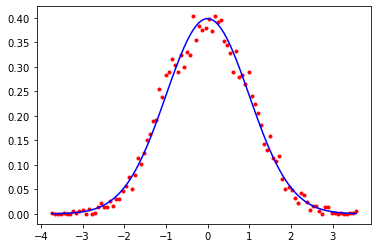

CPU times: user 5.15 ms, sys: 2.23 ms, total: 7.38 ms
Wall time: 2.82 ms
CPU times: user 18.9 ms, sys: 2.46 ms, total: 21.4 ms
Wall time: 7.18 ms
0.025540667650011537


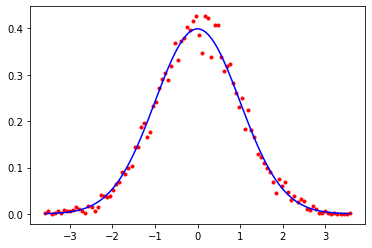

0.036176901703738086


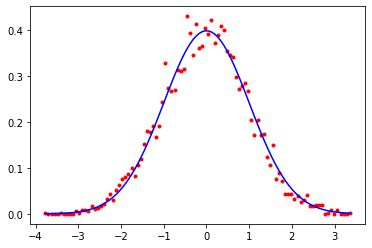

CPU times: user 3.58 ms, sys: 1.27 ms, total: 4.85 ms
Wall time: 1.64 ms
CPU times: user 18.1 ms, sys: 3.68 ms, total: 21.8 ms
Wall time: 7.65 ms
0.046979741106405896


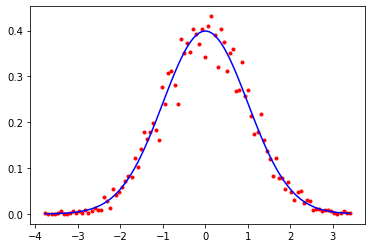

0.04390982118029137


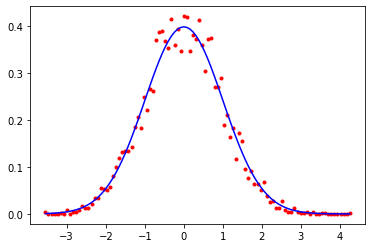

CPU times: user 3.41 ms, sys: 1.35 ms, total: 4.76 ms
Wall time: 1.64 ms
CPU times: user 18.6 ms, sys: 3.07 ms, total: 21.6 ms
Wall time: 7.41 ms
0.05149161246070517


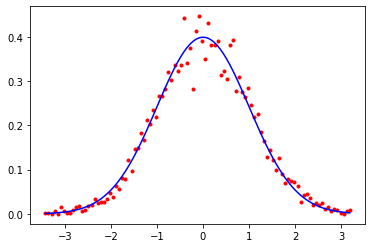

0.04758440206815848


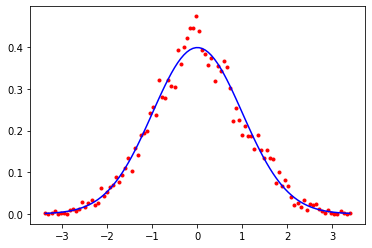

CPU times: user 3.32 ms, sys: 1.96 ms, total: 5.28 ms
Wall time: 1.97 ms
CPU times: user 13.3 ms, sys: 2.12 ms, total: 15.4 ms
Wall time: 15.2 ms
0.05022973365257261


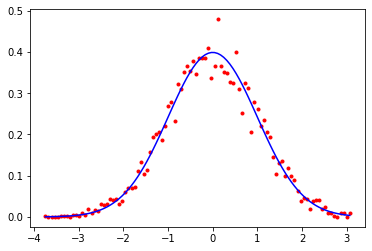

0.04687871777022613


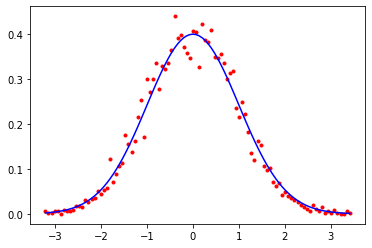

CPU times: user 3.37 ms, sys: 1.83 ms, total: 5.2 ms
Wall time: 1.85 ms
CPU times: user 26.3 ms, sys: 4.13 ms, total: 30.5 ms
Wall time: 10.4 ms
0.047117984427773166


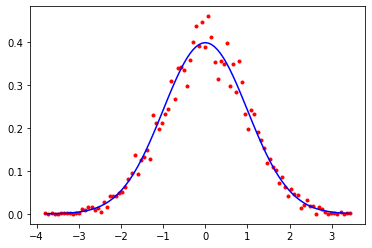

0.02724950592280133


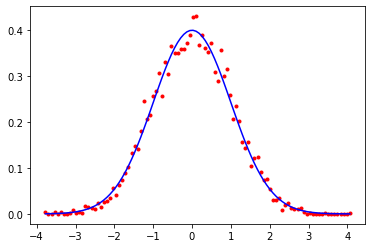

CPU times: user 3.68 ms, sys: 1.79 ms, total: 5.47 ms
Wall time: 1.88 ms
CPU times: user 18.9 ms, sys: 3.63 ms, total: 22.5 ms
Wall time: 7.82 ms
0.02785789107041034


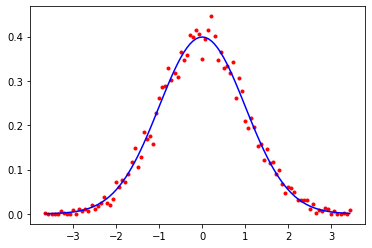

0.02273629825921083


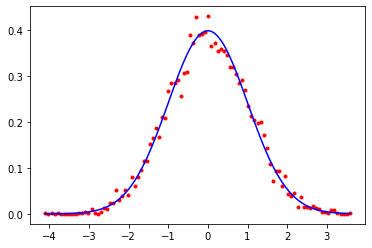

CPU times: user 3.35 ms, sys: 1.48 ms, total: 4.83 ms
Wall time: 1.7 ms
CPU times: user 18.7 ms, sys: 2.85 ms, total: 21.6 ms
Wall time: 7.35 ms
0.03251410750030296


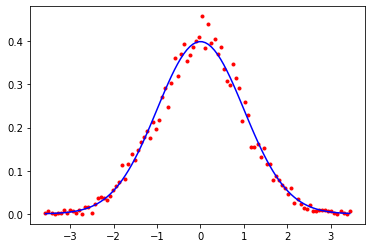

0.042787129726477184


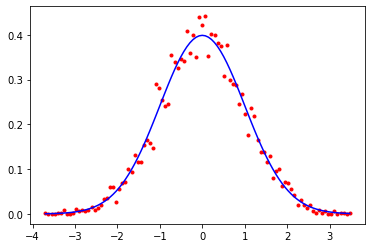

CPU times: user 3.39 ms, sys: 1.15 ms, total: 4.53 ms
Wall time: 1.56 ms
CPU times: user 18.8 ms, sys: 2.84 ms, total: 21.6 ms
Wall time: 7.36 ms
0.03082410590909906


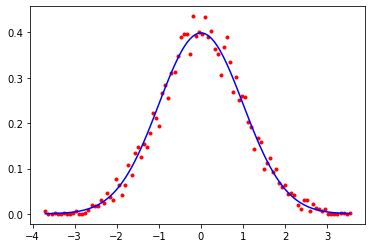

0.025882236326423978


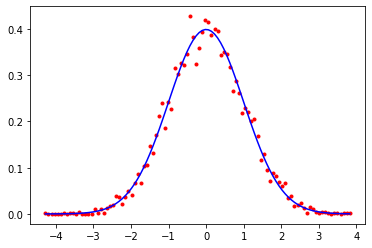

CPU times: user 3.35 ms, sys: 1.38 ms, total: 4.73 ms
Wall time: 1.65 ms
CPU times: user 18.8 ms, sys: 3.21 ms, total: 22 ms
Wall time: 7.57 ms
0.03599103720138392


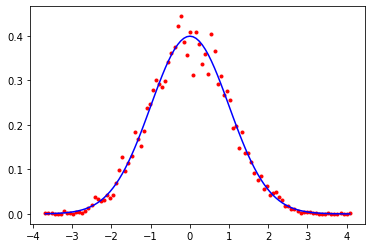

0.04409684295230964


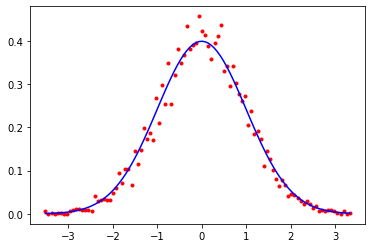

CPU times: user 3.25 ms, sys: 1.21 ms, total: 4.46 ms
Wall time: 1.56 ms
CPU times: user 18.3 ms, sys: 3.59 ms, total: 21.9 ms
Wall time: 7.68 ms
0.04198308762996386


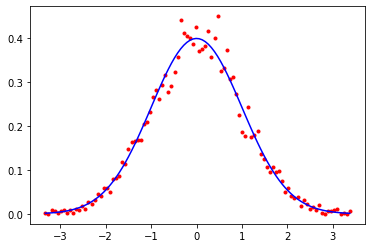

0.028666268631309996


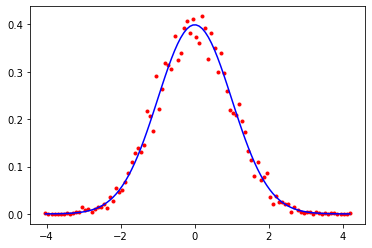

CPU times: user 3.33 ms, sys: 1.13 ms, total: 4.47 ms
Wall time: 1.56 ms
CPU times: user 26.9 ms, sys: 3.62 ms, total: 30.5 ms
Wall time: 10.3 ms
0.038290381982768434


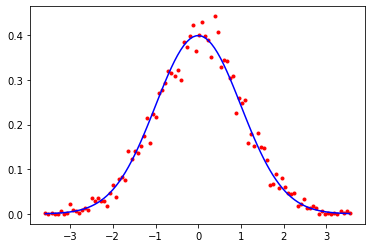

0.04394781924312942


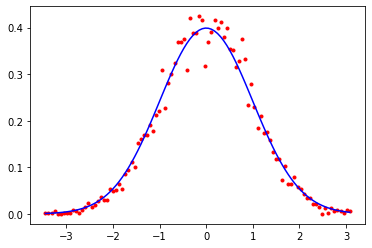

CPU times: user 3.47 ms, sys: 1.62 ms, total: 5.08 ms
Wall time: 1.83 ms
CPU times: user 18.7 ms, sys: 3 ms, total: 21.7 ms
Wall time: 7.43 ms
0.026858870322351253


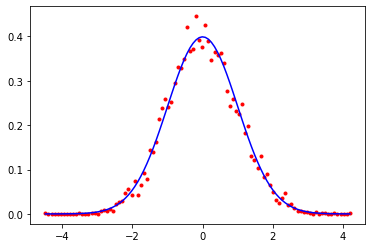

0.023298576296231995


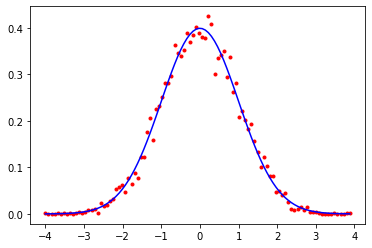

CPU times: user 3.34 ms, sys: 1.43 ms, total: 4.77 ms
Wall time: 1.66 ms
CPU times: user 18.5 ms, sys: 3.04 ms, total: 21.5 ms
Wall time: 7.4 ms
0.04362264513508548


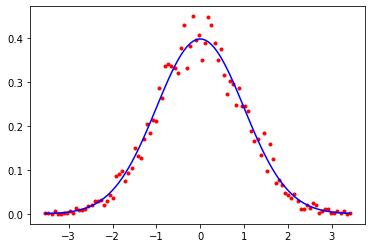

0.042201220216881705


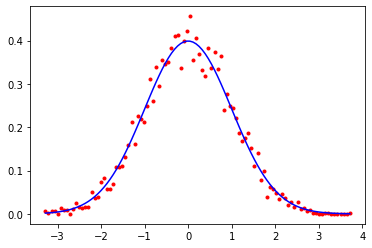

CPU times: user 3.32 ms, sys: 1.2 ms, total: 4.52 ms
Wall time: 1.58 ms
CPU times: user 18.9 ms, sys: 2.9 ms, total: 21.8 ms
Wall time: 7.46 ms
0.03762965212725231


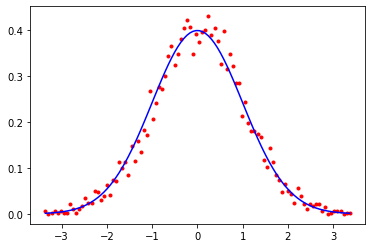

0.019507163256599507


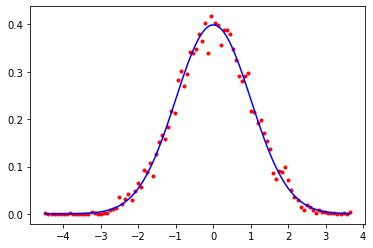

CPU times: user 3.4 ms, sys: 1.57 ms, total: 4.97 ms
Wall time: 1.73 ms
CPU times: user 18.7 ms, sys: 4.78 ms, total: 23.4 ms
Wall time: 8.59 ms
0.028954690885291883


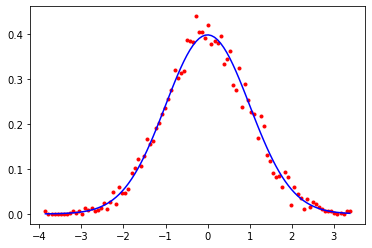

0.02694039163582922


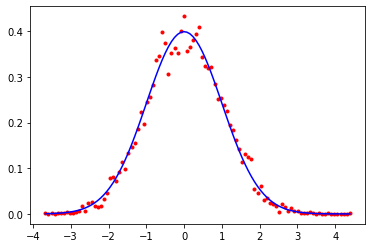

CPU times: user 3.34 ms, sys: 1.19 ms, total: 4.54 ms
Wall time: 1.59 ms
CPU times: user 18.9 ms, sys: 2.89 ms, total: 21.8 ms
Wall time: 7.42 ms
0.03602680392560522


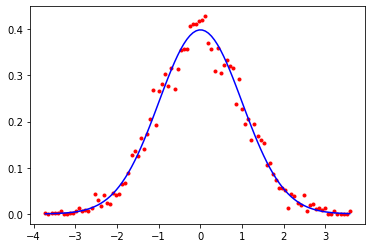

0.017793107397698484


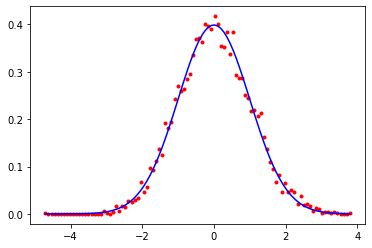

CPU times: user 3.36 ms, sys: 1.43 ms, total: 4.79 ms
Wall time: 1.66 ms
CPU times: user 26.7 ms, sys: 3.75 ms, total: 30.5 ms
Wall time: 10.3 ms
0.033039167066662795


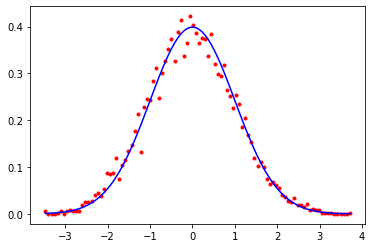

0.02288153684942768


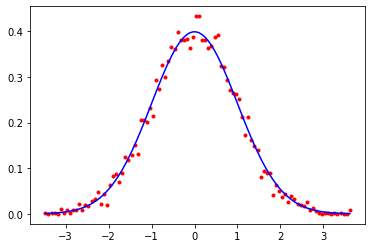

CPU times: user 3.52 ms, sys: 1.4 ms, total: 4.92 ms
Wall time: 1.69 ms
CPU times: user 18.6 ms, sys: 2.99 ms, total: 21.6 ms
Wall time: 7.41 ms
0.029643134199371056


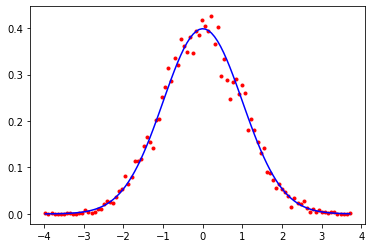

0.023916488951318482


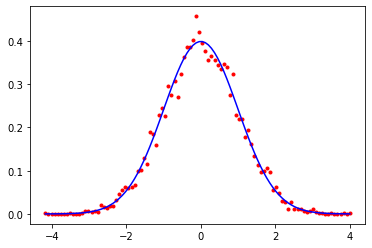

In [37]:
for _ in range(loops):
    %time r_everest = [ lib.get_random_gauss() for _ in range(n)]
    %time r_k2      = [ k2ran.get_random_gauss(100) for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [38]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

0.19021181385401323
0.1792284882905506
[1.03377928 1.01873306 0.84023436 1.03436657 1.04024572 1.03512447
 1.31496452 1.10691491 0.87172468 1.09130048 0.90342776 1.21018455
 0.93341803 1.07369067 1.01670157 1.38889061 1.03671054 1.42294124
 1.20163328 1.11330292]
1.0952546815945101


## 100 samples

In [45]:
n = 100
bins = 5
mu = 0
sigma = 1

loops = 20
S_everest = []
S_K2 = []
f = lambda x: 1/np.sqrt(2*np.pi)/sigma * np.exp(-(x-mu)**2/sigma**2/2)

CPU times: user 44 µs, sys: 12 µs, total: 56 µs
Wall time: 54.1 µs
CPU times: user 229 µs, sys: 6 µs, total: 235 µs
Wall time: 247 µs
0.006966398941906941


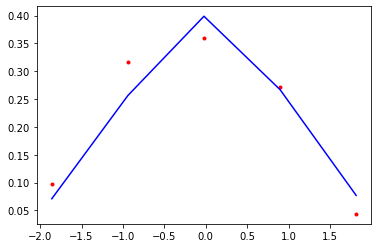

0.015433891071384287


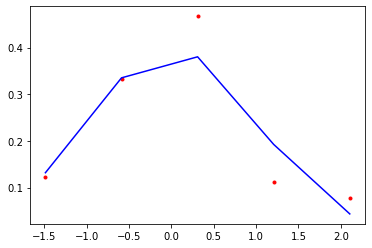

CPU times: user 437 µs, sys: 424 µs, total: 861 µs
Wall time: 287 µs
CPU times: user 413 µs, sys: 49 µs, total: 462 µs
Wall time: 156 µs
0.0034450582032099506


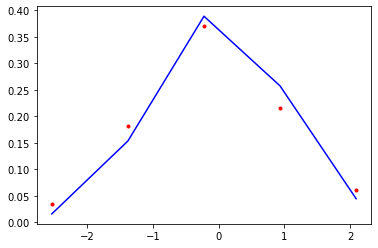

0.022504629138849964


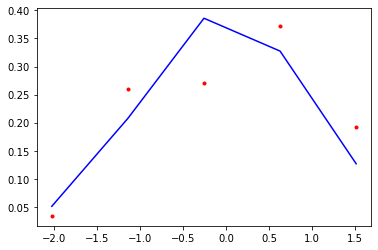

CPU times: user 220 µs, sys: 142 µs, total: 362 µs
Wall time: 131 µs
CPU times: user 469 µs, sys: 91 µs, total: 560 µs
Wall time: 196 µs
0.008917196031358035


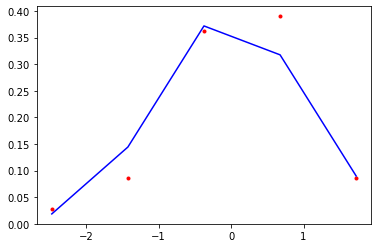

0.007508228353809295


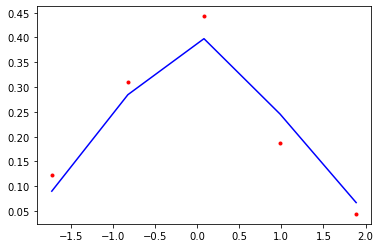

CPU times: user 305 µs, sys: 297 µs, total: 602 µs
Wall time: 207 µs
CPU times: user 405 µs, sys: 47 µs, total: 452 µs
Wall time: 154 µs
0.012416500621759696


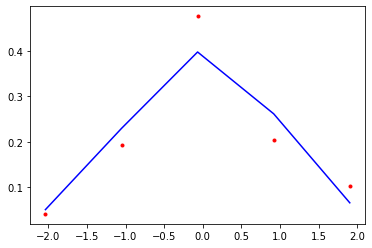

0.008203521779975641


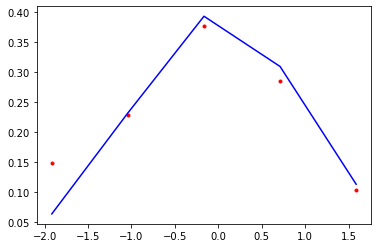

CPU times: user 223 µs, sys: 180 µs, total: 403 µs
Wall time: 153 µs
CPU times: user 487 µs, sys: 62 µs, total: 549 µs
Wall time: 186 µs
0.01588362414330962


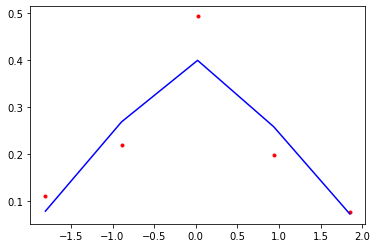

0.00543524623258647


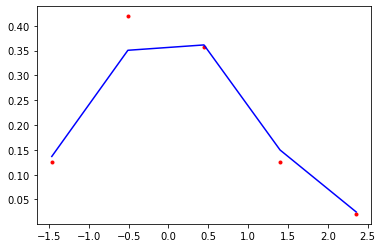

CPU times: user 324 µs, sys: 341 µs, total: 665 µs
Wall time: 229 µs
CPU times: user 407 µs, sys: 48 µs, total: 455 µs
Wall time: 155 µs
0.004643340000900424


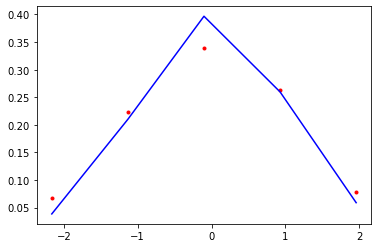

0.010486659432817355


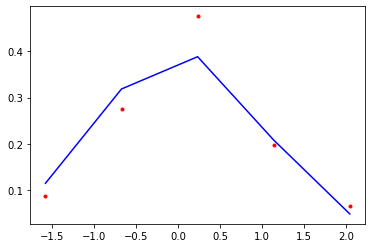

CPU times: user 214 µs, sys: 194 µs, total: 408 µs
Wall time: 148 µs
CPU times: user 412 µs, sys: 49 µs, total: 461 µs
Wall time: 156 µs
0.016459256403781923


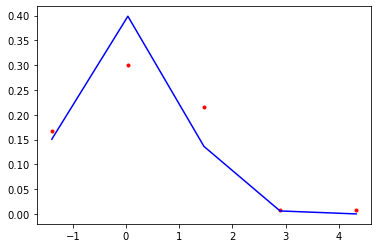

0.0021626031587232927


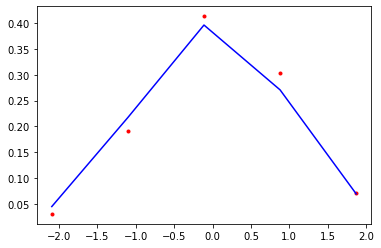

CPU times: user 304 µs, sys: 275 µs, total: 579 µs
Wall time: 203 µs
CPU times: user 410 µs, sys: 48 µs, total: 458 µs
Wall time: 156 µs
0.003595210978597635


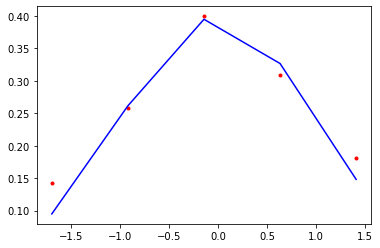

0.011541535673239602


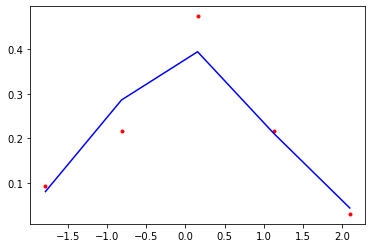

CPU times: user 345 µs, sys: 349 µs, total: 694 µs
Wall time: 241 µs
CPU times: user 499 µs, sys: 59 µs, total: 558 µs
Wall time: 189 µs
0.004458240039313526


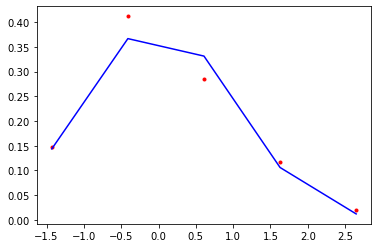

0.0016659389296051438


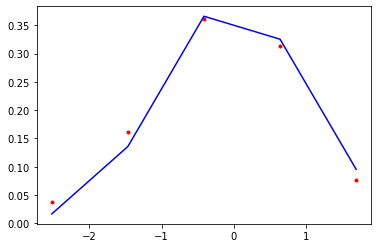

CPU times: user 307 µs, sys: 287 µs, total: 594 µs
Wall time: 205 µs
CPU times: user 412 µs, sys: 49 µs, total: 461 µs
Wall time: 157 µs
0.003971557745628575


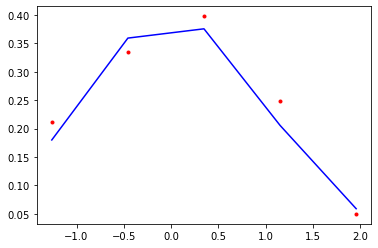

0.009123992203552967


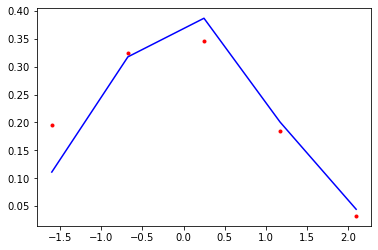

CPU times: user 219 µs, sys: 199 µs, total: 418 µs
Wall time: 153 µs
CPU times: user 410 µs, sys: 47 µs, total: 457 µs
Wall time: 155 µs
0.0027397003896002725


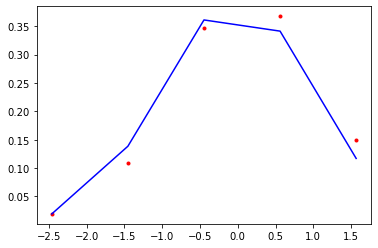

0.0009777707604136042


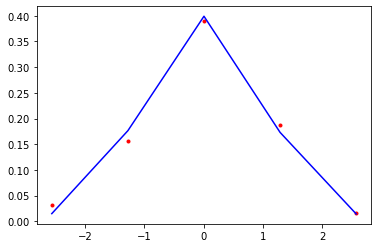

CPU times: user 202 µs, sys: 145 µs, total: 347 µs
Wall time: 126 µs
CPU times: user 408 µs, sys: 48 µs, total: 456 µs
Wall time: 155 µs
0.007391883058440993


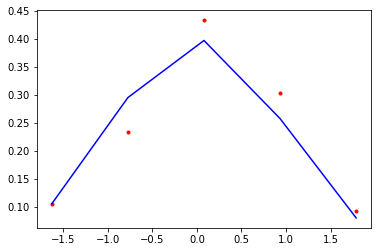

0.003920247528713821


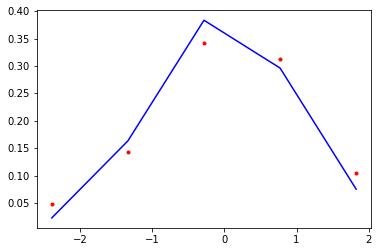

CPU times: user 329 µs, sys: 341 µs, total: 670 µs
Wall time: 228 µs
CPU times: user 407 µs, sys: 49 µs, total: 456 µs
Wall time: 154 µs
0.003924958134411194


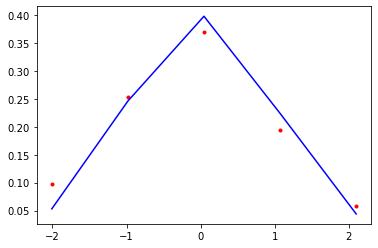

0.0026318953359489843


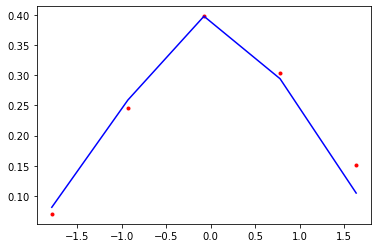

CPU times: user 253 µs, sys: 246 µs, total: 499 µs
Wall time: 172 µs
CPU times: user 405 µs, sys: 47 µs, total: 452 µs
Wall time: 153 µs
0.0007489325072959743


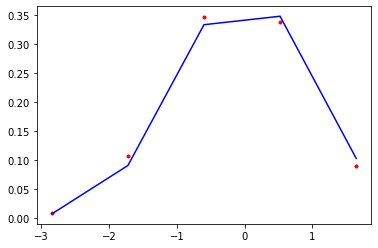

0.005223556421919208


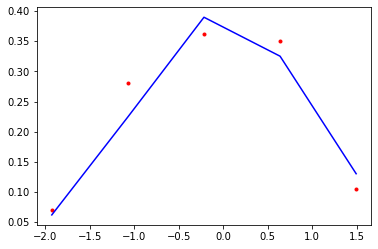

CPU times: user 308 µs, sys: 238 µs, total: 546 µs
Wall time: 178 µs
CPU times: user 406 µs, sys: 48 µs, total: 454 µs
Wall time: 154 µs
0.014429396133701543


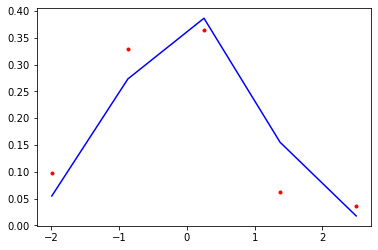

0.0015077381988199382


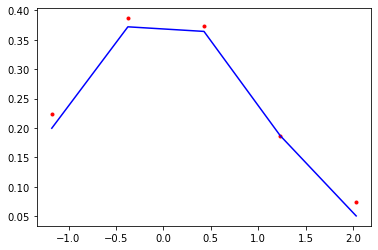

CPU times: user 277 µs, sys: 218 µs, total: 495 µs
Wall time: 168 µs
CPU times: user 405 µs, sys: 49 µs, total: 454 µs
Wall time: 154 µs
0.005287094983069826


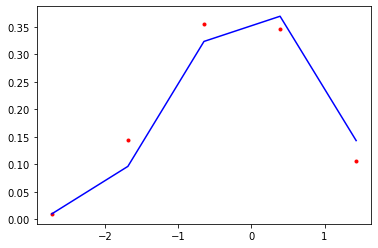

0.0013557446195910654


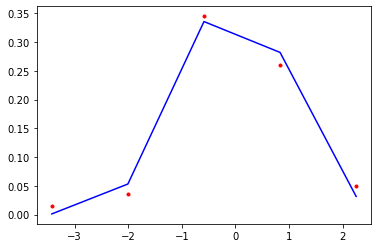

CPU times: user 239 µs, sys: 213 µs, total: 452 µs
Wall time: 159 µs
CPU times: user 411 µs, sys: 49 µs, total: 460 µs
Wall time: 156 µs
0.008440296618306512


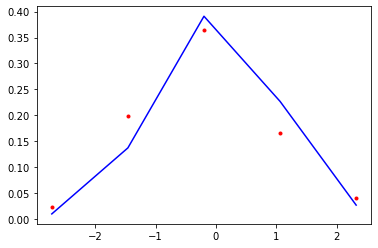

0.0073668115582344


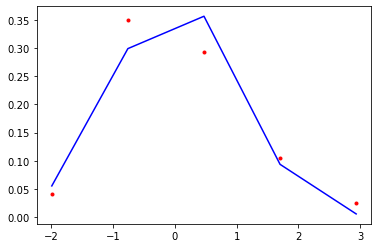

CPU times: user 323 µs, sys: 426 µs, total: 749 µs
Wall time: 261 µs
CPU times: user 407 µs, sys: 46 µs, total: 453 µs
Wall time: 154 µs
0.019551825523440734


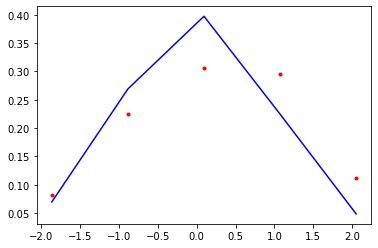

0.010827527863473524


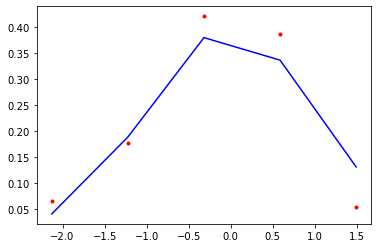

CPU times: user 253 µs, sys: 184 µs, total: 437 µs
Wall time: 155 µs
CPU times: user 408 µs, sys: 48 µs, total: 456 µs
Wall time: 155 µs
0.004094150722422508


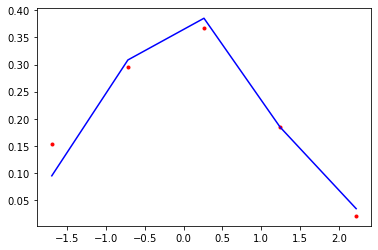

0.002939113014762313


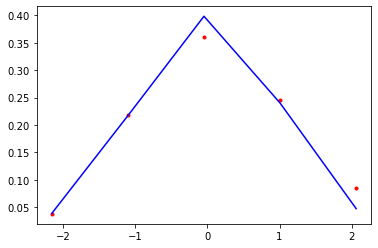

CPU times: user 274 µs, sys: 251 µs, total: 525 µs
Wall time: 183 µs
CPU times: user 408 µs, sys: 49 µs, total: 457 µs
Wall time: 154 µs
0.004276764176401133


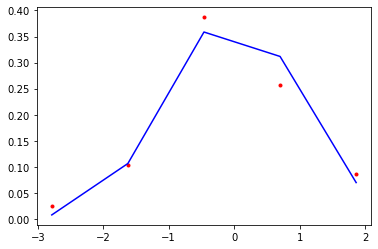

0.004574223730812333


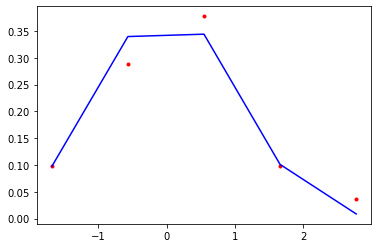

In [46]:
for _ in range(loops):
    %time r_everest = [ lib.get_random_gauss() for _ in range(n)]
    %time r_k2      = [ k2ran.get_random_gauss(100) for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [47]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

0.08707507833957344
0.08227723713373987
[0.67184093 0.39125721 1.08979653 1.23026718 1.70948459 0.66542124
 2.75877759 0.55812361 1.6358828  0.65976305 1.6739135  1.37315891
 1.22118991 0.3786502  3.09357828 1.97478405 1.07038268 1.34378256
 1.18024935 0.96693872]
1.4624671898072636


# Uniform random number generator

## 1000000 samples

In [55]:
n = 1000000
bins = 1000

loops = 20
S_everest = []
S_K2 = []
f = lambda _: 1

CPU times: user 176 ms, sys: 10 ms, total: 186 ms
Wall time: 185 ms
CPU times: user 1.36 s, sys: 13.1 ms, total: 1.38 s
Wall time: 1.38 s
0.9811428804950595


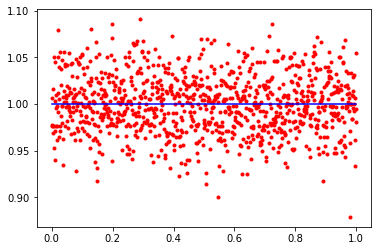

0.9714757340305372


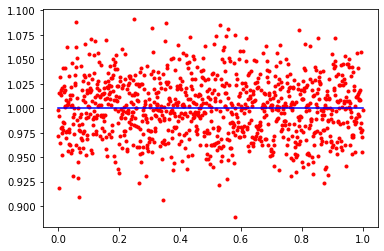

CPU times: user 221 ms, sys: 27.2 ms, total: 249 ms
Wall time: 175 ms
CPU times: user 1.4 s, sys: 15.7 ms, total: 1.42 s
Wall time: 1.42 s
0.9114116798101428


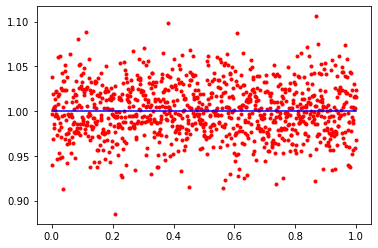

0.949242638790609


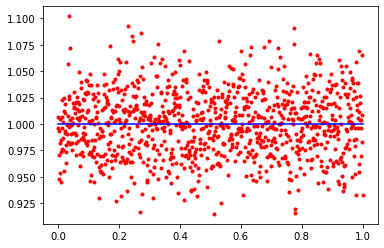

CPU times: user 250 ms, sys: 33.8 ms, total: 284 ms
Wall time: 179 ms
CPU times: user 1.36 s, sys: 13.9 ms, total: 1.37 s
Wall time: 1.37 s
0.988046122188174


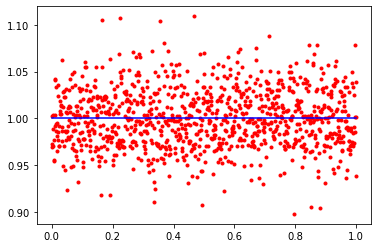

1.0162085469895672


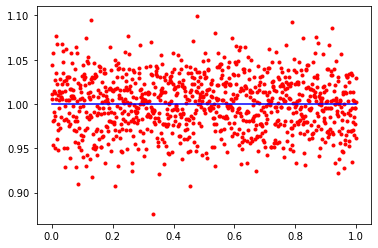

CPU times: user 263 ms, sys: 37.2 ms, total: 300 ms
Wall time: 182 ms
CPU times: user 1.39 s, sys: 17.9 ms, total: 1.41 s
Wall time: 1.41 s
1.0607046984673194


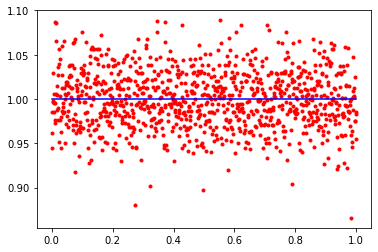

1.0264375818965952


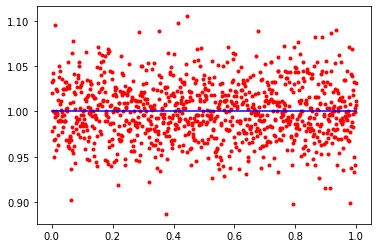

CPU times: user 248 ms, sys: 35.8 ms, total: 284 ms
Wall time: 182 ms
CPU times: user 1.42 s, sys: 18.3 ms, total: 1.44 s
Wall time: 1.45 s
1.0380420901626874


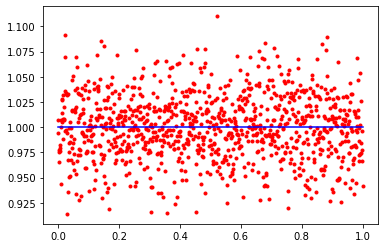

0.9697633717846035


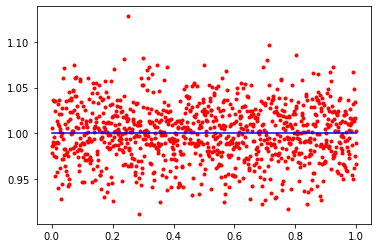

CPU times: user 267 ms, sys: 34.3 ms, total: 301 ms
Wall time: 180 ms
CPU times: user 1.41 s, sys: 15.6 ms, total: 1.42 s
Wall time: 1.43 s
1.0340569142155687


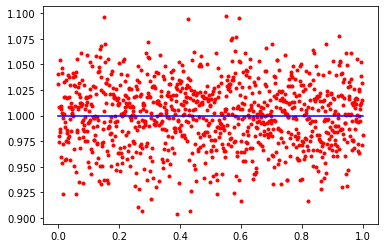

0.9708421370817122


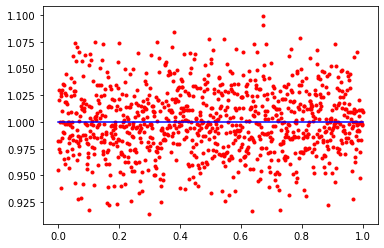

CPU times: user 240 ms, sys: 29.6 ms, total: 270 ms
Wall time: 176 ms
CPU times: user 1.41 s, sys: 18.6 ms, total: 1.43 s
Wall time: 1.43 s
1.0050792956043313


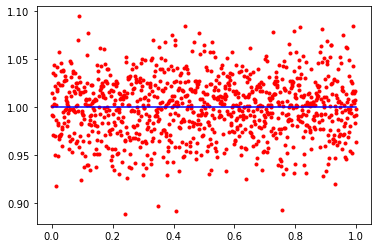

0.9504795239103538


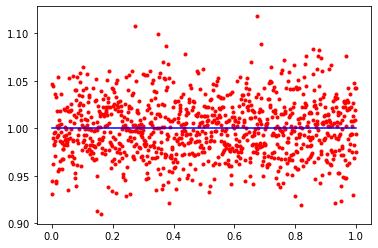

CPU times: user 236 ms, sys: 28 ms, total: 264 ms
Wall time: 174 ms
CPU times: user 1.37 s, sys: 14 ms, total: 1.39 s
Wall time: 1.39 s
0.9737681505514285


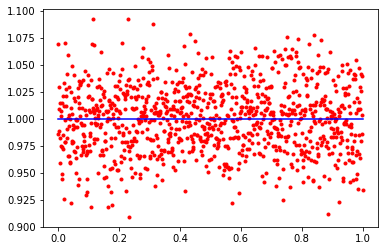

0.9797241998079158


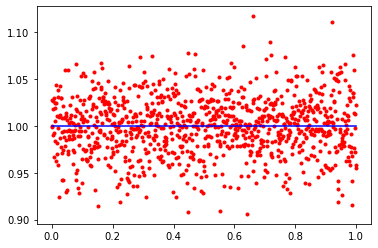

CPU times: user 269 ms, sys: 34.6 ms, total: 304 ms
Wall time: 187 ms
CPU times: user 1.37 s, sys: 13.1 ms, total: 1.38 s
Wall time: 1.38 s
1.0486615898274043


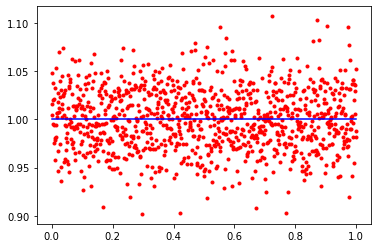

0.9427977719798087


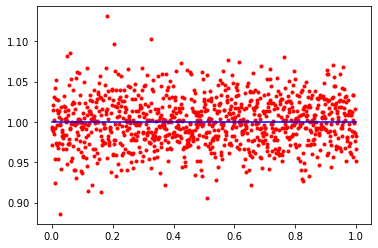

CPU times: user 261 ms, sys: 33.5 ms, total: 294 ms
Wall time: 174 ms
CPU times: user 1.34 s, sys: 12 ms, total: 1.35 s
Wall time: 1.36 s
0.9220646106732864


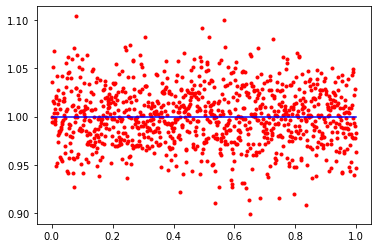

0.9579270032996225


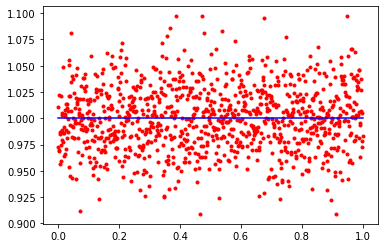

CPU times: user 237 ms, sys: 27.7 ms, total: 265 ms
Wall time: 174 ms
CPU times: user 1.35 s, sys: 11.7 ms, total: 1.36 s
Wall time: 1.36 s
0.99328998872568


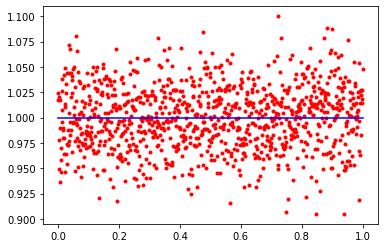

1.0542105199041223


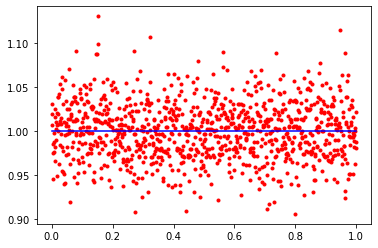

CPU times: user 264 ms, sys: 32.4 ms, total: 296 ms
Wall time: 179 ms
CPU times: user 1.33 s, sys: 12.4 ms, total: 1.34 s
Wall time: 1.34 s
1.0884755788901295


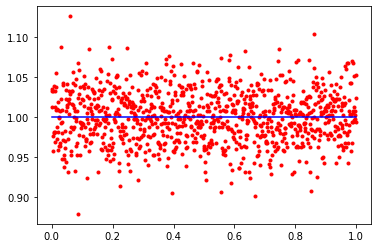

1.0337106764471562


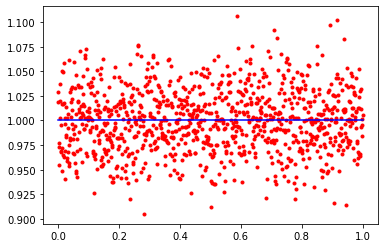

CPU times: user 237 ms, sys: 25.2 ms, total: 262 ms
Wall time: 176 ms
CPU times: user 1.35 s, sys: 12.6 ms, total: 1.36 s
Wall time: 1.36 s
1.035697247258721


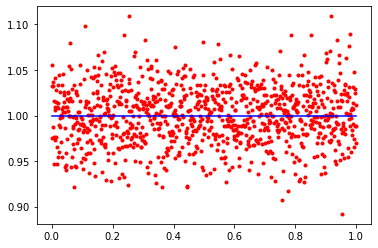

1.0591904982455884


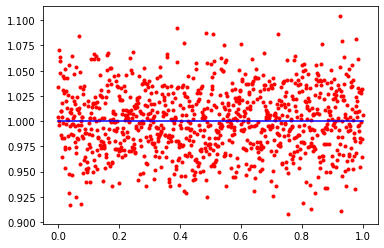

CPU times: user 240 ms, sys: 31.5 ms, total: 271 ms
Wall time: 176 ms
CPU times: user 1.38 s, sys: 14.5 ms, total: 1.39 s
Wall time: 1.39 s
1.0199404445977387


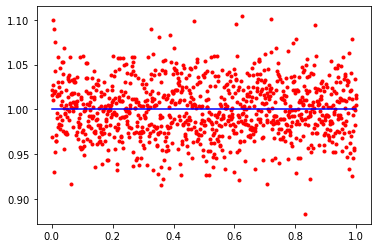

0.9628590957920653


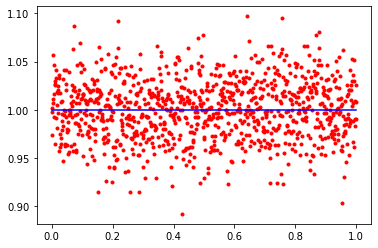

CPU times: user 259 ms, sys: 31 ms, total: 290 ms
Wall time: 170 ms
CPU times: user 1.33 s, sys: 12.4 ms, total: 1.34 s
Wall time: 1.34 s
0.9468561113735091


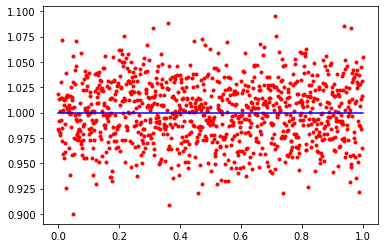

1.0007557281163915


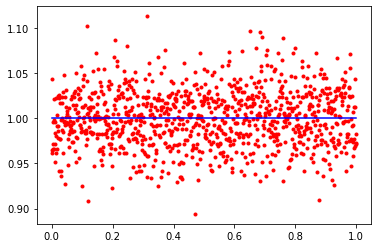

CPU times: user 260 ms, sys: 32.4 ms, total: 293 ms
Wall time: 172 ms
CPU times: user 1.34 s, sys: 11.4 ms, total: 1.35 s
Wall time: 1.35 s
0.9876037953107801


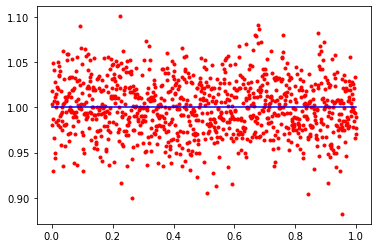

0.977091955463267


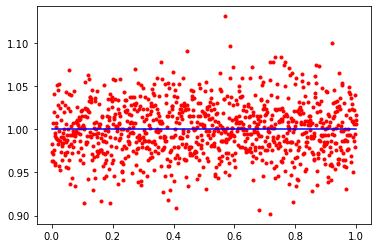

CPU times: user 253 ms, sys: 31.2 ms, total: 284 ms
Wall time: 174 ms
CPU times: user 1.37 s, sys: 13.9 ms, total: 1.38 s
Wall time: 1.38 s
1.0330744313252216


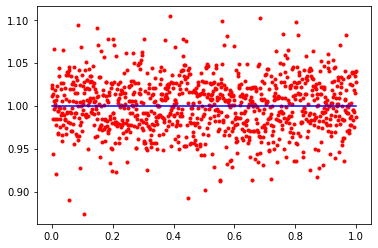

0.9834372663649021


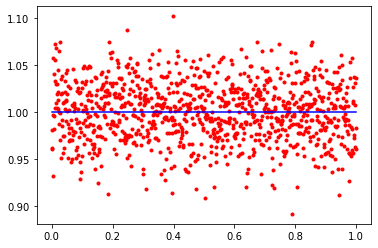

CPU times: user 258 ms, sys: 34 ms, total: 292 ms
Wall time: 174 ms
CPU times: user 1.34 s, sys: 12.4 ms, total: 1.35 s
Wall time: 1.35 s
1.015951577754692


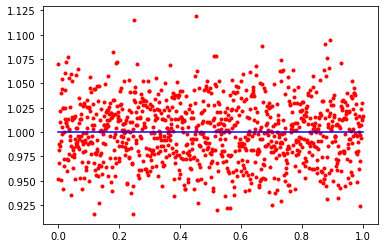

1.0317662904996765


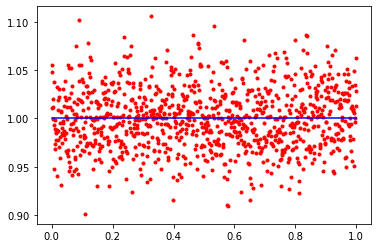

CPU times: user 242 ms, sys: 27.1 ms, total: 269 ms
Wall time: 170 ms
CPU times: user 1.34 s, sys: 12.6 ms, total: 1.35 s
Wall time: 1.35 s
0.917745937998119


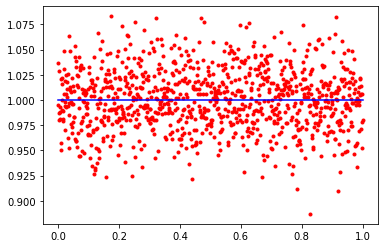

1.079068775144468


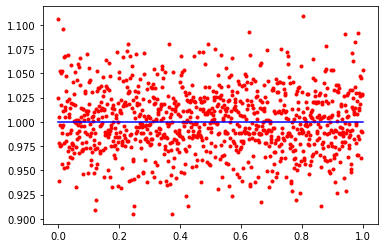

CPU times: user 238 ms, sys: 28.5 ms, total: 267 ms
Wall time: 172 ms
CPU times: user 1.36 s, sys: 12.2 ms, total: 1.37 s
Wall time: 1.37 s
1.0203281177116736


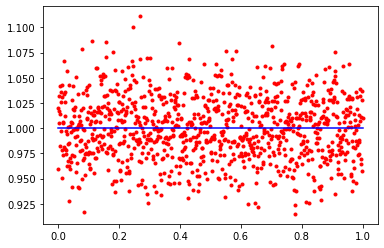

1.0364211711576443


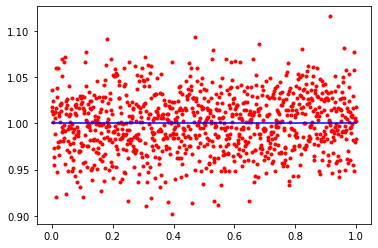

In [56]:
for _ in range(loops):
    %time r_everest = [ lib.get_random() for _ in range(n)]
    %time r_k2      = [ k2ran.get_random() for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [57]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

1.0005483812125646
0.998834583069354
[1.00496318 0.97987048 0.98604603 1.01655522 1.03460505 1.03204329
 1.02832118 0.99695571 1.05465012 0.9811027  0.97067614 1.02614762
 0.98884762 1.02921484 0.97269784 1.00536476 1.02492592 0.9923065
 0.92222454 0.99220586]
1.0024174055566557


## 5000 samples

In [58]:
n = 5000
bins = 100

loops = 20
S_everest = []
S_K2 = []
f = lambda _: 1

CPU times: user 9.04 ms, sys: 4.59 ms, total: 13.6 ms
Wall time: 12.5 ms
CPU times: user 16 ms, sys: 2.9 ms, total: 18.9 ms
Wall time: 18.9 ms
2.338997965751577


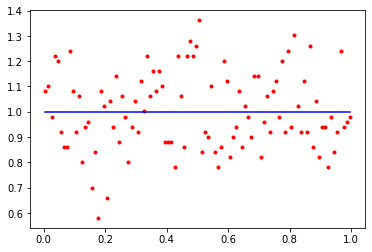

1.8266234100034078


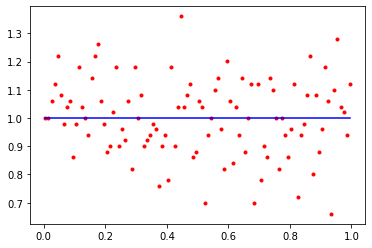

CPU times: user 2.69 ms, sys: 1.3 ms, total: 3.99 ms
Wall time: 1.42 ms
CPU times: user 18.4 ms, sys: 3.26 ms, total: 21.7 ms
Wall time: 7.51 ms
2.3449065924102848


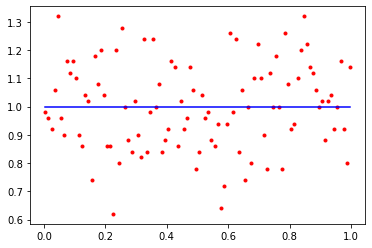

2.2291049779697834


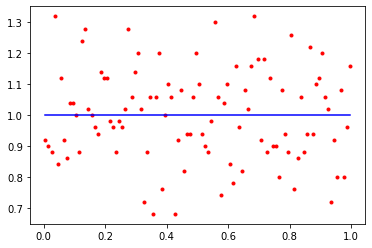

CPU times: user 3.17 ms, sys: 1.78 ms, total: 4.95 ms
Wall time: 1.69 ms
CPU times: user 18.8 ms, sys: 2.99 ms, total: 21.8 ms
Wall time: 7.57 ms
1.8482698989144428


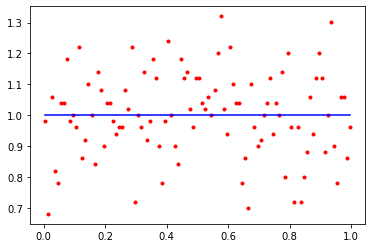

2.3266316452818363


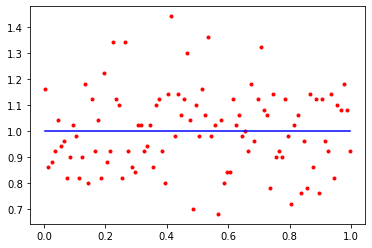

CPU times: user 3.14 ms, sys: 1.89 ms, total: 5.02 ms
Wall time: 1.73 ms
CPU times: user 18.9 ms, sys: 2.9 ms, total: 21.8 ms
Wall time: 7.44 ms
1.97426997194145


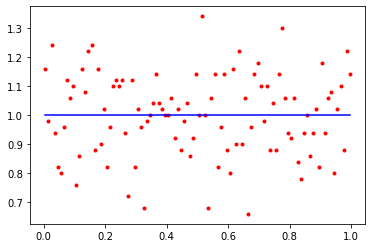

2.1188357969211413


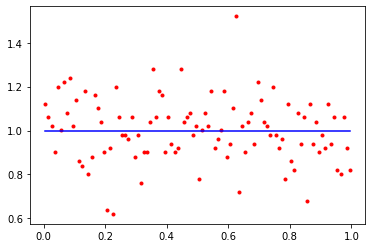

CPU times: user 3.16 ms, sys: 1.92 ms, total: 5.08 ms
Wall time: 1.76 ms
CPU times: user 18.8 ms, sys: 3.02 ms, total: 21.8 ms
Wall time: 7.48 ms
1.5697557563429112


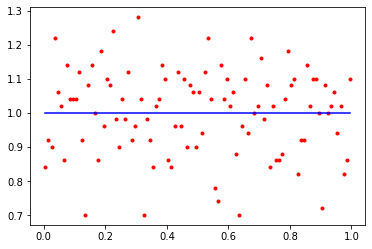

1.787766084176532


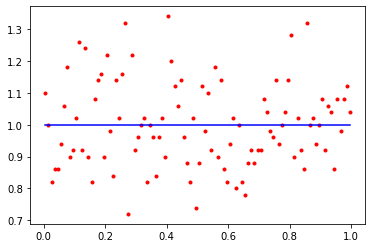

CPU times: user 3.37 ms, sys: 2.25 ms, total: 5.62 ms
Wall time: 1.92 ms
CPU times: user 18.3 ms, sys: 3.05 ms, total: 21.3 ms
Wall time: 7.32 ms
2.525259750690953


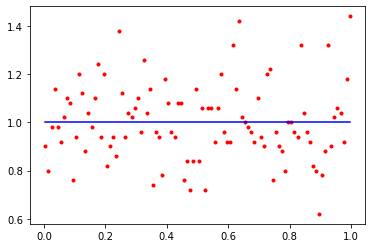

2.0075714314853603


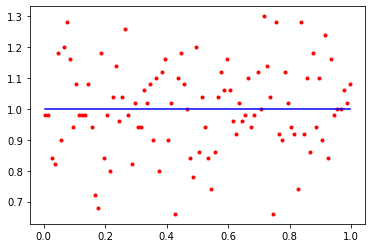

CPU times: user 3 ms, sys: 1.46 ms, total: 4.46 ms
Wall time: 1.54 ms
CPU times: user 18.7 ms, sys: 2.86 ms, total: 21.6 ms
Wall time: 7.36 ms
2.033900467582207


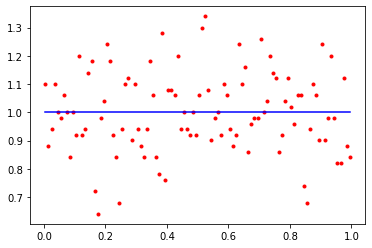

1.747047123514838


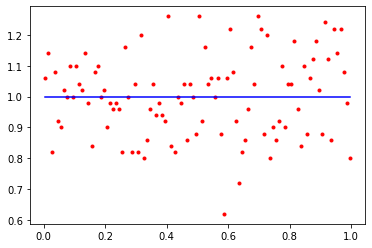

CPU times: user 2.92 ms, sys: 1.56 ms, total: 4.48 ms
Wall time: 1.6 ms
CPU times: user 18.6 ms, sys: 3.25 ms, total: 21.9 ms
Wall time: 7.58 ms
2.0012320517781754


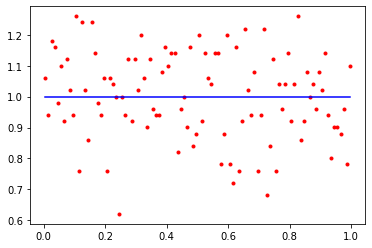

1.7174510042862776


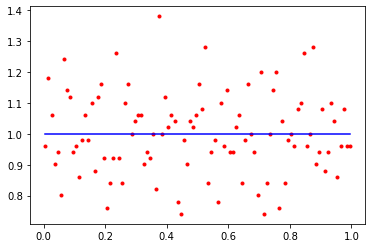

CPU times: user 3.28 ms, sys: 2.01 ms, total: 5.29 ms
Wall time: 1.85 ms
CPU times: user 18.6 ms, sys: 2.68 ms, total: 21.2 ms
Wall time: 7.2 ms
1.8844478955936772


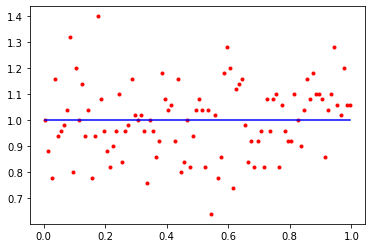

2.1864342630371394


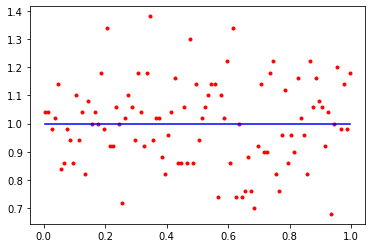

CPU times: user 3.32 ms, sys: 2.31 ms, total: 5.64 ms
Wall time: 1.96 ms
CPU times: user 18.3 ms, sys: 2.95 ms, total: 21.3 ms
Wall time: 7.3 ms
1.8499846988972117


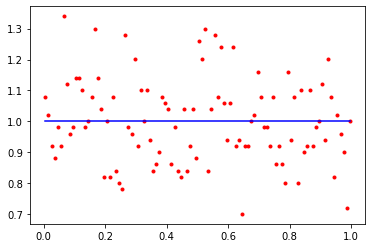

2.1082515633852643


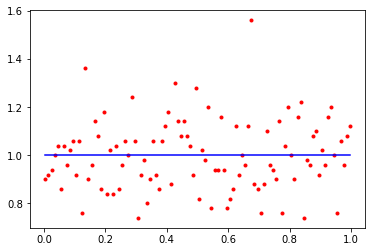

CPU times: user 3.01 ms, sys: 1.7 ms, total: 4.71 ms
Wall time: 1.63 ms
CPU times: user 18.9 ms, sys: 2.69 ms, total: 21.6 ms
Wall time: 7.32 ms
2.3762835997238847


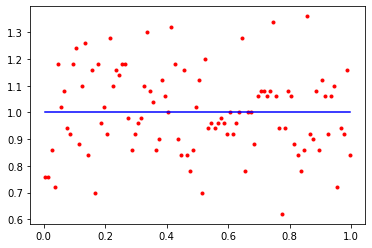

2.1890471454536917


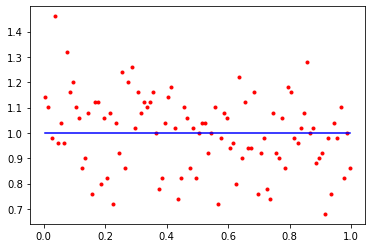

CPU times: user 3.22 ms, sys: 1.56 ms, total: 4.78 ms
Wall time: 1.64 ms
CPU times: user 18.3 ms, sys: 3.19 ms, total: 21.5 ms
Wall time: 7.4 ms
1.9006794605099635


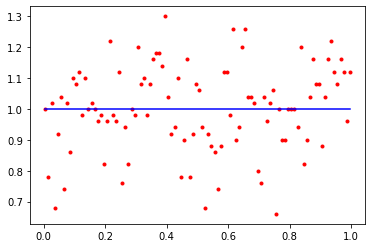

1.8174741157759386


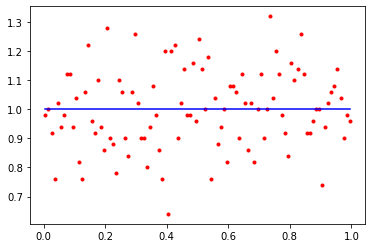

CPU times: user 3.39 ms, sys: 2.38 ms, total: 5.77 ms
Wall time: 1.95 ms
CPU times: user 18.7 ms, sys: 2.95 ms, total: 21.6 ms
Wall time: 7.38 ms
1.9417925367571722


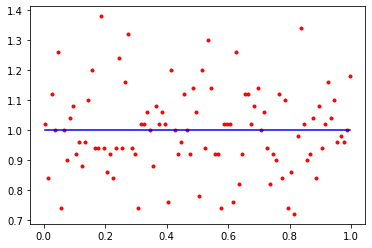

1.7522946484716493


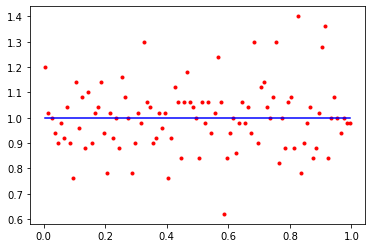

CPU times: user 5.01 ms, sys: 2.28 ms, total: 7.3 ms
Wall time: 3.02 ms
CPU times: user 18.7 ms, sys: 3.02 ms, total: 21.7 ms
Wall time: 7.43 ms
2.425684117637789


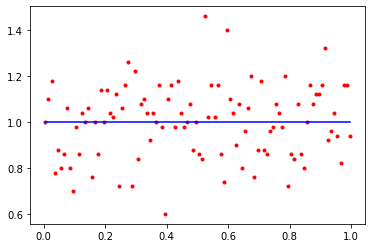

1.8995108621689227


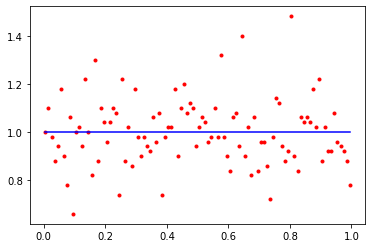

CPU times: user 3.07 ms, sys: 1.76 ms, total: 4.83 ms
Wall time: 1.68 ms
CPU times: user 18.4 ms, sys: 3.07 ms, total: 21.5 ms
Wall time: 7.41 ms
2.011620006957703


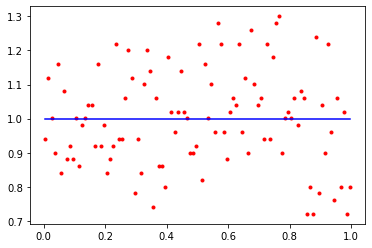

2.006437840935834


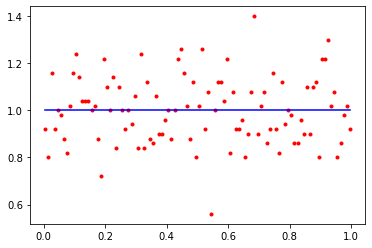

CPU times: user 2.97 ms, sys: 2.07 ms, total: 5.05 ms
Wall time: 1.78 ms
CPU times: user 18.7 ms, sys: 2.77 ms, total: 21.5 ms
Wall time: 7.3 ms
2.459213493430965


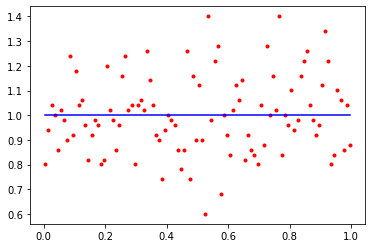

1.9672223200975063


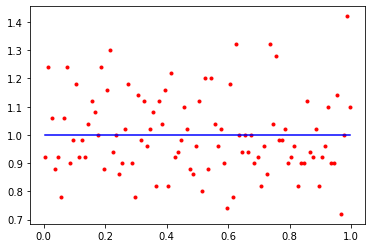

CPU times: user 3.08 ms, sys: 2.04 ms, total: 5.12 ms
Wall time: 1.79 ms
CPU times: user 18.3 ms, sys: 3.06 ms, total: 21.4 ms
Wall time: 7.37 ms
1.8633423028045848


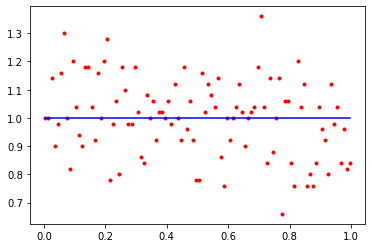

1.8571658953223917


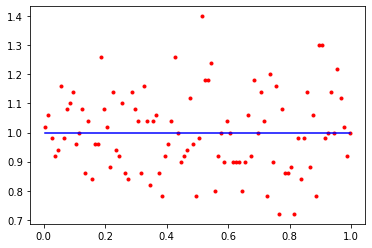

CPU times: user 3.23 ms, sys: 1.57 ms, total: 4.8 ms
Wall time: 1.67 ms
CPU times: user 18.4 ms, sys: 2.81 ms, total: 21.2 ms
Wall time: 7.23 ms
2.0456625330510727


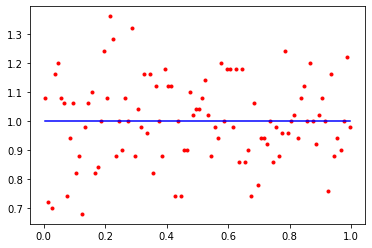

2.022324759113721


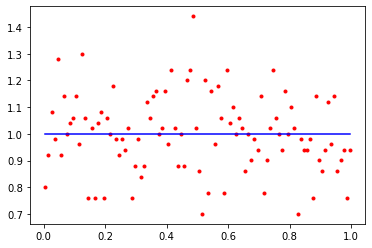

CPU times: user 2.84 ms, sys: 1.1 ms, total: 3.95 ms
Wall time: 1.37 ms
CPU times: user 18.3 ms, sys: 3.12 ms, total: 21.5 ms
Wall time: 7.42 ms
1.7698107236989278


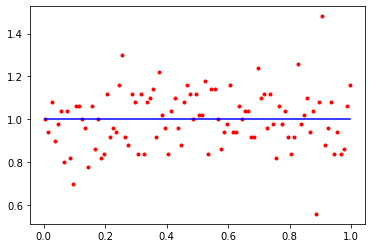

1.9679728551994862


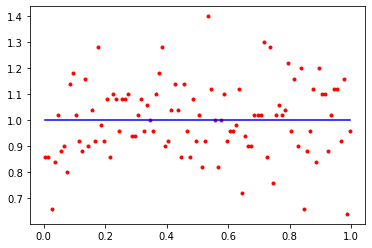

CPU times: user 2.89 ms, sys: 1.24 ms, total: 4.12 ms
Wall time: 1.43 ms
CPU times: user 18.5 ms, sys: 3 ms, total: 21.5 ms
Wall time: 7.39 ms
2.04905800223767


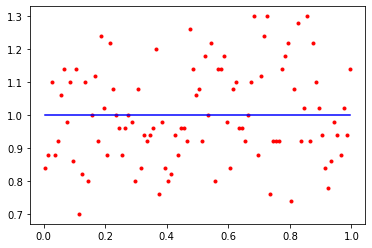

1.6841209366757248


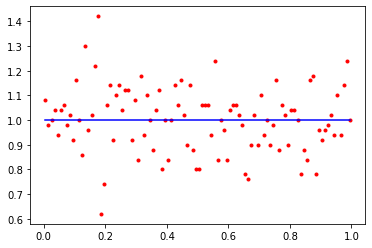

In [59]:
for _ in range(loops):
    %time r_everest = [ lib.get_random() for _ in range(n)]
    %time r_k2      = [ k2ran.get_random() for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [60]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

1.4355168377053718
1.4003443983405734
[1.13159342 1.02564605 0.89128968 0.96528291 0.93704553 1.12154712
 1.07897787 1.07945998 0.92837589 0.93674817 1.0418893  1.02263423
 1.05268357 1.13004628 1.00129055 1.11807618 1.00166148 1.00575348
 0.94831771 1.10303804]
1.0286727825224966


## 100 samples

In [61]:
n = 100
bins = 15

loops = 20
S_everest = []
S_K2 = []
f = lambda _: 1

CPU times: user 101 µs, sys: 16 µs, total: 117 µs
Wall time: 111 µs
CPU times: user 247 µs, sys: 3 µs, total: 250 µs
Wall time: 255 µs
2.525812677796363


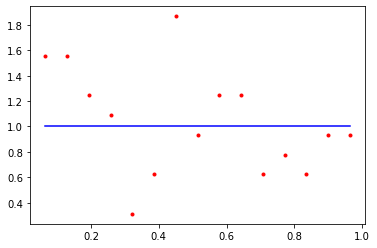

2.277139481578156


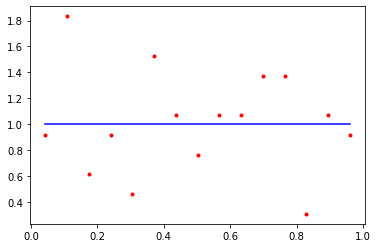

CPU times: user 159 µs, sys: 127 µs, total: 286 µs
Wall time: 110 µs
CPU times: user 408 µs, sys: 47 µs, total: 455 µs
Wall time: 154 µs
3.5212406457404533


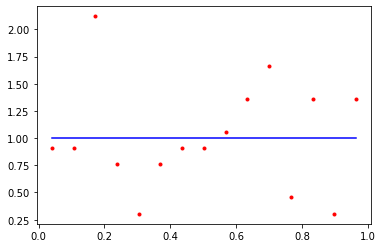

1.857547533732423


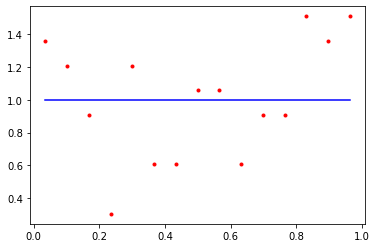

CPU times: user 499 µs, sys: 456 µs, total: 955 µs
Wall time: 323 µs
CPU times: user 351 µs, sys: 80 µs, total: 431 µs
Wall time: 157 µs
1.6667308201658468


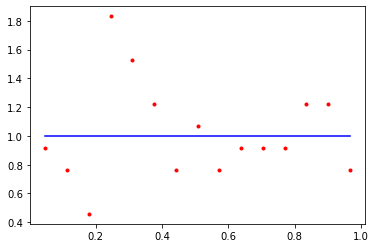

3.8206105605542686


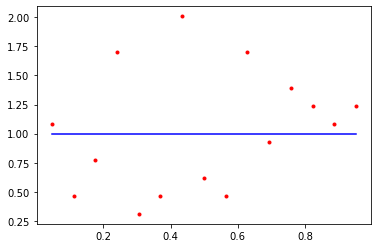

CPU times: user 317 µs, sys: 247 µs, total: 564 µs
Wall time: 200 µs
CPU times: user 424 µs, sys: 50 µs, total: 474 µs
Wall time: 161 µs
3.8147549310062034


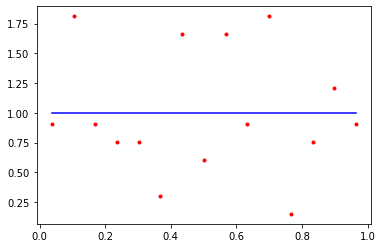

1.2580653605142074


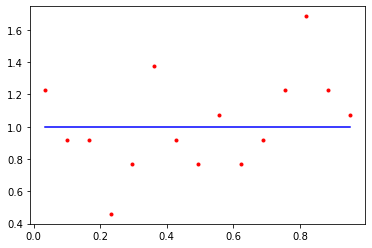

CPU times: user 382 µs, sys: 446 µs, total: 828 µs
Wall time: 287 µs
CPU times: user 461 µs, sys: 64 µs, total: 525 µs
Wall time: 178 µs
2.0482372081384552


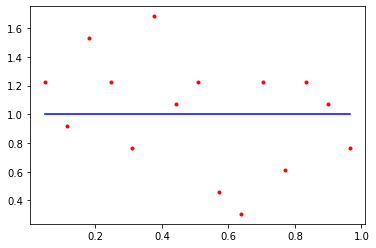

2.203223835192794


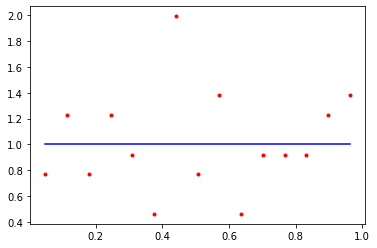

CPU times: user 200 µs, sys: 127 µs, total: 327 µs
Wall time: 124 µs
CPU times: user 359 µs, sys: 116 µs, total: 475 µs
Wall time: 177 µs
3.197477716114567


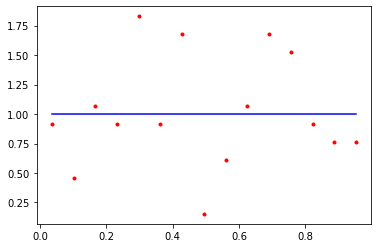

1.9803258879247443


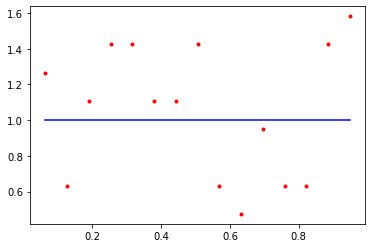

CPU times: user 122 µs, sys: 205 µs, total: 327 µs
Wall time: 116 µs
CPU times: user 409 µs, sys: 49 µs, total: 458 µs
Wall time: 155 µs
3.1636580576600237


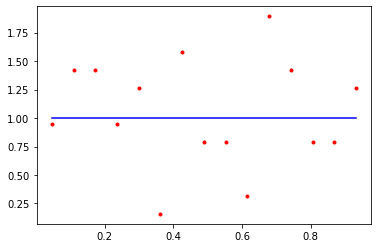

1.7411988927500992


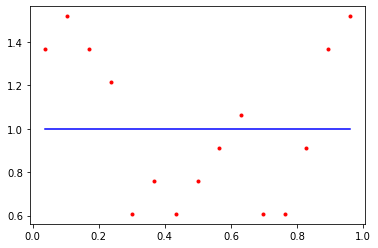

CPU times: user 233 µs, sys: 268 µs, total: 501 µs
Wall time: 187 µs
CPU times: user 412 µs, sys: 47 µs, total: 459 µs
Wall time: 156 µs
2.3250752544833877


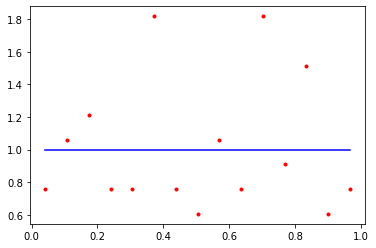

1.2997898730020068


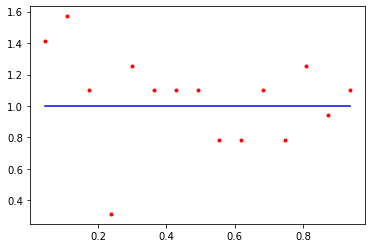

CPU times: user 170 µs, sys: 106 µs, total: 276 µs
Wall time: 99.9 µs
CPU times: user 407 µs, sys: 49 µs, total: 456 µs
Wall time: 154 µs
0.9311587117359346


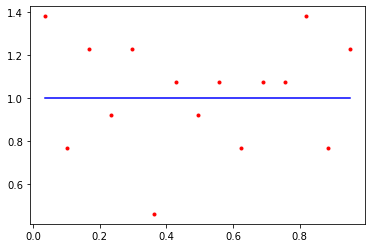

1.1374111699055245


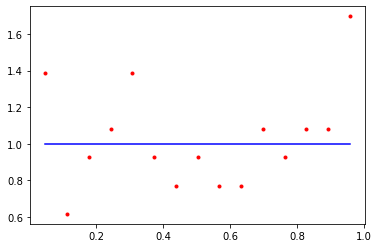

CPU times: user 320 µs, sys: 367 µs, total: 687 µs
Wall time: 244 µs
CPU times: user 411 µs, sys: 49 µs, total: 460 µs
Wall time: 156 µs
1.9944008279784067


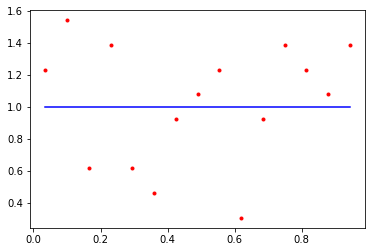

1.123734829388846


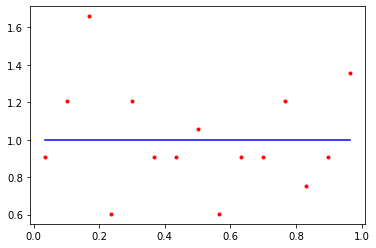

CPU times: user 262 µs, sys: 303 µs, total: 565 µs
Wall time: 202 µs
CPU times: user 406 µs, sys: 48 µs, total: 454 µs
Wall time: 154 µs
1.8150916434682696


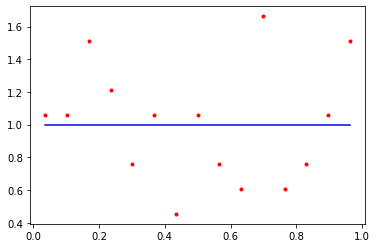

1.5561766182252008


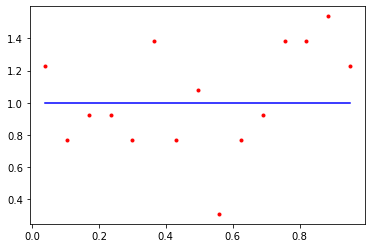

CPU times: user 222 µs, sys: 220 µs, total: 442 µs
Wall time: 161 µs
CPU times: user 407 µs, sys: 48 µs, total: 455 µs
Wall time: 154 µs
1.0422631420817172


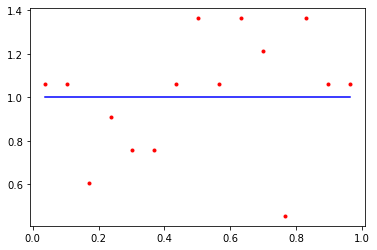

1.5593564460061868


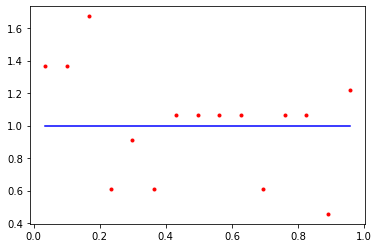

CPU times: user 251 µs, sys: 240 µs, total: 491 µs
Wall time: 189 µs
CPU times: user 363 µs, sys: 94 µs, total: 457 µs
Wall time: 173 µs
1.9723935983152308


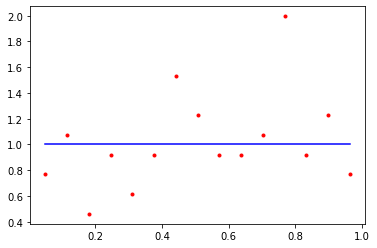

1.8453256205842636


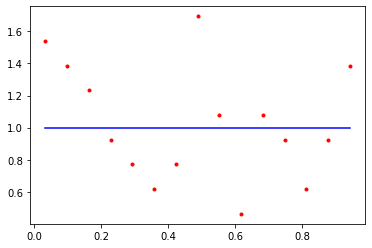

CPU times: user 197 µs, sys: 134 µs, total: 331 µs
Wall time: 123 µs
CPU times: user 356 µs, sys: 79 µs, total: 435 µs
Wall time: 159 µs
1.7234907508860198


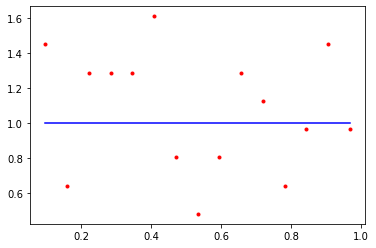

1.720495944459295


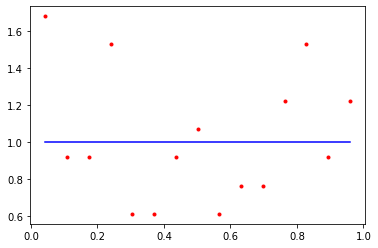

CPU times: user 144 µs, sys: 219 µs, total: 363 µs
Wall time: 122 µs
CPU times: user 416 µs, sys: 49 µs, total: 465 µs
Wall time: 158 µs
1.8798484282575478


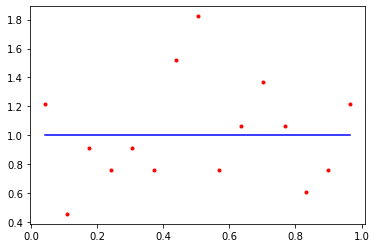

1.8791642446173977


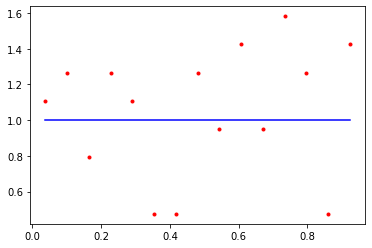

CPU times: user 241 µs, sys: 240 µs, total: 481 µs
Wall time: 180 µs
CPU times: user 399 µs, sys: 100 µs, total: 499 µs
Wall time: 182 µs
2.3177671624490483


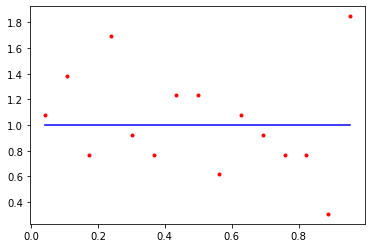

4.5564998971633885


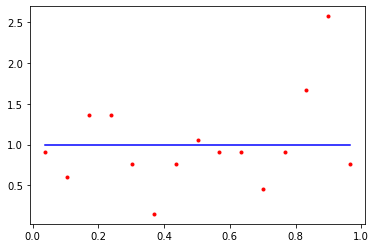

CPU times: user 198 µs, sys: 106 µs, total: 304 µs
Wall time: 112 µs
CPU times: user 417 µs, sys: 49 µs, total: 466 µs
Wall time: 158 µs
1.7894459271039052


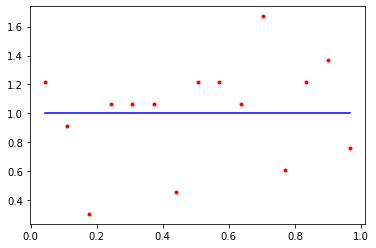

1.7770382170139516


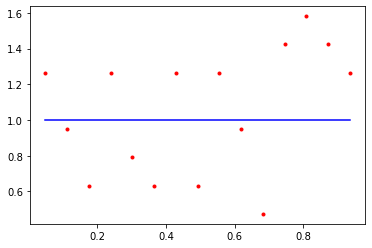

CPU times: user 212 µs, sys: 215 µs, total: 427 µs
Wall time: 161 µs
CPU times: user 411 µs, sys: 49 µs, total: 460 µs
Wall time: 156 µs
1.5172874756851444


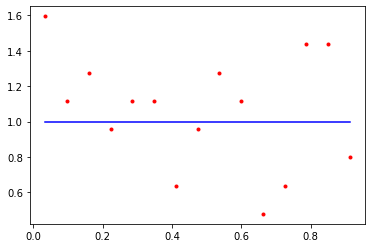

3.0308875664042914


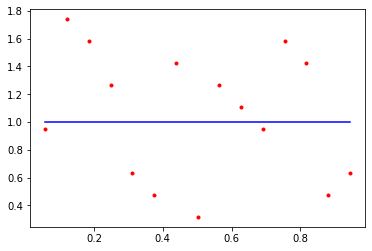

CPU times: user 198 µs, sys: 163 µs, total: 361 µs
Wall time: 135 µs
CPU times: user 417 µs, sys: 49 µs, total: 466 µs
Wall time: 158 µs
1.9767280669050833


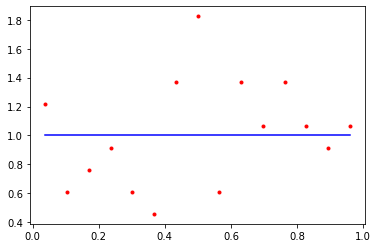

1.1073761431804912


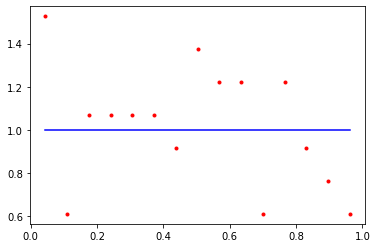

CPU times: user 177 µs, sys: 293 µs, total: 470 µs
Wall time: 160 µs
CPU times: user 410 µs, sys: 48 µs, total: 458 µs
Wall time: 155 µs
2.7040888144177426


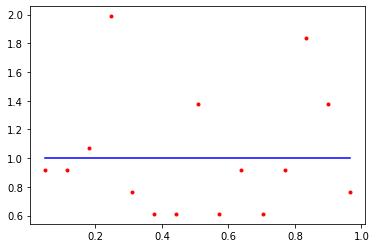

2.94116882453383


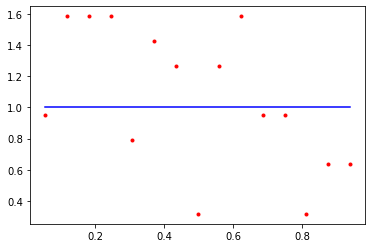

In [62]:
for _ in range(loops):
    %time r_everest = [ lib.get_random() for _ in range(n)]
    %time r_k2      = [ k2ran.get_random() for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [63]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

1.4820079598367437
1.426052890792122
[1.05318764 1.37682228 0.66049015 1.74133255 0.96418599 1.27067777
 1.34794005 1.33746348 0.90480108 1.33221495 1.07999025 0.81755314
 1.03385656 1.00086995 1.00018203 0.71321295 1.00348505 0.70753678
 1.33605976 0.95884962]
1.1145238227603855
